# **[LG] Predicting antenna performance of autonomous driving sensors**

In [1]:
!pip install ngboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 349.5/349.5 kB 6.4 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.8/48.8 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.7/76.7 kB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for autograd-gamma: filename=autograd_gamma-0.5.0-py3-none-any.whl size=4048 sha256=b6499c792179ee88d3aadeb71ea03e46205ecffa810471e80ed7e773c33c3c3a
  Stored in directory: /root/.cache/pip/wheels/9f/01/ee/1331593abb5725ff7d8c1333aee93a50a1c29d6ddda9665c9f
Successfully built autograd-gamma
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.1.1
    Uninstalling typing_extensions-4.1.1:
      Successfully uninstalled typing_extensions-4.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-io 0.21.0 requires te

In [2]:
!pip install eli5

In [3]:
!pip install pytorch-tabnet

In [4]:
import numpy as np
import pandas as pd
import os
import math
import random
from tqdm import tqdm
from scipy.stats import skew, kurtosis
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import time
import itertools
import statsmodels.api as sm
warnings.filterwarnings(action = 'ignore')
import re

from joblib import Parallel, delayed
import optuna 
from optuna.samplers import TPESampler

from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import RepeatedKFold, cross_val_score, StratifiedKFold, KFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from xgboost import XGBRegressor
from catboost import CatBoostRegressor, Pool
from lightgbm import LGBMRegressor
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor, BaggingRegressor, ExtraTreesRegressor, StackingRegressor, VotingRegressor, AdaBoostRegressor
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor
from mlxtend.regressor import StackingCVRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.neural_network import MLPRegressor
import lightgbm as lgb
from sklearn.inspection import permutation_importance

from ngboost import NGBRegressor
from pytorch_tabnet.tab_model import TabNetRegressor

from imblearn.over_sampling import ADASYN, RandomOverSampler, SMOTE
import eli5
from eli5.sklearn import PermutationImportance

import tensorflow as tf

In [5]:
SEED = 42
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
seed_everything(SEED) # Seed 고정

# **Load Data**

In [6]:
data_dir = '../input/lgopen'
list1 = os.listdir(data_dir)
for file in tqdm(list1):
    tmp = file.split('.')[0]
    if file == 'meta':
        list2 = os.listdir(data_dir + f'/{file}')
        for file2 in list2:
            tmp2 = file2.split('.')[0]
            print(tmp2)
            globals()[f'{tmp2}'] = pd.read_csv(data_dir + f'/meta/{file2}')
    else:
        print(tmp)
        globals()[f'{tmp}'] = pd.read_csv(data_dir + f'/{file}')

 50%|█████     | 2/4 [00:00<00:00, 19.83it/s]

y_feature_info
x_feature_info
y_feature_spec_info
sample_submission
train
test


100%|██████████| 4/4 [00:01<00:00,  3.83it/s]


In [ ]:
y_feature_info

In [ ]:
x_feature_info

In [ ]:
y_feature_spec_info

# **EDA & Feature Engineering**

## 데이터 타입

In [ ]:
train.info()

## 불량 Feature 도출
y_feature_spec_info 데이터를 가지고 '불량' Feature 도출
(단 학습에는 사용할 수 없음)

In [ ]:
train['불량'] = 0
for idx, y in enumerate(train.columns[train.columns.str.contains('Y')]):
    train['불량'][train[y] < y_feature_spec_info['최소'][idx]] = 1
    train['불량'][train[y] > y_feature_spec_info['최대'][idx]] = 1

In [ ]:
train['불량'].value_counts()

## PCB 체결 시 단계별 누름량
- X_01: PCB 체결 시 단계별 누름량(Step 1)
- X_02: PCB 체결 시 단계별 누름량(Step 2)
- X_05: PCB 체결 시 단계별 누름량(Step 3)
- X_06: PCB 체결 시 단계별 누름량(Step 4)

In [ ]:
def simpleplot(data, clist):
    for idx, c in enumerate(clist):
        fig = plt.figure(figsize = (45,15))
        ax = plt.subplot(len(clist), len(clist), idx + 1)
        plt.plot(train[c][train['불량'] == 0])
        plt.plot(train[c][train['불량'] == 1], alpha = 0.8)
        
        fig.subplots_adjust(top = 0.96)
        plt.title(str(c))
        plt.xticks([])
        plt.yticks([])

In [ ]:
def grouppairplot(data, clist, cgroup):
    
    corr_clist = data[clist].corr()
    
    fig = plt.figure(figsize = (20, 20))
    
    clen = len(clist)
    for i in range(clen):
        for j in range(clen):
            ax = fig.add_subplot(clen, clen, i * clen + j + 1)
            grouped = data.groupby(cgroup)
            for index, value in grouped:
                if i == j:
                    sns.distplot(value[clist[i]].values, bins = 50, label = index)
                else:
                    plt.scatter(clist[j], clist[i], data = value, s = 9, label = index)
                    
                plt.legend()
            if i == clen - 1:
                plt.xlabel(clist[j], fontsize = 12)
            if j == 0:
                plt.ylabel(clist[i], fontsize = 12)
            ax.annotate(np.round(corr_clist.loc[clist[i], clist[j]], 3), xy = (1, 0), xycoords = 'axes fraction', fontsize = 16, horizontalalignment = 'right', verticalalignment = 'bottom')
    plt.show()

In [ ]:
temp = pd.DataFrame(train['불량'][train['X_02'] == 103.320].value_counts()).reset_index()
temp = temp.rename(columns = {'index':'Value'})
error0 = temp['불량'][temp['Value'] == 0]
error1 = temp['불량'][temp['Value'] == 1]
print('Step2 누름량이 103.320 일때 불량이 발생할 확률 : %.3f%%' % (error1 / np.sum(temp['불량']) * 100))

In [ ]:
temp = pd.DataFrame(train['불량'][train['X_02'] == 103.321].value_counts()).reset_index()
temp = temp.rename(columns = {'index':'Value'})
error0 = temp['불량'][temp['Value'] == 0]
error1 = temp['불량'][temp['Value'] == 1]
print('Step2 누름량이 103.321 일때 불량이 발생할 확률 : %.3f%%' % (error1 / np.sum(temp['불량']) * 100))

Step 2 의 누름량은 103.320, 103.321 두가지로 일정하고

Step 2 의 누름량이 클때 즉 103.321일때 불량이 발생할 확률이 크다.

In [ ]:
simpleplot(train, ['X_01','X_02','X_05','X_06'])

In [ ]:
grouppairplot(train, ['X_01','X_02','X_05','X_06'], '불량')

In [ ]:
print('불량인 경우 Step 1 누름량 평균 : ',train['X_01'][train['불량'] == 1].mean())
print('불량이 아닌 경우 Step 1 누름량 평균 : ',train['X_01'][train['불량'] == 0].mean())

In [ ]:
print('불량인 경우 Step 2 누름량 평균 : ',train['X_02'][train['불량'] == 1].mean())
print('불량이 아닌 경우 Step 2 누름량 평균 : ',train['X_02'][train['불량'] == 0].mean())

In [ ]:
print('불량인 경우 Step 3 누름량 평균 : ',train['X_05'][train['불량'] == 1].mean())
print('불량이 아닌 경우 Step 3 누름량 평균 : ',train['X_05'][train['불량'] == 0].mean())

In [ ]:
print('불량인 경우 Step 4 누름량 평균 : ',train['X_06'][train['불량'] == 1].mean())
print('불량이 아닌 경우 Step 4 누름량 평균 : ',train['X_06'][train['불량'] == 0].mean())

Step 1, Step 2, Step4 에서는 불량인 경우 보다 불량이 아닌 경우에 누름량이 크다.

Step 2에서만 누름량이 작아야 불량이 발생할 확률이 낮다.
나머지 Step 1, Step 3, Step 4에서는 누름량이 커야 불량이 발생할 확률이 낮다는 것을 알 수 있다.

## 방열 재료 무게 및 면적
- X_03: 방열 재료 1 무게
- X_07: 방열 재료 1 면적
- X_08: 방열 재료 2 면적
- X_09: 방열 재료 3 면적
- X_10: 방열 재료 2 무게
- X_11: 방열 재료 3 무게

Q. X_10 / X_11 방열재료 2, 3의 무게값이 0이 많은데 결측치인지 실제로 방열재료 2, 3 이 공정에 사용되지 않았는지?

A. 실제 방열재료 2, 3은 공정에 사용되고 있으며 0으로 표현된 값은 결측치라고 생각하시면 될 것 같습니다.

In [ ]:
simpleplot(train, ['X_03','X_07','X_08','X_09','X_10','X_11'])

방열재료 2, 3의 경우 면적은 있는데 무게가 0인 것들이 무수히 많다.

-> 결측치 해결이 필요함

In [ ]:
grouppairplot(train, ['X_03','X_07','X_08','X_09','X_10','X_11'], '불량')

방열재료의 경우 면적이 클수록 무게도 커지는게 아니라는 것을 알 수 있다. (비선형)

**눌림량(누름량) = 물체를 누르는 양, 밀어 누르는 힘**

**압력 = 무게(힘)/면적**

**무게가 0인 것들이 있어서 압력 값이 inf로 나오는 경우 0으로 대체**

In [7]:
# 압력 = 무게(힘)/면적

def pressure(data, weight, area):
    ps = data[weight] / data[area]
    data[f'{weight}/{area}'] = 0
    for i in range(len(data)):
        if (ps[i] == math.inf) | (ps[i] == -math.inf):
            pass
        else:
            data[f'{weight}/{area}'] = ps
    return data

In [8]:
pressure(train, 'X_03', 'X_07')
pressure(train, 'X_10', 'X_08')
pressure(train, 'X_11', 'X_09')

pressure(test, 'X_03', 'X_07')
pressure(test, 'X_10', 'X_08')
pressure(test, 'X_11', 'X_09')

,ID,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,...,X_50,X_51,X_52,X_53,X_54,X_55,X_56,X_03/X_07,X_10/X_08,X_11/X_09
0,TEST_00001,68.504,103.321,76.67,1,101.867,73.963,30.51,63.57,239.80,...,138.130429,129.460682,141.506570,133.427229,129.711498,133.138096,121.859684,2.512947,0.0,0.0
1,TEST_00002,67.485,103.320,69.37,1,101.992,67.845,28.03,116.99,189.23,...,136.148839,128.266277,145.911745,131.196417,132.411480,133.629025,124.178623,2.474848,0.0,0.0
2,TEST_00003,69.524,103.320,68.97,1,101.884,77.022,29.65,205.68,214.93,...,120.447446,119.988804,132.099908,120.450155,130.051708,128.252972,114.475628,2.326138,0.0,0.0
3,TEST_00004,69.524,103.320,65.87,1,101.866,73.963,28.15,103.38,180.80,...,133.994695,125.069180,147.507669,123.142653,125.963665,139.666592,126.589253,2.339964,0.0,0.0
4,TEST_00005,73.603,103.321,66.67,1,101.891,74.983,29.92,71.20,231.93,...,137.918202,135.116192,138.600473,127.173033,137.252712,134.411335,124.020016,2.228275,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,68.504,103.320,63.97,1,103.157,68.864,29.49,116.35,284.16,...,127.741246,126.494312,139.119905,125.271109,128.284572,140.176945,128.292843,2.169210,0.0,0.0
39604,TEST_39605,68.504,103.320,61.37,1,103.137,68.864,32.29,116.28,272.41,...,127.767377,124.062809,138.238664,119.879393,127.322529,137.312047,131.570614,1.900588,0.0,0.0
39605,TEST_39606,69.524,103.320,63.67,1,103.149,69.884,30.00,113.05,295.54,...,128.593640,124.774037,138.659624,123.999571,126.075542,135.656132,127.671108,2.122333,0.0,0.0
39606,TEST_39607,67.485,103.321,61.77,1,103.148,67.845,32.05,115.05,267.26,...,121.110646,125.471699,134.989984,120.889578,129.296909,132.673977,131.882893,1.927301,0.0,0.0


## 커넥터 위치 기준 좌표
- X12: 커넥터 위치 기준 좌표

Q. X_12 커넥터 위치 기준좌표값이 (X,Y)의 형태가 아니라 하나의 값으로 나와있는데 어떤 의미인지?

A. 세부설명을 공개하는 과정에서 명칭의 변화가 있었는데 장비의 원점으로부터 거리 값이라고 생각하시면 될 것 같습니다.

In [ ]:
temp1 = pd.DataFrame(train['X_12'][train['불량'] == 1].value_counts()).reset_index()
temp1 = temp1.rename(columns = {'index':'value'})
temp1.sort_values(by = 'value')

In [ ]:
temp0 = pd.DataFrame(train['X_12'][train['불량'] == 0].value_counts()).reset_index()
temp0 = temp0.rename(columns = {'index':'value'})
temp0.sort_values(by = 'value')

In [ ]:
plt.figure(figsize = (15, 5))
sns.barplot(temp1['value'],temp1['X_12'], color = 'r')
sns.barplot(temp0['value'],temp0['X_12'], color = 'b', alpha = 0.5)

## 각 안테나 패드 위치(높이) 차이
- X_13: 각 안테나 패드 위치(높이) 차이

In [ ]:
temp1 = pd.DataFrame(train['X_13'][train['불량'] == 1].value_counts()).reset_index()
temp1 = temp1.rename(columns = {'index':'value'})
temp1.sort_values(by = 'value')

In [ ]:
temp0 = pd.DataFrame(train['X_13'][train['불량'] == 0].value_counts()).reset_index()
temp0 = temp0.rename(columns = {'index':'value'})
temp0.sort_values(by = 'value')

In [ ]:
plt.figure(figsize = (15, 5))
sns.barplot(temp1['value'],temp1['X_13'], color = 'r')
sns.barplot(temp0['value'],temp0['X_13'], color = 'b', alpha = 0.5)

## 안테나 패드 위치
- X_14: 1번 안테나 패드 위치
- X_15: 2번 안테나 패드 위치
- X_16: 3번 안테나 패드 위치
- X_17: 4번 안테나 패드 위치
- X_18: 5번 안테나 패드 위치

In [15]:
def simplebarplot(data, clist):
    fig = plt.figure(figsize = (35, 25))
    for idx, c in enumerate(clist):
        temp0 = pd.DataFrame(train[c][train['불량'] == 0].value_counts()).reset_index()
        temp0 = temp0.rename(columns = {'index':'value'})
        #temp0 = temp0.sort_values(by = 'value')

        temp1 = pd.DataFrame(train[c][train['불량'] == 1].value_counts()).reset_index()
        temp1 = temp1.rename(columns = {'index':'value'})
        #temp1 = temp1.sort_values(by = 'value')
        
        plt.title(str(c))
        fig.subplots_adjust(top = 0.96)
        ax = plt.subplot(len(clist), 1, idx + 1)
        sns.barplot(temp1['value'],temp1[c], color = 'r')
        sns.barplot(temp0['value'],temp0[c], color = 'b', alpha = 0.5)

In [ ]:
simplebarplot(train, ['X_14','X_15','X_16','X_17','X_18'])

In [ ]:
grouppairplot(train, ['X_14','X_15','X_16','X_17','X_18'], '불량')

각 안테나 패드 위치들이 서로 양의 상관관계를 띄고있다.

In [ ]:
# 안테나 패드 위치 둘레 구하기

'''train['Round1'] = train['X_14'] + train['X_15'] + train['X_16'] + train['X_17'] + train['X_18']
test['Round1'] = test['X_14'] + test['X_15'] + test['X_16'] + test['X_17'] + test['X_18']'''

In [9]:
class Point2D:
    def __init__(self, x, y):
        self.x = x
        self.y = y

# 두 길이의 차이
def Point1Distance(X, xlist):
    point = [(x, y) for x in xlist for y in xlist if x!=y]
    for p in point:
        P = Point2D(X[p[0]], X[p[1]])
        c = P.x - P.y
        X[f'{p[0]}_{p[1]}'] = c

# 두 점 사이의 거리
def Point2Distance(X, xlist):
    point = [(x, y) for x in xlist for y in xlist if x!=y]
    for p1 in point:
        for p2 in point:
            if p1 == p2:
                pass
            else:
                P1 = Point2D(X[p1[0]], X[p1[1]])
                P2 = Point2D(X[p2[0]], X[p2[1]])

                a = P2.x - P1.x
                b = P2.y - P1.y

                c =  np.sqrt((a ** 2) + (b ** 2))
                X[f'{p1}_{p2}'] = c
                
    return X

# 기울기 구하기
def Inclination(X, xlist):
    point = [(x, y) for x in xlist for y in xlist if x!=y]
    for p in point:
        points = Point2D(X[p[0]], X[p[1]])        
        inclination = np.sqrt((points.x ** 2) + (points.y ** 2))
        X[f'{p[0]} {p[1]}'] = inclination
        
    return X

def Inclination_euk(X, xlist, inc):
    for x in xlist:
        euk = X[inc] - X[x]**2
        X[f'euk_{inc}_{x}'] = euk
    return X

# 코사인 유사도
def cos_similarity(data, a, b):
    cos_sim = np.dot(data[a], data[b]) / (np.linalg.norm(data[a]) * (np.linalg.norm(data[b])))
    print(cos_sim)
    data[f'cos_{a}_{b}'] = cos_sim
    return data

# 피어슨 유사도
def pearson_cimilarity(data, a, b):
    pear_sim = np.dot((data[a] - np.mean(data[a])), (data[b] - np.mean(data[b]))) / (np.linalg.norm(data[a] - np.mean(data[a])) * (np.linalg.norm(data[b] - np.mean(data[b]))))
    print(pear_sim)
    data[f'pear_{a}_{b}'] = pear_sim
    return data

# 선과 선 사이의 각도 (두 선이 교점을 이룬다는 가정하에 / 선들이 어떤 동일한 한 점에서 시작된다는 하에)
def angle_arctan(X, xlist):
    point = [(x, y) for x in xlist for y in xlist if x!=y]
    for p in point:
        P = Point2D(X[p[0]], X[p[1]])
        rad = np.arctan2(P.x, P.y)
        #rad = math.atan2(P.x, P.y)
        deg = (rad * 180) / np.pi
        X[f'radian_{p[0]}_{p[1]}'] = rad
        X[f'degree_{p[0]}_{p[1]}'] = deg
    return X

In [10]:
xlist = ['X_14','X_15','X_16','X_17','X_18']

Point1Distance(train, xlist)
Point1Distance(test, xlist)

#Point2Distance(train, xlist)
#Point2Distance(test, xlist)

#Inclination(train, xlist)
#Inclination(test, xlist)

#angle_arctan(train, xlist)
#angle_arctan(test, xlist)

안테나 패드 위치 정보들을 평면좌표에서의 한 점의 위치라고 생각함

각각의 위치 정보들을 두 묶음으로 해서 각각의 점들을 만들어냄

그래프 상으로 점들을 표시한 결과 안테나 패드 형태의 패턴들이 보임

-> 각각의 점들을 모두 이은 길이 피쳐 생성

-> 모서리 점들만 활용해서 외곽선 피쳐 생성

In [ ]:
for i in range(0, 10):
    plt.figure(figsize = (15, 7))
    
    plt.scatter(train_x['X_14'][i], train_x['X_14'][i], color = 'yellow')
    plt.scatter(train_x['X_15'][i], train_x['X_15'][i], color = 'yellow')
    plt.scatter(train_x['X_16'][i], train_x['X_16'][i], color = 'yellow')
    plt.scatter(train_x['X_17'][i], train_x['X_17'][i], color = 'yellow')
    plt.scatter(train_x['X_18'][i], train_x['X_18'][i], color = 'yellow')

    
    plt.scatter(train_x['X_14'][i], train_x['X_15'][i], color = 'black')
    plt.scatter(train_x['X_14'][i], train_x['X_16'][i], color = 'red')
    plt.scatter(train_x['X_14'][i], train_x['X_17'][i], color = 'green')
    plt.scatter(train_x['X_14'][i], train_x['X_18'][i], color = 'blue')
    
    plt.scatter(train_x['X_15'][i], train_x['X_14'][i], color = 'black')
    plt.scatter(train_x['X_15'][i], train_x['X_16'][i], color = 'red')
    plt.scatter(train_x['X_15'][i], train_x['X_17'][i], color = 'green')
    plt.scatter(train_x['X_15'][i], train_x['X_18'][i], color = 'blue')

    plt.scatter(train_x['X_16'][i], train_x['X_14'][i], color = 'black')
    plt.scatter(train_x['X_16'][i], train_x['X_15'][i], color = 'red')
    plt.scatter(train_x['X_16'][i], train_x['X_17'][i], color = 'green')
    plt.scatter(train_x['X_16'][i], train_x['X_18'][i], color = 'blue')

    plt.scatter(train_x['X_17'][i], train_x['X_14'][i], color = 'black')
    plt.scatter(train_x['X_17'][i], train_x['X_15'][i], color = 'red')
    plt.scatter(train_x['X_17'][i], train_x['X_16'][i], color = 'green')
    plt.scatter(train_x['X_17'][i], train_x['X_18'][i], color = 'blue')

    plt.scatter(train_x['X_18'][i], train_x['X_14'][i], color = 'black')
    plt.scatter(train_x['X_18'][i], train_x['X_15'][i], color = 'red')
    plt.scatter(train_x['X_18'][i], train_x['X_16'][i], color = 'green')
    plt.scatter(train_x['X_18'][i], train_x['X_17'][i], color = 'blue')

## 스크류 삽입 깊이
- X_19: 1번 스크류 삽입 깊이
- X_20: 2번 스크류 삽입 깊이
- X_21: 3번 스크류 삽입 깊이
- X_22: 4번 스크류 삽입 깊이

In [ ]:
simplebarplot(train, ['X_19','X_20','X_21','X_22'])

In [ ]:
grouppairplot(train, ['X_19','X_20','X_21','X_22'], '불량')

각 스크류 삽입 깊이들이 서로 양의 상관관계가 있다.

## 커넥터 핀 치수
- X_24: 커넥터 1번 핀 치수
- X_25: 커넥터 2번 핀 치수
- X_26: 커넥터 3번 핀 치수
- X_27: 커넥터 4번 핀 치수
- X_28: 커넥터 5번 핀 치수
- X_29: 커넥터 6번 핀 치수

In [ ]:
simplebarplot(train, ['X_24','X_25','X_26','X_27','X_28','X_29'])

유독 커넥터 5번 핀 치수가 작을때 불량이 많이 발생하는 것을 알 수 있다. 

In [ ]:
grouppairplot(train, ['X_24','X_25','X_26','X_27','X_28','X_29'], '불량')

각 커넥터 핀 치수들이 서로 양의 상관관계가 있다.

In [ ]:
train['X_24X_29sum'] = train['X_24'] + train['X_25'] + train['X_26'] + train['X_27'] + train['X_28'] + train['X_29']
test['X_24X_29sum'] = test['X_25'] + test['X_26'] + test['X_27'] + test['X_28'] + test['X_29']

In [ ]:
# 각 커넥터 핀 치수 차이
xlist = ['X_24','X_25','X_26','X_27','X_28','X_29']

#Point1Distance(train, xlist)
#Point1Distance(test, xlist)

#angle_arctan(train, xlist)
#angle_arctan(test, xlist)

## 스크류 삽입 깊이
- X_30: 스크류 삽입 깊이1
- X_31: 스크류 삽입 깊이2
- X_32: 스크류 삽입 깊이3
- X_33: 스크류 삽입 깊이4

In [ ]:
simplebarplot(train, ['X_30','X_31','X_32','X_33'])

그래프를 보아 X_30 과 X_32의 스크류 삽입 깊이 패턴이 일치하는 걸로 봐서 X_30과 X_31 작업에서 같은 스크류를 사용하는것 같다. (X_31 과 X_33도 동일)

X_30과 X_31, X_32의 스크류 삽입 깊이가 낮을 수록 불량이 많이 발생하는 것을 알 수 있다.
X_33의 스크류 삽입 깊이의 분포는 불량과 불량이 아닌 경우의 분포가 비슷하다.

In [ ]:
grouppairplot(train, ['X_30','X_31','X_32','X_33'], '불량')

## 스크류 체결 시 분당 회전수
- X_34: 스크류 체결 시 분당 회전수 1
- X_35: 스크류 체결 시 분당 회전수 2
- X_36: 스크류 체결 시 분당 회전수 3
- X_37: 스크류 체결 시 분당 회전수 4

In [ ]:
simplebarplot(train, ['X_34','X_35','X_36','X_37'])

In [ ]:
temp = pd.DataFrame(train.groupby(['X_30','불량'])['X_34'].mean()).reset_index()
temp['X_34'] = np.round(temp['X_34'],4)
temp0 = temp[temp['불량'] == 0]
temp1 = temp[temp['불량'] == 1]
plt.figure(figsize = (35, 5))
sns.barplot(temp0.X_34, temp0.X_30, color = 'b')
sns.barplot(temp1.X_34, temp1.X_30, color = 'r')

In [ ]:
grouppairplot(train, ['X_34','X_35','X_36','X_37','X_30','X_31','X_32','X_33'], '불량')

상식적으로는 분당 회전수가 많을 수록 스크류 삽입 깊이가 깊어지는게 맞지만

스크류의 삽입 깊이와 분당 회전수의 상관관계를 확인한 결과
서로 상관이 없는것을 알 수 있다.

rpm (revolution per minute) = 분당 회전수

rad/s (radian per second) = 초당 각크기 변화

**rpm을 rps(초당 회전수)로 변환**

rpm / 60 = rps

**rpm을 rad/s로 변환**

rpm * (2pi/60) = rad/s

In [ ]:
# rpm -> rps 변환

def rps(data, clist):
    for c in clist:
        data[c+'_rps'] = data[c] / 60
    return data

In [ ]:
rps(train, ['X_34','X_35','X_36','X_37'])
rps(test, ['X_34','X_35','X_36','X_37'])

In [ ]:
# rpm -> rad/s 변환

def rads(data, clist):
    for c in clist:
        data[c+'_rads'] = data[c] * ((2 * np.pi) / 60)
    return data

In [ ]:
rads(train, ['X_34','X_35','X_36','X_37'])
rads(test, ['X_34','X_35','X_36','X_37'])

## 하우징 PCB 안착부 치수
- X_38: 하우징 PCB 안착부 1 치수
- X_39: 하우징 PCB 안착부 2 치수
- X_40: 하우징 PCB 안착부 3 치수

In [ ]:
simpleplot(train, ['X_38','X_39','X_40'])

하우징 PCB 안착부 1 치수(X_38)의 경우 불량이 아니면서 다른 것들과 다르게 치수가 이상하게 양수인 경우가 존재함

In [ ]:
print('train:',train['X_38'][train['X_38'] > 1])
print('test:',test['X_38'][test['X_38'] > 1])

테스트 데이터에는 양수 값이 없기에 학습에 방해될 수 있음으로 이상치 처리가 필요

In [ ]:
# 이상치 처리

train.drop(24093, axis = 0, inplace = True)
#train['X_38'][24093] = np.mean(train['X_38'])

In [ ]:
simplebarplot(train, ['X_38','X_39','X_40'])

하우징 PCB 안착부 1 치수, 하우징 PCB 안착부 2 치수, 하우징 PCB 안착부 3 치수 모두 치수가 많이 작을수록 불량률이 가장 높다.

In [ ]:
grouppairplot(train, ['X_38','X_39','X_40'], '불량')

In [ ]:
train['X_38X_40sum'] = train['X_38'] + train['X_39'] + train['X_40']
test['X_38X_40sum'] = test['X_38'] + test['X_39'] + test['X_40']

In [ ]:
xlist = ['X_38','X_39','X_40']

#Point1Distance(train, xlist)
#Point1Distance(test, xlist)

#angle_arctan(train, xlist)
#angle_arctan(test, xlist)

## 레이돔 치수
- X_41: 레이돔 치수 (안테나 1번 부위)
- X_42: 레이돔 치수 (안테나 2번 부위)
- X_43: 레이돔 치수 (안테나 3번 부위)
- X_44: 레이돔 치수 (안테나 4번 부위)

In [ ]:
grouppairplot(train, ['X_41','X_42','X_43','X_44'], '불량')

X_41, X_43 / X_42, X_44 끼리 서로 양의 상관관계를 보인다.

    41
 42 ----- 44
 
    43
    
레이돔 치수는 이와 같은 형태로 되어있다고 가정하고 

두 치수 값으로 기울기 구하기

In [ ]:
# 레이돔 치수 둘레 구하기

train['X_41X_44sum'] = train['X_41'] + train['X_42'] + train['X_43'] + train['X_44']
test['X_41X_44sum'] = test['X_41'] + test['X_42'] + test['X_43'] + test['X_44']

In [ ]:
xlist = ['X_41','X_42','X_43','X_44']

# 각 치수들의 차이
#Point1Distance(train, xlist)
#Point1Distance(test, xlist)
    
# 기울기 구하기
#Inclination(train, xlist)
#Inclination(test, xlist)

#angle_arctan(train, xlist)
#angle_arctan(test, xlist)

In [ ]:
sns.pairplot(train[lists])

## 안테나 부분 레이돔 기울기
- X_45: 안테나 부분 레이돔 기울기

In [ ]:
simpleplot(train, ['X_45'])

In [ ]:
plt.figure(figsize = (15, 5))
simplebarplot(train, ['X_45'])

안테나 부분 레이돔 치수가 작을수록 불량률이 높다.

In [ ]:
grouppairplot(train, ['X_41','X_42','X_43','X_44','X_45'], '불량')

X_45 안테나 레이돔 부분 기울기와 X_41, X_43은 서로 양의 상관관계를 보이고

X_42, X_44는 서로 음의 상관관계를 보인다.

In [ ]:
# 기울기 * x값 증가량 = y값 증가량

xlist = ['X_41','X_42','X_43','X_44']

def y_value(data, xlist):
    for x in xlist:
        data[f'{x}*X_45'] = data[x] * data['X_45']
    return data

#y_value(train, xlist)
#y_value(test, xlist)

Inclination_euk(train, xlist, 'X_45')
Inclination_euk(test, xlist, 'X_45')

## 실란트 본드 소요량
- X_46: 실란트 본드 소요량

In [ ]:
temp0 = train['X_46'][train['불량'] == 0]
plt.figure(figsize = (15, 5))
sns.distplot(temp0)

In [ ]:
temp1 = train['X_46'][train['불량'] == 1]
plt.figure(figsize = (15, 5))
sns.distplot(temp1, color = 'r')

실란트 본드 소요량에 따라 불량과 불량이 아닌 경우 분포가 비슷하다.
실란트 본드 소요량은 불량 발생에 거의 미치지 않는 것으로 보인다.

In [ ]:
simpleplot(train, ['X_46'])

## 검사 통과 여부
- X_04: 1차 검사 통과 여부
- X_23: 2차 검사 통과 여부
- X_47: 3차 검사 통과 여부
- X_48: 4차 검사 통과 여부

In [ ]:
train['X_04'].value_counts()

In [ ]:
train['X_23'].value_counts()

In [ ]:
train['X_47'].value_counts()

In [ ]:
train['X_48'].value_counts()

검사 통과 여부는 모두 1로 검사에서 모두 통과 되었기 때문에

해당 컬럼들의 경우 학습에 도움이 되지않는다.

In [ ]:
train.drop(['X_04','X_23','X_47','X_48'], axis = 1, inplace = True)
test.drop(['X_04','X_23','X_47','X_48'], axis = 1, inplace = True)

## Cal 투입 전 대기 시간
- X_49: Cal 투입 전 대기 시간

In [ ]:
simpleplot(train, ['X_49'])

In [ ]:
temp0 = train['X_49'][train['불량'] == 0]
plt.figure(figsize = (15, 5))
sns.distplot(temp0, color = 'b')

In [ ]:
temp1 = train['X_49'][train['불량'] == 1]
plt.figure(figsize = (15, 5))
sns.distplot(temp1, color = 'r')

Cal 투입 전 대기시간의 경우 또한 불량 및 불량이 아닐때의 분포가 거의 비슷하다.

## RF 부분 SMT 납 량
- X_50: RF1 부분 SMT 납 량
- X_51: RF2 부분 SMT 납 량
- X_52: RF3 부분 SMT 납 량
- X_53: RF4 부분 SMT 납 량
- X_54: RF5 부분 SMT 납 량
- X_55: RF6 부분 SMT 납 량
- X_56: RF7 부분 SMT 납 량

In [ ]:
simpleplot(train, ['X_50','X_51','X_52','X_53','X_54','X_56'])

In [ ]:
grouppairplot(train, ['X_50','X_51','X_52','X_53','X_54','X_56'], '불량')

RF부분 SMT 납 량들이 서로 약간의 양의 상관관계를 보인다.

In [ ]:
# RF부분 SMT 총 납 량
#train['totalnap'] = train['X_50'] + train['X_51'] + train['X_52'] + train['X_53'] + train['X_54'] + train['X_55'] + train['X_56']
#test['totalnap'] = test['X_50'] + test['X_51'] + test['X_52'] + test['X_53'] + test['X_54'] + test['X_55'] + test['X_56']

## 중복값 분석

In [ ]:
for c in train.columns[train.columns.str.contains('X')].tolist():
    temp = pd.DataFrame(train.groupby([c])['불량'].unique())
    temp['불량'] = temp['불량'].apply(lambda x : x[0])
    error0 = len(temp[temp['불량'] == 0])
    error1 = len(temp[temp['불량'] == 1])
    print(f'동일한 {c}에서 불량이 발생할 확률 : %.3f%%' % (error1/(error0 + error1) *100))

## 이상치 분석

이상치가 존재하고 불량이 아닌 경우는 처리가 필요
하지만 이상치가 존재하고 불량인 경우 처리할 필요가 없다. 말그대로 이상치니까

In [ ]:
def problematic(data):
    col_list = data.columns[data.columns.str.contains('X_')].tolist() 
    fig = plt.figure(figsize = (len(col_list), len(col_list)*7))
    for idx, c in enumerate(col_list):
        ax = plt.subplot(len(col_list), 7, idx + 1)
        col_data = data[c].values
        col_mean = col_data.mean()
        col_std = col_data.std()
        col_max = col_data.max()
        col_min = col_data.min()
        
        plt.hist(col_data, alpha = 0.7, bins = 80, color = 'gray')
        
        plt.axhline(col_mean, color = 'r', linewidth = 1)
        
        fig.subplots_adjust(top = 0.96)
        plt.title(str(c), fontsize = 20)
        plt.xticks([])
        plt.yticks([])
        
        plt.text(0.39, 0.95, f'max:{np.round(col_max,2)}', va='center', transform=ax.transAxes, color = 'black', size = 20)
        plt.text(0.39, 0.9, f'mean:{np.round(col_mean,2)}', va='center', transform=ax.transAxes, color = 'r', size = 20)
        plt.text(0.39, 0.85, f'min:{np.round(col_min,2)}', va='center', transform=ax.transAxes, color = 'black', size = 20)
        plt.text(0.39, 0.8, f'std:{np.round(col_std,2)}', va='center', transform=ax.transAxes, color = 'black', size = 20)

In [ ]:
problematic(train)

In [ ]:
a = ['X10',
'X11',
'X10X08',
'X11X09']

In [ ]:
train.drop(a, axis=1, inplace = True)
test.drop(a, axis=1, inplace = True)

In [ ]:
'''xlist = train.columns[train.columns.str.contains('X')]
skews = []
kurts = []

for x in xlist:
    skew_data = skew(train[x].values)
    if (skew_data > 1) or (skew_data < -1):
        print(f'{x} is skew')
        skews.append(x)    
    kurt_data = kurtosis(train[x].values)
    if (kurt_data > 3) or (kurt_data < -3):
        print(f'{x} is kurtosis')
        kurts.append(x)

union = list(set().union(skews, kurts))
union

# log 변환
#np.log() <-> np.exp()
#np.log1p() <-> np.expm1()

train[union] = np.log1p(train[union])
test[union] = np.log1p(test[union])
'''

In [ ]:
'''traincorr = train[train.columns[train.columns.str.contains('X')]].corr()
filtercorr = traincorr[((traincorr > .5) | (traincorr < -.5))]
plt.figure(figsize = (30, 30))
sns.heatmap(filtercorr, annot = True, cmap = 'Reds')
plt.show()'''

# Modeling

In [16]:
def lg_nrmse(gt, preds):
    # 각 Y Feature별 NRMSE 총합
    # Y_01 ~ Y_08 까지 20% 가중치 부여
    all_nrmse = []
    for idx in range(0,14): # ignore 'ID'
        rmse = mean_squared_error(gt[:,idx], preds[:,idx], squared=False)
        nrmse = rmse/np.mean(np.abs(gt[:,idx]))
        all_nrmse.append(nrmse)
    score = 1.2 * np.sum(all_nrmse[:8]) + 1.0 * np.sum(all_nrmse[8:15])
    return score

def lg_nrmse_part(gt, preds):
    rmse = mean_squared_error(gt, preds, squared = False)
    nrmse = rmse / np.mean(np.abs(gt))
    score = 1.2 * nrmse + 1.0 + nrmse
    return score

In [17]:
train.head()

,ID,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,...,X_16_X_17,X_16_X_18,X_17_X_14,X_17_X_15,X_17_X_16,X_17_X_18,X_18_X_14,X_18_X_15,X_18_X_16,X_18_X_17
0,TRAIN_00001,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,...,-0.12,-0.04,0.18,0.15,0.12,0.08,0.10,0.07,0.04,-0.08
1,TRAIN_00002,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,...,-0.05,0.04,0.18,0.18,0.05,0.09,0.09,0.09,-0.04,-0.09
2,TRAIN_00003,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,...,-0.12,-0.04,0.15,0.15,0.12,0.08,0.07,0.07,0.04,-0.08
3,TRAIN_00004,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,...,-0.12,-0.01,0.21,0.18,0.12,0.11,0.10,0.07,0.01,-0.11
4,TRAIN_00005,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,...,-0.09,-0.01,0.15,0.16,0.09,0.08,0.07,0.08,0.01,-0.08


In [18]:
# https://velog.io/@groovallstar/1

train = train.rename(columns = lambda x:re.sub('[_/]+', '', x))
test = test.rename(columns = lambda x:re.sub('[_/]+', '', x))

In [19]:
train_x = train.filter(regex = 'X')
train_y = train.filter(regex = 'Y')
test_x = test.filter(regex = 'X')

In [16]:
# def elbow(X):
#     sse = []
#     for i in range(1, 11):
#         kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = SEED)
#         kmeans.fit(X)
#         sse.append(kmeans.inertia_)
        
#     plt.plot(range(1, 11), sse, marker = 'o')
#     plt.xlabel('Clusters')
#     plt.ylabel('SSE')
#     plt.show()
    
# elbow(train_x)

In [ ]:
def visualize_silhouette(cluster_lists, X_features): 

    from sklearn.datasets import make_blobs
    from sklearn.cluster import KMeans
    from sklearn.metrics import silhouette_samples, silhouette_score

    import matplotlib.pyplot as plt
    import matplotlib.cm as cm
    import math

    # 입력값으로 클러스터링 갯수들을 리스트로 받아서, 각 갯수별로 클러스터링을 적용하고 실루엣 개수를 구함
    n_cols = len(cluster_lists)

    # plt.subplots()으로 리스트에 기재된 클러스터링 수만큼의 sub figures를 가지는 axs 생성 
    fig, axs = plt.subplots(figsize=(4*n_cols, 4), nrows=1, ncols=n_cols)

    # 리스트에 기재된 클러스터링 갯수들을 차례로 iteration 수행하면서 실루엣 개수 시각화
    for ind, n_cluster in enumerate(cluster_lists):

        # KMeans 클러스터링 수행하고, 실루엣 스코어와 개별 데이터의 실루엣 값 계산. 
        clusterer = KMeans(n_clusters = n_cluster, max_iter=500, random_state=0)
        cluster_labels = clusterer.fit_predict(X_features)

        sil_avg = silhouette_score(X_features, cluster_labels)
        sil_values = silhouette_samples(X_features, cluster_labels)

        y_lower = 10
        axs[ind].set_title('Number of Cluster : '+ str(n_cluster)+'\n' \
                          'Silhouette Score :' + str(round(sil_avg,3)) )
        axs[ind].set_xlabel("The silhouette coefficient values")
        axs[ind].set_ylabel("Cluster label")
        axs[ind].set_xlim([-0.1, 1])
        axs[ind].set_ylim([0, len(X_features) + (n_cluster + 1) * 10])
        axs[ind].set_yticks([])  # Clear the yaxis labels / ticks
        axs[ind].set_xticks([0, 0.2, 0.4, 0.6, 0.8, 1])

        # 클러스터링 갯수별로 fill_betweenx( )형태의 막대 그래프 표현. 
        for i in range(n_cluster):
            ith_cluster_sil_values = sil_values[cluster_labels==i]
            ith_cluster_sil_values.sort()

            size_cluster_i = ith_cluster_sil_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_cluster)
            axs[ind].fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_sil_values, \
                                facecolor=color, edgecolor=color, alpha=0.7)
            axs[ind].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
            y_lower = y_upper + 10

        axs[ind].axvline(x=sil_avg, color="red", linestyle="--")

visualize_silhouette([2, 3, 4, 5, 6], train_x)

In [ ]:
from sklearn.metrics import silhouette_samples
from matplotlib import cm

def plotSillhouette(X, y_km):
    cluster_labels = np.unique(y_km)
    n_clusters = cluster_labels.shape[0]
    silhouette_vals = silhouette_samples(X, y_km, metric = 'euclidean')
    y_ax_lower, y_ax_upper = 0, 0
    yticks = []
    
    for i, c in enumerate(cluster_labels):
        c_silhouette_vals = silhouette_vals[y_km == c]
        c_silhouette_vals.sort()
        y_ax_upper += len(c_silhouette_vals)
        color = cm.jet(i / n_clusters)
        
        plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height = 1.0, edgecolor = 'none', color = color)
        yticks.append((y_ax_lower + y_ax_upper)/2)
        y_ax_lower += len(c_silhouette_vals)
        
    silhouette_avg = np.mean(silhouette_vals)
    plt.axvline(silhouette_avg, color = 'red', linestyle = '--')
    plt.ylabel('clusters')
    plt.xlabel('silhouette')
    plt.show()
    
km = KMeans(n_clusters = 2, random_state = SEED)
y_km = km.fit_predict(train_x)
plotSillhouette(train_x, y_km)

In [ ]:
kmeans = KMeans(n_clusters = 2, random_state = SEED)
kmeans.fit(train_x)
train_x['cluster'] = kmeans.predict(train_x)
test_x['cluster'] = kmeans.predict(test_x)

In [17]:
train_x.shape, train_y.shape, test_x.shape

((39607, 79), (39607, 14), (39608, 79))

In [ ]:
#a = train_x.columns[train_x.columns.str.contains('degree')].tolist()
#train_x.drop(a, axis=1, inplace = True)
#test_x.drop(a, axis=1, inplace= True)

In [ ]:
'''cat = CatBoostRegressor(random_state = SEED) 
lgb = LGBMRegressor(random_state = SEED)
xgb = XGBRegressor(random_state = SEED)
gbm = GradientBoostingRegressor(random_state = SEED)
hgb = HistGradientBoostingRegressor(random_state = SEED)
mlp = MLPRegressor(random_state = SEED)
ngb = NGBRegressor(random_state = SEED)
ada = AdaBoostRegressor(random_state = SEED)
etr = ExtraTreesRegressor(random_state = SEED)
rf = RandomForestRegressor(random_state = SEED)
bag = BaggingRegressor(random_state = SEED)
ridge = Ridge(random_state = SEED)
lasso = Lasso(random_state = SEED)
tabnet = TabNetRegressor(seed = SEED)'''

In [ ]:
'''def processSubset(x, y, feature_set):
    model = sm.OLS(y, x[list(feature_set)])
    regr = model.fit()
    AIC = regr.aic
    return {'model' : regr, 'AIC' : AIC}

def forward(x,y,predictors):
    remainingPredictors = [p for p in x.columns.difference(basic)
                           if p not in predictors]
    tic=time.time()
    results=[]
    for p in remainingPredictors:
        results.append(processSubset(x=x,y=y,feature_set=predictors+[p]+basic))
    #데이터프레임으로 변환
    models = pd.DataFrame(results)
 
    #AIC가 가장 낮은 것을 선택
    bestModel = models.loc[models['AIC'].argmin()] #index
    toc = time.time()
    print("Processed ", models.shape[0],"models on", len(predictors)+1,
          "predictors in",(toc-tic))
    print("Selected predictors:",bestModel['model'].model.exog_names,
          'AIC : ',bestModel[0])
    return bestModel
 
#전진선택법 모델
def forward_model(x,y):
    fModels = pd.DataFrame(columns=["AIC","model"])
    tic = time.time()
    #미리 정의된 데이터 변수
    predictors = []
    #변수1~10개 : 0~9 -> 1~10
    for i in range(1,len(x.columns.difference(basic))+1):
        forwardResult= forward(x,y,predictors)
        if i > 1:
            if forwardResult['AIC'] > fmodelBefore:
                break
        fModels.loc[i] = forwardResult
        predictors = fModels.loc[i]["model"].model.exog_names
        fmodelBefore = fModels.loc[i]["AIC"]
        predictors = [k for k in predictors if k not in basic]
    toc = time.time()
    print("Total elapesed time : ", (toc - tic), "seconds.")
 
    return (fModels['model'][len(fModels['model'])])'''

In [ ]:
'''def processSubset(X, y, feature_set):
    model = sm.OLS(y, X[list(feature_set)])
    regr = model.fit()
    AIC = regr.aic
    return {'model' : regr, 'AIC' : AIC}

def forward(X,y,predictors):

    remaining_predictors = [p for p in X.columns if p not in predictors]
    tic = time.time()
    results = []
    for p in remaining_predictors :
        results.append(processSubset(X=X,y=y,feature_set=predictors+[p]))
    
    models = pd.DataFrame(results)
    
    best_model = models.loc[models['AIC'].argmin()]
    toc = time.time()
    print("Processed ",models.shape[0], "models on", len(predictors)+1, "predictors in", (toc-tic))
    print("Selected predictors:",best_model["model"].model.exog_names,"AIC: ",best_model[0])
    return best_model

def forward_model(X,y):

    Fmodels = pd.DataFrame(columns=["AIC","model"])
    tic = time.time()
    
    predictors = []
    
    for i in range(1,len(X.columns)+1):
        Forward_result = forward(X=X,y=y,predictors=predictors)
        if i > 1 :
            if Forward_result["AIC"] > Fmodel_before:
                break
        Fmodels.loc[i] = Forward_result
        predictors = Fmodels.loc[i]["model"].model.exog_names
        Fmodel_before = Fmodels.loc[i]["AIC"]
        predictors = [k for k in predictors if k != 'const']
    toc = time.time()
    print("Total elapsed time:",(toc-tic), "seconds.")
    
    return (Fmodels['model'][len(Fmodels['model'])])

def backward(X,y,predictors):
    tic = time.time()
    results = []
    
    for combo in itertools.combinations(predictors, len(predictors) - 1):
        results.append(processSubset(X=X,y=y,feature_set=list(combo)))
    models = pd.DataFrame(results)
    
    best_model = models.loc[models['AIC'].argmin()]
    toc = time.time()
    
    print("Processed ",models.shape[0], "models on", len(predictors) - 1, "predictors in",(toc-tic))
    print("Selected predictors:",best_model['model'].model.exog_names,' AIC:',best_model[1])
    return best_model
    
def backward_model(X,y) :
    Bmodels = pd.DataFrame(columns=["AIC","model"], index = range(1,len(X.columns)))
    tic = time.time()
    predictors = X.columns
    Bmodel_before = processSubset(X,y,predictors)['AIC']
    while (len(predictors) > 1):
        Backward_result = backward(X=X, y= y, predictors=predictors)
        if Backward_result['AIC'] > Bmodel_before :
            break
        Bmodels.loc[len(predictors) -1] = Backward_result
        predictors = Bmodels.loc[len(predictors) - 1]['model'].model.exog_names
        Bmodel_before = Backward_result["AIC"]
        predictors = [k for k in predictors]
    
    toc = time.time()
    print("Total elapsed time:",(toc-tic),"seconds.")
    return (Bmodels["model"].dropna().iloc[0])'''

## Optuna CatBoostRegressor

In [15]:
n_splits = 10
predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def objective(trial):

    params = {
        "depth": trial.suggest_int("depth", 1, 15),
        "learning_rate": trial.suggest_uniform("learning_rate",0.01,0.2),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg",0.5,1),
        'max_bin': trial.suggest_int('max_bin', 100, 400),
        #"subsample": trial.suggest_float("subsample", 0.5,1),
        #'bagging_temperature' :trial.suggest_loguniform('bagging_temperature', 0.01, 100.00),
        #'colsample_bylevel':trial.suggest_float('colsample_bylevel', 0.4, 1.0),
        'od_wait':trial.suggest_int('od_wait', 500, 2000),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 1, 30),
        'leaf_estimation_iterations': trial.suggest_int('leaf_estimation_iterations',1,15),
        "random_seed": SEED,
        "iterations": 5000,
        #'n_estimators' : 5000
        "grow_policy": trial.suggest_categorical("grow_policy", ["SymmetricTree", "Lossguide", "Depthwise"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bernoulli", "No"]),
        #"bootstrap_type": 'No',
        "loss_function" : 'RMSE',
        "eval_metric":"RMSE",
        "has_time": True,
        "task_type":'GPU'
    }
    
    for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
        preds = []
        y_vals = []
        predictions_ = []
        for j in range(1, 15):
            if j < 10:
                train_y_ = train_y[f'Y0{j}']
            else:
                train_y_ = train_y[f'Y{j}']

            X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
            X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

            #train_weights = 1 / np.square(y_train)
            #val_weights = 1 / np.square(y_val)

            #train_pool = Pool(X_train, y_train) #, weight = train_weights
            #val_pool = Pool(X_val, y_val) #, weight = val_weights
            #test_pool = Pool(test_x)

            #Forward_best_model = forward_model(X_train, y_train)
            #print(Forward_best_model.summary())

            #Backward_best_model = backward_model(X = X_train, y = y_train)

            print(f'fit {train_y.columns[j-1]}')
            model = CatBoostRegressor(**params)
            model.fit(X_train, y_train, eval_set = [(X_val, y_val)], use_best_model = True, verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0

            #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
            # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함

            '''# feature importance
            importance = model.feature_importances_
            features = train_x.columns
            importances = pd.DataFrame()
            importances['feature'] = features
            importances['importances'] = importance
            importances.sort_values('importances', ascending = False, inplace = True)
            importances.reset_index(drop = True, inplace = True)
            #plt.figure(figsize = (35, 10))
            #sns.barplot(x = 'importances', y = 'feature', data = importances)
            #plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
            #plt.show()
            
            featurelist = importances['feature'][importances['importances'] == 0].tolist()
            print(featurelist)
        
            train_drop = train.drop(featurelist, axis=1)
            test_drop = test.drop(featurelist, axis=1)
        
            train_x_drop = train_drop.filter(regex = 'X')
            test_x_drop = test_drop.filter(regex = 'X')
        
            X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
            X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]
        
            model_drop = CatBoostRegressor(**params) # **cat_params
            model_drop.fit(X_train_drop, y_train, eval_set = [(X_val_drop, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0'''
            
            print(f'predict {train_y.columns[j-1]}')
            pred = model.predict(X_val)
            prediction = model.predict(test_x)
            predictions_.append(prediction)
            preds.append(pred)
            y_vals.append(y_val)
        
        predictions.append(predictions_)
        lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
        lgnrmses.append(lgnrmse)
        print(f'Fold {i} / lg_nrmse : {lgnrmse}')
    
    print(f'Trial done: rmspe values on folds: {np.mean(lgnrmse)}')
    return np.mean(lgnrmse)

In [16]:
n_trials = 20

#skoptsampler = optuna.integration.SkoptSampler(independent_sampler=optuna.samplers.RandomSampler(SEED))
tpesampler = TPESampler(seed = SEED)

FIT_CAT = True

if FIT_CAT:
    study = optuna.create_study(direction="minimize",study_name = 'CAT', sampler = tpesampler) # , sampler = sampler
    study.optimize(objective, n_trials=n_trials)

    print("Number of finished trials: {}".format(len(study.trials)))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: {}".format(trial.value))

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

[I 2022-08-24 01:55:26,132] A new study created in memory with name: CAT


fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.935090092864488
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9541631325947644
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 2 / lg_nrmse : 1.997595201509769
fit Y01
predict Y01
fit Y02
predict Y02
fit Y

[I 2022-08-24 02:07:54,731] Trial 0 finished with value: 1.9373147291243924 and parameters: {'depth': 6, 'learning_rate': 0.19063571821788408, 'l2_leaf_reg': 0.8659969709057025, 'max_bin': 280, 'od_wait': 734, 'min_data_in_leaf': 5, 'leaf_estimation_iterations': 1, 'grow_policy': 'SymmetricTree', 'bootstrap_type': 'No'}. Best is trial 0 with value: 1.9373147291243924.


predict Y14
Fold 9 / lg_nrmse : 1.9373147291243924
Trial done: rmspe values on folds: 1.9373147291243924
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9278342320916442
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9394791300672234
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-24 02:32:40,024] Trial 1 finished with value: 1.9234393919781325 and parameters: {'depth': 13, 'learning_rate': 0.05034443102887247, 'l2_leaf_reg': 0.5909124836035503, 'max_bin': 155, 'od_wait': 956, 'min_data_in_leaf': 16, 'leaf_estimation_iterations': 7, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


Fold 9 / lg_nrmse : 1.9234393919781325
Trial done: rmspe values on folds: 1.9234393919781325
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9408598768999181
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.953658727698894
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
pr

[I 2022-08-24 02:40:32,302] Trial 2 finished with value: 1.935878393099491 and parameters: {'depth': 7, 'learning_rate': 0.1591834326646726, 'l2_leaf_reg': 0.5998368910791798, 'max_bin': 254, 'od_wait': 1389, 'min_data_in_leaf': 2, 'leaf_estimation_iterations': 10, 'grow_policy': 'Depthwise', 'bootstrap_type': 'Bernoulli'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.935878393099491
Trial done: rmspe values on folds: 1.935878393099491
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9390400401390342
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9585461418358079
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13

[I 2022-08-24 03:00:59,711] Trial 3 finished with value: 1.940758510324205 and parameters: {'depth': 5, 'learning_rate': 0.028557701661212936, 'l2_leaf_reg': 0.8421165132560784, 'max_bin': 232, 'od_wait': 683, 'min_data_in_leaf': 15, 'leaf_estimation_iterations': 1, 'grow_policy': 'SymmetricTree', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.940758510324205
Trial done: rmspe values on folds: 1.940758510324205
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9409925436747806
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9509426689783091
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13

[I 2022-08-24 04:08:50,009] Trial 4 finished with value: 1.9368655897600178 and parameters: {'depth': 9, 'learning_rate': 0.04512234654985014, 'l2_leaf_reg': 0.9847923138822793, 'max_bin': 333, 'od_wait': 1910, 'min_data_in_leaf': 27, 'leaf_estimation_iterations': 9, 'grow_policy': 'SymmetricTree', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


Fold 9 / lg_nrmse : 1.9368655897600178
Trial done: rmspe values on folds: 1.9368655897600178
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9338710935660413
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9462596352447932
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
p

[I 2022-08-24 04:19:01,409] Trial 5 finished with value: 1.9291240336477342 and parameters: {'depth': 6, 'learning_rate': 0.061556316037040225, 'l2_leaf_reg': 0.9143687545759647, 'max_bin': 207, 'od_wait': 921, 'min_data_in_leaf': 17, 'leaf_estimation_iterations': 3, 'grow_policy': 'Depthwise', 'bootstrap_type': 'Bernoulli'}. Best is trial 1 with value: 1.9234393919781325.


Fold 9 / lg_nrmse : 1.9291240336477342
Trial done: rmspe values on folds: 1.9291240336477342
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9477096578285482
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9689012816547635
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
p

[I 2022-08-24 04:33:35,309] Trial 6 finished with value: 1.950032658607596 and parameters: {'depth': 1, 'learning_rate': 0.1649376714064185, 'l2_leaf_reg': 0.8534286719238086, 'max_bin': 319, 'od_wait': 1657, 'min_data_in_leaf': 3, 'leaf_estimation_iterations': 6, 'grow_policy': 'Lossguide', 'bootstrap_type': 'Bernoulli'}. Best is trial 1 with value: 1.9234393919781325.


Fold 9 / lg_nrmse : 1.950032658607596
Trial done: rmspe values on folds: 1.950032658607596
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9334877628502807
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9468966159748817
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
pre

[I 2022-08-24 04:47:58,904] Trial 7 finished with value: 1.929797058818826 and parameters: {'depth': 5, 'learning_rate': 0.07178483118508194, 'l2_leaf_reg': 0.864803089169032, 'max_bin': 291, 'od_wait': 1831, 'min_data_in_leaf': 15, 'leaf_estimation_iterations': 2, 'grow_policy': 'Lossguide', 'bootstrap_type': 'Bernoulli'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.929797058818826
Trial done: rmspe values on folds: 1.929797058818826
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9321715287380345
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9424081371093846
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13

[I 2022-08-24 05:02:41,398] Trial 8 finished with value: 1.9290058543065576 and parameters: {'depth': 8, 'learning_rate': 0.09123279348812442, 'l2_leaf_reg': 0.5127095633720475, 'max_bin': 132, 'od_wait': 547, 'min_data_in_leaf': 20, 'leaf_estimation_iterations': 5, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.9290058543065576
Trial done: rmspe values on folds: 1.9290058543065576
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9438050357311614
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9639914924626747
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-24 05:29:19,483] Trial 9 finished with value: 1.9449782945118423 and parameters: {'depth': 4, 'learning_rate': 0.024626182867470668, 'l2_leaf_reg': 0.6448757264568841, 'max_bin': 148, 'od_wait': 1895, 'min_data_in_leaf': 25, 'leaf_estimation_iterations': 10, 'grow_policy': 'SymmetricTree', 'bootstrap_type': 'Bernoulli'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.9449782945118423
Trial done: rmspe values on folds: 1.9449782945118423
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.936127087134301
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9414838140216748
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y1

[I 2022-08-24 05:45:23,471] Trial 10 finished with value: 1.9246196886036935 and parameters: {'depth': 15, 'learning_rate': 0.11775733324707809, 'l2_leaf_reg': 0.7149885992524333, 'max_bin': 380, 'od_wait': 1096, 'min_data_in_leaf': 10, 'leaf_estimation_iterations': 15, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.9246196886036935
Trial done: rmspe values on folds: 1.9246196886036935
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9355674972554224
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9406327238888492
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-24 06:00:20,883] Trial 11 finished with value: 1.9252852310123703 and parameters: {'depth': 15, 'learning_rate': 0.12663015011255682, 'l2_leaf_reg': 0.7199746022641412, 'max_bin': 386, 'od_wait': 1099, 'min_data_in_leaf': 8, 'leaf_estimation_iterations': 15, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


predict Y14
Fold 9 / lg_nrmse : 1.9252852310123703
Trial done: rmspe values on folds: 1.9252852310123703
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.936926112740869
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9403981751876702
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y1

[I 2022-08-24 06:16:17,804] Trial 12 finished with value: 1.9249052699470413 and parameters: {'depth': 15, 'learning_rate': 0.11488498561434864, 'l2_leaf_reg': 0.7185756336059055, 'max_bin': 172, 'od_wait': 1215, 'min_data_in_leaf': 10, 'leaf_estimation_iterations': 14, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 1 with value: 1.9234393919781325.


fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9327262952936286
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9388980642703542
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 2 / lg_nrmse : 1.9883133115966332
fit Y01
predict Y01
fit Y02
predict Y02
fit

[I 2022-08-24 06:34:35,022] Trial 13 finished with value: 1.9223618940541976 and parameters: {'depth': 11, 'learning_rate': 0.08661222552350226, 'l2_leaf_reg': 0.6241379697866052, 'max_bin': 400, 'od_wait': 986, 'min_data_in_leaf': 10, 'leaf_estimation_iterations': 12, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 13 with value: 1.9223618940541976.


predict Y14
Fold 9 / lg_nrmse : 1.9223618940541976
Trial done: rmspe values on folds: 1.9223618940541976
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9277852610578425
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9442158229626711
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-24 06:53:58,481] Trial 14 finished with value: 1.9261279023697961 and parameters: {'depth': 11, 'learning_rate': 0.0750367510818081, 'l2_leaf_reg': 0.5173583471414889, 'max_bin': 106, 'od_wait': 1447, 'min_data_in_leaf': 21, 'leaf_estimation_iterations': 12, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 13 with value: 1.9223618940541976.


predict Y14
Fold 9 / lg_nrmse : 1.9261279023697961
Trial done: rmspe values on folds: 1.9261279023697961
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9313272049128016
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9336138931212457
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-24 07:53:55,794] Trial 15 finished with value: 1.9246978102447192 and parameters: {'depth': 12, 'learning_rate': 0.01456101599701145, 'l2_leaf_reg': 0.6068841788969744, 'max_bin': 187, 'od_wait': 903, 'min_data_in_leaf': 12, 'leaf_estimation_iterations': 7, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 13 with value: 1.9223618940541976.


Fold 9 / lg_nrmse : 1.9246978102447192
Trial done: rmspe values on folds: 1.9246978102447192
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.952495073011188
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9613288664277846
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
pr

[I 2022-08-24 08:08:23,188] Trial 16 finished with value: 1.9424693989936284 and parameters: {'depth': 12, 'learning_rate': 0.0910630952250256, 'l2_leaf_reg': 0.6548429730283009, 'max_bin': 351, 'od_wait': 909, 'min_data_in_leaf': 20, 'leaf_estimation_iterations': 12, 'grow_policy': 'Depthwise', 'bootstrap_type': 'No'}. Best is trial 13 with value: 1.9223618940541976.


predict Y14
Fold 9 / lg_nrmse : 1.9424693989936284
Trial done: rmspe values on folds: 1.9424693989936284
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9312086731294622
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.936033753562524
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y1

[I 2022-08-24 08:34:03,368] Trial 17 finished with value: 1.9182904017948756 and parameters: {'depth': 10, 'learning_rate': 0.052245807811214275, 'l2_leaf_reg': 0.5668800966664946, 'max_bin': 223, 'od_wait': 1402, 'min_data_in_leaf': 6, 'leaf_estimation_iterations': 12, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 17 with value: 1.9182904017948756.


fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9367726557182183
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9438853025727885
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 2 / lg_nrmse : 1.9939869987322374
fit Y01
predict Y01
fit Y02
predict Y02
fit

[I 2022-08-24 08:47:24,523] Trial 18 finished with value: 1.9293270121068855 and parameters: {'depth': 10, 'learning_rate': 0.1389077171309963, 'l2_leaf_reg': 0.5459766981279357, 'max_bin': 230, 'od_wait': 1539, 'min_data_in_leaf': 6, 'leaf_estimation_iterations': 12, 'grow_policy': 'Lossguide', 'bootstrap_type': 'No'}. Best is trial 17 with value: 1.9182904017948756.


predict Y14
Fold 9 / lg_nrmse : 1.9293270121068855
Trial done: rmspe values on folds: 1.9293270121068855
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9439539373200658
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9551238716160515
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-24 09:00:25,002] Trial 19 finished with value: 1.9321481032802788 and parameters: {'depth': 9, 'learning_rate': 0.09489686877763216, 'l2_leaf_reg': 0.7939190111022547, 'max_bin': 277, 'od_wait': 1234, 'min_data_in_leaf': 1, 'leaf_estimation_iterations': 13, 'grow_policy': 'Depthwise', 'bootstrap_type': 'No'}. Best is trial 17 with value: 1.9182904017948756.


predict Y14
Fold 9 / lg_nrmse : 1.9321481032802788
Trial done: rmspe values on folds: 1.9321481032802788
Number of finished trials: 20
Best trial:
  Value: 1.9182904017948756
  Params: 
    depth: 10
    learning_rate: 0.052245807811214275
    l2_leaf_reg: 0.5668800966664946
    max_bin: 223
    od_wait: 1402
    min_data_in_leaf: 6
    leaf_estimation_iterations: 12
    grow_policy: Lossguide
    bootstrap_type: No


In [17]:
print('end running')

end running


In [11]:
'''Best trial:
  Value: 1.9159489716780744
  Params: 
    colsample_bylevel: 0.8106459129831363
    depth: 11
    learning_rate: 0.015373062472295154
    l2_leaf_reg: 0.6162172283507605

cat_params1 = {
    'colsample_bylevel': 0.8106459129831363,
    'depth': 11,
    'learning_rate': 0.015373062472295154,
    'l2_leaf_reg': 0.6162172283507605,
    "random_seed": SEED,
    "iterations": 5000,
    "loss_function" : 'RMSE',
    "eval_metric":"RMSE",
    "has_time": True,
    #"task_type":'GPU'
}
'''

cat_params10 = {
    'depth': 9,
    'learning_rate': 0.06922510445698808,
    'l2_leaf_reg': 0.7600340105889054,
    'bootstrap_type': 'Bernoulli',
    "random_seed": SEED,
    "iterations": 5000,
    "loss_function" : 'RMSE',
    "eval_metric":"RMSE",
    "has_time": True,
    "task_type":'GPU'
}

#Best trial:
#  Value: 1.9182904017948756
#  Params: 
cat_params20 = {
    'depth': 10,
    'learning_rate': 0.052245807811214275,
    'l2_leaf_reg': 0.5668800966664946,
    'max_bin': 223,
    'od_wait': 1402,
    'min_data_in_leaf': 6,
    'leaf_estimation_iterations': 12,
    'grow_policy': 'Lossguide',
    'bootstrap_type': 'No',
    "random_seed": SEED,
    "iterations": 5000,
    "loss_function" : 'RMSE',
    "eval_metric":"RMSE",
    "has_time": True,
    "task_type":'GPU'
}

## Optuna LGBMRegressor

In [22]:
n_splits = 10
predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

def feval_rmspe(y_pred, lgb_train):
    y_true = lgb_train.get_label()
    return 'RMSPE', rmspe(y_true, y_pred), False

def objective(trial):

#     params = {
#             'learning_rate': trial.suggest_uniform('learning_rate', 0.01, 0.2),        
#             'lambda_l1': trial.suggest_float('lambda_l1', 0.1, 1),
#             'lambda_l2': trial.suggest_float('lambda_l2', 0.1, 1),
#             'num_leaves': trial.suggest_int('num_leaves', 2, 256),
#             'feature_fraction': trial.suggest_uniform('feature_fraction', 0.40, 1),
#             'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.40, 1),
#             'bagging_freq': trial.suggest_int('bagging_freq',1, 2),
#             #'min_data_in_leaf':trial.suggest_int('min_data_in_leaf',10,100),
#             "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
#             'max_depth': trial.suggest_int('max_depth', 1 , 11),
#             'seed': SEED,
#             'objective': 'regression', #rmse
#             'boosting': 'gbdt',
#             'verbosity': -1,
#             'n_jobs': -1,
#             'device': 'gpu','gpu_platform_id': 0,
#             'gpu_device_id': 0
#     }

    params = {
        'metric': 'rmse',
        'random_state':SEED,
        'n_estimators':5000,
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-4, 10.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-4, 10.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.2, 1),
        'subsample': trial.suggest_uniform('subsample', 0.2, 1),
        'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.2),
        'num_leaves' : trial.suggest_int('num_leaves', 32, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'cat_smooth' : trial.suggest_int('min_data_per_groups', 1, 100)
    }

    for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
        preds = []
        y_vals = []
        predictions_ = []
        for j in range(1, 15):
            if j < 10:
                train_y_ = train_y[f'Y0{j}']
            else:
                train_y_ = train_y[f'Y{j}']

            X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
            X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

            #train_weights = 1 / np.square(y_train)
            #val_weights = 1 / np.square(y_val)
            
            train_dataset = lgb.Dataset(X_train, y_train) # , weight = train_weights
            val_dataset = lgb.Dataset(X_val, y_val) #, weight = val_weights

            #Forward_best_model = forward_model(X = X_train, y = y_train)

            #Backward_best_model = backward_model(X = X_train, y = y_train)

            print(f'fit {train_y.columns[j-1]}')
            '''model = lgb.train(params = params,
                          num_boost_round = 5000,
                          train_set = train_dataset, 
                          valid_sets = [train_dataset, val_dataset], 
                          verbose_eval = 0,
                          early_stopping_rounds=100,
                          feval = feval_rmspe)'''
            
            model = LGBMRegressor(**params)
            model.fit(X_train, y_train, eval_set = [(X_val, y_val)], early_stopping_rounds = 100, verbose = False)
            
            #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
            # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함
            
            '''# feature importance
            perm_importance = permutation_importance(model, X_val, y_val)
            importance = perm_importance.importances_mean
            features = train_x.columns
            importances = pd.DataFrame()
            importances['feature'] = features
            importances['importances'] = importance
            importances.sort_values('importances', ascending = False, inplace = True)
            importances.reset_index(drop = True, inplace = True)
            plt.figure(figsize = (35, 10))
            sns.barplot(x = 'importances', y = 'feature', data = importances)
            plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
            plt.show()
            
            featurelist = importances['feature'][importances['importances'] == 0].tolist()
            print(featurelist)
        
            train_drop = train.drop(featurelist, axis=1)
            test_drop = test.drop(featurelist, axis=1)
        
            train_x_drop = train_drop.filter(regex = 'X')
            test_x_drop = test_drop.filter(regex = 'X')
        
            X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
            X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]

            train_dataset_drop = lgb.Dataset(X_train_drop, y_train) # , weight = train_weights
            val_dataset_drop = lgb.Dataset(X_val_drop, y_val) #, weight = val_weights
            
            model_drop = lgb.train(params = params,
                          num_boost_round = 5000,
                          train_set = train_dataset_drop, 
                          valid_sets = [train_dataset_drop, val_dataset_drop], 
                          verbose_eval = 0,
                          early_stopping_rounds=100,
                          feval = feval_rmspe)'''
            
            print(f'predict {train_y.columns[j-1]}')
            pred = model.predict(X_val)
            prediction = model.predict(test_x)
            predictions_.append(prediction)
            preds.append(pred)
            y_vals.append(y_val)
        
        predictions.append(predictions_)
        lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
        lgnrmses.append(lgnrmse)
        print(f'Fold {i} / lg_nrmse : {lgnrmse}')
    
    print(f'Trial done: rmspe values on folds: {np.mean(lgnrmse)}')
    return np.mean(lgnrmse)

In [23]:
n_trials = 10
tpesampler = TPESampler(seed = SEED)

FIT_LGB = True

if FIT_LGB:
    study = optuna.create_study(direction="minimize",study_name = 'LGB', sampler = tpesampler)
    study.optimize(objective, n_trials=n_trials)

    print("Number of finished trials: {}".format(len(study.trials)))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: {}".format(trial.value))

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

[I 2022-08-25 05:28:42,385] A new study created in memory with name: LGB


fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9241577008978108
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9299707206252594
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 2 / lg_nrmse : 1.978321897323895
fit Y01
predict Y01
fit Y02
predict Y02
fit 

[I 2022-08-25 05:57:52,683] Trial 0 finished with value: 1.913870914226231 and parameters: {'reg_alpha': 0.03148911647956861, 'reg_lambda': 6.351221010640703, 'colsample_bytree': 0.7855951534491241, 'subsample': 0.6789267873576292, 'learning_rate': 0.039643541684062936, 'num_leaves': 156, 'min_child_samples': 18}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.913870914226231
Trial done: rmspe values on folds: 1.913870914226231
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9422128474824683
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.950287303887666
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
pred

[I 2022-08-25 06:13:50,207] Trial 1 finished with value: 1.9381199636139765 and parameters: {'reg_alpha': 2.9154431891537547, 'reg_lambda': 0.2537815508265665, 'colsample_bytree': 0.7664580622368364, 'subsample': 0.21646759543664196, 'learning_rate': 0.19428287191077892, 'num_leaves': 833, 'min_child_samples': 64}. Best is trial 0 with value: 1.913870914226231.


predict Y14
Fold 9 / lg_nrmse : 1.9381199636139765
Trial done: rmspe values on folds: 1.9381199636139765
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9293398975738785
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9403842809734568
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-25 06:26:38,601] Trial 2 finished with value: 1.9263728051948048 and parameters: {'reg_alpha': 0.005337032762603957, 'reg_lambda': 0.00541524411940254, 'colsample_bytree': 0.4433937943676302, 'subsample': 0.6198051453057902, 'learning_rate': 0.092069553542002, 'num_leaves': 292, 'min_child_samples': 184}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.9263728051948048
Trial done: rmspe values on folds: 1.9263728051948048
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9350546927013093
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9461651175822279
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
p

[I 2022-08-25 06:36:53,040] Trial 3 finished with value: 1.932618271647729 and parameters: {'reg_alpha': 0.003613894271216527, 'reg_lambda': 0.01474275315991467, 'colsample_bytree': 0.4930894746349534, 'subsample': 0.5648559873736287, 'learning_rate': 0.1591834326646726, 'num_leaves': 200, 'min_child_samples': 155}. Best is trial 0 with value: 1.913870914226231.


predict Y14
Fold 9 / lg_nrmse : 1.932618271647729
Trial done: rmspe values on folds: 1.932618271647729
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9233999978320477
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9328220777329295
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13

[I 2022-08-25 07:27:22,712] Trial 4 finished with value: 1.9210035807750305 and parameters: {'reg_alpha': 0.23423849847112907, 'reg_lambda': 0.0015339162591163618, 'colsample_bytree': 0.6860358815211507, 'subsample': 0.33641929894983325, 'learning_rate': 0.02235980266720311, 'num_leaves': 949, 'min_child_samples': 290}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.9210035807750305
Trial done: rmspe values on folds: 1.9210035807750305
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9293381623820967
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9391425961522217
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
p

[I 2022-08-25 07:37:26,360] Trial 5 finished with value: 1.9273122339053008 and parameters: {'reg_alpha': 1.7123375973163988, 'reg_lambda': 0.01653693718282442, 'colsample_bytree': 0.2781376912051071, 'subsample': 0.7473864212097256, 'learning_rate': 0.09362897381052425, 'num_leaves': 123, 'min_child_samples': 149}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.9273122339053008
Trial done: rmspe values on folds: 1.9273122339053008
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9261240497966885
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.934299430567992
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
pr

[I 2022-08-25 07:52:43,399] Trial 6 finished with value: 1.9237289330978127 and parameters: {'reg_alpha': 0.0013726318898045872, 'reg_lambda': 4.337920697490942, 'colsample_bytree': 0.40702398528001354, 'subsample': 0.7300178274831857, 'learning_rate': 0.06922510445698808, 'num_leaves': 521, 'min_child_samples': 165}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.9237289330978127
Trial done: rmspe values on folds: 1.9237289330978127
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.935669158032119
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9425989349424422
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
pr

[I 2022-08-25 08:05:14,953] Trial 7 finished with value: 1.9301831902453719 and parameters: {'reg_alpha': 0.0054880470007660455, 'reg_lambda': 7.556810141274429, 'colsample_bytree': 0.8201062586888916, 'subsample': 0.9515991532513512, 'learning_rate': 0.18001719658125329, 'num_leaves': 598, 'min_child_samples': 277}. Best is trial 0 with value: 1.913870914226231.


predict Y14
Fold 9 / lg_nrmse : 1.9301831902453719
Trial done: rmspe values on folds: 1.9301831902453719
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9303450991520181
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9397011319521011
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y

[I 2022-08-25 08:15:33,530] Trial 8 finished with value: 1.9289843869250154 and parameters: {'reg_alpha': 0.002259279742015696, 'reg_lambda': 0.006080390190296602, 'colsample_bytree': 0.23618183112843047, 'subsample': 0.4602642646106115, 'learning_rate': 0.08384868504100158, 'num_leaves': 272, 'min_child_samples': 249}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.9289843869250154
Trial done: rmspe values on folds: 1.9289843869250154
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 0 / lg_nrmse : 1.9318667747364604
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
predict Y14
Fold 1 / lg_nrmse : 1.9422618693007963
fit Y01
predict Y01
fit Y02
predict Y02
fit Y03
predict Y03
fit Y04
predict Y04
fit Y05
predict Y05
fit Y06
predict Y06
fit Y07
predict Y07
fit Y08
predict Y08
fit Y09
predict Y09
fit Y10
predict Y10
fit Y11
predict Y11
fit Y12
predict Y12
fit Y13
predict Y13
fit Y14
p

[I 2022-08-25 08:26:04,015] Trial 9 finished with value: 1.9314926073372576 and parameters: {'reg_alpha': 0.026730883107816707, 'reg_lambda': 0.013296521457299506, 'colsample_bytree': 0.6341568665265989, 'subsample': 0.31273937997981016, 'learning_rate': 0.16241742634326756, 'num_leaves': 75, 'min_child_samples': 297}. Best is trial 0 with value: 1.913870914226231.


Fold 9 / lg_nrmse : 1.9314926073372576
Trial done: rmspe values on folds: 1.9314926073372576
Number of finished trials: 10
Best trial:
  Value: 1.913870914226231
  Params: 
    reg_alpha: 0.03148911647956861
    reg_lambda: 6.351221010640703
    colsample_bytree: 0.7855951534491241
    subsample: 0.6789267873576292
    learning_rate: 0.039643541684062936
    num_leaves: 156
    min_child_samples: 18


In [24]:
print('end running')

end running


In [12]:
'''lgb_params1 = {
    'learning_rate': 0.0439305831309931,
    'lambda_l1': 0.5239818100508823,
    'lambda_l2': 0.805075713583715,
    'feature_fraction': 0.5584444619320901,
    'bagging_fraction': 0.6172492905915364,
    'bagging_freq': 2,
    'max_depth': 8,
}    
        
lgb_params2 = {
    'learning_rate': 0.05018580830321949,
    'lambda_l1': 0.15091981902742063,
    'lambda_l2': 0.5427921617981525,
    'num_leaves': 55,
    'feature_fraction': 0.7269261888995604,
    'bagging_fraction': 0.8223749516633647,
    'bagging_freq': 2,
    'min_data_in_leaf': 91,
    'max_depth': 6,
}'''

lgb_params_train = {
    'learning_rate': 0.011049202253484457,
    'lambda_l1': 0.8339152856093507,
    'lambda_l2': 0.7361716094628554,
    'num_leaves': 187,
    'feature_fraction': 0.8627622080115674,
    'bagging_fraction': 0.44442679104045424,
    'bagging_freq': 1,
    'min_child_samples': 16,
    'max_depth': 10,
    'seed': SEED,
    'objective': 'regression', #rmse
    'boosting': 'gbdt',
    'verbosity': -1,
    'n_jobs': -1,
    'device': 'gpu','gpu_platform_id': 0,
    'gpu_device_id': 0
}

#Best trial:
#  Value: 1.913870914226231
    
lgb_params = {
    'reg_alpha': 0.03148911647956861,
    'reg_lambda': 6.351221010640703,
    'colsample_bytree': 0.7855951534491241,
    'subsample': 0.6789267873576292,
    'learning_rate': 0.039643541684062936,
    'num_leaves': 156,
    'min_child_samples': 18,
    'metric': 'rmse',
    'random_state':SEED,
    'n_estimators':5000,
}

## Optuna XGBRegressor

In [25]:
n_splits = 10
predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

def feval_rmspe(y_pred, lgb_train):
    y_true = lgb_train.get_label()
    return 'RMSPE', rmspe(y_true, y_pred), False

def objective(trial):

    params = {
        'tweedie_variance_power': trial.suggest_discrete_uniform('tweedie_variance_power', 1.0, 2.0, 0.1),
        "n_estimators": 5000,
        "subsample": trial.suggest_discrete_uniform("subsample",0.2,1,0.1),
        "colsample_bytree": trial.suggest_discrete_uniform("colsample_bytree",0.2,1,0.1),
        'colsample_bylevel': trial.suggest_discrete_uniform('colsample_bylevel', 0.2, 1, 0.1),
        "eta": trial.suggest_loguniform("eta",1e-3,0.1),
        'learning_rate': trial.suggest_uniform('learning_rate', 0.01, 0.2),        
        'lambda': trial.suggest_loguniform('lambda', 1e-3, 10.0),
        'alpha': trial.suggest_loguniform('alpha', 1e-3, 10.0),
        "max_depth": trial.suggest_int("max_depth",1,13),
        #"min_child_weight": trial.suggest_int("min_child_weight",1,300),
        'min_child_weight': trial.suggest_loguniform('min_child_weight', 1e-4, 1e4), # I've had trouble with LB score until tuning this.
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-4, 1e4), # L2 regularization
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-4, 1e4), # L1 regularization
        'gamma': trial.suggest_loguniform('gamma', 1e-4, 1e4),
        'tree_method':'gpu_hist',
        'random_state':SEED
    }  

    for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
        preds = []
        y_vals = []
        predictions_ = []
        for j in range(1, 15):
            if j < 10:
                train_y_ = train_y[f'Y0{j}']
            else:
                train_y_ = train_y[f'Y{j}']

            X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
            X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

            #Forward_best_model = forward_model(X = X_train, y = y_train)

            #Backward_best_model = backward_model(X = X_train, y = y_train)

            print(f'fit {train_y.columns[j-1]}')
            model = XGBRegressor(**params)
            model.fit(X_train, y_train, eval_set = [(X_val, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0
            
            #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
            # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함

            '''# feature importance
            importance = model.feature_importances_
            features = train_x.columns
            importances = pd.DataFrame()
            importances['feature'] = features
            importances['importances'] = importance
            importances.sort_values('importances', ascending = False, inplace = True)
            importances.reset_index(drop = True, inplace = True)
            #plt.figure(figsize = (35, 10))
            #sns.barplot(x = 'importances', y = 'feature', data = importances)
            #plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
            #plt.show()
            
            featurelist = importances['feature'][importances['importances'] == 0].tolist()
            print(featurelist)
        
            train_drop = train.drop(featurelist, axis=1)
            test_drop = test.drop(featurelist, axis=1)
        
            train_x_drop = train_drop.filter(regex = 'X')
            test_x_drop = test_drop.filter(regex = 'X')
        
            X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
            X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]

            model_drop = XGBRegressor(**params, tree_method='gpu_hist', random_state=SEED)
            model_drop.fit(X_train_drop, y_train, eval_set = [(X_val_drop, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0'''
            
            print(f'predict {train_y.columns[j-1]}')
            pred = model.predict(X_val)
            prediction = model.predict(test_x)
            predictions_.append(prediction)
            preds.append(pred)
            y_vals.append(y_val)
        
        predictions.append(predictions_)
        lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
        lgnrmses.append(lgnrmse)
        print(f'Fold {i} / lg_nrmse : {lgnrmse}')
    
    print(f'Trial done: rmspe values on folds: {np.mean(lgnrmse)}')
    return np.mean(lgnrmse)

In [26]:
n_trials = 10
tpesampler = TPESampler(seed = SEED)

FIT_XGB = True

if FIT_XGB:
    study = optuna.create_study(direction="minimize",study_name = 'XGB', sampler = tpesampler)
    study.optimize(objective, n_trials=n_trials)

    print("Number of finished trials: {}".format(len(study.trials)))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: {}".format(trial.value))

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

[I 2022-08-25 08:26:04,064] A new study created in memory with name: XGB


fit Y01
[08:26:05] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:26:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:26:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then bein

[I 2022-08-25 08:27:58,864] Trial 0 finished with value: 2.1267490593344425 and parameters: {'tweedie_variance_power': 1.4, 'subsample': 1.0, 'colsample_bytree': 0.8, 'colsample_bylevel': 0.7, 'eta': 0.0020513382630874496, 'learning_rate': 0.039638958863878505, 'lambda': 0.0017073967431528124, 'alpha': 2.9154431891537547, 'max_depth': 8, 'min_child_weight': 46.19347374377384, 'reg_lambda': 0.00014610865886287216, 'reg_alpha': 5744.851636320435, 'gamma': 456.6054873446131}. Best is trial 0 with value: 2.1267490593344425.


predict Y14
Fold 9 / lg_nrmse : 2.1267490593344425
Trial done: rmspe values on folds: 2.1267490593344425
fit Y01
[08:27:58] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:27:59] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:28:00] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be use

[I 2022-08-25 08:29:24,412] Trial 1 finished with value: 1.9841959231851587 and parameters: {'tweedie_variance_power': 1.2, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.30000000000000004, 'colsample_bylevel': 0.4, 'eta': 0.01120760621186057, 'learning_rate': 0.092069553542002, 'lambda': 0.014618962793704957, 'alpha': 0.2801635158716261, 'max_depth': 2, 'min_child_weight': 0.02173487707341741, 'reg_lambda': 0.08528933855762823, 'reg_alpha': 0.4452048365748854, 'gamma': 191.16469627784303}. Best is trial 1 with value: 1.9841959231851587.


predict Y14
Fold 9 / lg_nrmse : 1.9841959231851587
Trial done: rmspe values on folds: 1.9841959231851587
fit Y01
[08:29:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:29:25] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:29:26] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be use

[I 2022-08-25 08:32:21,035] Trial 2 finished with value: 1.9641787891227818 and parameters: {'tweedie_variance_power': 1.2, 'subsample': 0.6000000000000001, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.2, 'eta': 0.016409286730647923, 'learning_rate': 0.04239958350058539, 'lambda': 0.0018205657658407262, 'alpha': 6.245139574743075, 'max_depth': 13, 'min_child_weight': 293.21000471832986, 'reg_lambda': 0.02734702913886812, 'reg_alpha': 0.0006044730070370807, 'gamma': 29.775853025212687}. Best is trial 2 with value: 1.9641787891227818.


predict Y14
Fold 9 / lg_nrmse : 1.9641787891227818
Trial done: rmspe values on folds: 1.9641787891227818
fit Y01
[08:32:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:32:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:32:25] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be use

[I 2022-08-25 08:36:02,543] Trial 3 finished with value: 3.0215171279909465 and parameters: {'tweedie_variance_power': 1.4, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.2, 'eta': 0.06586289317583113, 'learning_rate': 0.05916819650400321, 'lambda': 0.4467752817973907, 'alpha': 0.017654048052495083, 'max_depth': 7, 'min_child_weight': 2.364189230878976, 'reg_lambda': 0.0030118659882617197, 'reg_alpha': 5710.5379511268075, 'gamma': 158.87756931672592}. Best is trial 2 with value: 1.9641787891227818.


predict Y14
Fold 9 / lg_nrmse : 3.0215171279909465
Trial done: rmspe values on folds: 3.0215171279909465
fit Y01
[08:36:02] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:36:05] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:36:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be use

[I 2022-08-25 08:47:33,850] Trial 4 finished with value: 1.9220743152763113 and parameters: {'tweedie_variance_power': 2.0, 'subsample': 1.0, 'colsample_bytree': 0.7, 'colsample_bylevel': 1.0, 'eta': 0.0015030900645056826, 'learning_rate': 0.04723674385963759, 'lambda': 0.0015167330688076208, 'alpha': 0.02001342062287998, 'max_depth': 6, 'min_child_weight': 0.014818090886467109, 'reg_lambda': 426.4813784432929, 'reg_alpha': 0.0714540111723761, 'gamma': 0.017679748286442643}. Best is trial 4 with value: 1.9220743152763113.


Fold 9 / lg_nrmse : 1.9220743152763113
Trial done: rmspe values on folds: 1.9220743152763113
fit Y01
[08:47:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:47:34] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:47:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This c

[I 2022-08-25 08:51:28,862] Trial 5 finished with value: 1.947582926002159 and parameters: {'tweedie_variance_power': 1.5, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.9000000000000001, 'colsample_bylevel': 0.2, 'eta': 0.09413993046829945, 'learning_rate': 0.1567265061663649, 'lambda': 0.0062353771356731605, 'alpha': 0.0010521761868451127, 'max_depth': 11, 'min_child_weight': 45.170900739091465, 'reg_lambda': 67.92933207180882, 'reg_alpha': 147.96628616069324, 'gamma': 0.00039116250066838345}. Best is trial 4 with value: 1.9220743152763113.


Fold 9 / lg_nrmse : 1.947582926002159
Trial done: rmspe values on folds: 1.947582926002159
fit Y01
[08:51:28] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[08:51:58] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[08:52:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This cou

[I 2022-08-25 10:17:29,883] Trial 6 finished with value: 1.9282575932366535 and parameters: {'tweedie_variance_power': 1.3, 'subsample': 0.30000000000000004, 'colsample_bytree': 0.9000000000000001, 'colsample_bylevel': 0.7, 'eta': 0.004589824181495649, 'learning_rate': 0.02207608655434449, 'lambda': 0.017535949529764425, 'alpha': 0.01998634077852888, 'max_depth': 10, 'min_child_weight': 12.602588933700142, 'reg_lambda': 1252.281430305366, 'reg_alpha': 0.5994036749692414, 'gamma': 0.0009052196389541902}. Best is trial 4 with value: 1.9220743152763113.


Fold 9 / lg_nrmse : 1.9282575932366535
Trial done: rmspe values on folds: 1.9282575932366535
fit Y01
[10:17:29] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[10:17:31] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[10:17:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This c

[I 2022-08-25 10:20:52,636] Trial 7 finished with value: 1.9416119474427795 and parameters: {'tweedie_variance_power': 1.7000000000000002, 'subsample': 0.8, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.8, 'eta': 0.009718319944817401, 'learning_rate': 0.10931923758257887, 'lambda': 0.05130551760589835, 'alpha': 0.0012637946338082875, 'max_depth': 2, 'min_child_weight': 0.00017841587142327403, 'reg_lambda': 12.339094493965549, 'reg_alpha': 0.03272260339283022, 'gamma': 1.1710232809812855}. Best is trial 4 with value: 1.9220743152763113.


Fold 9 / lg_nrmse : 1.9416119474427795
Trial done: rmspe values on folds: 1.9416119474427795
fit Y01
[10:20:52] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[10:20:55] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[10:20:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This c

[I 2022-08-25 10:28:21,550] Trial 8 finished with value: 2.012578350564756 and parameters: {'tweedie_variance_power': 1.9, 'subsample': 0.4, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.8, 'eta': 0.0028681134821030075, 'learning_rate': 0.024626182867470668, 'lambda': 0.014421346497969485, 'alpha': 0.00441453687649448, 'max_depth': 13, 'min_child_weight': 291.7178717777821, 'reg_lambda': 11.674278567621291, 'reg_alpha': 936.8816255577204, 'gamma': 268.7674155561062}. Best is trial 4 with value: 1.9220743152763113.


Fold 9 / lg_nrmse : 2.012578350564756
Trial done: rmspe values on folds: 2.012578350564756
fit Y01
[10:28:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[10:28:22] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[10:28:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This cou

[I 2022-08-25 10:32:04,280] Trial 9 finished with value: 1.9317444738167167 and parameters: {'tweedie_variance_power': 1.2, 'subsample': 1.0, 'colsample_bytree': 0.6000000000000001, 'colsample_bylevel': 0.9000000000000001, 'eta': 0.06197015748809146, 'learning_rate': 0.07042066024465414, 'lambda': 0.002755546207779663, 'alpha': 0.008160948743089917, 'max_depth': 6, 'min_child_weight': 350.0403644805157, 'reg_lambda': 768.8553948726385, 'reg_alpha': 0.00011366245816554806, 'gamma': 1.2189290308386742}. Best is trial 4 with value: 1.9220743152763113.


predict Y14
Fold 9 / lg_nrmse : 1.9317444738167167
Trial done: rmspe values on folds: 1.9317444738167167
Number of finished trials: 10
Best trial:
  Value: 1.9220743152763113
  Params: 
    tweedie_variance_power: 2.0
    subsample: 1.0
    colsample_bytree: 0.7
    colsample_bylevel: 1.0
    eta: 0.0015030900645056826
    learning_rate: 0.04723674385963759
    lambda: 0.0015167330688076208
    alpha: 0.02001342062287998
    max_depth: 6
    min_child_weight: 0.014818090886467109
    reg_lambda: 426.4813784432929
    reg_alpha: 0.0714540111723761
    gamma: 0.017679748286442643


In [27]:
print('end running')

end running


In [13]:
'''xgb_params = {
    'subsample': 0.7,
    'colsample_bytree': 0.8,
    'eta': 0.007309539835912915,
    'learning_rate': 0.06533353663762796,
    'lambda': 0.2801635158716261,
    'alpha': 0.003613894271216527,
    'max_depth': 4,
    'min_child_weight': 110,
    'tree_method':'gpu_hist',
    'random_state':SEED
}'''

#Best trial:
#  Value: 1.9220743152763113
xgb_params = {
    'tweedie_variance_power': 2.0,
    'subsample': 1.0,
    'colsample_bytree': 0.7,
    'colsample_bylevel': 1.0,
    'eta': 0.0015030900645056826,
    'learning_rate': 0.04723674385963759,
    'lambda': 0.0015167330688076208,
    'alpha': 0.02001342062287998,
    'max_depth': 6,
    'min_child_weight': 0.014818090886467109,
    'reg_lambda': 426.4813784432929,
    'reg_alpha': 0.0714540111723761,
    'gamma': 0.017679748286442643,
    'tree_method':'gpu_hist',
    'random_state':SEED,
    "n_estimators": 5000,
}

## TabNetRegressor

In [ ]:
from pytorch_tabnet.metrics import Metric
from pytorch_tabnet.tab_model import TabNetRegressor

import torch
from torch.optim import Adam, SGD
from torch.optim.lr_scheduler import ReduceLROnPlateau, CosineAnnealingWarmRestarts

In [ ]:
tabnet_params = dict(
    n_d = 16,
    n_a = 16,
    n_steps = 2,
    gamma = 2,
    n_independent = 2,
    n_shared = 2,
    lambda_sparse = 8.0,
    optimizer_fn = Adam,
    optimizer_params = dict(lr = (1e-3)),
    mask_type = "entmax",
    scheduler_params = dict(T_0=200, T_mult=1, eta_min=1e-4, last_epoch=-1, verbose=False),
    scheduler_fn = CosineAnnealingWarmRestarts,
    seed = SEED,
    verbose = 250
)

In [23]:
def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

class RMSPE(Metric):
    def __init__(self):
        self._name = "rmspe"
        self._maximize = False

    def __call__(self, y_true, y_score):
        
        return np.sqrt(np.mean(np.square((y_true - y_score) / y_true)))

def RMSPELoss(y_pred, y_true):
    return torch.sqrt(torch.mean( ((y_true - y_pred) / y_true) ** 2 )).clone()

n_splits = 10
tab_predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)
for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
    preds = []
    y_vals = []
    predictions_ = []
    for j in range(1, 15):
        if j < 10:
            train_y_ = train_y[f'Y0{j}']
        else:
            train_y_ = train_y[f'Y{j}']
        X_train, y_train = train_x.iloc[train_idx].values, train_y_.iloc[train_idx].values.reshape(-1,1)
        X_val, y_val = train_x.iloc[val_idx].values, train_y_.iloc[val_idx].values.reshape(-1,1)
        
        #Forward_best_model = forward_model(X = X_train, y = y_train)
        
        #Backward_best_model = backward_model(X = X_train, y = y_train)
        
        print(f'fit {train_y.columns[j-1]}')
        model = TabNetRegressor(**tabnet_params)
        model.fit(X_train, y_train, eval_set = [(X_val, y_val)],
                  max_epochs = 200,
                  patience = 50,
                  batch_size = 512, 
                  virtual_batch_size = 128,
                  num_workers = 4,
                  drop_last = False,
                  eval_metric=[RMSPE],
                  loss_fn=RMSPELoss) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0
        
        # 전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
        # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함
        
        # feature importance
        '''importance = model.feature_importances_
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()'''
        
        print(f'predict {train_y.columns[j-1]}')
        pred = model.predict(X_val)
        prediction = model.predict(test_x.values)
        predictions_.append(prediction)
        preds.append(pred)
        y_vals.append(y_val)
    tab_predictions.append(predictions_)
    lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
    lgnrmses.append(lgnrmse)
    print(f'Fold {i} / lg_nrmse : {lgnrmse}')

NameError: name 'Metric' is not defined

## Final Prediction

- CatBoostRegressor

fit Y01


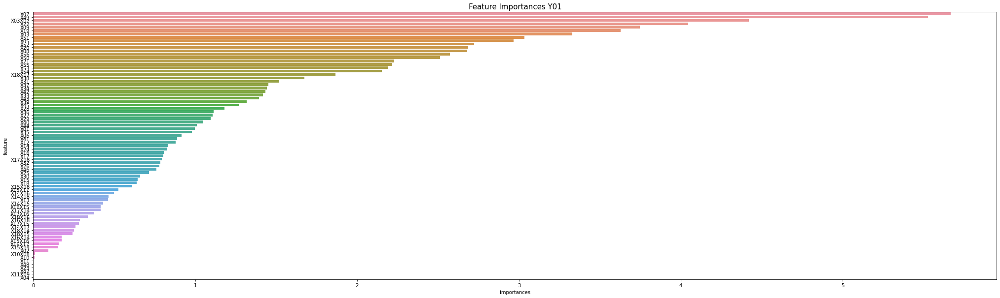

['X11', 'X48', 'X23', 'X47', 'X11X09', 'X04']
predict Y01
fit Y02


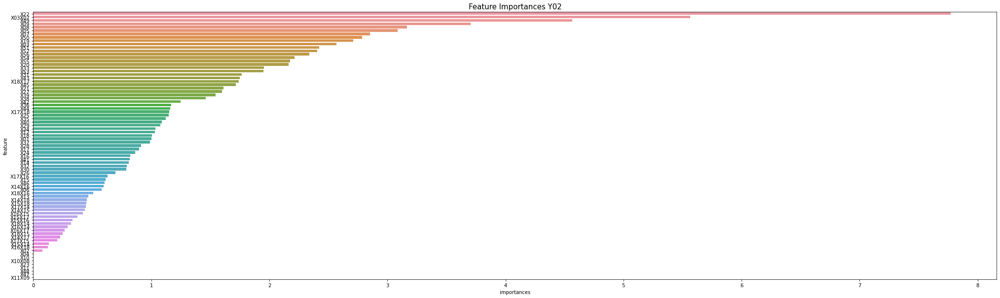

['X04', 'X10', 'X10X08', 'X23', 'X11', 'X48', 'X47', 'X11X09']
predict Y02
fit Y03


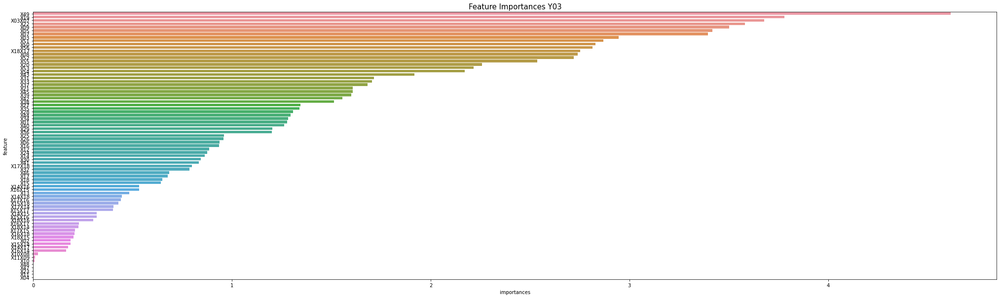

['X48', 'X47', 'X23', 'X11', 'X04']
predict Y03
fit Y04


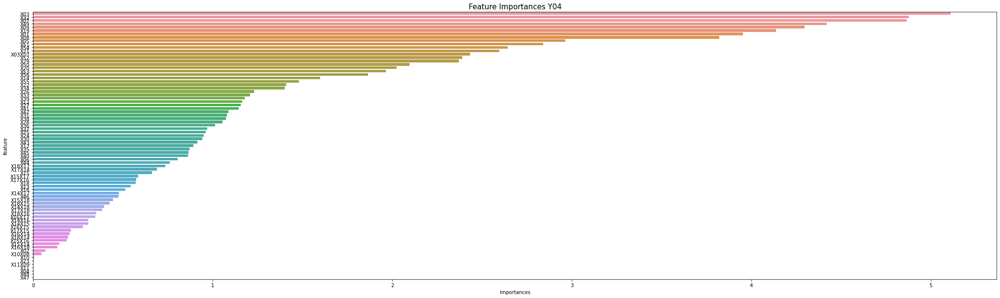

['X23', 'X11X09', 'X11', 'X04', 'X48', 'X47']
predict Y04
fit Y05


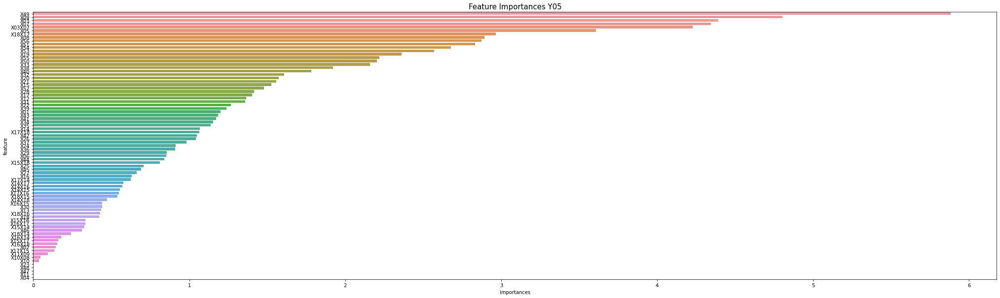

['X23', 'X48', 'X47', 'X11', 'X04']
predict Y05
fit Y06


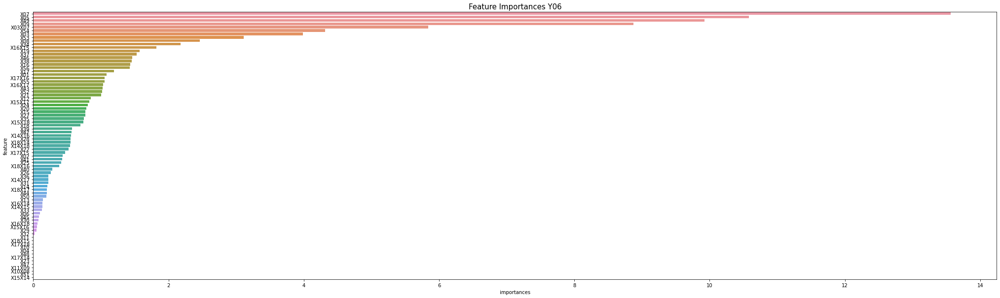

['X11', 'X18X15', 'X17X18', 'X10', 'X04', 'X48', 'X17X14', 'X23', 'X47', 'X11X09', 'X10X08', 'X51', 'X15X14']
predict Y06
fit Y07


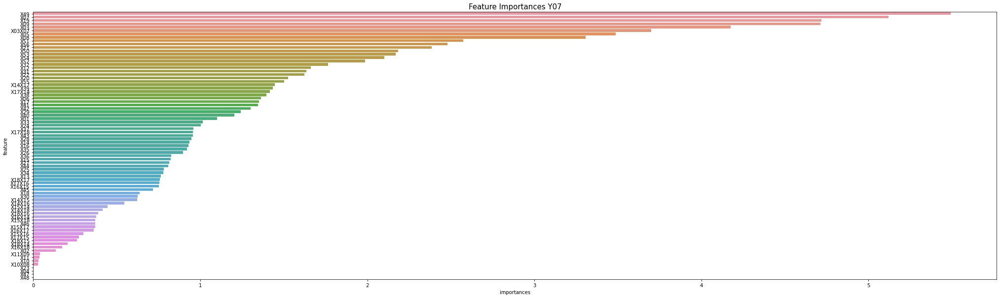

['X23', 'X04', 'X47', 'X48']
predict Y07
fit Y08


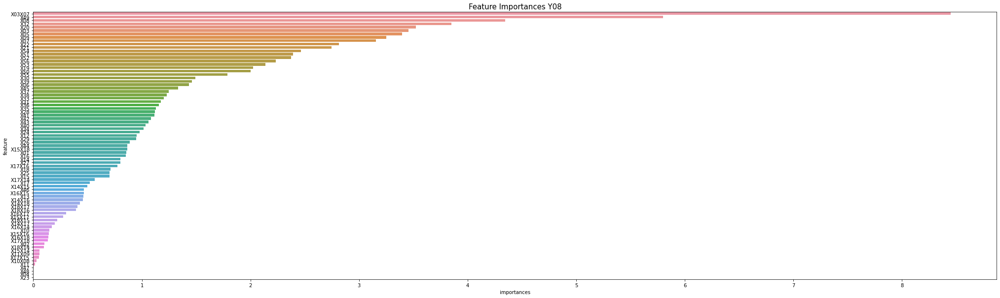

['X47', 'X48', 'X04', 'X23']
predict Y08
fit Y09


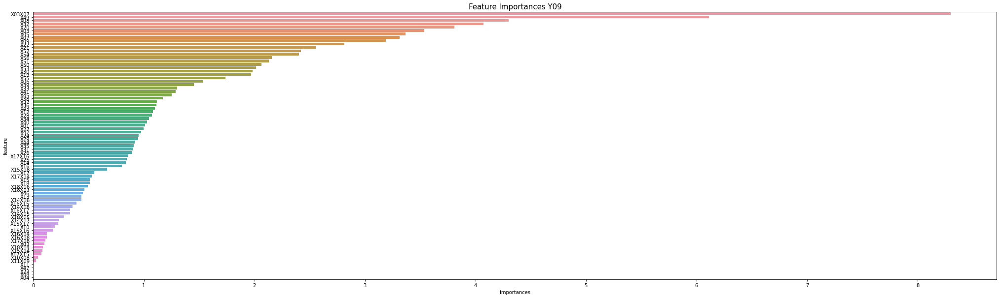

['X47', 'X23', 'X48', 'X04']
predict Y09
fit Y10


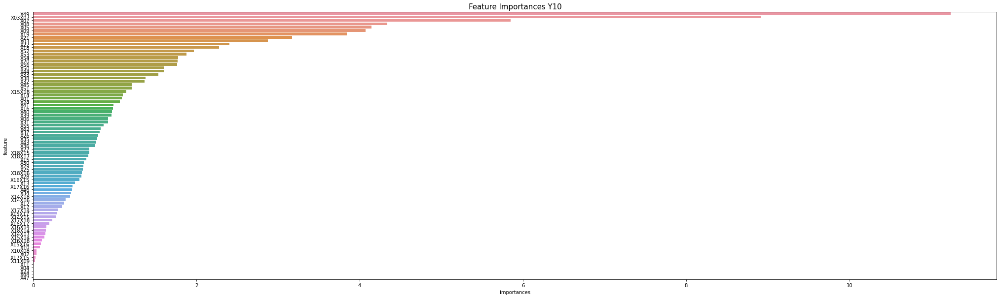

['X04', 'X23', 'X48', 'X47']
predict Y10
fit Y11


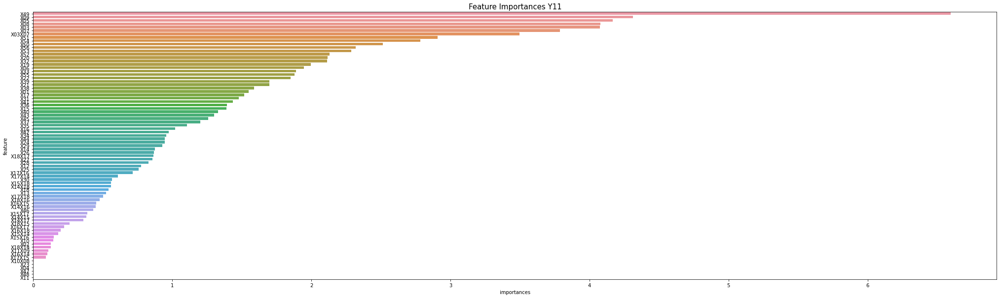

['X23', 'X04', 'X47', 'X48', 'X11']
predict Y11
fit Y12


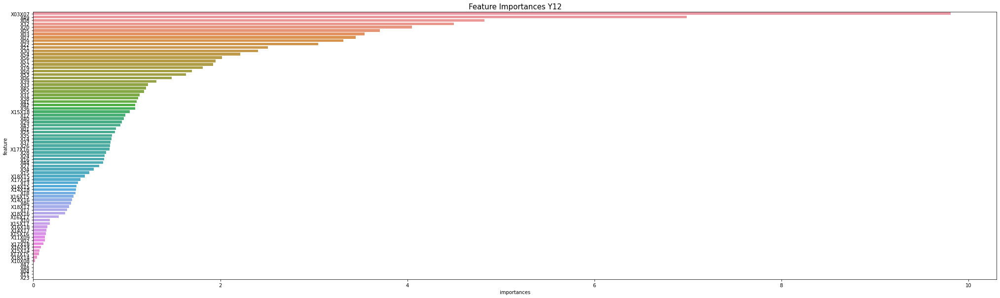

['X47', 'X48', 'X04', 'X11', 'X23']
predict Y12
fit Y13


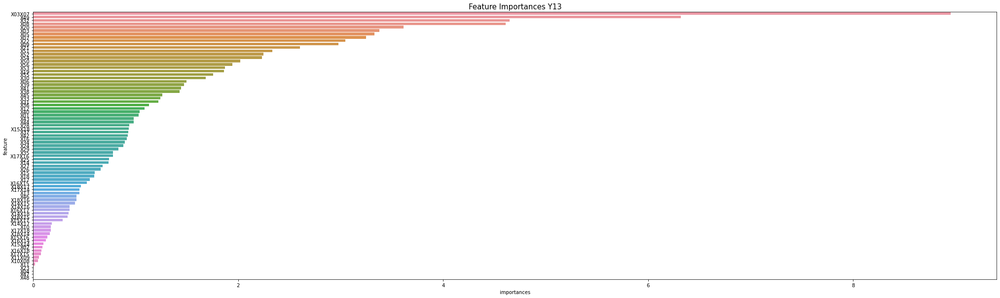

['X23', 'X04', 'X47', 'X48']
predict Y13
fit Y14


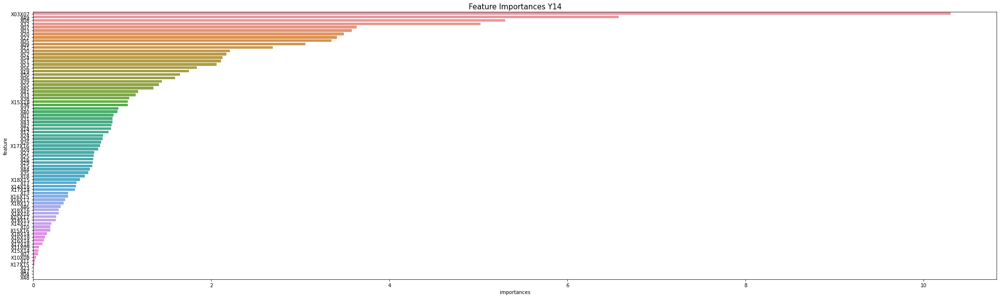

['X23', 'X47', 'X04', 'X48']
predict Y14
Fold 0 / lg_nrmse : 1.9313112263054506
fit Y01


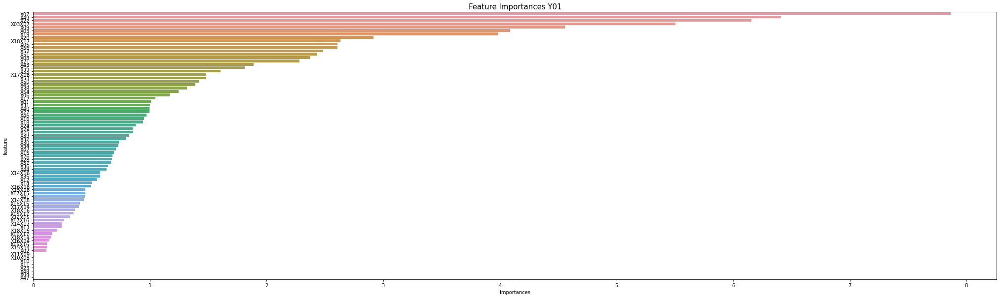

['X11X09', 'X10X08', 'X10', 'X11', 'X23', 'X48', 'X04', 'X47']
predict Y01
fit Y02


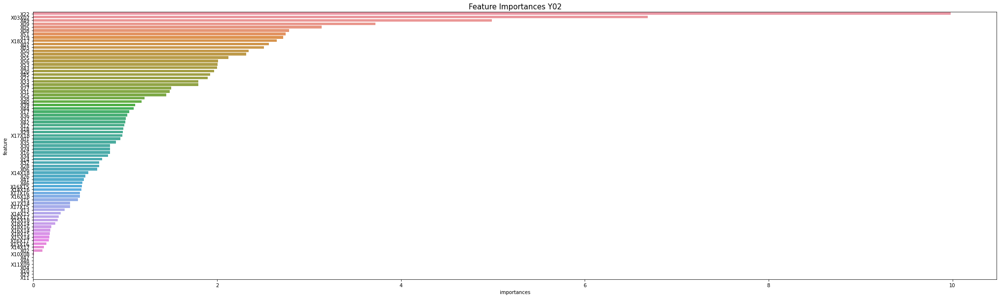

['X47', 'X48', 'X11X09', 'X04', 'X10', 'X23', 'X11']
predict Y02
fit Y03


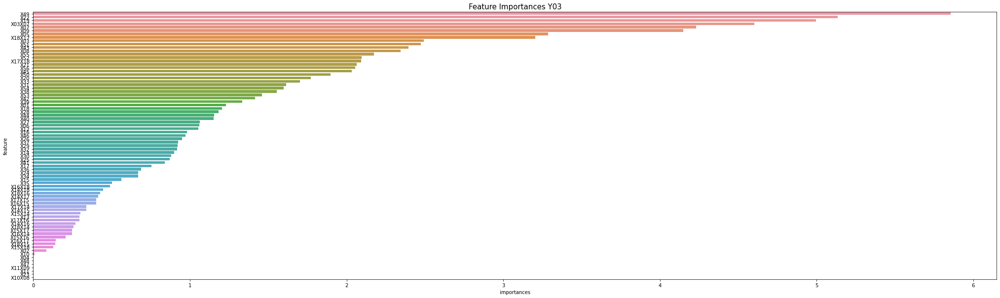

['X04', 'X48', 'X47', 'X11X09', 'X11', 'X23', 'X10X08']
predict Y03
fit Y04


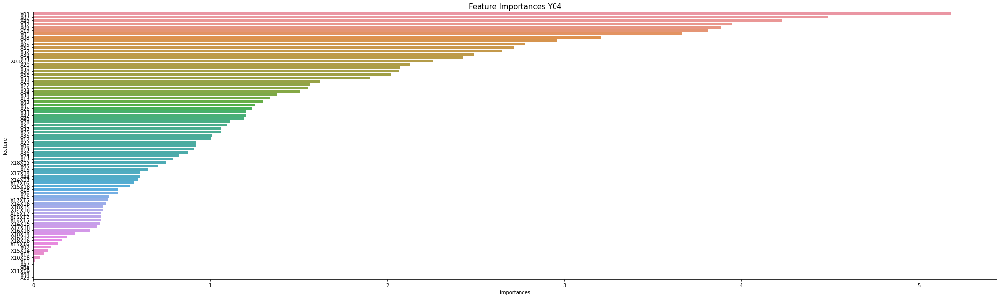

['X47', 'X04', 'X11X09', 'X48', 'X23']
predict Y04
fit Y05


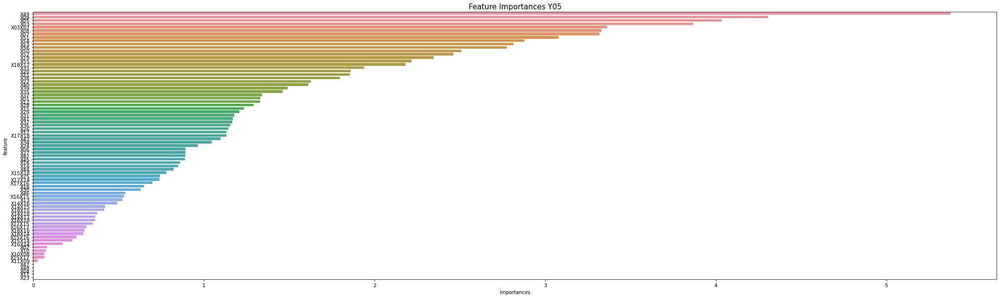

['X47', 'X48', 'X04', 'X11', 'X23']
predict Y05
fit Y06


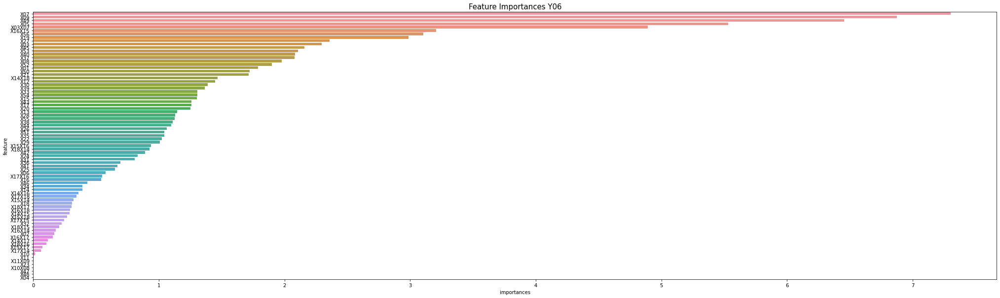

['X23', 'X10X08', 'X47', 'X48', 'X04']
predict Y06
fit Y07


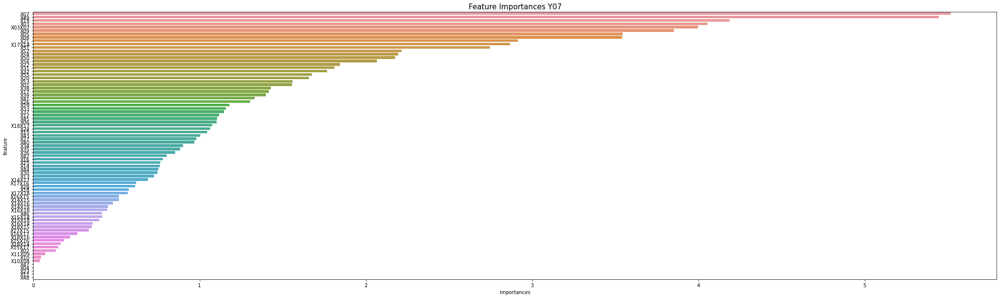

['X47', 'X04', 'X23', 'X11', 'X48']
predict Y07
fit Y08


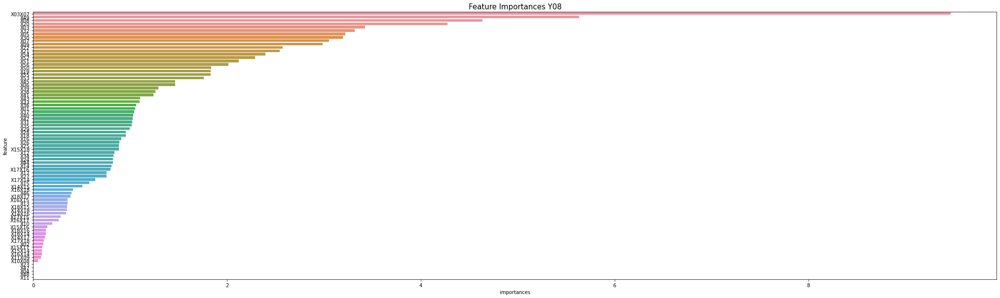

['X23', 'X47', 'X04', 'X48', 'X11']
predict Y08
fit Y09


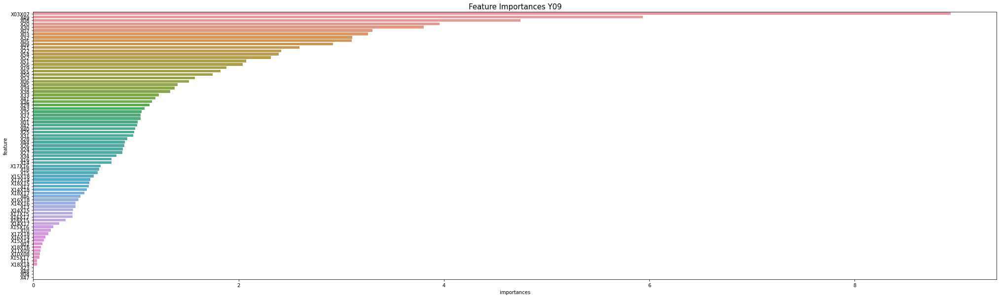

['X23', 'X48', 'X04', 'X47']
predict Y09
fit Y10


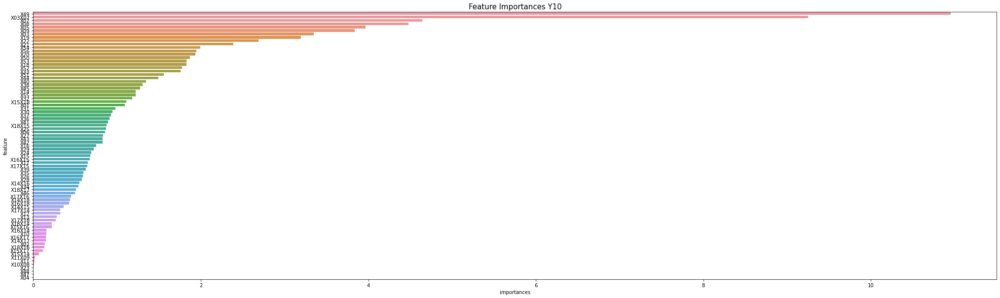

['X23', 'X48', 'X47', 'X04']
predict Y10
fit Y11


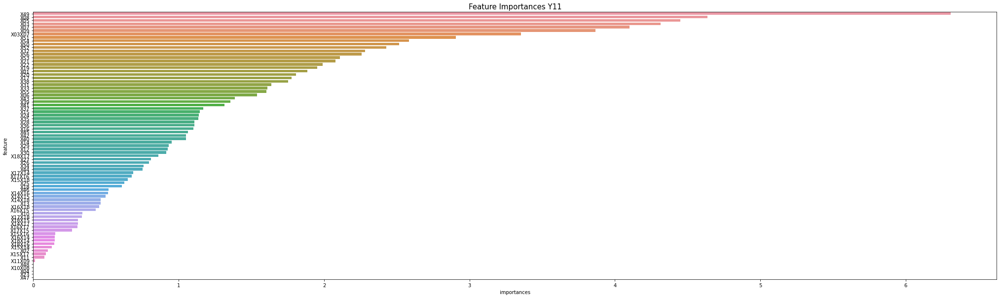

['X48', 'X10X08', 'X04', 'X23', 'X47']
predict Y11
fit Y12


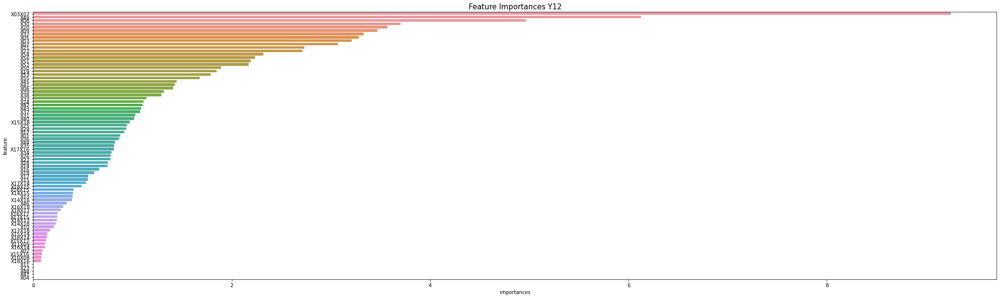

['X11', 'X23', 'X48', 'X47', 'X04']
predict Y12
fit Y13


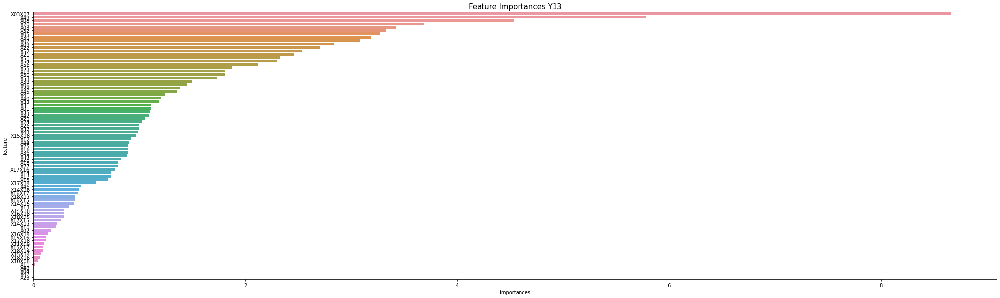

['X48', 'X04', 'X47', 'X23']
predict Y13
fit Y14


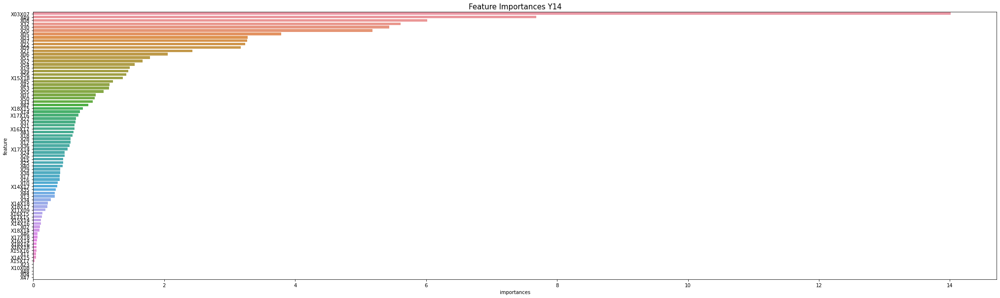

['X23', 'X10X08', 'X48', 'X04', 'X47']
predict Y14
Fold 1 / lg_nrmse : 1.936671833735493
fit Y01


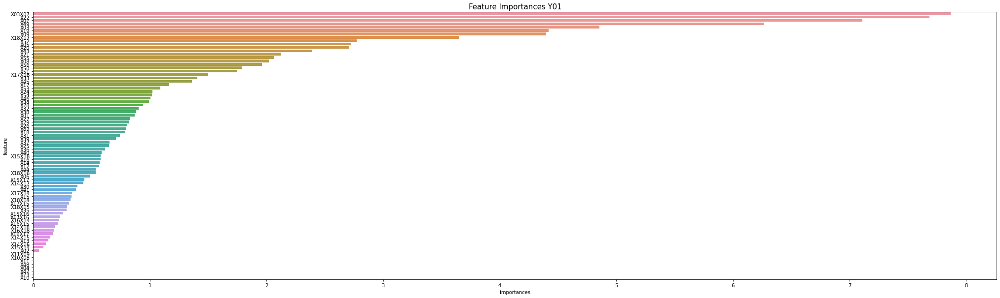

['X11X09', 'X10X08', 'X11', 'X48', 'X04', 'X47', 'X23', 'X10']
predict Y01
fit Y02


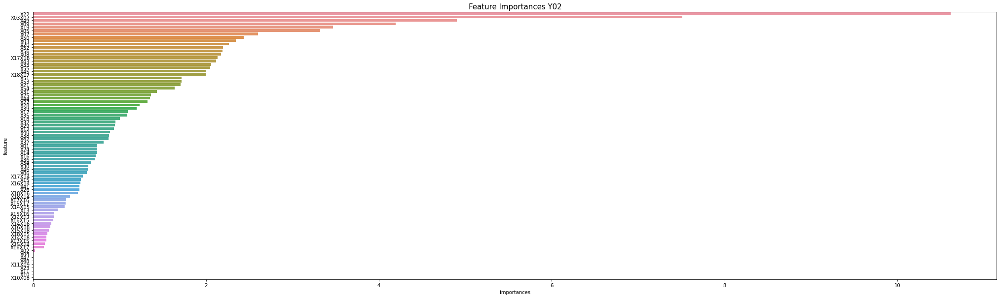

['X04', 'X47', 'X48', 'X11X09', 'X23', 'X11', 'X10', 'X10X08']
predict Y02
fit Y03


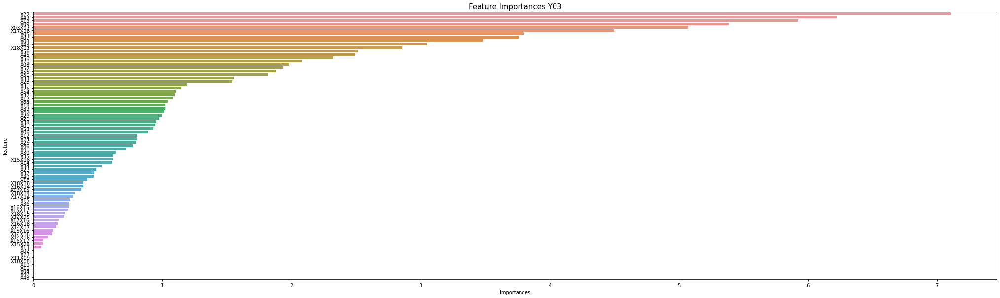

['X02', 'X23', 'X11X09', 'X10X08', 'X10', 'X11', 'X04', 'X47', 'X48']
predict Y03
fit Y04


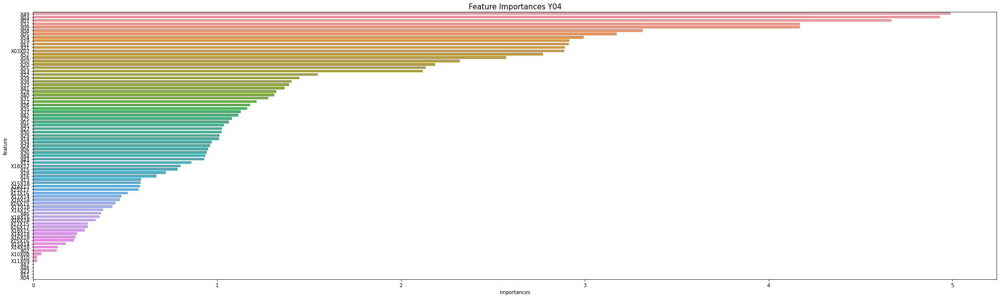

['X47', 'X48', 'X23', 'X11', 'X04']
predict Y04
fit Y05


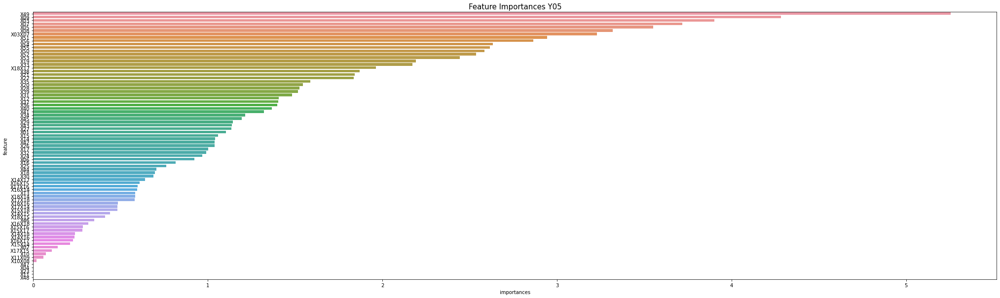

['X47', 'X04', 'X23', 'X11', 'X48']
predict Y05
fit Y06


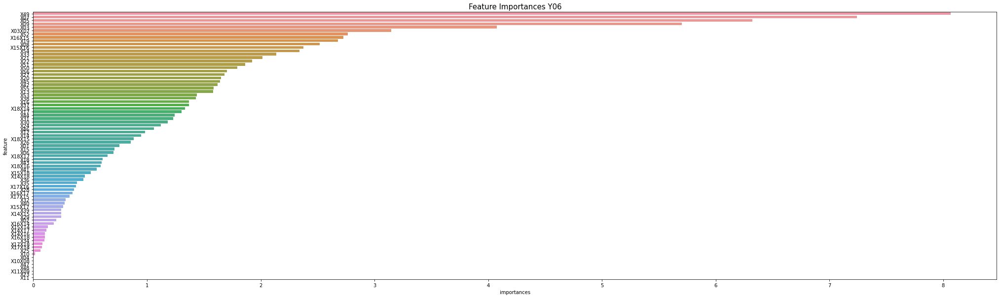

['X04', 'X10X08', 'X47', 'X48', 'X11X09', 'X23', 'X11']
predict Y06
fit Y07


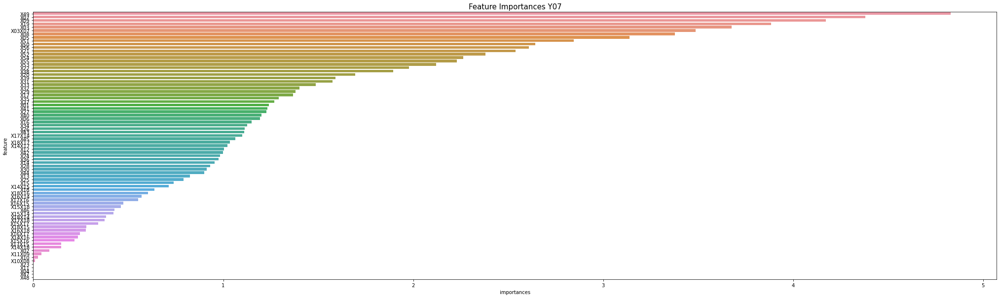

['X23', 'X11', 'X04', 'X47', 'X48']
predict Y07
fit Y08


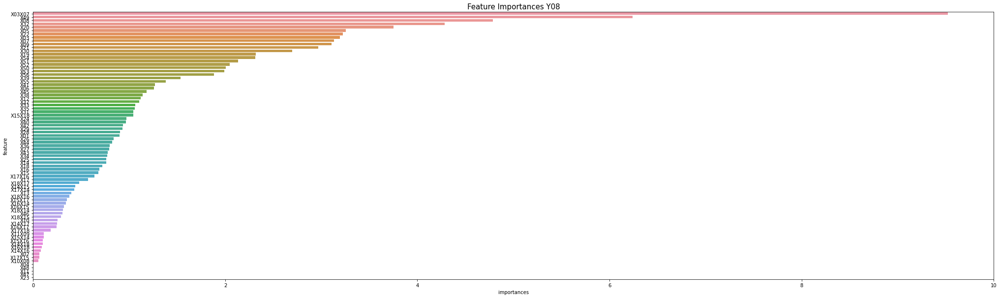

['X04', 'X48', 'X11', 'X47', 'X23']
predict Y08
fit Y09


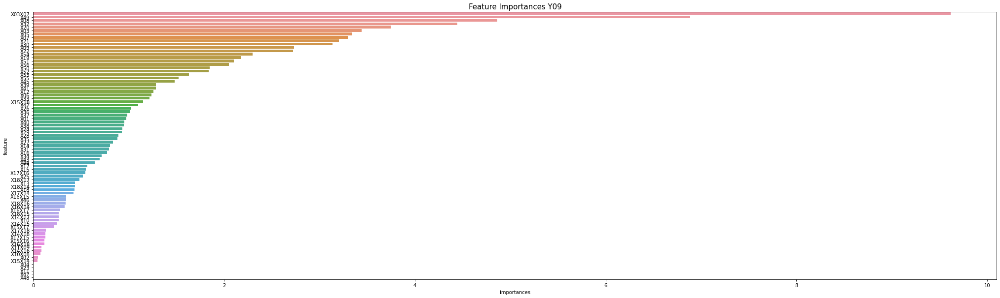

['X04', 'X23', 'X11', 'X47', 'X48']
predict Y09
fit Y10


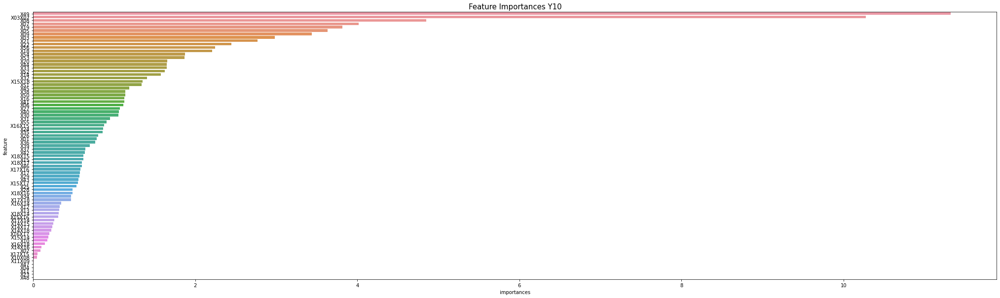

['X47', 'X04', 'X11', 'X23', 'X48']
predict Y10
fit Y11


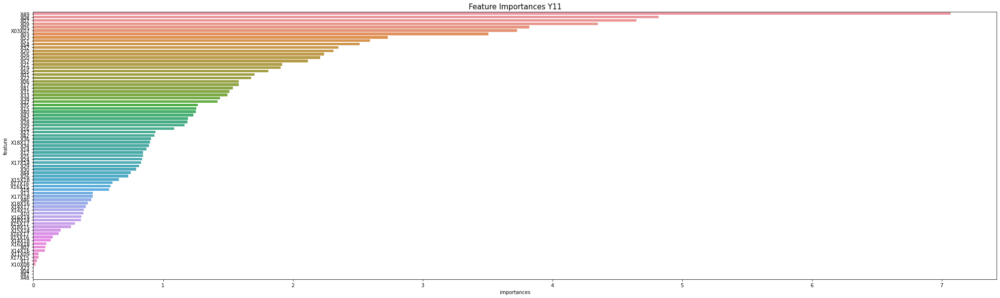

['X23', 'X04', 'X47', 'X48']
predict Y11
fit Y12


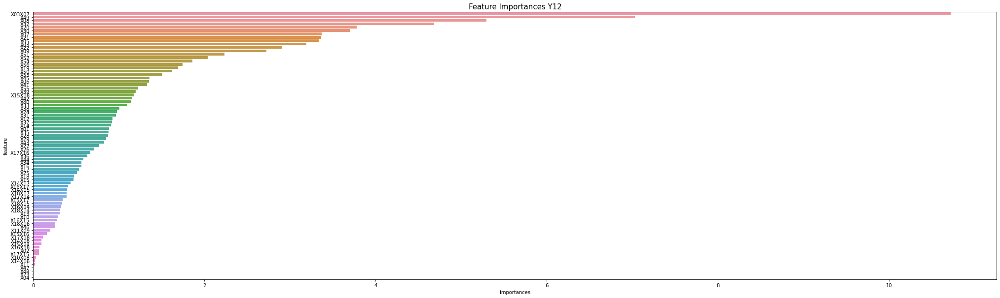

['X47', 'X48', 'X23', 'X04']
predict Y12
fit Y13


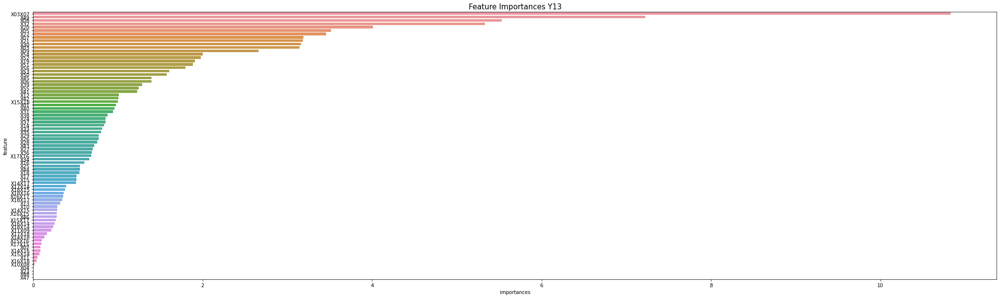

['X04', 'X23', 'X48', 'X47']
predict Y13
fit Y14


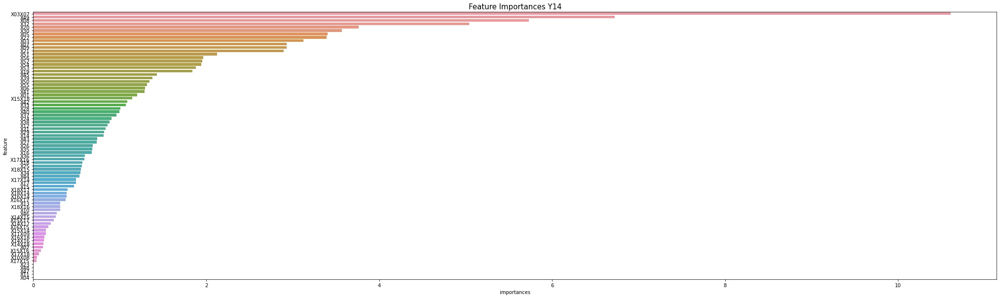

['X23', 'X48', 'X47', 'X11', 'X04']
predict Y14
Fold 2 / lg_nrmse : 1.9909075728563508
fit Y01


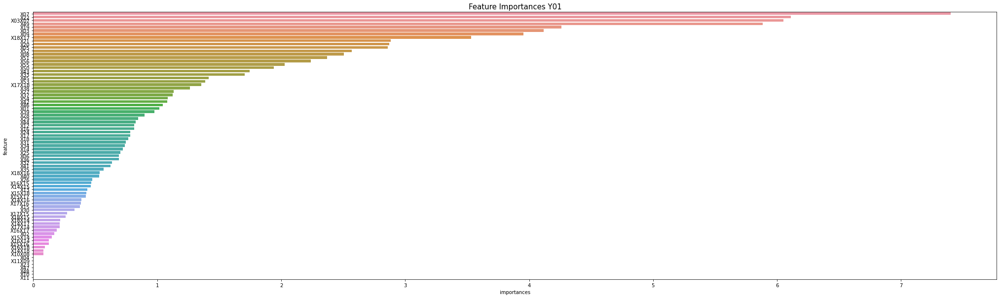

['X04', 'X11X09', 'X23', 'X47', 'X48', 'X10', 'X11']
predict Y01
fit Y02


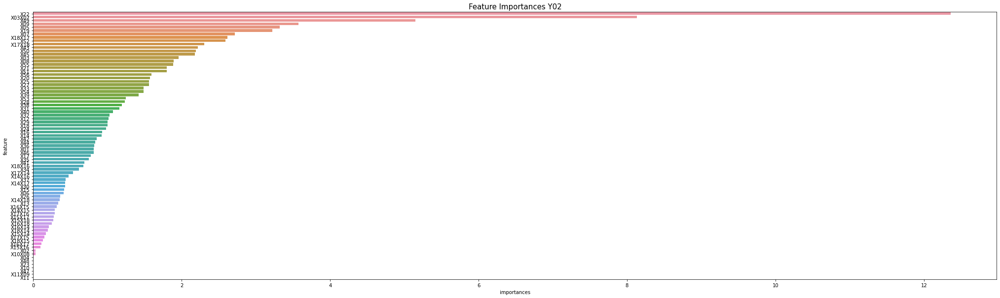

['X04', 'X48', 'X23', 'X10', 'X47', 'X11X09', 'X11']
predict Y02
fit Y03


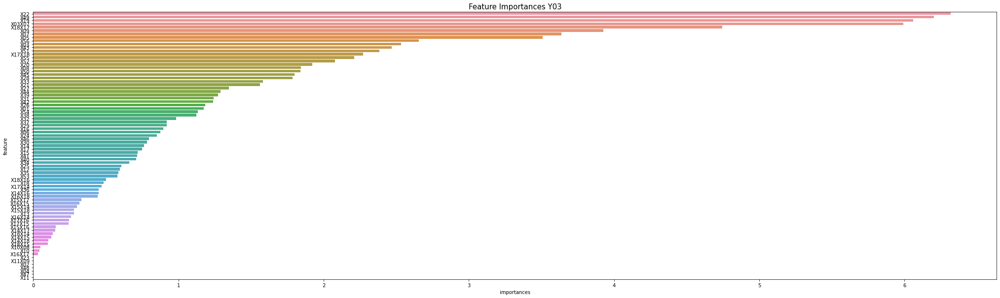

['X23', 'X11X09', 'X02', 'X48', 'X04', 'X47', 'X11']
predict Y03
fit Y04


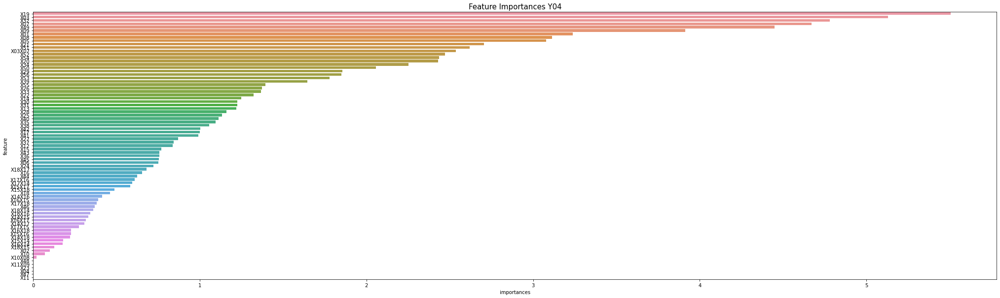

['X48', 'X11X09', 'X23', 'X04', 'X47', 'X11']
predict Y04
fit Y05


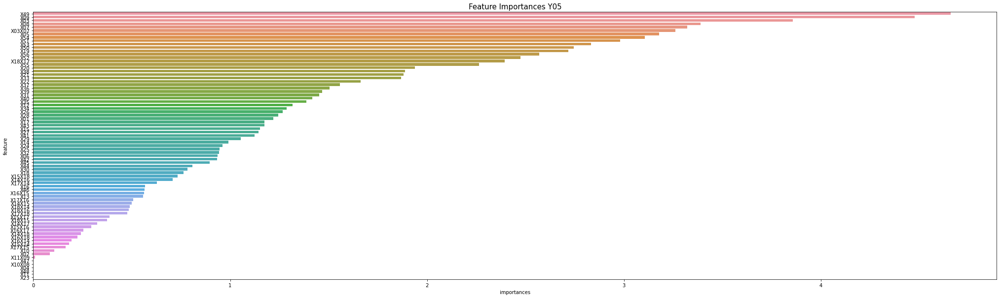

['X47', 'X10X08', 'X04', 'X48', 'X11', 'X23']
predict Y05
fit Y06


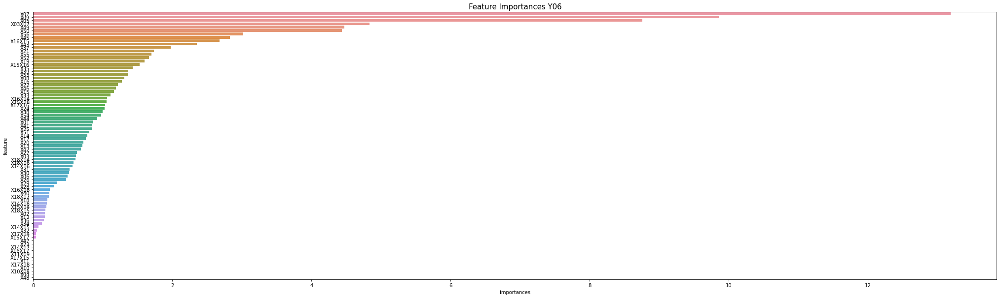

['X47', 'X23', 'X14X17', 'X16X17', 'X11X09', 'X17X15', 'X11', 'X17X18', 'X10', 'X10X08', 'X04', 'X48']
predict Y06
fit Y07


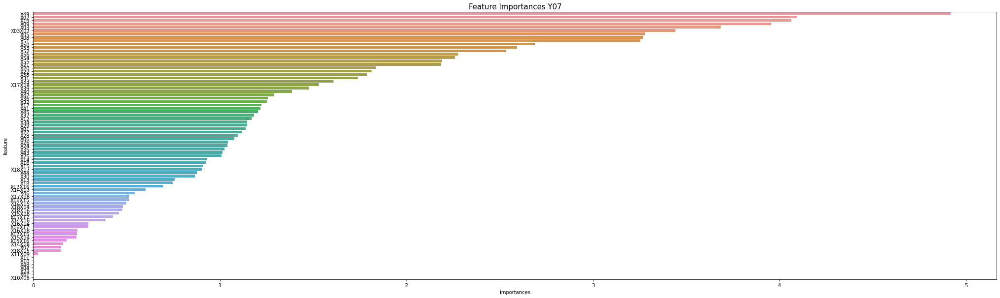

['X48', 'X04', 'X23', 'X47', 'X10X08']
predict Y07
fit Y08


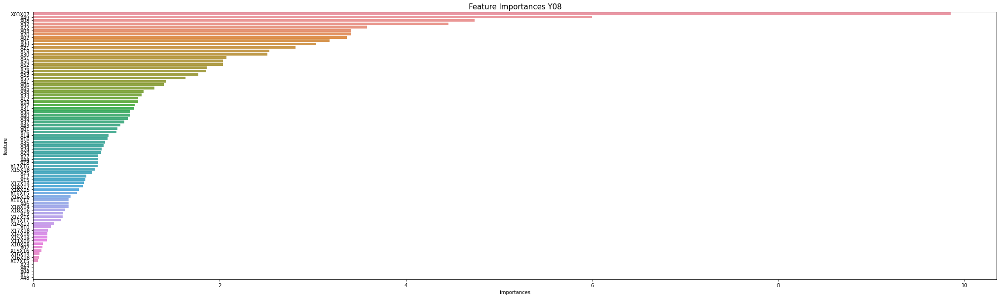

['X23', 'X47', 'X04', 'X11', 'X48']
predict Y08
fit Y09


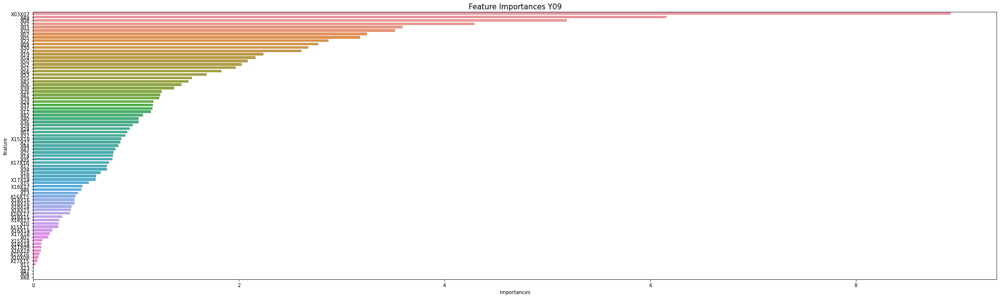

['X23', 'X47', 'X04', 'X48']
predict Y09
fit Y10


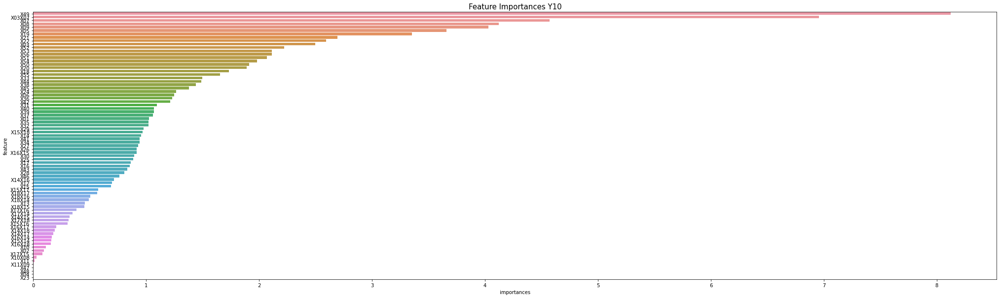

['X47', 'X48', 'X04', 'X23']
predict Y10
fit Y11


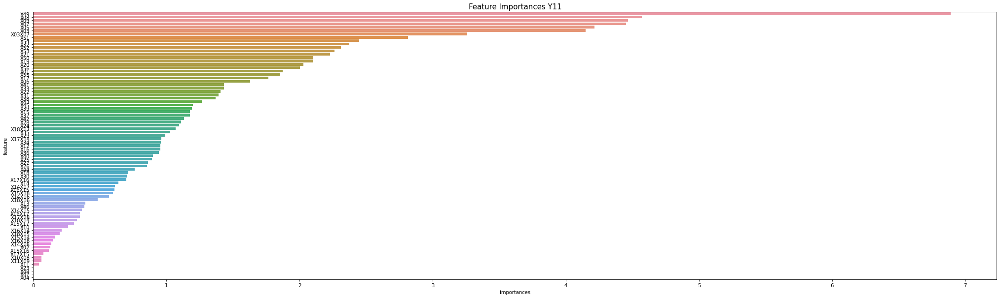

['X23', 'X48', 'X47', 'X04']
predict Y11
fit Y12


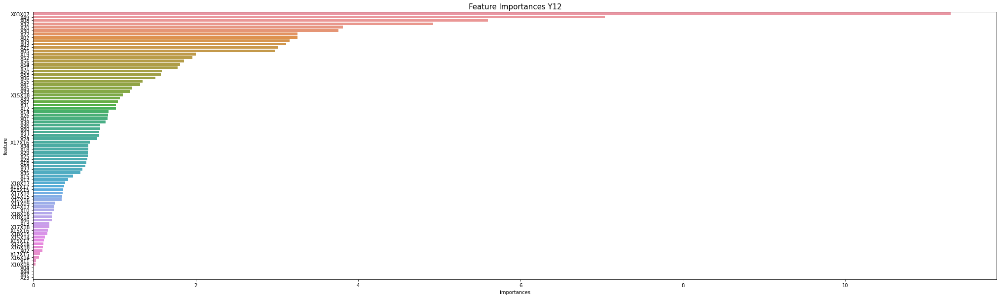

['X04', 'X48', 'X47', 'X23']
predict Y12
fit Y13


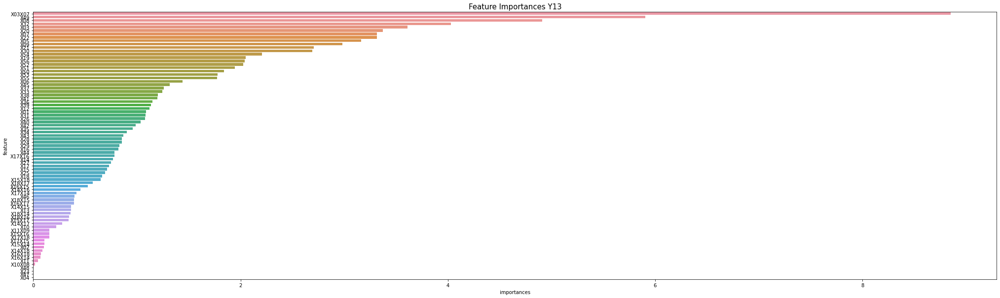

['X48', 'X23', 'X47', 'X04']
predict Y13
fit Y14


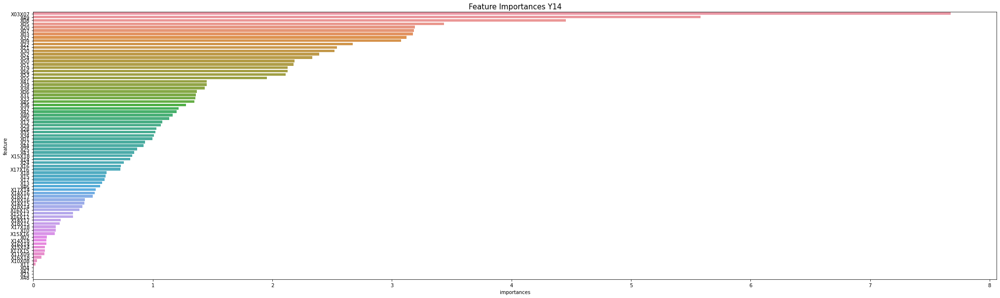

['X04', 'X47', 'X23', 'X48']
predict Y14
Fold 3 / lg_nrmse : 1.9475464264682467
fit Y01


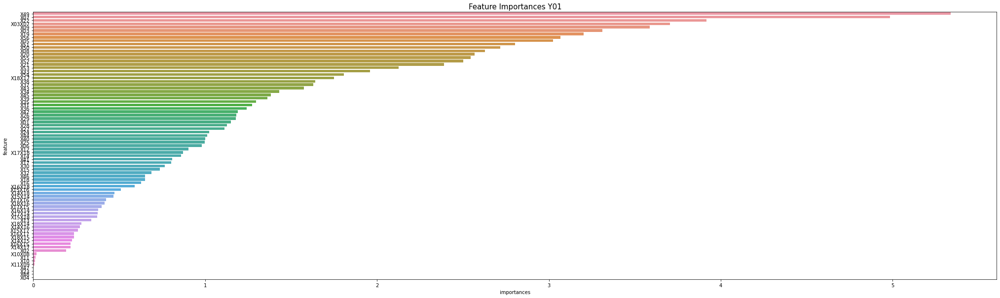

['X47', 'X23', 'X48', 'X04']
predict Y01
fit Y02


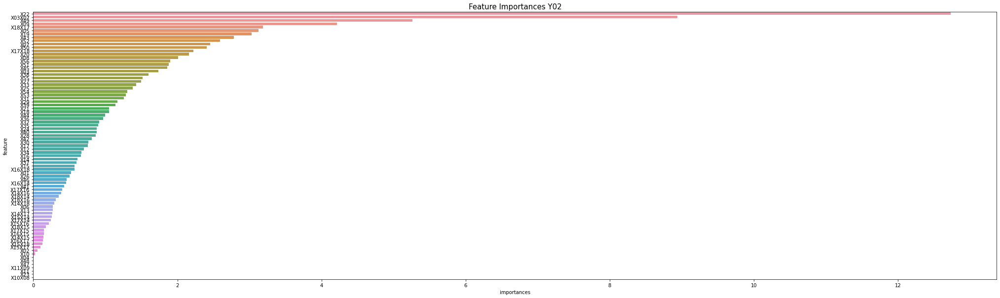

['X04', 'X48', 'X47', 'X11X09', 'X11', 'X23', 'X10X08']
predict Y02
fit Y03


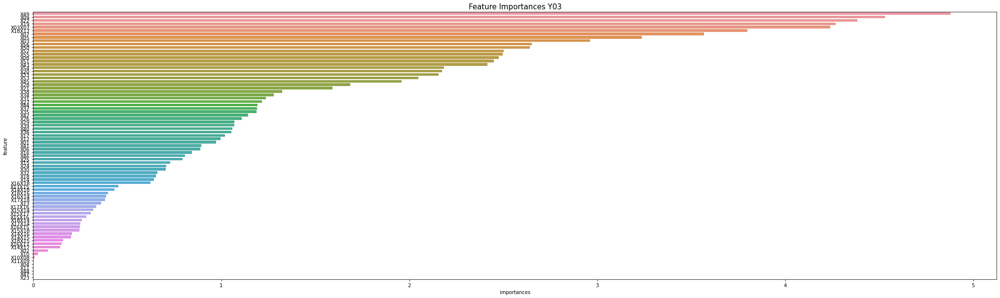

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y03
fit Y04


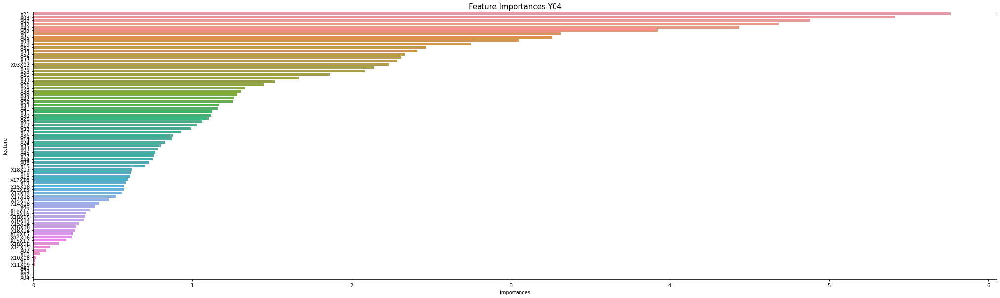

['X48', 'X23', 'X47', 'X04']
predict Y04
fit Y05


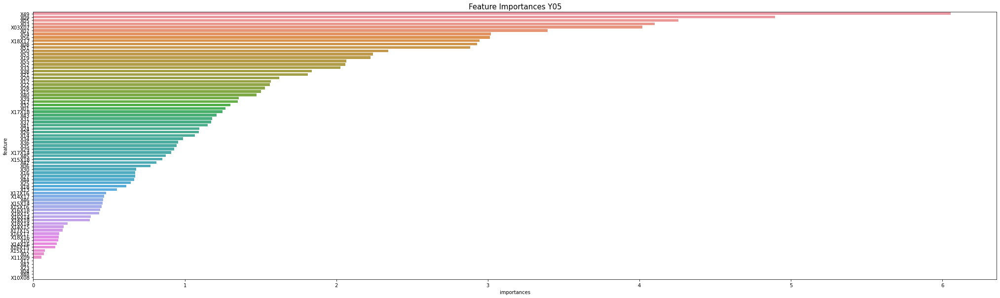

['X11', 'X47', 'X23', 'X04', 'X48', 'X10X08']
predict Y05
fit Y06


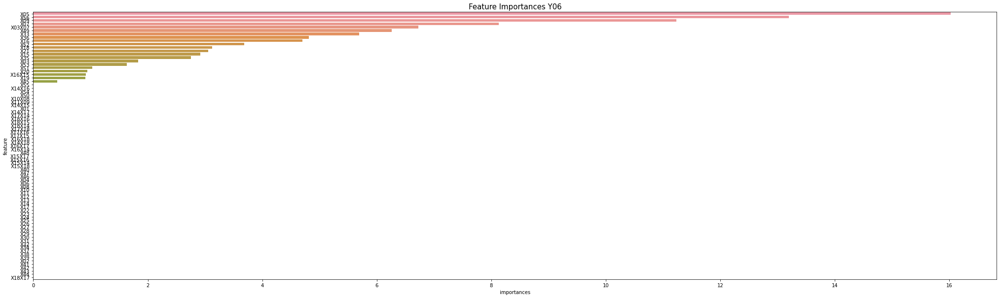

['X55', 'X14X16', 'X54', 'X50', 'X10X08', 'X11X09', 'X14X15', 'X01', 'X14X17', 'X17X14', 'X18X16', 'X18X15', 'X18X14', 'X17X18', 'X17X16', 'X17X15', 'X16X18', 'X14X18', 'X16X17', 'X16X14', 'X48', 'X15X17', 'X15X16', 'X15X14', 'X15X18', 'X40', 'X47', 'X46', 'X04', 'X06', 'X08', 'X10', 'X11', 'X12', 'X13', 'X14', 'X17', 'X22', 'X23', 'X24', 'X25', 'X26', 'X27', 'X28', 'X29', 'X30', 'X31', 'X32', 'X34', 'X37', 'X38', 'X39', 'X02', 'X41', 'X42', 'X43', 'X44', 'X18X17']
predict Y06
fit Y07


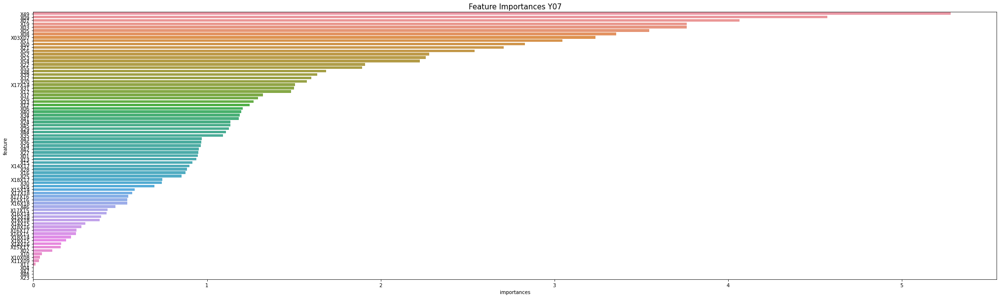

['X04', 'X47', 'X48', 'X23']
predict Y07
fit Y08


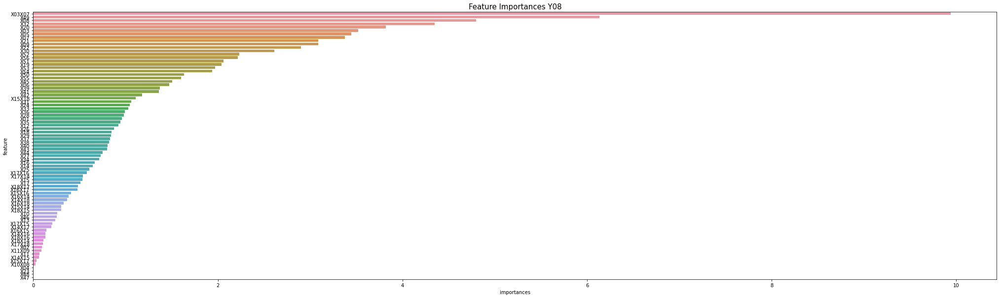

['X04', 'X23', 'X48', 'X47']
predict Y08
fit Y09


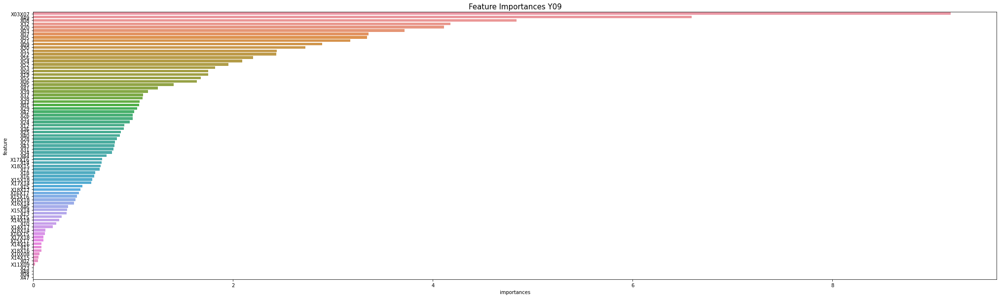

['X23', 'X48', 'X04', 'X47']
predict Y09
fit Y10


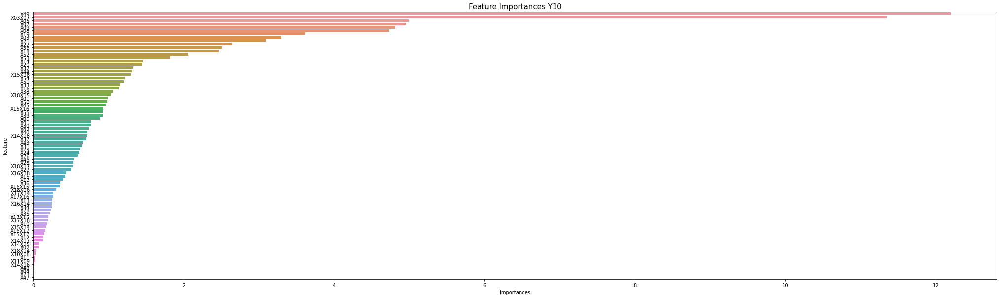

['X48', 'X04', 'X23', 'X47']
predict Y10
fit Y11


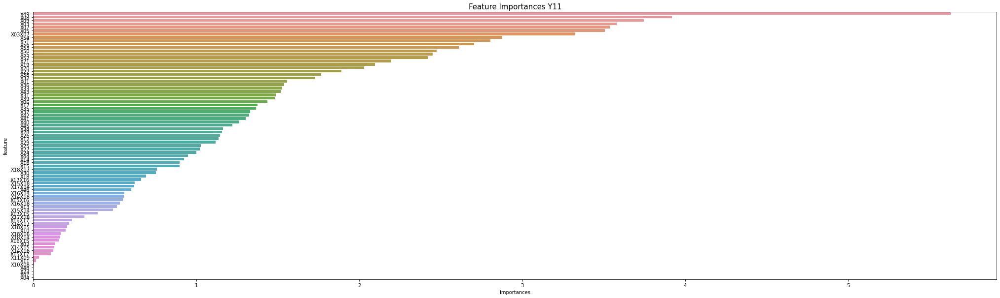

['X48', 'X23', 'X47', 'X04']
predict Y11
fit Y12


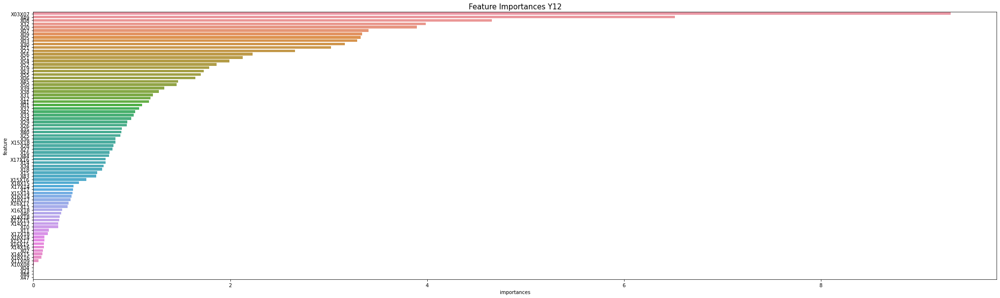

['X04', 'X23', 'X48', 'X47']
predict Y12
fit Y13


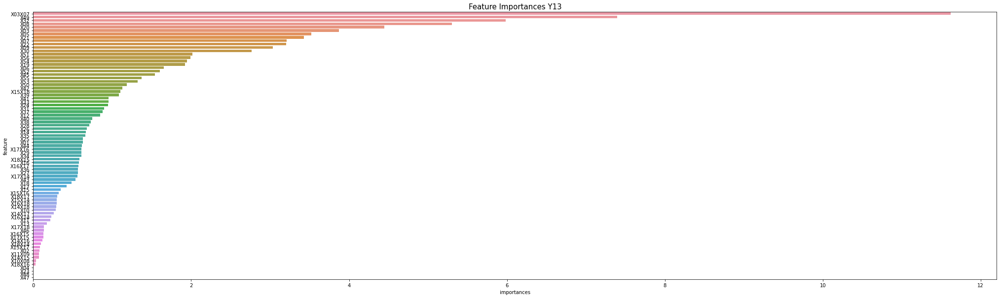

['X04', 'X23', 'X48', 'X47']
predict Y13
fit Y14


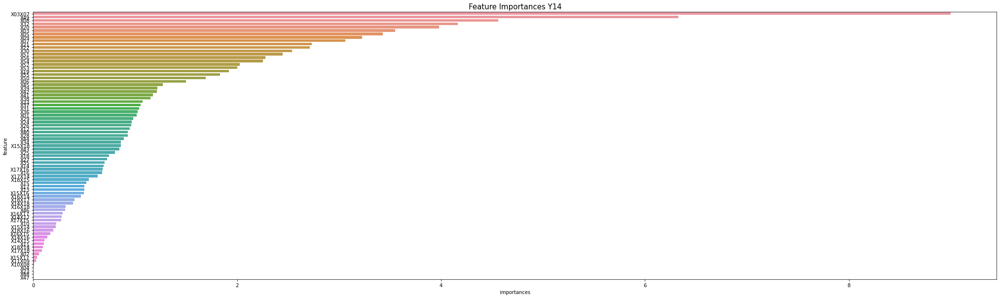

['X04', 'X23', 'X48', 'X47']
predict Y14
Fold 4 / lg_nrmse : 1.949345681341097
fit Y01


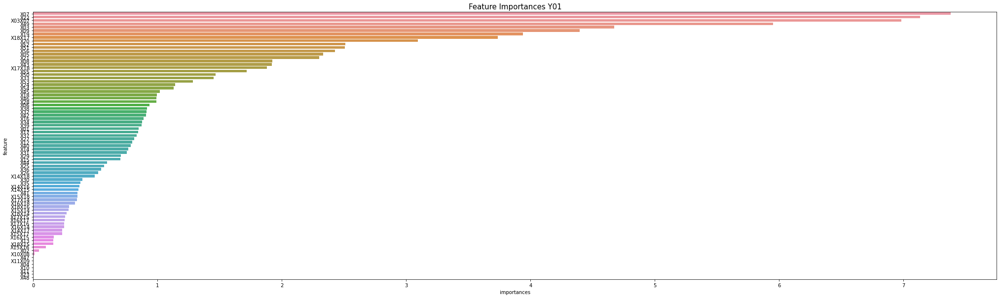

['X47', 'X11X09', 'X04', 'X10', 'X11', 'X23', 'X48']
predict Y01
fit Y02


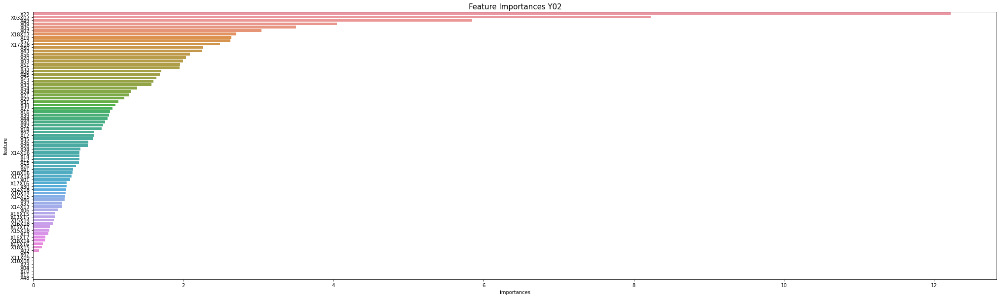

['X47', 'X11X09', 'X10X08', 'X23', 'X04', 'X10', 'X11', 'X48']
predict Y02
fit Y03


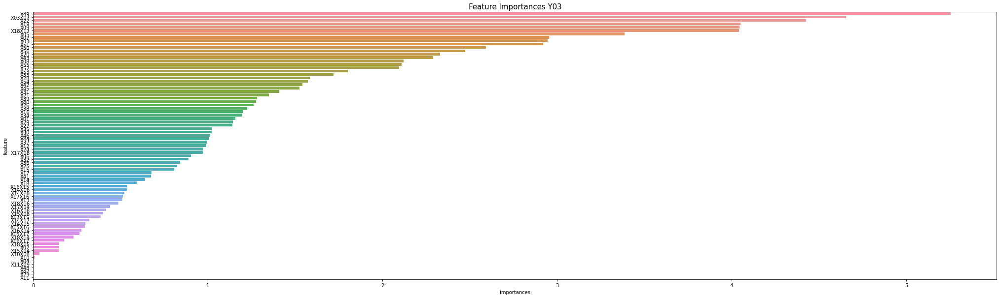

['X04', 'X11X09', 'X48', 'X47', 'X23', 'X11']
predict Y03
fit Y04


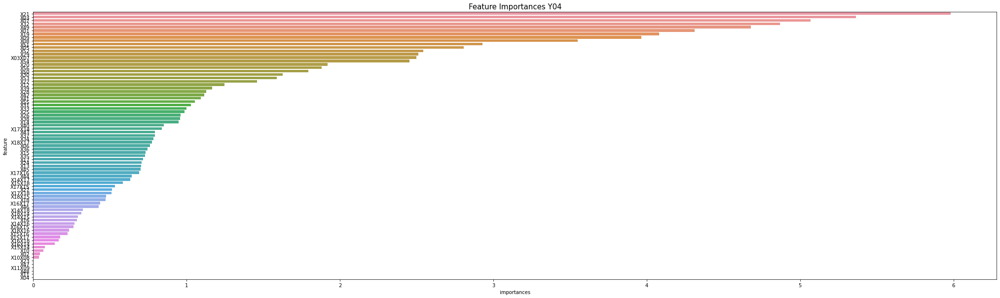

['X23', 'X47', 'X11X09', 'X48', 'X11', 'X04']
predict Y04
fit Y05


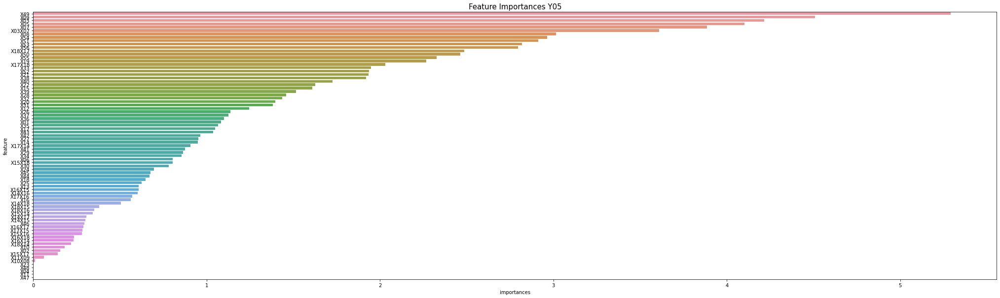

['X23', 'X48', 'X04', 'X11', 'X47']
predict Y05
fit Y06


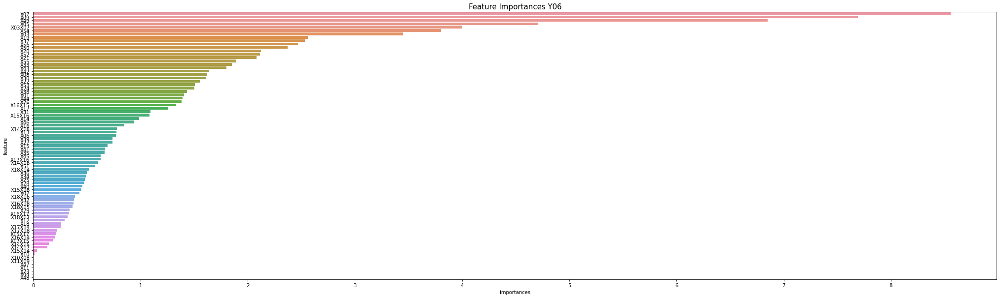

['X47', 'X11', 'X23', 'X04', 'X48']
predict Y06
fit Y07


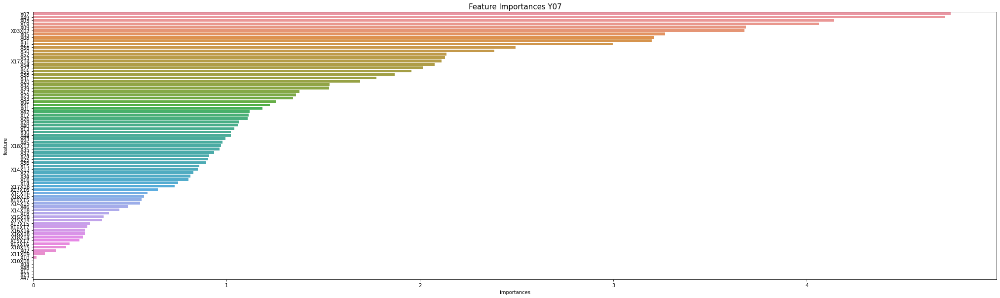

['X10X08', 'X04', 'X48', 'X11', 'X23', 'X47']
predict Y07
fit Y08


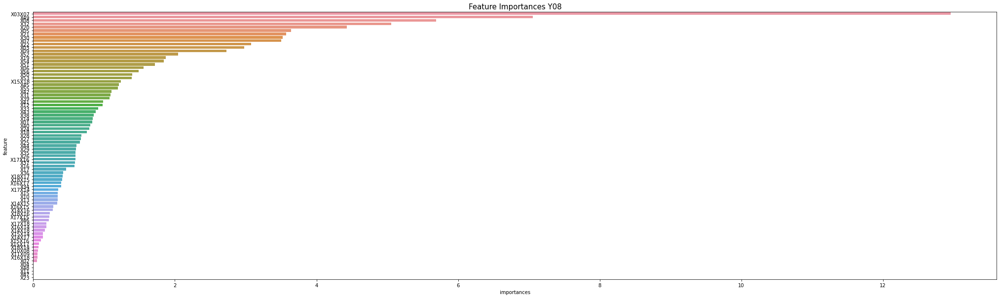

['X04', 'X48', 'X11', 'X47', 'X23']
predict Y08
fit Y09


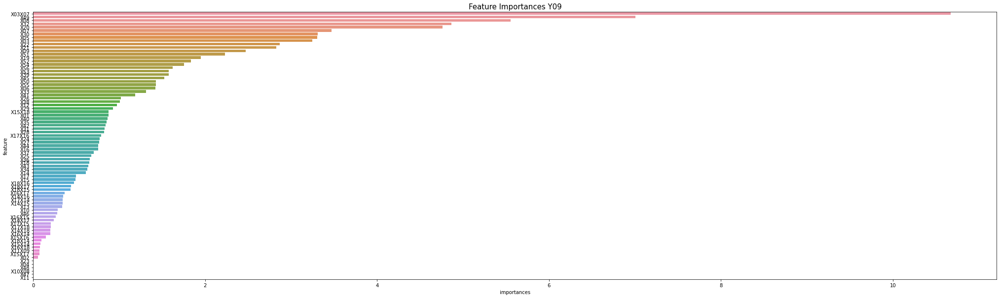

['X23', 'X04', 'X48', 'X10X08', 'X47', 'X11']
predict Y09
fit Y10


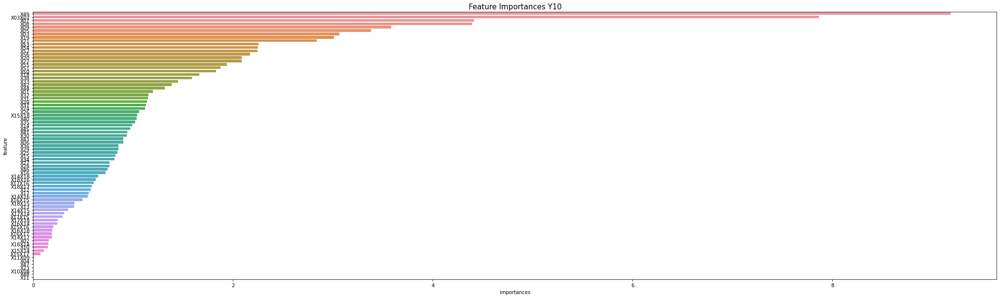

['X04', 'X47', 'X23', 'X10X08', 'X48', 'X11']
predict Y10
fit Y11


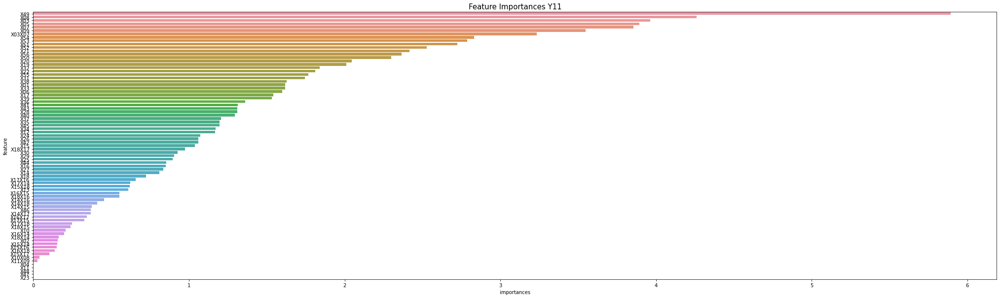

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y11
fit Y12


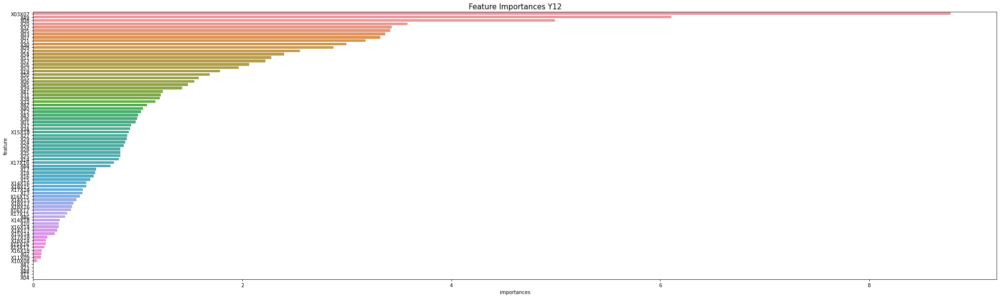

['X47', 'X23', 'X48', 'X11', 'X04']
predict Y12
fit Y13


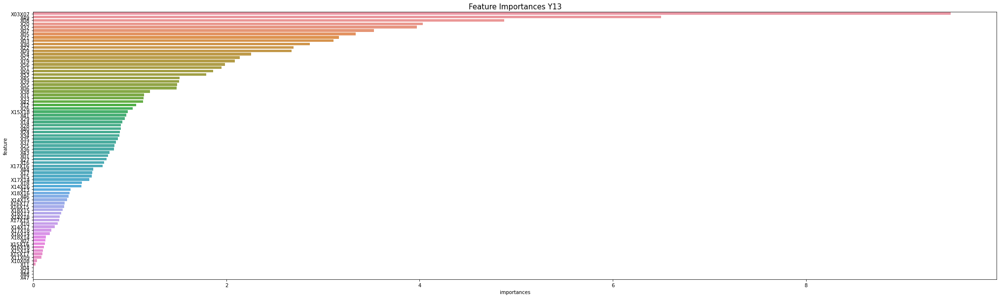

['X04', 'X23', 'X48', 'X47']
predict Y13
fit Y14


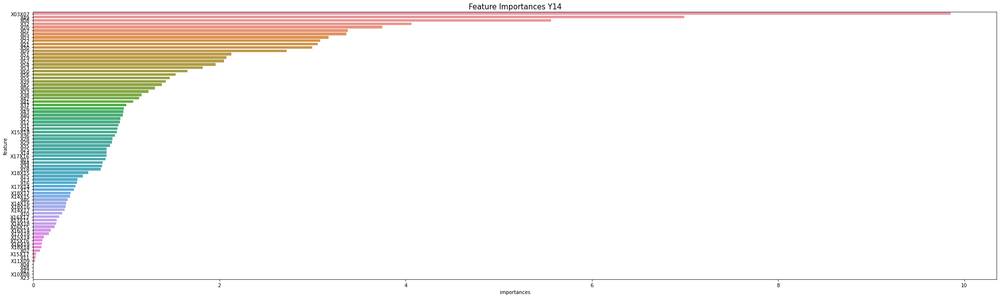

['X04', 'X48', 'X47', 'X10X08', 'X23']
predict Y14
Fold 5 / lg_nrmse : 1.943974637600014
fit Y01


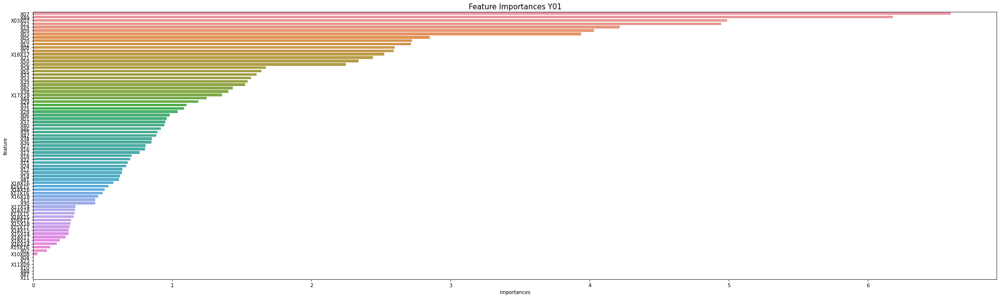

['X04', 'X23', 'X11X09', 'X10', 'X48', 'X47', 'X11']
predict Y01
fit Y02


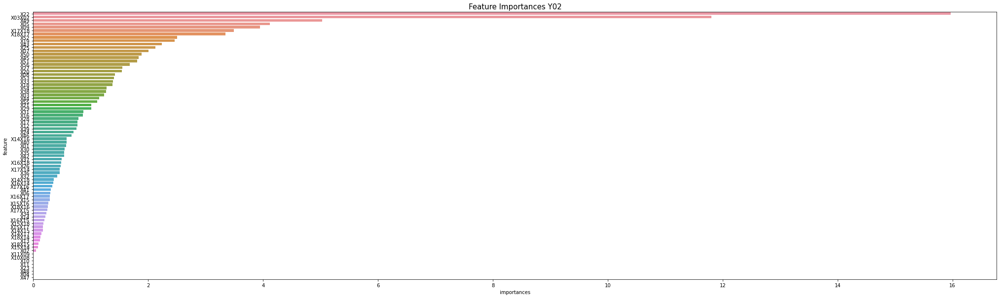

['X11X09', 'X10X08', 'X10', 'X11', 'X23', 'X48', 'X04', 'X47']
predict Y02
fit Y03


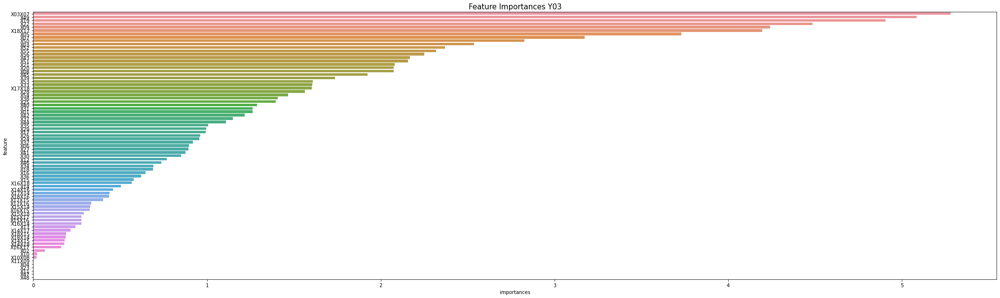

['X11X09', 'X04', 'X23', 'X11', 'X47', 'X48']
predict Y03
fit Y04


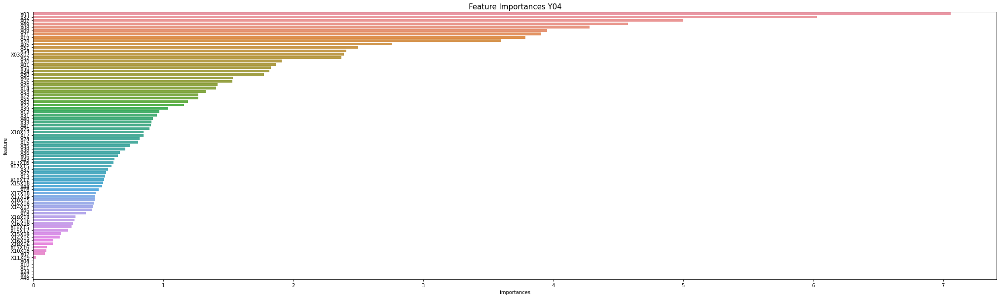

['X04', 'X10', 'X11', 'X23', 'X47', 'X48']
predict Y04
fit Y05


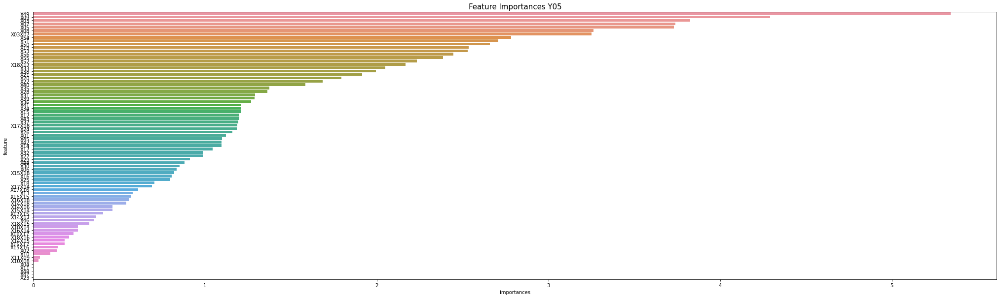

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y05
fit Y06


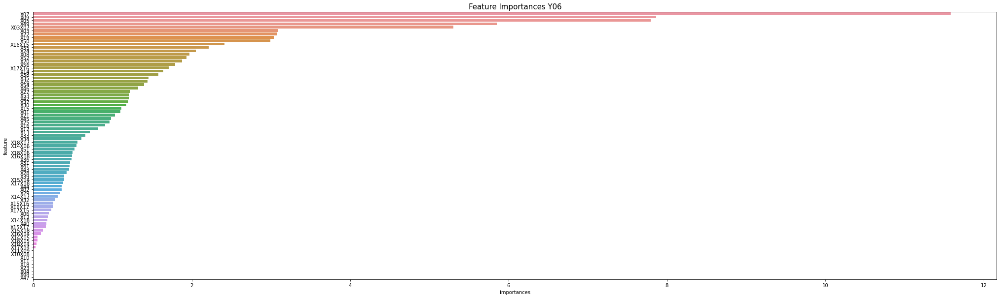

['X11X09', 'X10X08', 'X10', 'X11', 'X18', 'X23', 'X04', 'X48', 'X47']
predict Y06
fit Y07


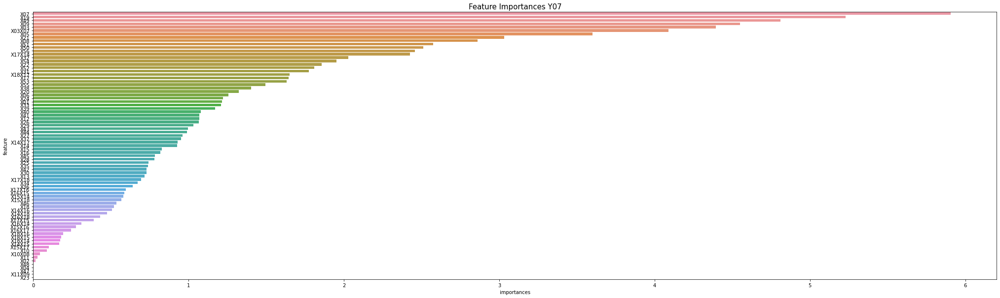

['X48', 'X04', 'X47', 'X11X09', 'X23']
predict Y07
fit Y08


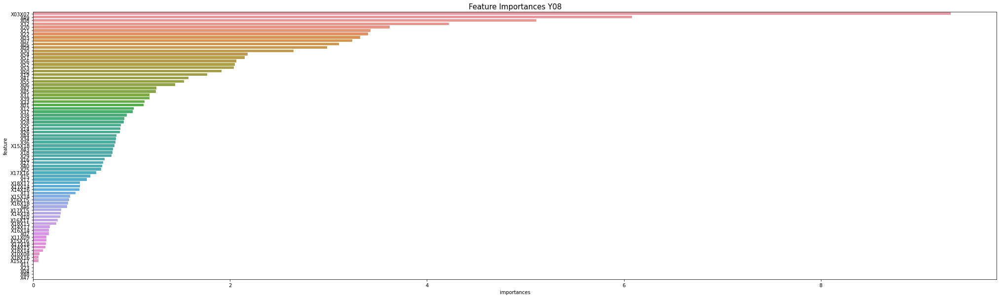

['X11', 'X23', 'X04', 'X48', 'X47']
predict Y08
fit Y09


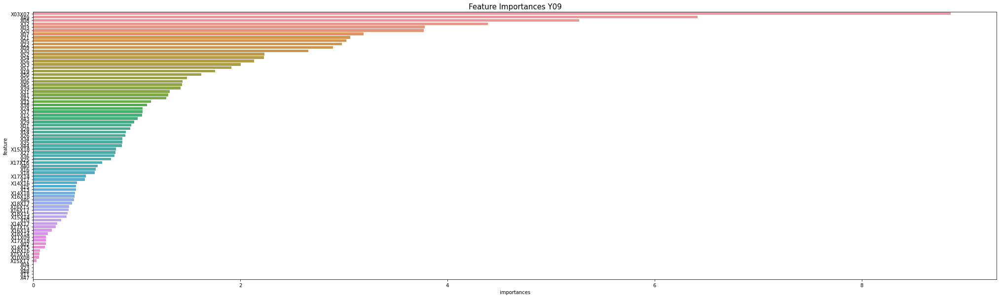

['X04', 'X23', 'X48', 'X11', 'X47']
predict Y09
fit Y10


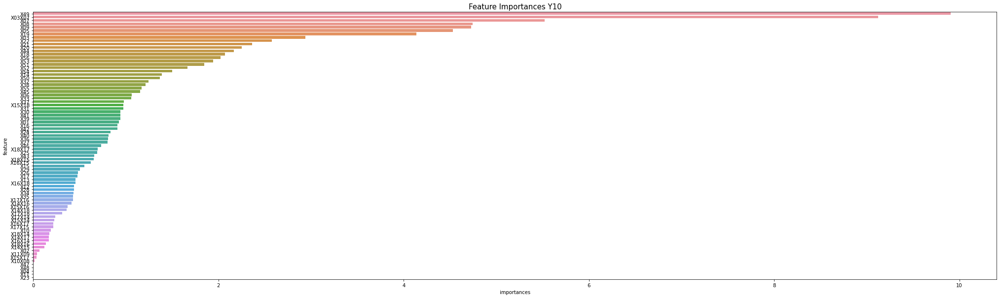

['X47', 'X48', 'X04', 'X11', 'X23']
predict Y10
fit Y11


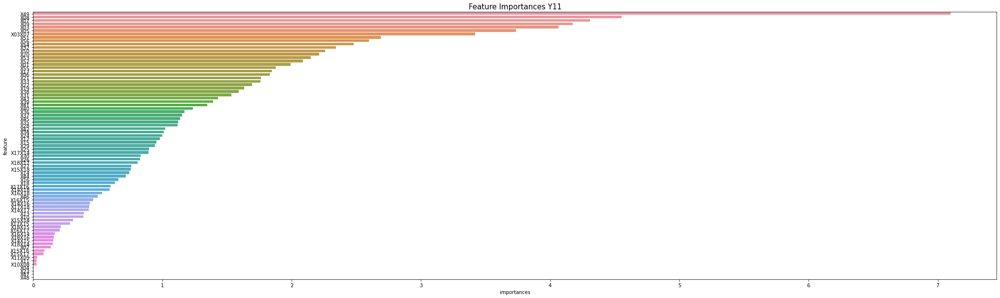

['X04', 'X23', 'X47', 'X48']
predict Y11
fit Y12


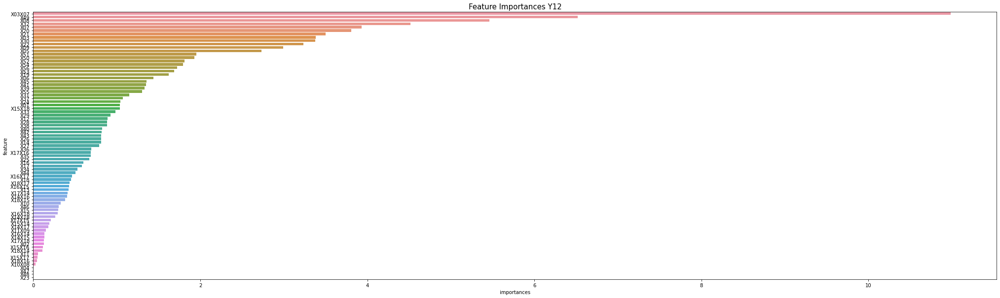

['X04', 'X47', 'X48', 'X23']
predict Y12
fit Y13


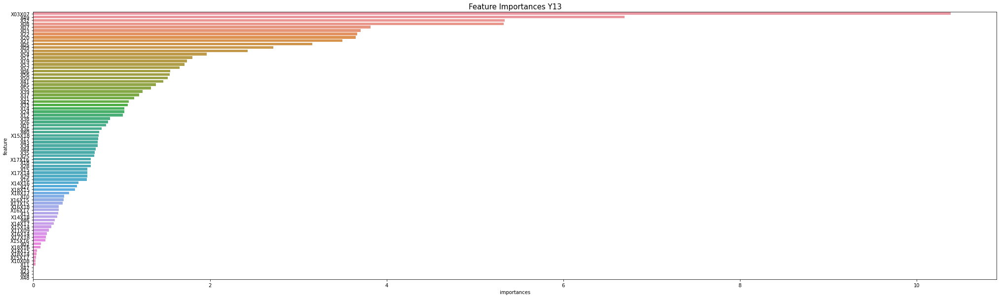

['X47', 'X23', 'X04', 'X48']
predict Y13
fit Y14


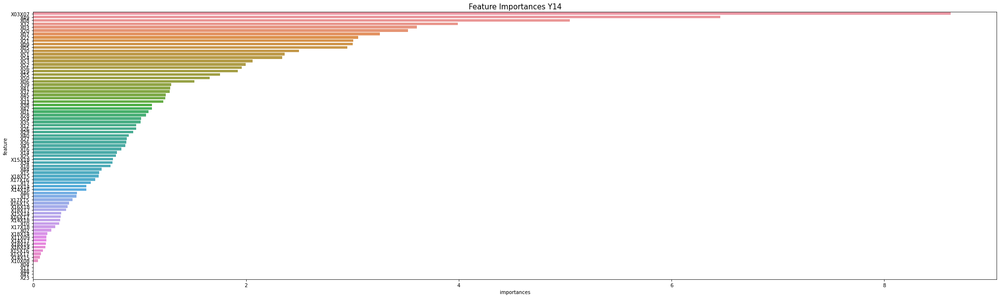

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y14
Fold 6 / lg_nrmse : 1.9820809544038231
fit Y01


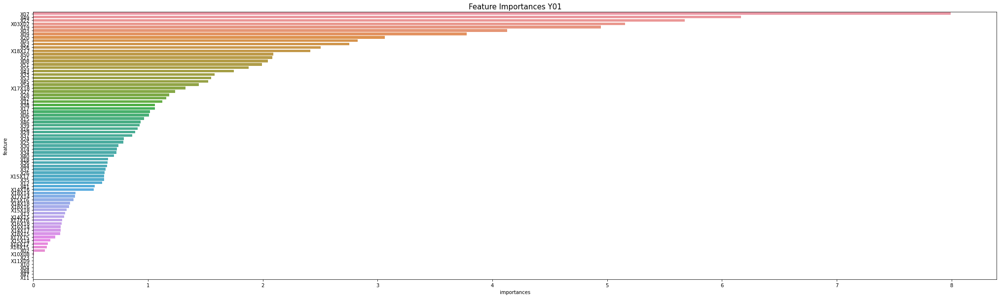

['X23', 'X11X09', 'X10', 'X04', 'X48', 'X47', 'X11']
predict Y01
fit Y02


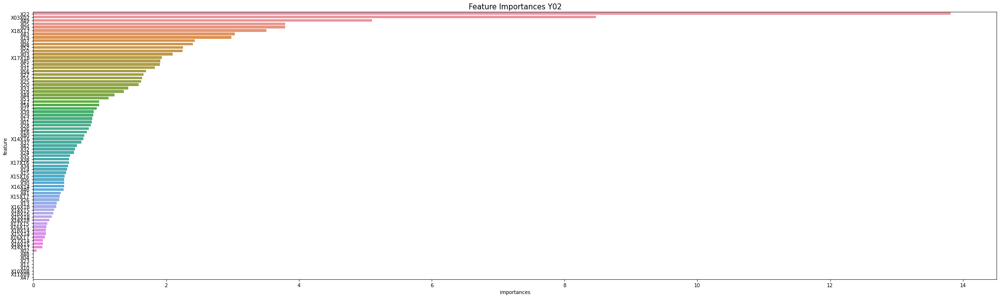

['X48', 'X04', 'X23', 'X11', 'X10', 'X10X08', 'X11X09', 'X47']
predict Y02
fit Y03


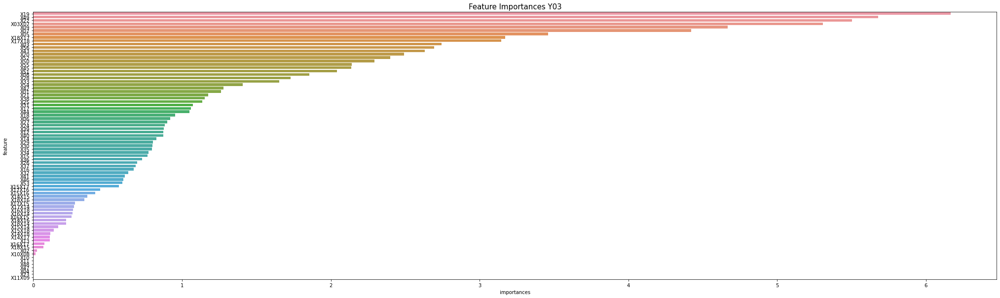

['X10', 'X11', 'X48', 'X47', 'X04', 'X23', 'X11X09']
predict Y03
fit Y04


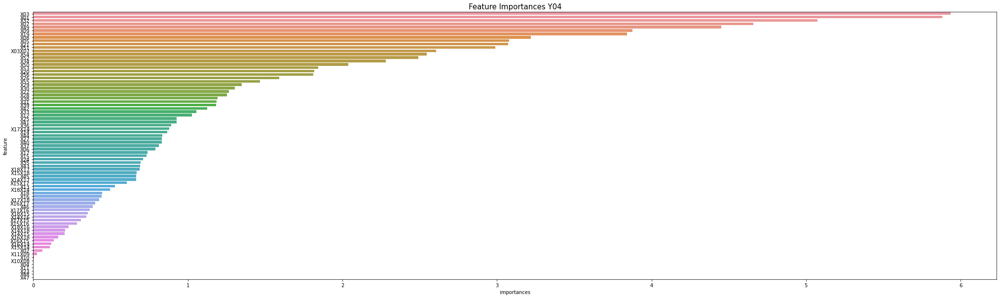

['X04', 'X11', 'X23', 'X48', 'X47']
predict Y04
fit Y05


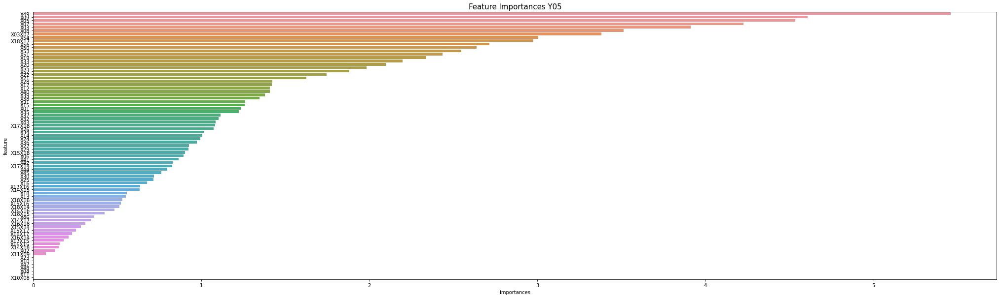

['X23', 'X10', 'X47', 'X48', 'X04', 'X11', 'X10X08']
predict Y05
fit Y06


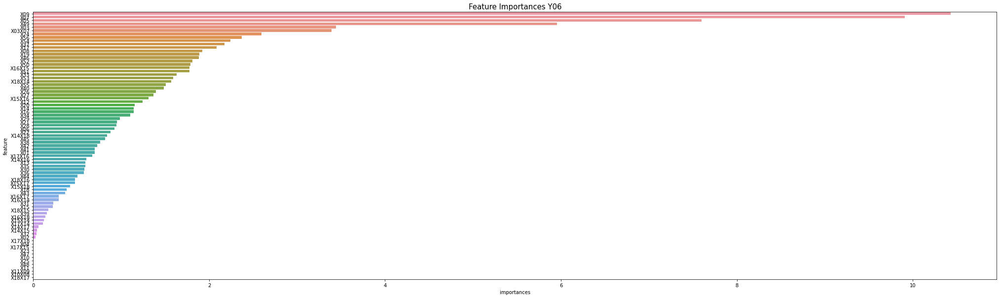

['X17X18', 'X04', 'X17X15', 'X23', 'X47', 'X10', 'X25', 'X48', 'X11', 'X11X09', 'X10X08', 'X18X17']
predict Y06
fit Y07


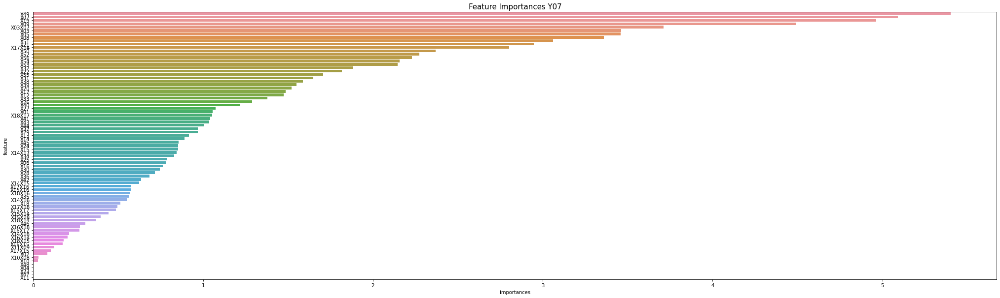

['X48', 'X04', 'X23', 'X47', 'X11']
predict Y07
fit Y08


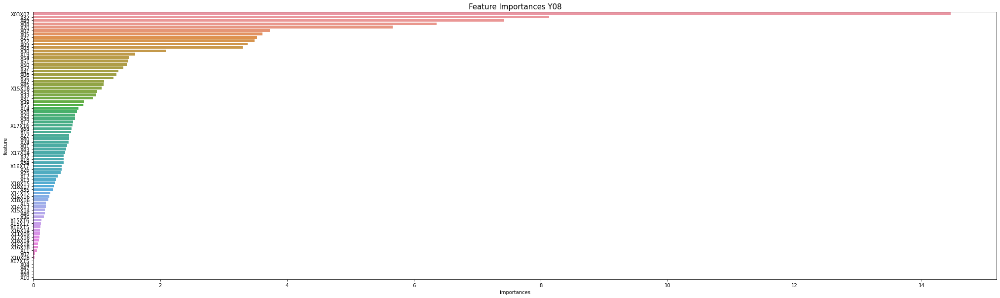

['X17X15', 'X04', 'X47', 'X23', 'X48', 'X10']
predict Y08
fit Y09


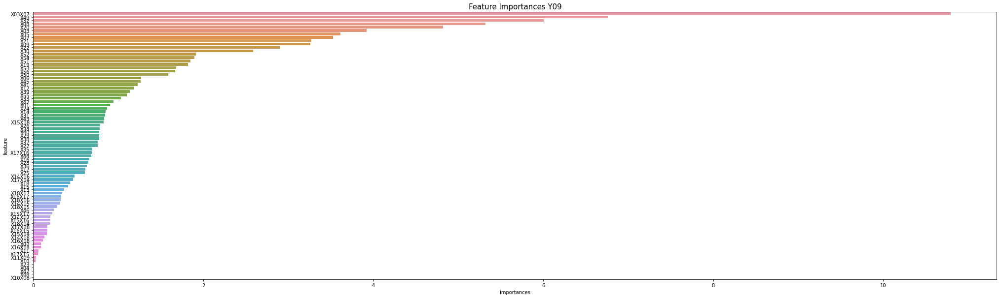

['X23', 'X04', 'X47', 'X48', 'X10X08']
predict Y09
fit Y10


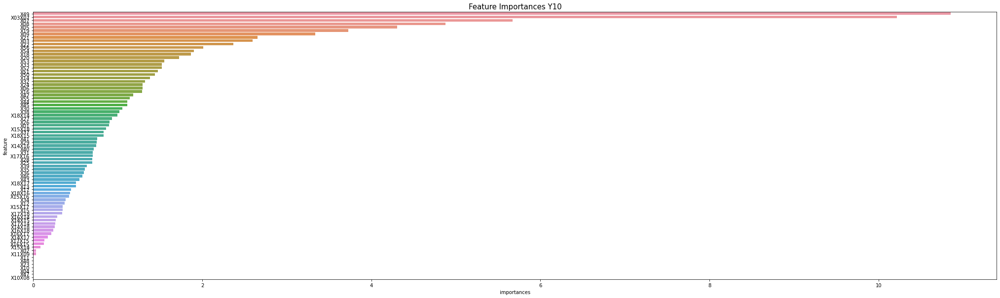

['X11', 'X48', 'X23', 'X10', 'X04', 'X47', 'X10X08']
predict Y10
fit Y11


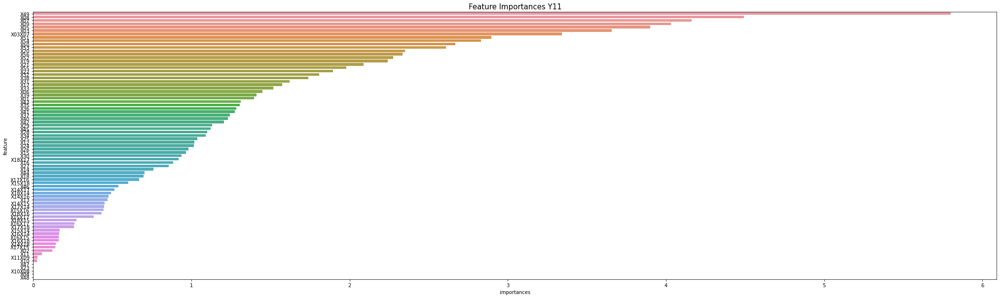

['X47', 'X23', 'X10X08', 'X04', 'X48']
predict Y11
fit Y12


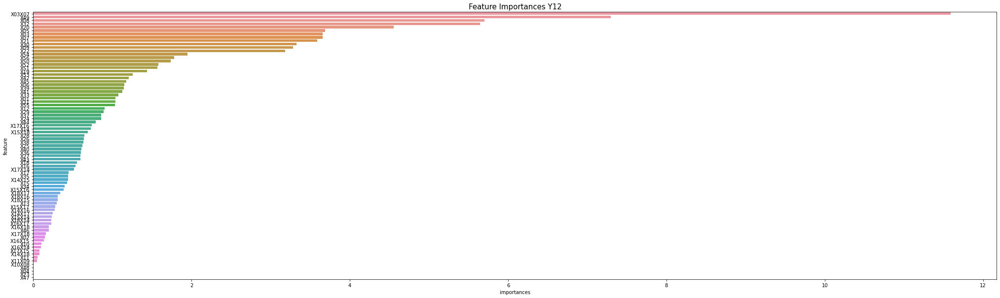

['X10X08', 'X48', 'X04', 'X23', 'X47']
predict Y12
fit Y13


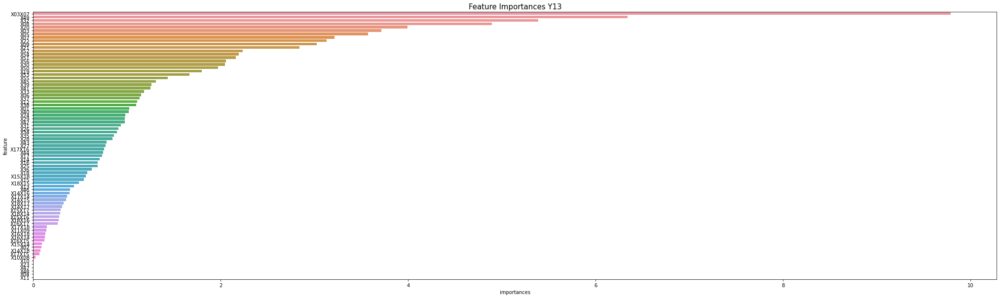

['X23', 'X47', 'X48', 'X04', 'X11']
predict Y13
fit Y14


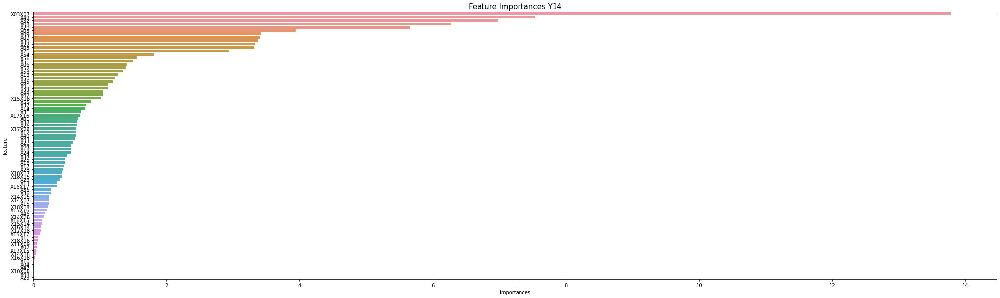

['X10', 'X04', 'X47', 'X10X08', 'X48', 'X23']
predict Y14
Fold 7 / lg_nrmse : 1.913848364892065
fit Y01


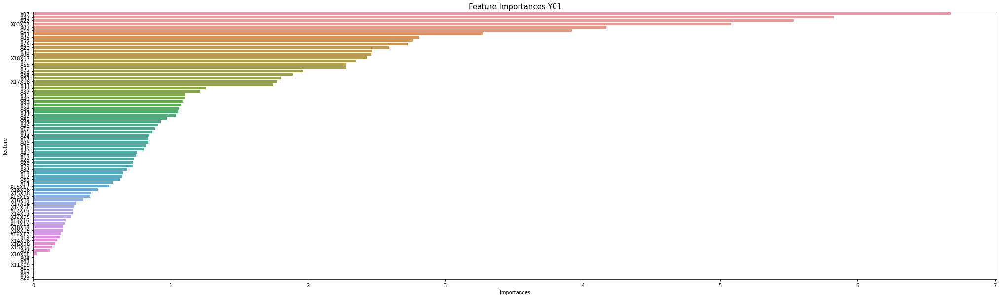

['X04', 'X48', 'X11X09', 'X11', 'X10', 'X47', 'X23']
predict Y01
fit Y02


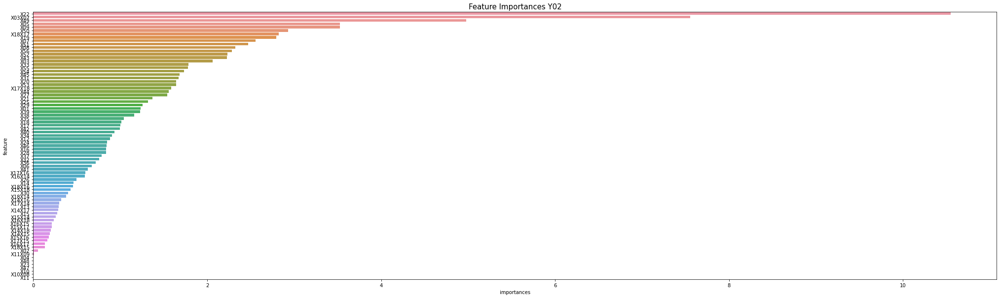

['X04', 'X48', 'X23', 'X47', 'X10', 'X10X08', 'X11']
predict Y02
fit Y03


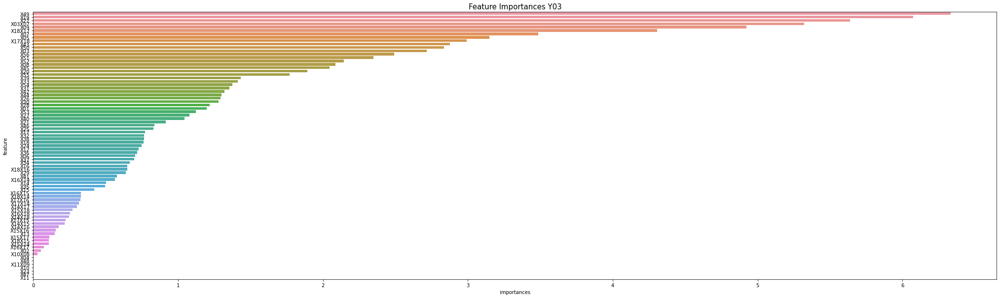

['X04', 'X48', 'X11X09', 'X10', 'X23', 'X47', 'X11']
predict Y03
fit Y04


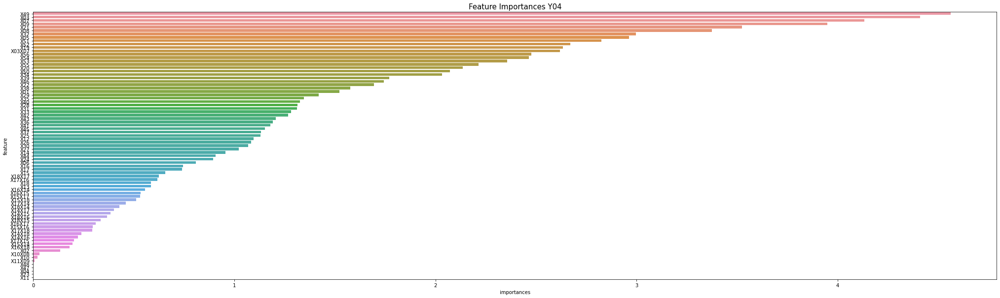

['X48', 'X47', 'X04', 'X23', 'X11']
predict Y04
fit Y05


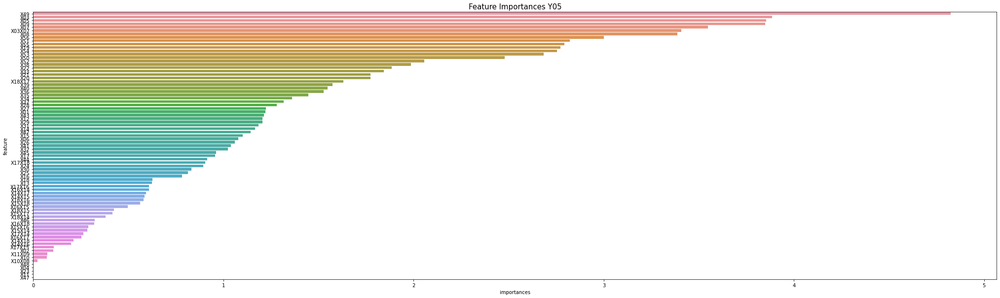

['X48', 'X04', 'X23', 'X11', 'X47']
predict Y05
fit Y06


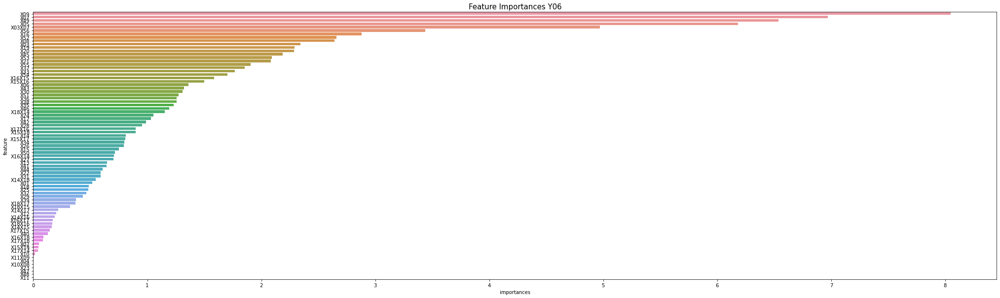

['X04', 'X10X08', 'X23', 'X47', 'X48', 'X11']
predict Y06
fit Y07


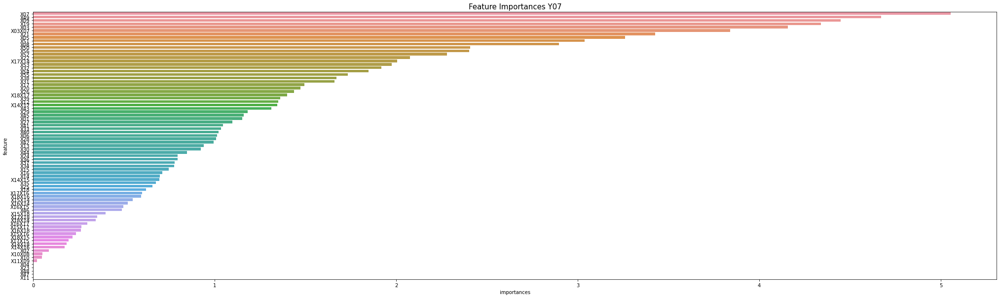

['X04', 'X23', 'X48', 'X47', 'X11']
predict Y07
fit Y08


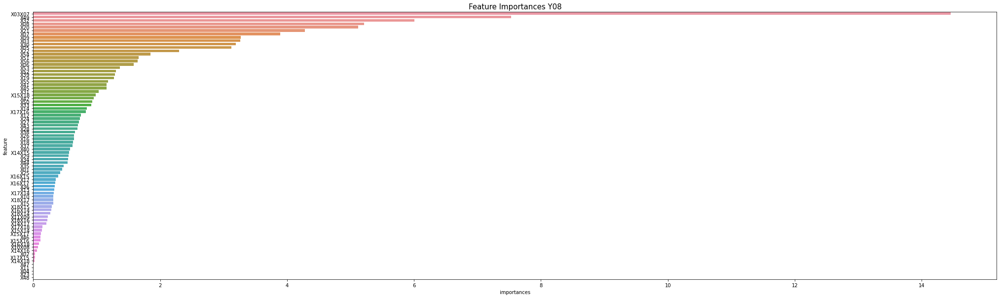

['X47', 'X11', 'X04', 'X23', 'X48']
predict Y08
fit Y09


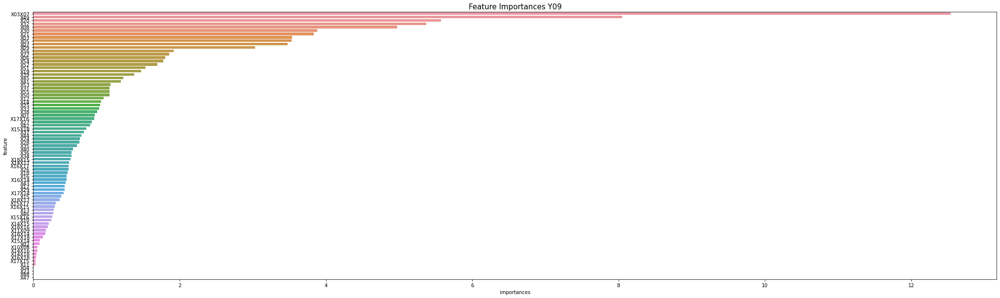

['X04', 'X23', 'X48', 'X47']
predict Y09
fit Y10


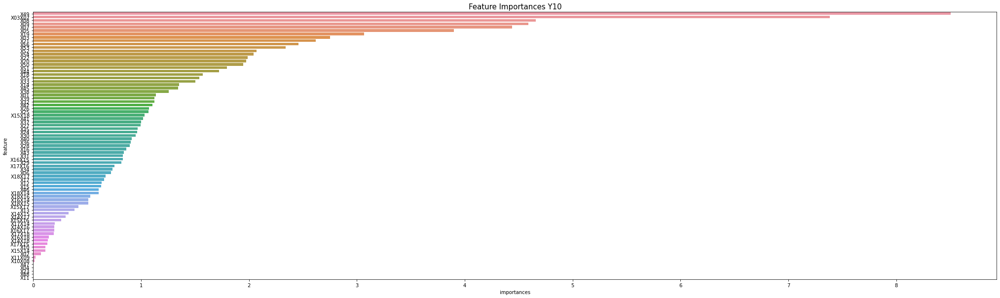

['X47', 'X04', 'X23', 'X48', 'X11']
predict Y10
fit Y11


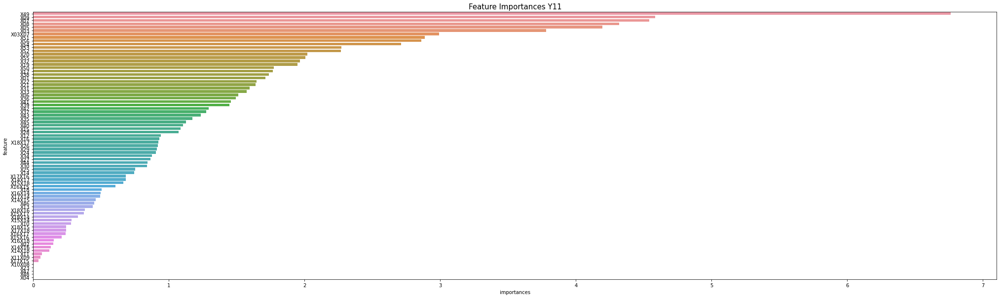

['X23', 'X47', 'X48', 'X04']
predict Y11
fit Y12


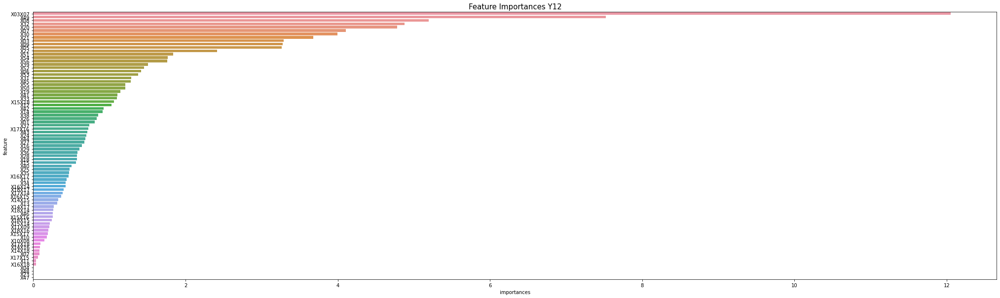

['X04', 'X48', 'X23', 'X47']
predict Y12
fit Y13


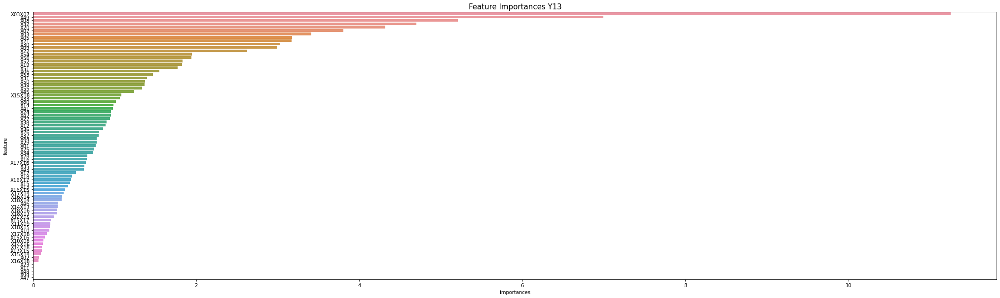

['X23', 'X11', 'X48', 'X04', 'X47']
predict Y13
fit Y14


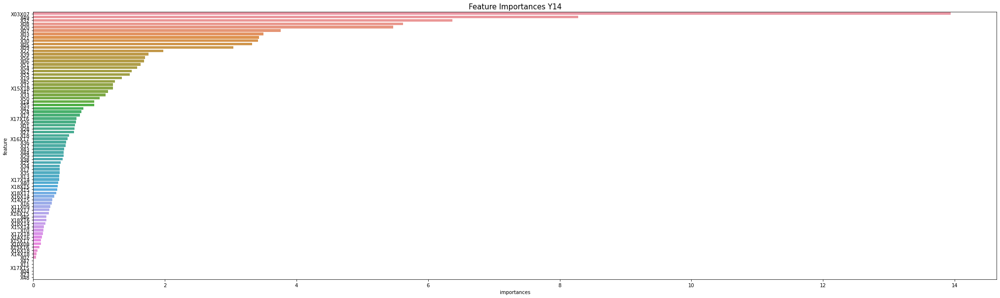

['X47', 'X11', 'X17X15', 'X04', 'X23', 'X48']
predict Y14
Fold 8 / lg_nrmse : 1.9789721091026369
fit Y01


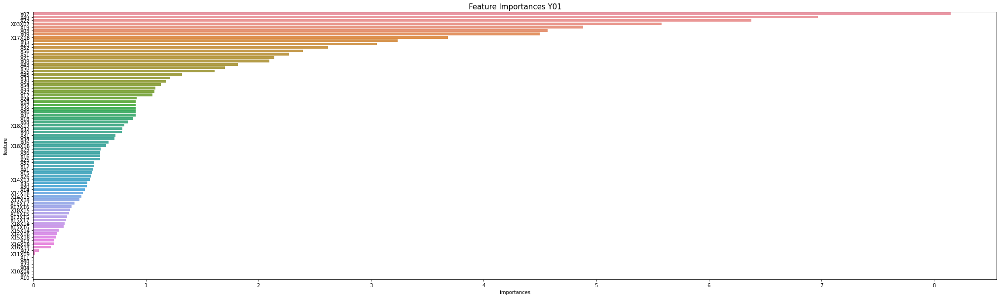

['X11', 'X48', 'X23', 'X04', 'X10X08', 'X47', 'X10']
predict Y01
fit Y02


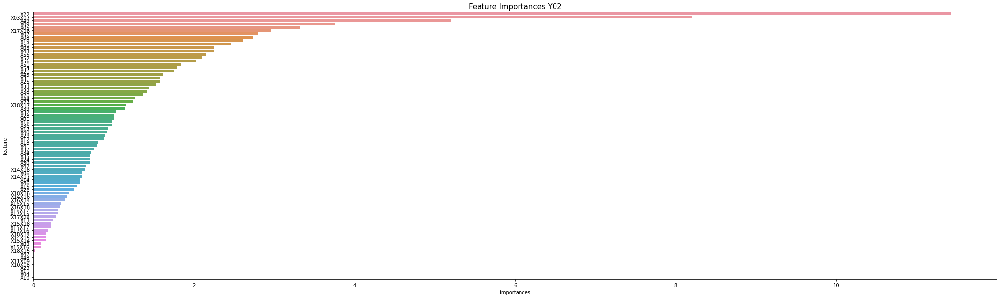

['X47', 'X48', 'X11X09', 'X10X08', 'X23', 'X11', 'X04', 'X10']
predict Y02
fit Y03


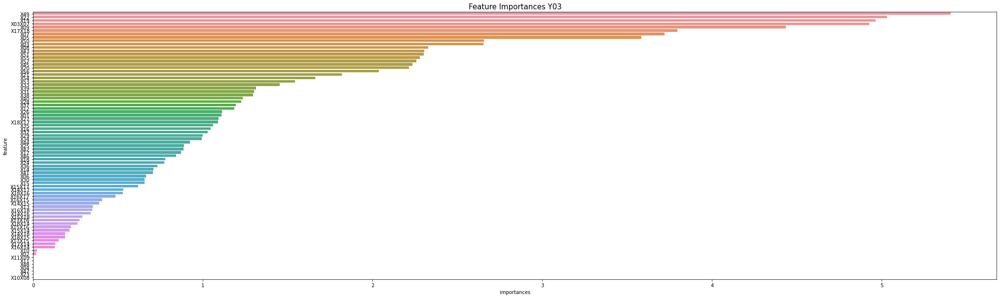

['X11X09', 'X11', 'X48', 'X04', 'X47', 'X23', 'X10X08']
predict Y03
fit Y04


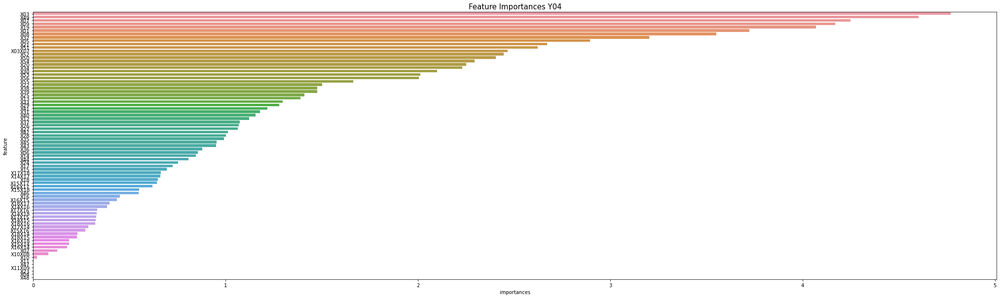

['X47', 'X11X09', 'X23', 'X04', 'X48']
predict Y04
fit Y05


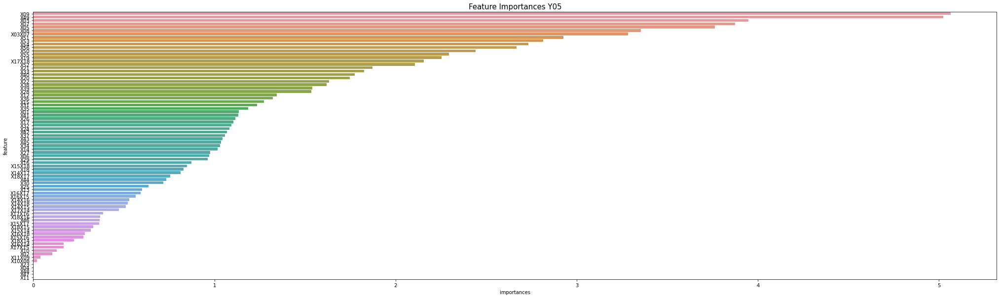

['X23', 'X04', 'X48', 'X47', 'X11']
predict Y05
fit Y06


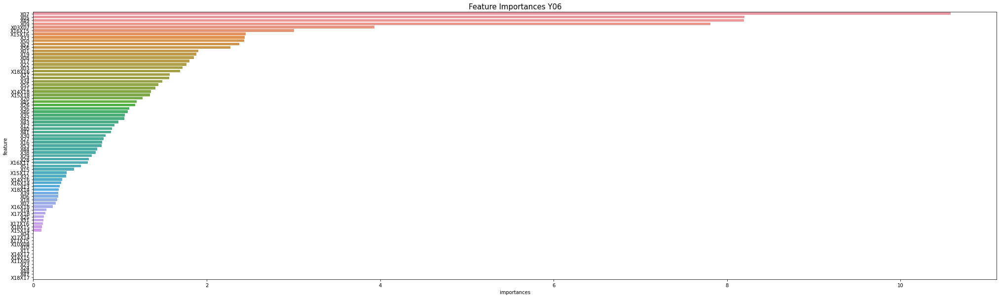

['X04', 'X17X14', 'X17X15', 'X10X08', 'X10', 'X11', 'X14X17', 'X14X15', 'X11X09', 'X23', 'X24', 'X48', 'X47', 'X18X17']
predict Y06
fit Y07


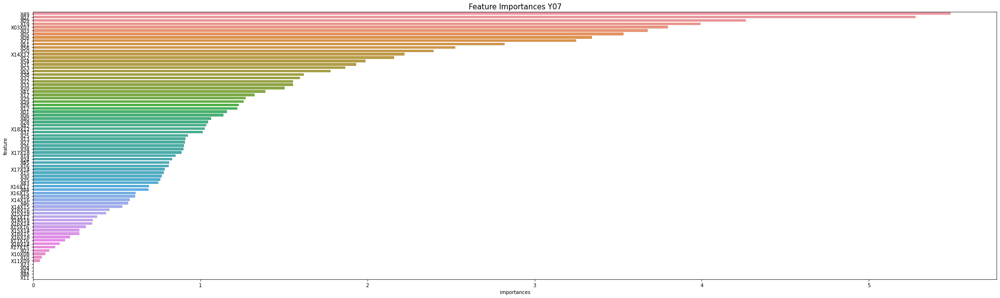

['X23', 'X04', 'X47', 'X48', 'X11']
predict Y07
fit Y08


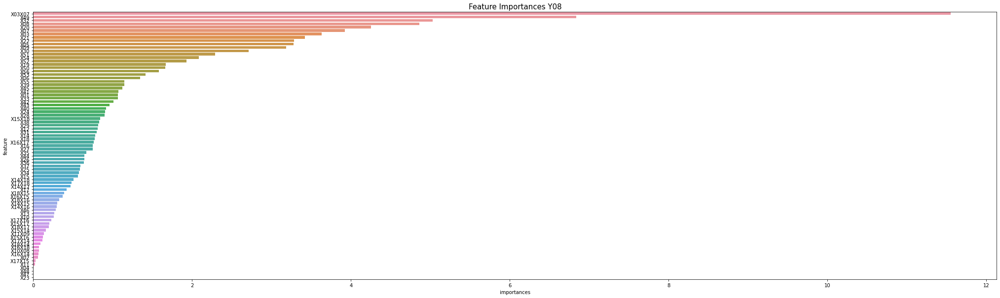

['X04', 'X48', 'X47', 'X23']
predict Y08
fit Y09


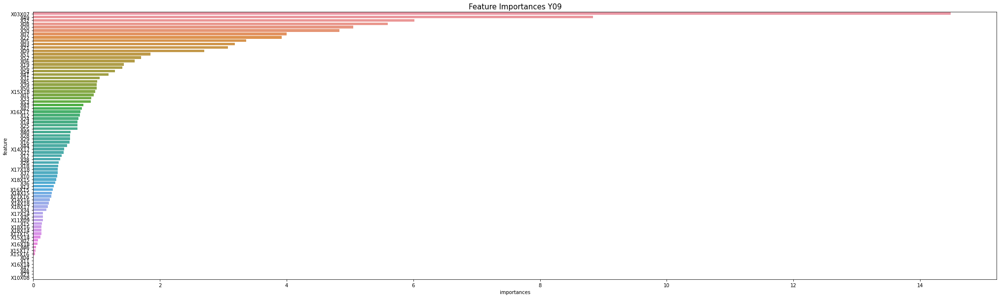

['X04', 'X11', 'X16X14', 'X47', 'X48', 'X23', 'X10X08']
predict Y09
fit Y10


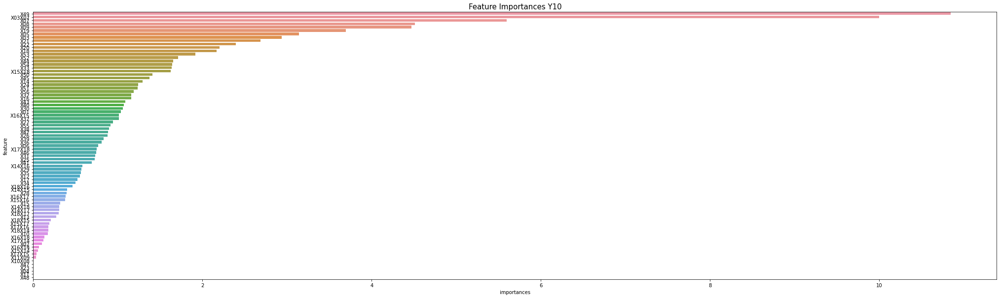

['X10X08', 'X47', 'X23', 'X04', 'X11', 'X48']
predict Y10
fit Y11


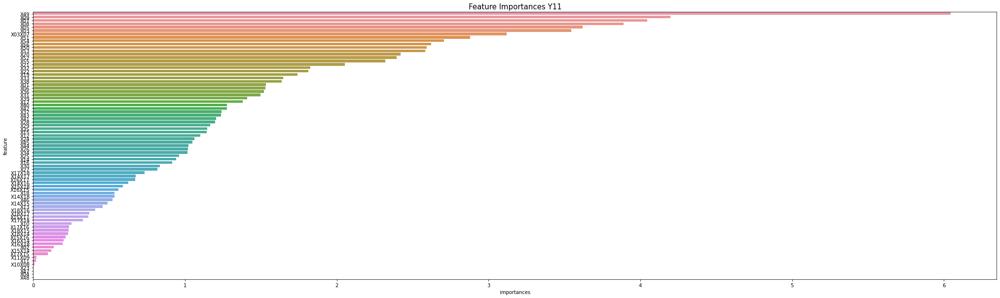

['X23', 'X47', 'X04', 'X48']
predict Y11
fit Y12


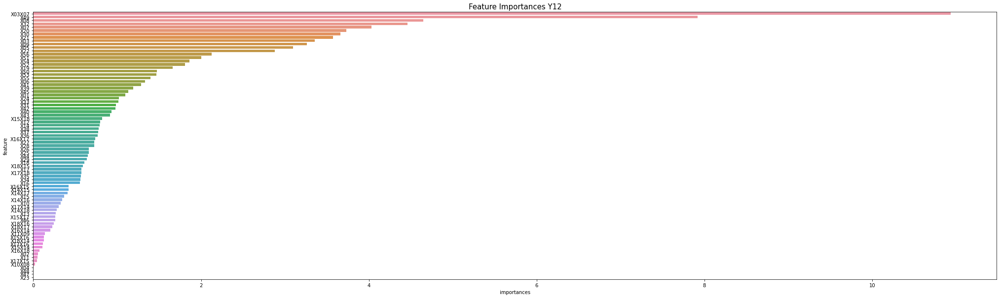

['X04', 'X48', 'X47', 'X23']
predict Y12
fit Y13


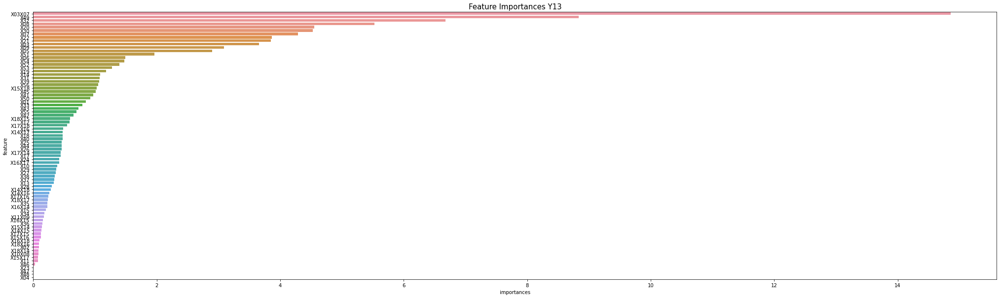

['X23', 'X47', 'X48', 'X04']
predict Y13
fit Y14


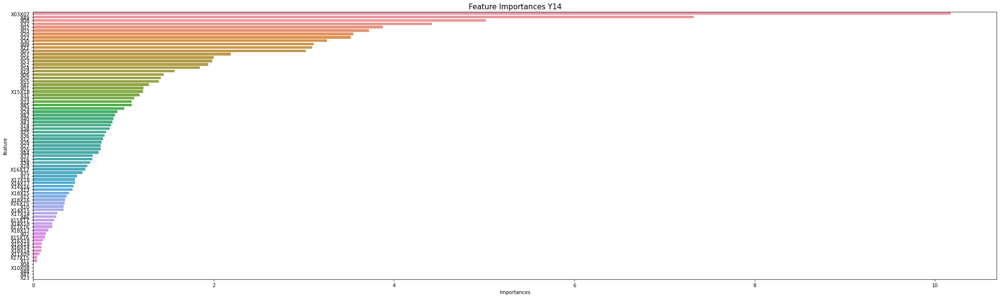

['X04', 'X10X08', 'X48', 'X47', 'X23']
predict Y14
Fold 9 / lg_nrmse : 1.9180588031767032


In [18]:
n_splits = 10
cat_predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)
for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
    preds = []
    y_vals = []
    predictions_ = []
    for j in range(1, 15):
        if j < 10:
            train_y_ = train_y[f'Y0{j}']
        else:
            train_y_ = train_y[f'Y{j}']
        X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
        X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      
        
        #train_weights = 1 / np.square(y_train)
        #val_weights = 1 / np.square(y_val)
        
        #train_pool = Pool(X_train, y_train)
        #val_pool = Pool(X_val, y_val)
        #test_pool = Pool(test_x)
        
        #Forward_best_model = forward_model(X = X_train, y = y_train)
        
        #Backward_best_model = backward_model(X = X_train, y = y_train)
        
        print(f'fit {train_y.columns[j-1]}')
        model = CatBoostRegressor(**cat_params20) # **cat_params
        model.fit(X_train, y_train, eval_set = [(X_val, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0
        
        # 전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
        # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함
        
        # feature importance
        importance = model.feature_importances_
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()
        
        featurelist = importances['feature'][importances['importances'] == 0].tolist()
        print(featurelist)
        
        train_drop = train.drop(featurelist, axis=1)
        test_drop = test.drop(featurelist, axis=1)
        
        train_x_drop = train_drop.filter(regex = 'X')
        test_x_drop = test_drop.filter(regex = 'X')
        
        X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
        X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]
        
        model_drop = CatBoostRegressor(**cat_params20) # **cat_params
        model_drop.fit(X_train_drop, y_train, eval_set = [(X_val_drop, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0
        
        print(f'predict {train_y.columns[j-1]}')
        pred = model_drop.predict(X_val_drop)
        prediction = model_drop.predict(test_x_drop)
        #print(prediction)
        predictions_.append(prediction)
        #print(predictions_)
        preds.append(pred)
        y_vals.append(y_val)
    cat_predictions.append(predictions_)
    #print(predictions)
    lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
    lgnrmses.append(lgnrmse)
    print(f'Fold {i} / lg_nrmse : {lgnrmse}')

In [19]:
np.mean(lgnrmse)
# baseline xgb : validation : 2.02 ~ / LB : 1.9522607692
# baseline lgb : validation : 1.9814120594588327 / LB : 1.94226 
# baseline cat : validation : 1.9781817587332264 / LB : 1.939829804

# feature engineering
# drop outlier : validation : 1.977742725483719
# rads/rpm : validation : 1.9782258348763266
# pressure : validation : 1.9766783508113457 / LB : 1.9391401195
# pressure + point1Distance 안테나 패드 위치 : validation : 1.9767472881505888 / LB : 1.9380212389
# pressure + point1Distance 안테나 패드 위치 + 치수sum + rps/rads + 기울기1 + 기울기2 : 1.9544394188928134

1.9180588031767032

In [29]:
# add 기울기로 y 구하기 1.9257065248848715

#drop weight 1.9241594766536574

# baseline 1.9248544921788344

# feature drop 

In [20]:
cat_predictions

[[array([1.50263833, 1.48720981, 1.54789193, ..., 1.22417776, 1.17987101,
         1.31986146]),
  array([1.24366294, 1.21936048, 1.12017127, ..., 0.92571799, 0.86885965,
         0.93773551]),
  array([1.15903991, 1.16481108, 1.21104596, ..., 0.86322243, 0.92774879,
         1.0496428 ]),
  array([13.67733675, 13.67224954, 15.45685976, ..., 12.87454372,
         13.32228124, 13.23315009]),
  array([31.18931088, 31.14288902, 32.21021368, ..., 31.14651422,
         31.10470575, 30.5630199 ]),
  array([16.55554592, 16.56892084, 16.58323483, ..., 16.57330277,
         16.56547998, 16.55700203]),
  array([3.23121358, 3.15911045, 3.01862566, ..., 3.17172409, 3.2218989 ,
         3.23208668]),
  array([-26.08061552, -26.09024514, -25.82897162, ..., -26.55071573,
         -26.64570001, -26.60190621]),
  array([-26.09854749, -26.17727814, -25.98839218, ..., -26.48645384,
         -26.5278722 , -26.45070861]),
  array([-22.15330304, -22.25668161, -22.25269586, ..., -22.97501357,
         -22.84

In [21]:
cat_final_prediction = np.mean(np.array(cat_predictions), axis=0).T

In [22]:
cat_final_prediction

array([[  1.42719158,   1.192523  ,   1.11746414, ..., -26.02000016,
        -26.01525622, -26.02640847],
       [  1.47382865,   1.20588262,   1.13077103, ..., -26.07408463,
        -26.06760862, -26.06917427],
       [  1.45859298,   1.13190045,   1.09646064, ..., -25.73168623,
        -25.83596747, -25.83796137],
       ...,
       [  1.2279264 ,   0.92675057,   0.95006076, ..., -26.49894981,
        -26.46326484, -26.48991835],
       [  1.20505217,   0.88652637,   0.92932421, ..., -26.44498219,
        -26.4258315 , -26.44219987],
       [  1.31777515,   0.94794398,   1.02633304, ..., -26.49572139,
        -26.43325052, -26.41005702]])

In [23]:
cat_final_prediction.shape

(39608, 14)

In [24]:
for idx, col in enumerate(sample_submission.columns):
    if col=='ID':
        continue
    sample_submission[col] = cat_final_prediction[:,idx-1]
print('Done.')

Done.


In [25]:
sample_submission.to_csv('cat_submission.csv', index = False)

- LGBMRegressor

fit Y01


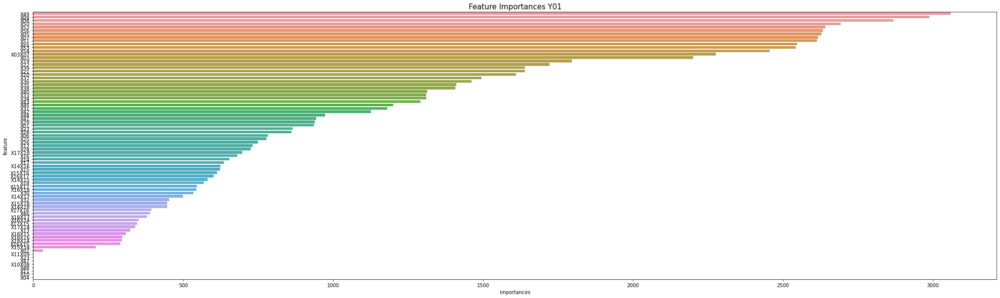

['X11X09', 'X23', 'X47', 'X10X08', 'X48', 'X11', 'X10', 'X04']
predict Y01
fit Y02


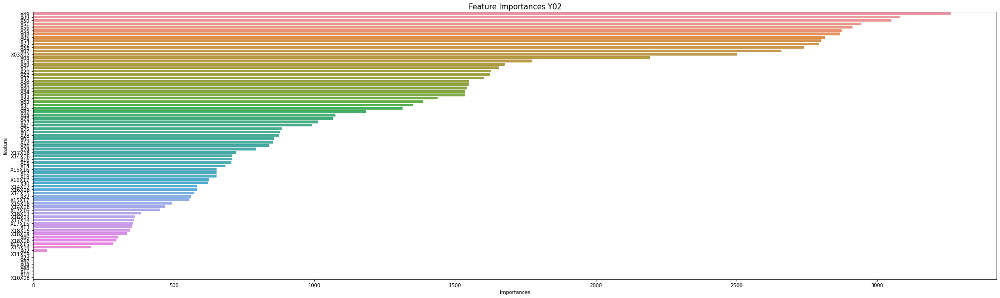

['X11X09', 'X23', 'X47', 'X04', 'X48', 'X11', 'X10', 'X10X08']
predict Y02
fit Y03


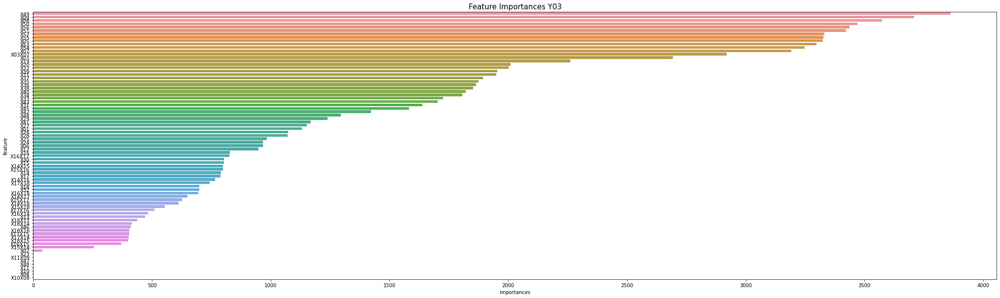

['X23', 'X11X09', 'X47', 'X48', 'X11', 'X10', 'X04', 'X10X08']
predict Y03
fit Y04


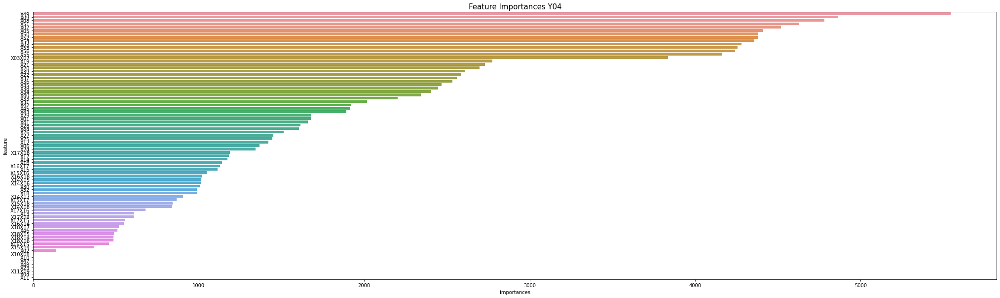

['X10', 'X47', 'X48', 'X23', 'X11X09', 'X04', 'X11']
predict Y04
fit Y05


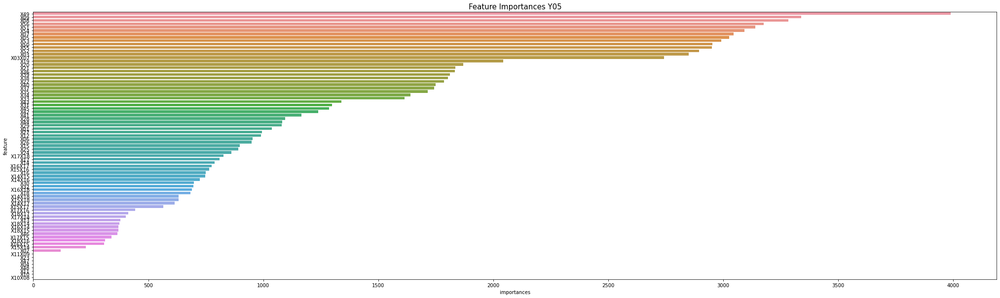

['X11X09', 'X23', 'X47', 'X04', 'X48', 'X11', 'X10', 'X10X08']
predict Y05
fit Y06


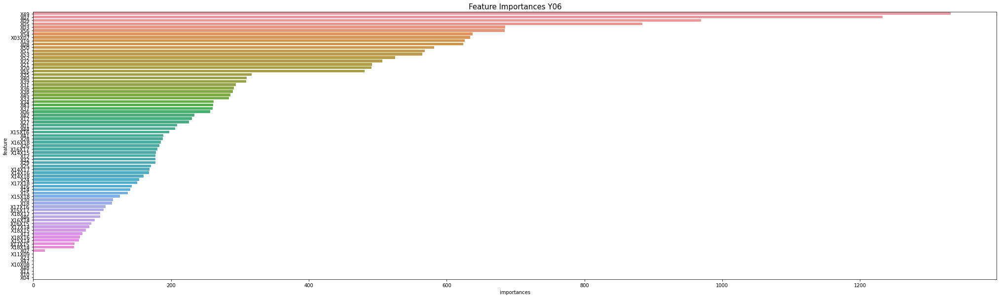

['X11X09', 'X23', 'X47', 'X10X08', 'X48', 'X11', 'X10', 'X04']
predict Y06
fit Y07


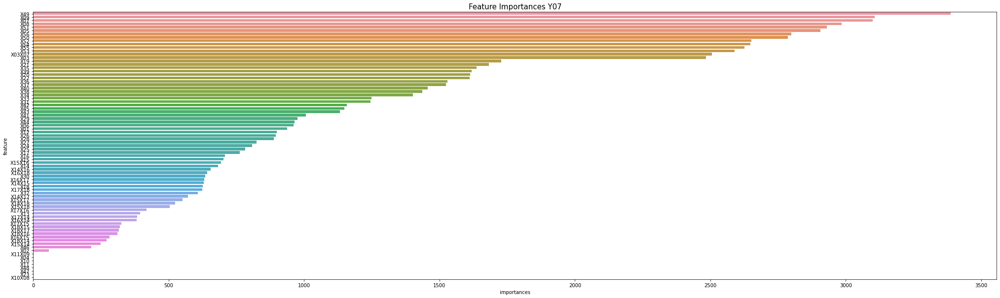

['X11X09', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y07
fit Y08


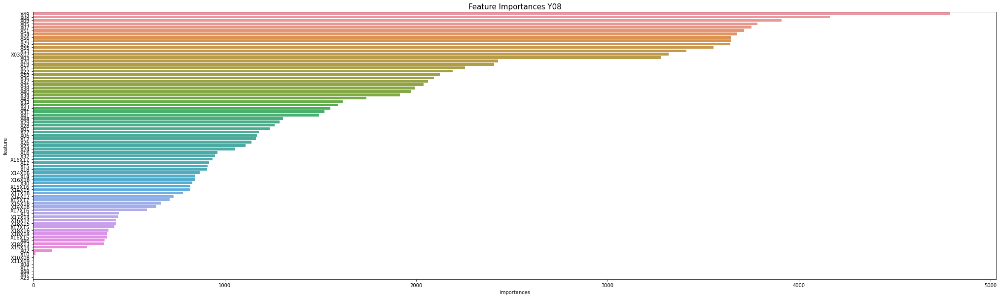

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y08
fit Y09


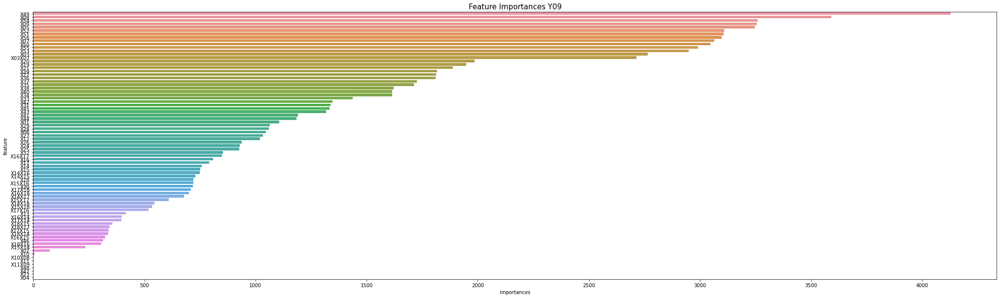

['X11X09', 'X48', 'X47', 'X23', 'X04']
predict Y09
fit Y10


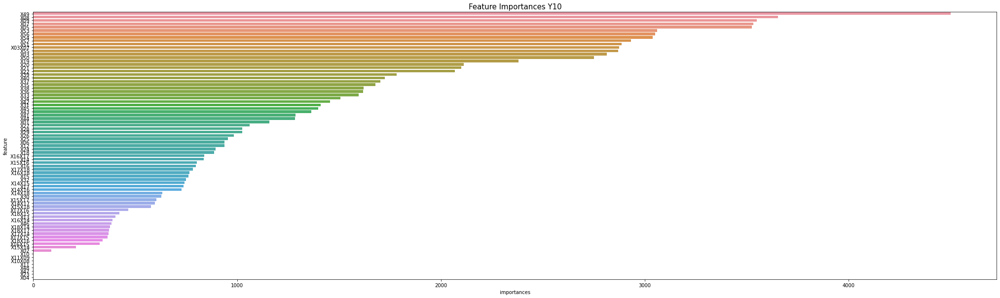

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


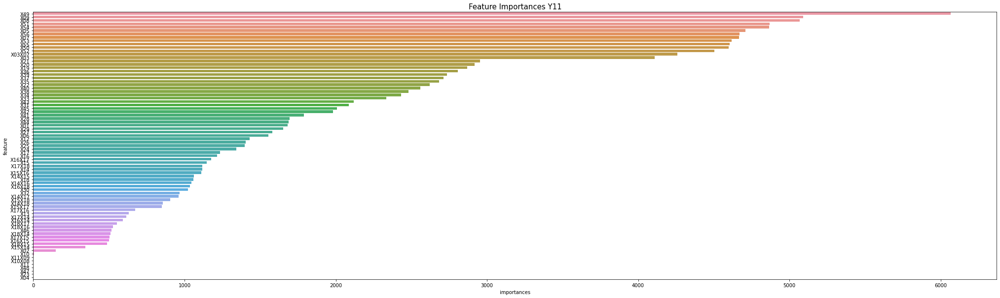

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y11
fit Y12


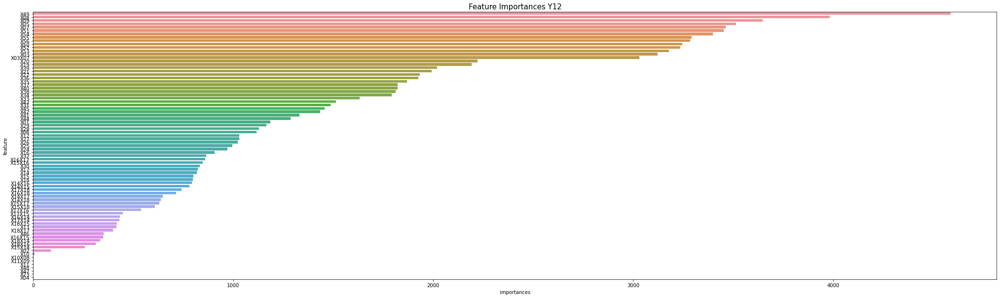

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y12
fit Y13


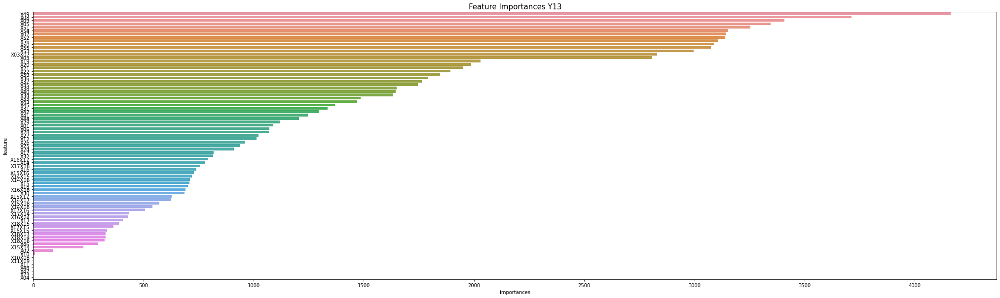

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y13
fit Y14


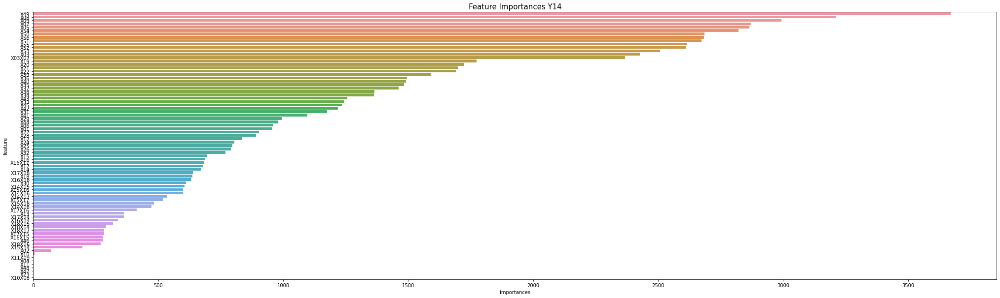

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y14
Fold 0 / lg_nrmse : 1.931036652312892
fit Y01


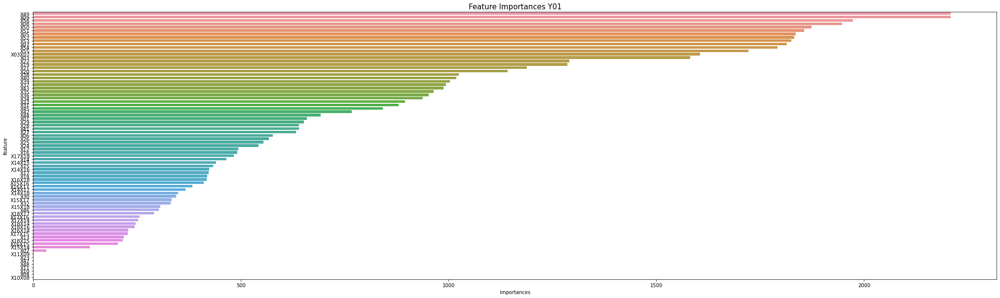

['X11X09', 'X23', 'X47', 'X48', 'X11', 'X10', 'X04', 'X10X08']
predict Y01
fit Y02


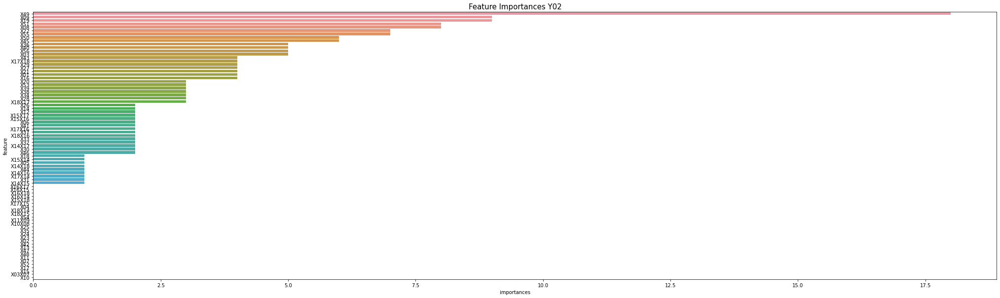

['X16X17', 'X16X15', 'X16X18', 'X16X14', 'X15X18', 'X17X15', 'X04', 'X18X14', 'X18X15', 'X54', 'X11X09', 'X10X08', 'X25', 'X35', 'X24', 'X23', 'X02', 'X42', 'X13', 'X47', 'X48', 'X11', 'X07', 'X52', 'X17', 'X15', 'X03X07', 'X10']
predict Y02
fit Y03


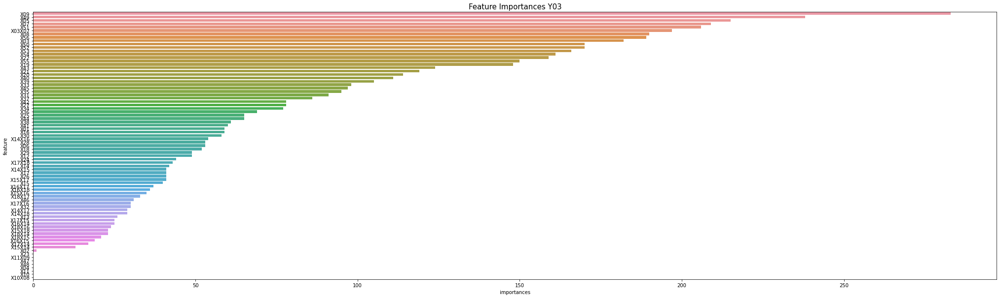

['X23', 'X11X09', 'X47', 'X48', 'X04', 'X11', 'X10', 'X10X08']
predict Y03
fit Y04


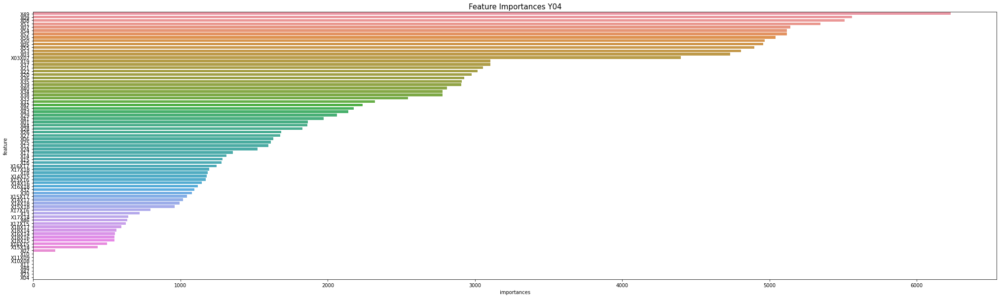

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y04
fit Y05


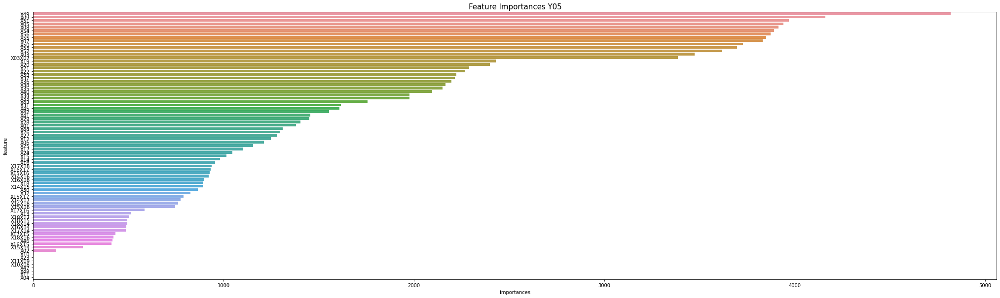

['X23', 'X11X09', 'X10X08', 'X47', 'X48', 'X11', 'X04']
predict Y05
fit Y06


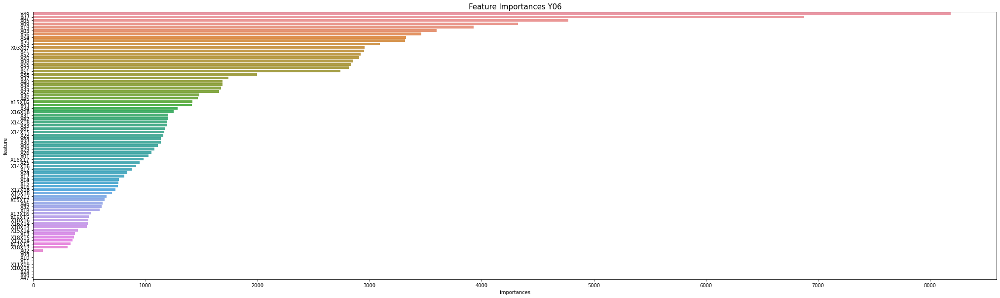

['X04', 'X10', 'X11', 'X11X09', 'X10X08', 'X23', 'X48', 'X47']
predict Y06
fit Y07


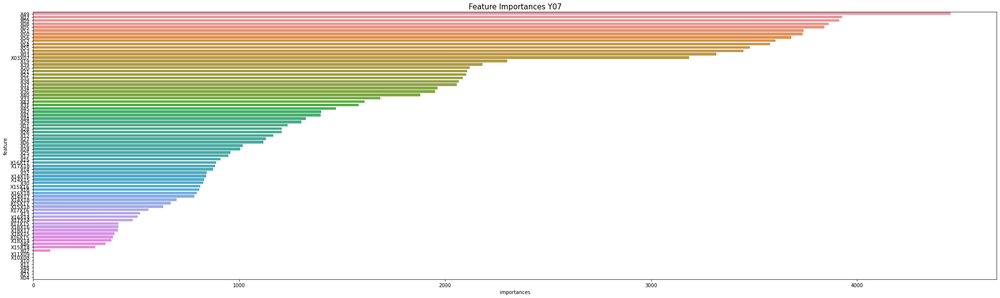

['X11X09', 'X10X08', 'X10', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y07
fit Y08


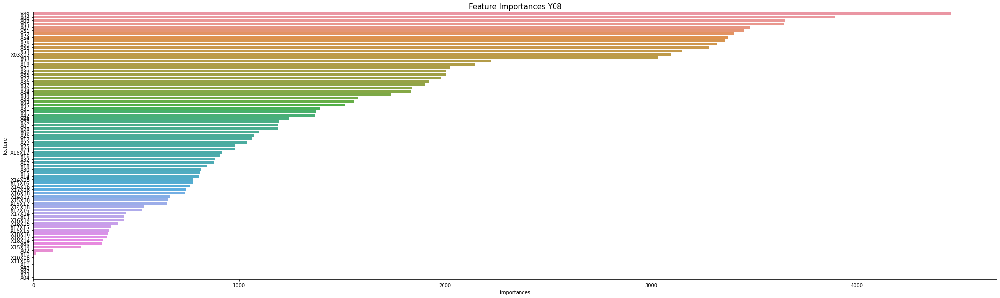

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y08
fit Y09


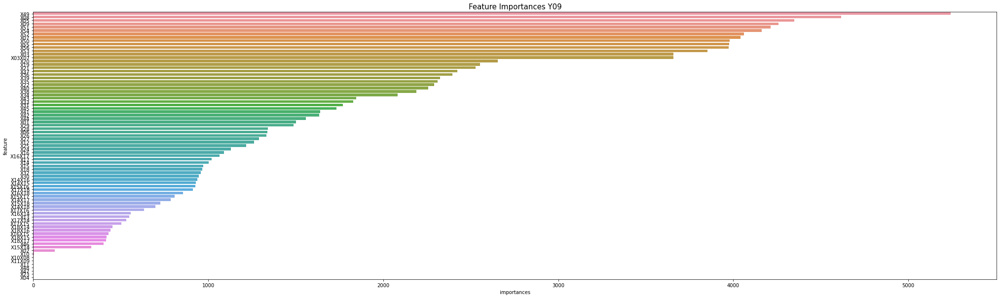

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y09
fit Y10


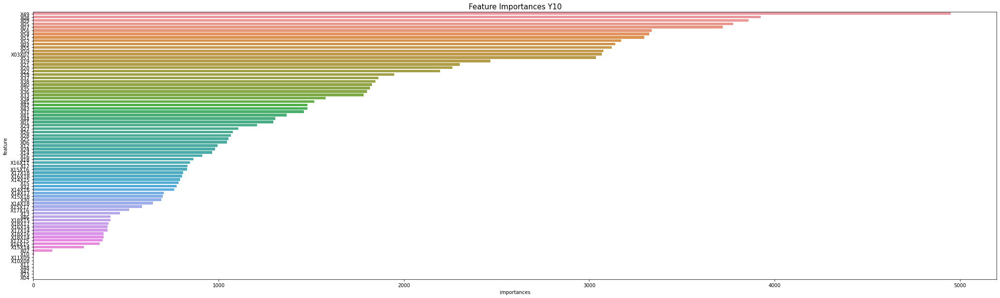

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


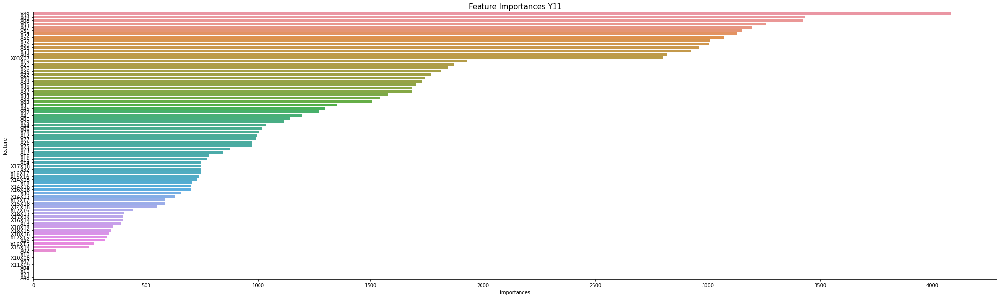

['X47', 'X11X09', 'X04', 'X11', 'X23', 'X48']
predict Y11
fit Y12


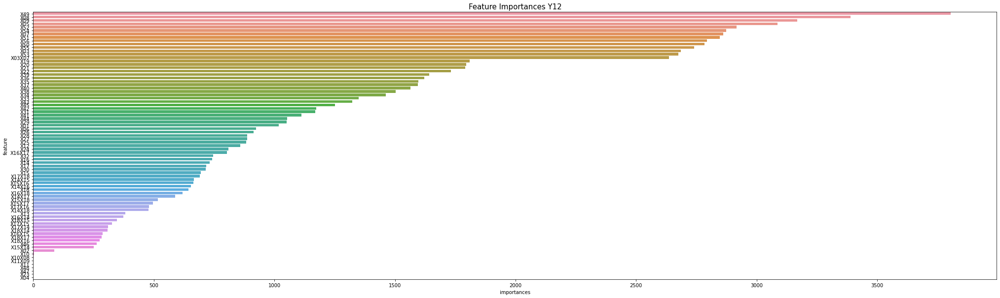

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y12
fit Y13


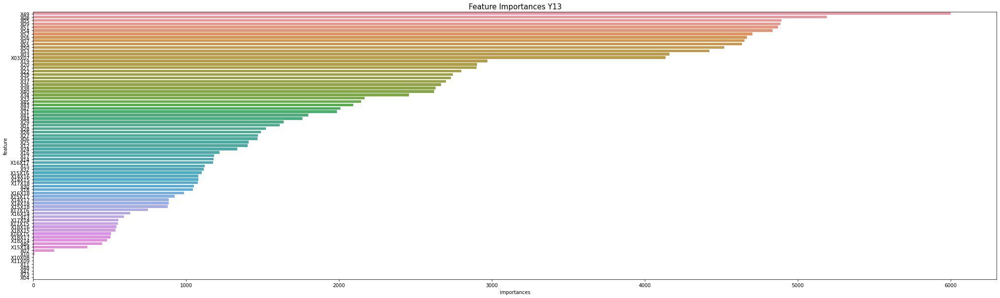

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y13
fit Y14


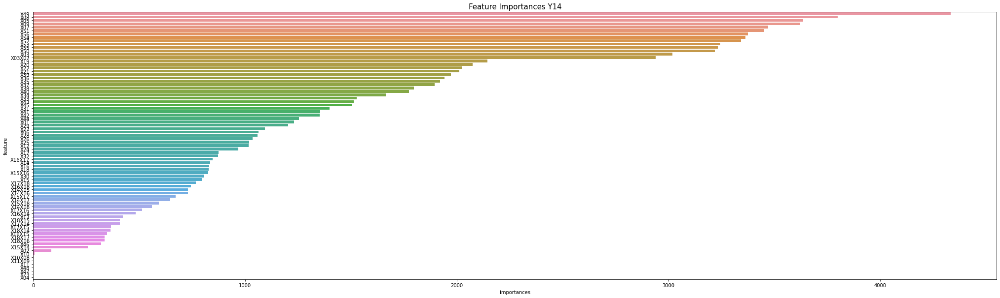

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y14
Fold 1 / lg_nrmse : 1.941114644304887
fit Y01


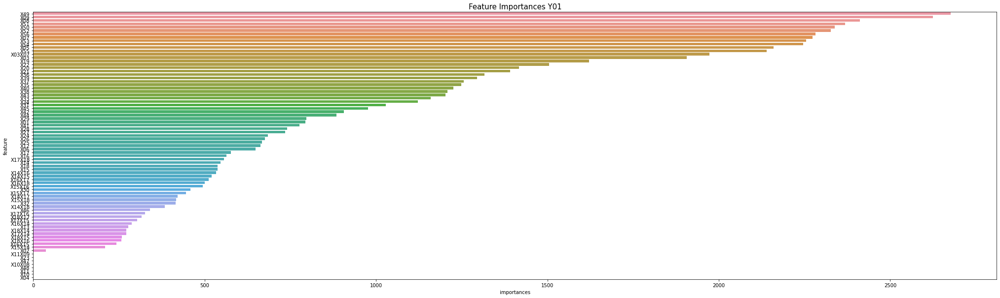

['X11X09', 'X23', 'X47', 'X10X08', 'X48', 'X11', 'X10', 'X04']
predict Y01
fit Y02


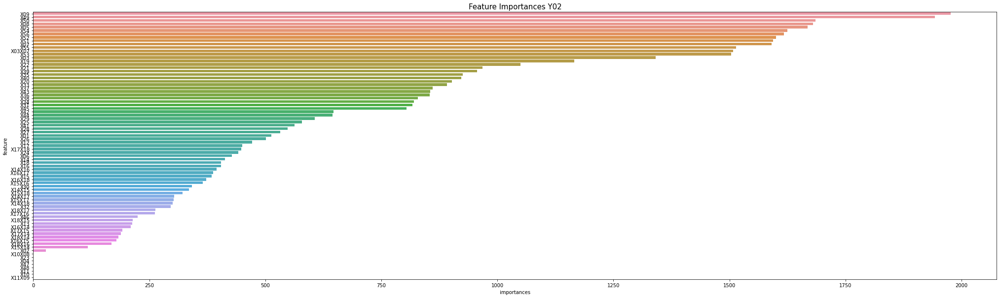

['X10X08', 'X23', 'X04', 'X47', 'X48', 'X11', 'X10', 'X11X09']
predict Y02
fit Y03


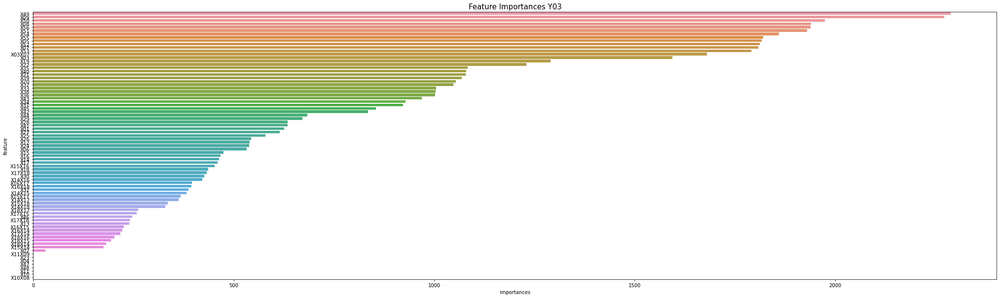

['X11X09', 'X23', 'X04', 'X47', 'X48', 'X11', 'X10', 'X10X08']
predict Y03
fit Y04


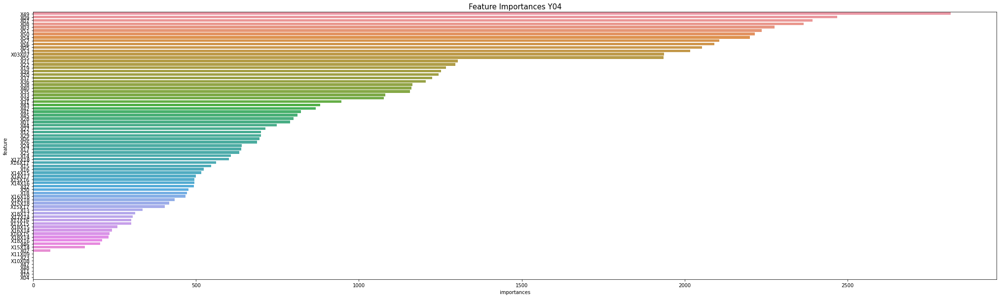

['X11X09', 'X23', 'X10X08', 'X47', 'X48', 'X11', 'X10', 'X04']
predict Y04
fit Y05


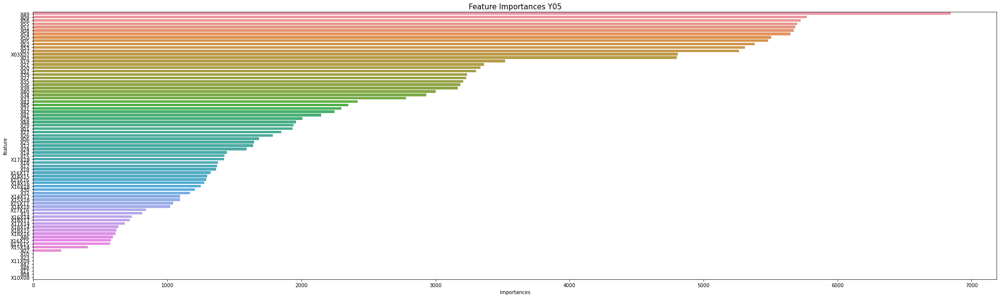

['X23', 'X11X09', 'X47', 'X48', 'X11', 'X04', 'X10X08']
predict Y05
fit Y06


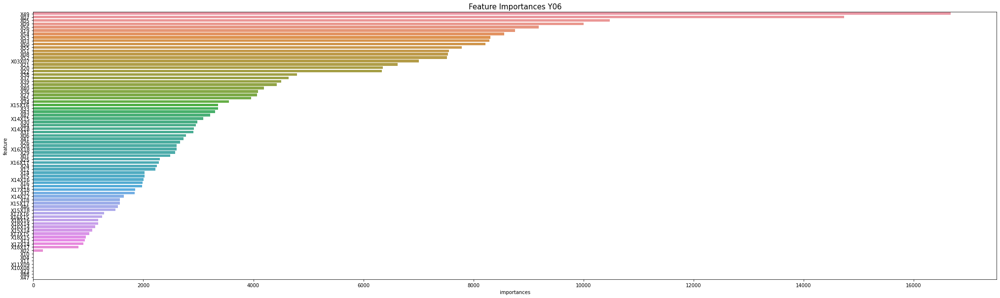

['X04', 'X11', 'X11X09', 'X10X08', 'X23', 'X48', 'X47']
predict Y06
fit Y07


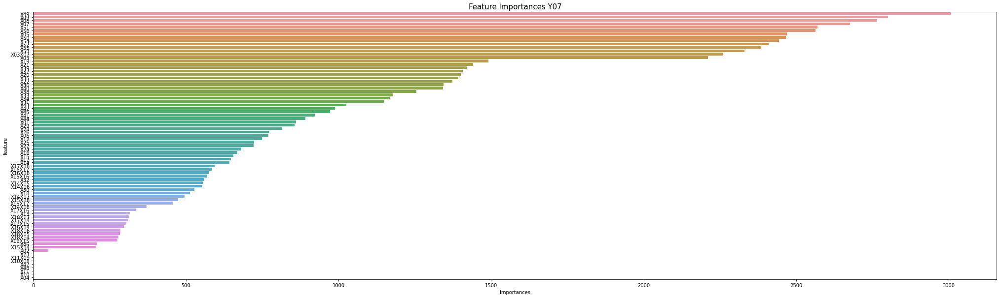

['X23', 'X11X09', 'X10X08', 'X47', 'X48', 'X11', 'X10', 'X04']
predict Y07
fit Y08


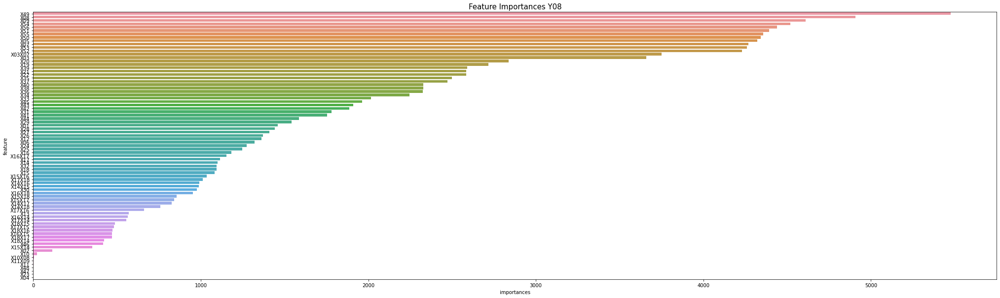

['X48', 'X47', 'X23', 'X04']
predict Y08
fit Y09


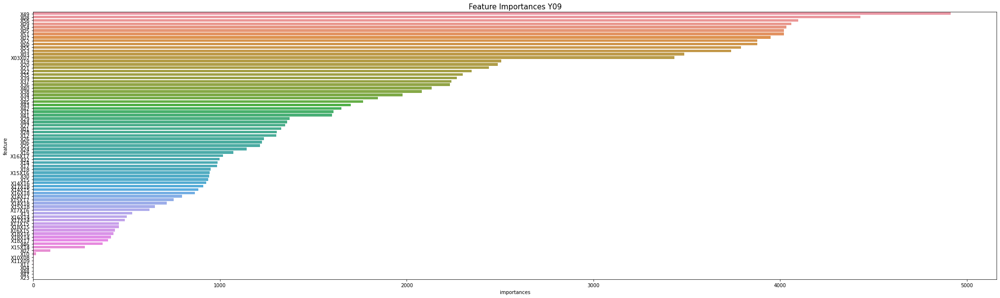

['X04', 'X48', 'X47', 'X23']
predict Y09
fit Y10


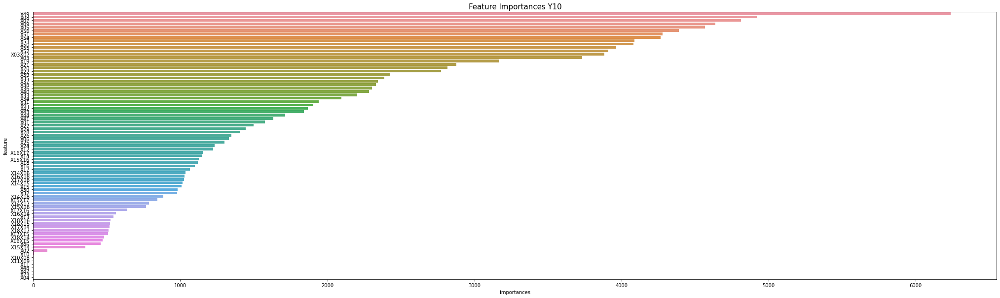

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


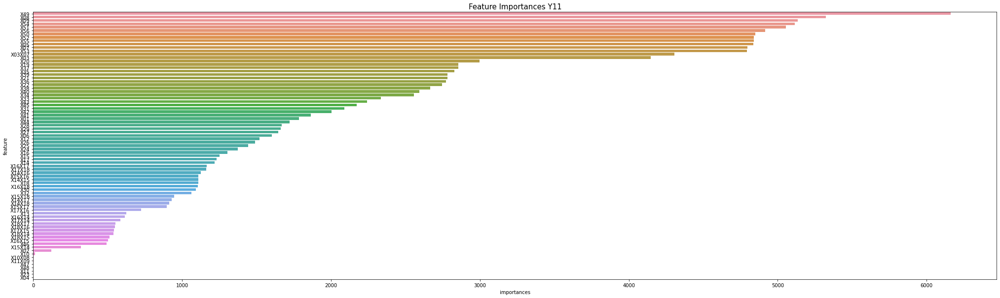

['X47', 'X48', 'X11', 'X23', 'X04']
predict Y11
fit Y12


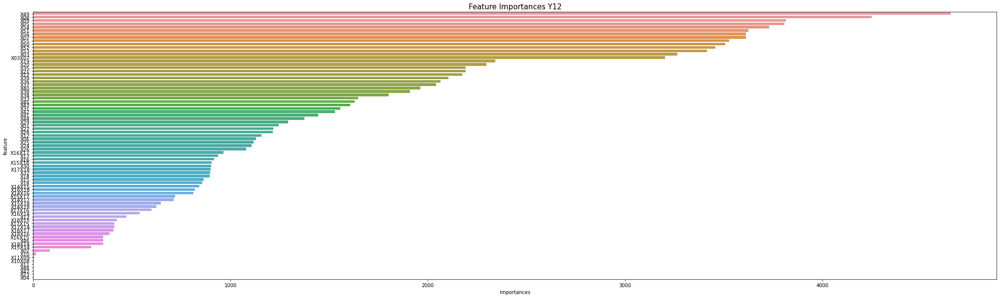

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y12
fit Y13


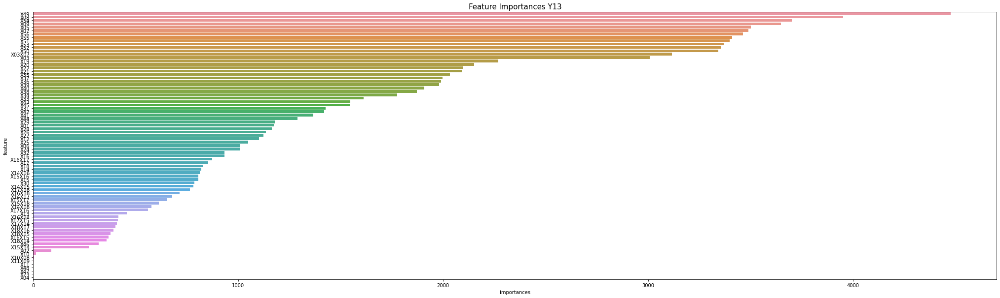

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y13
fit Y14


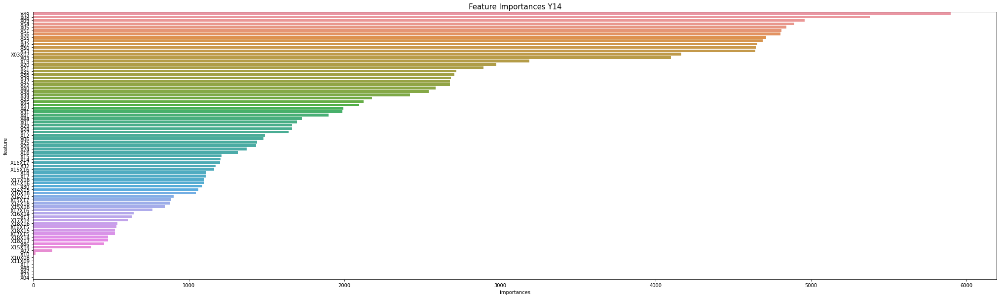

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y14
Fold 2 / lg_nrmse : 1.9748128024924163
fit Y01


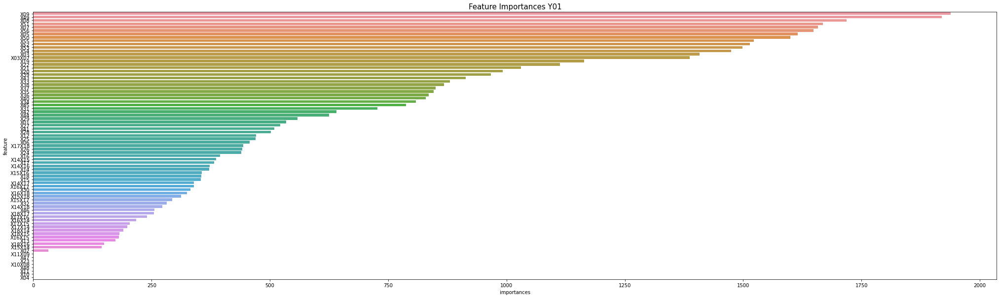

['X11X09', 'X47', 'X23', 'X10X08', 'X48', 'X11', 'X10', 'X04']
predict Y01
fit Y02


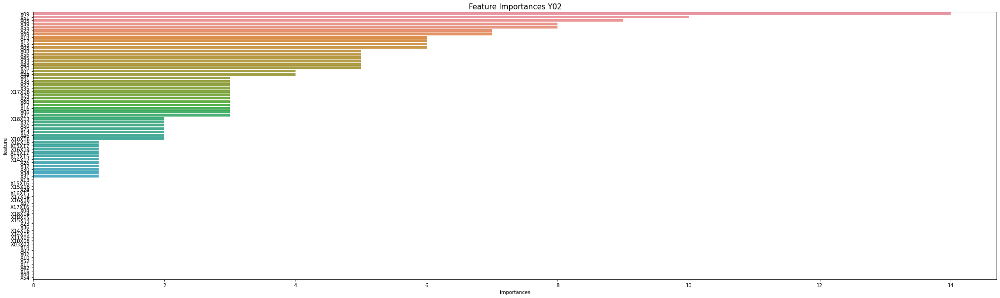

['X13', 'X15X16', 'X15X18', 'X24', 'X16X15', 'X17X14', 'X16X18', 'X47', 'X17X16', 'X04', 'X18X14', 'X18X15', 'X15X14', 'X23', 'X36', 'X14X16', 'X14X15', 'X11X09', 'X10X08', 'X03X07', 'X18', 'X07', 'X02', 'X10', 'X52', 'X11', 'X42', 'X15', 'X48', 'X54']
predict Y02
fit Y03


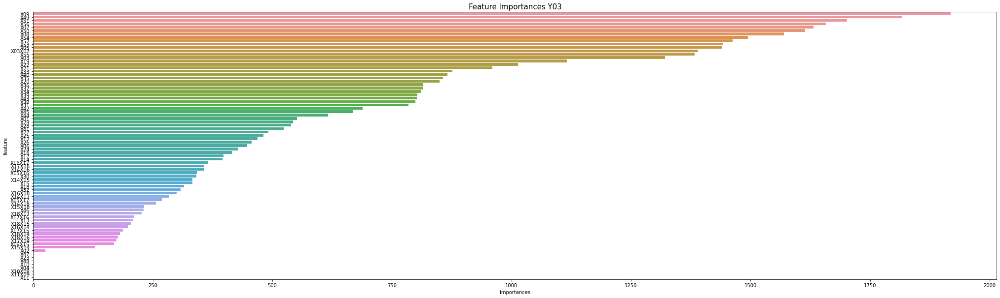

['X47', 'X23', 'X48', 'X10', 'X04', 'X10X08', 'X11X09', 'X11']
predict Y03
fit Y04


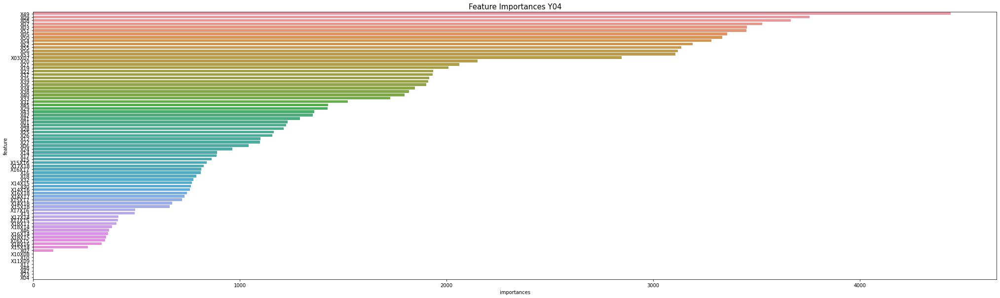

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y04
fit Y05


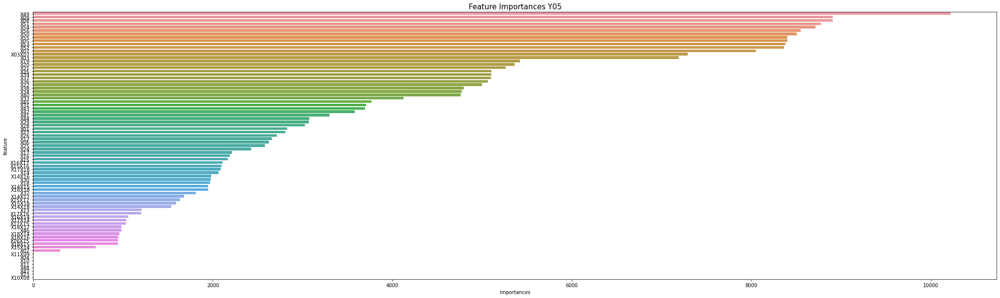

['X11X09', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y05
fit Y06


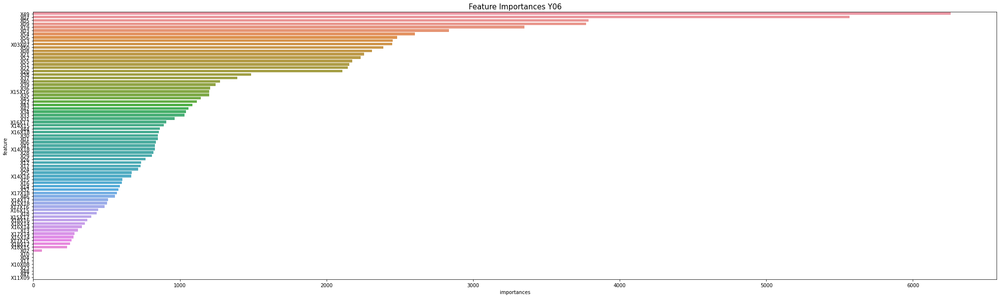

['X10', 'X04', 'X11', 'X10X08', 'X23', 'X48', 'X47', 'X11X09']
predict Y06
fit Y07


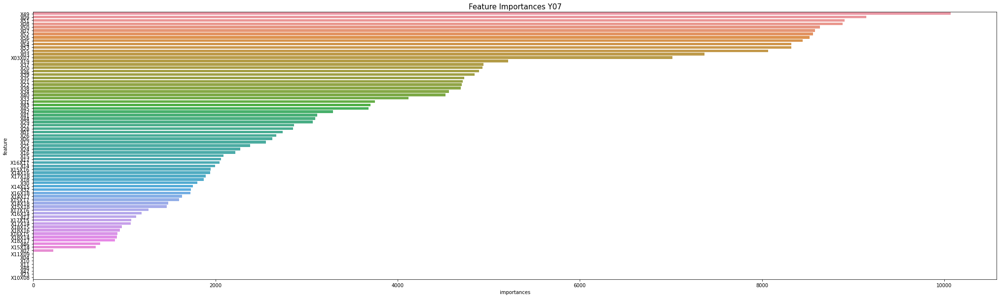

['X11X09', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y07
fit Y08


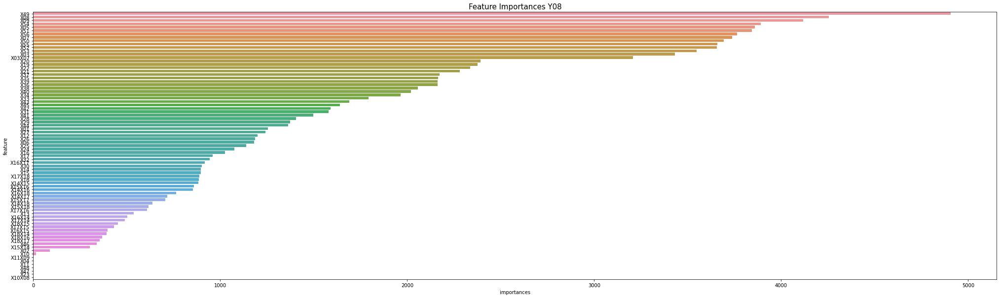

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y08
fit Y09


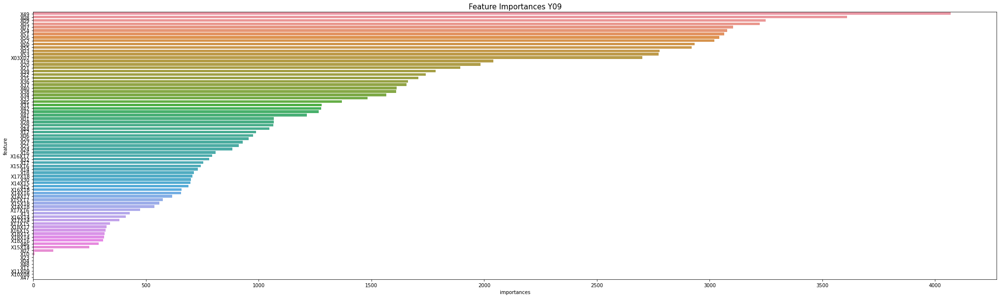

['X23', 'X04', 'X48', 'X11', 'X11X09', 'X10X08', 'X47']
predict Y09
fit Y10


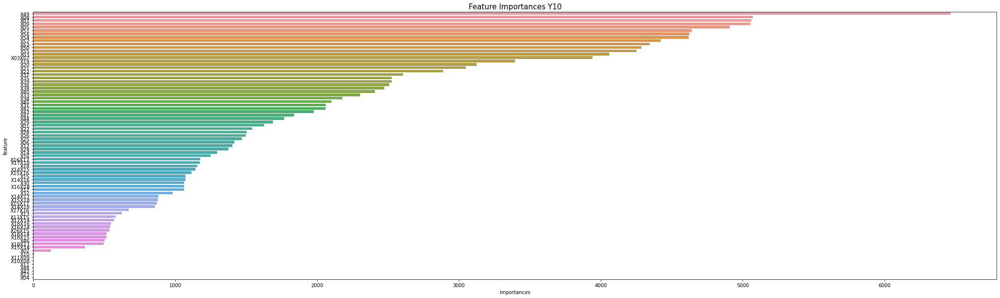

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


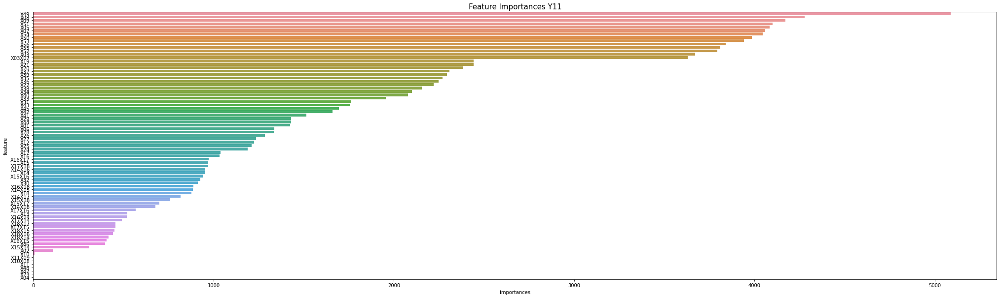

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y11
fit Y12


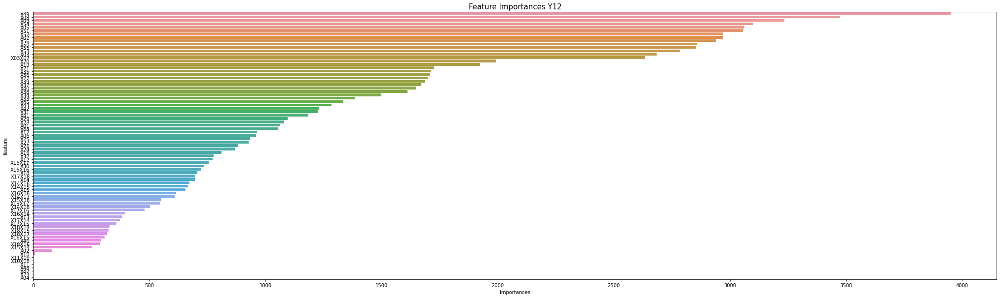

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y12
fit Y13


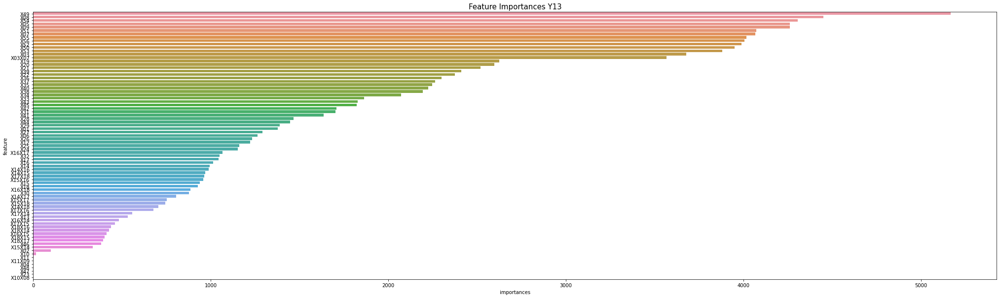

['X11X09', 'X04', 'X48', 'X47', 'X23', 'X10X08']
predict Y13
fit Y14


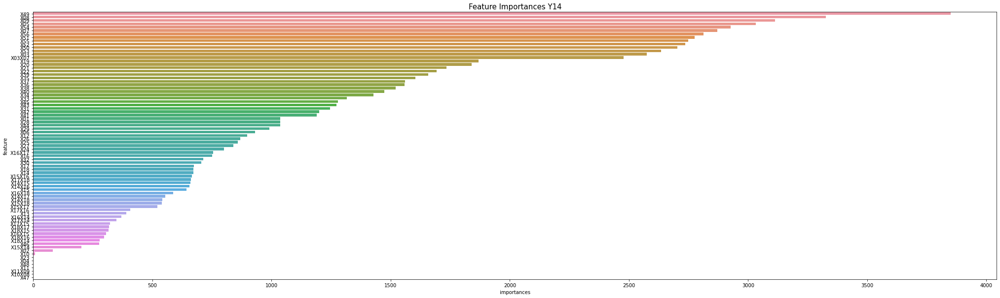

['X23', 'X04', 'X48', 'X11', 'X11X09', 'X10X08', 'X47']
predict Y14
Fold 3 / lg_nrmse : 1.9469010317474686
fit Y01


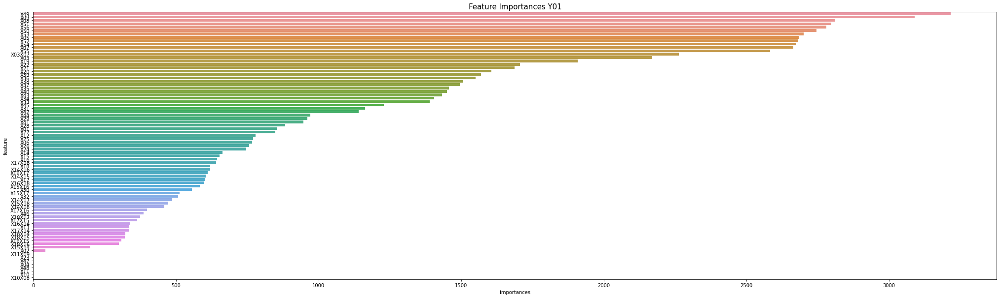

['X11X09', 'X23', 'X47', 'X04', 'X48', 'X11', 'X10', 'X10X08']
predict Y01
fit Y02


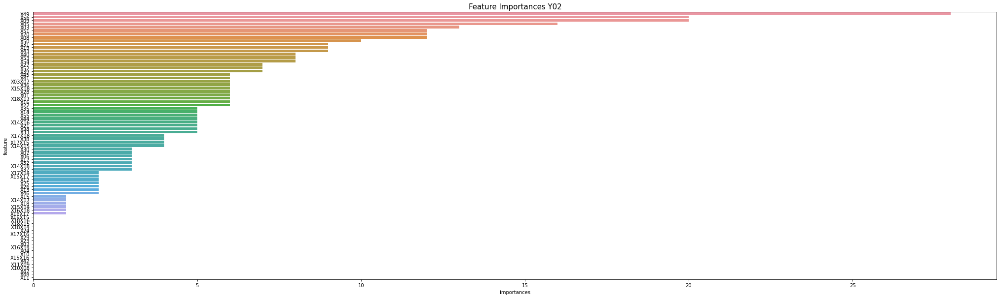

['X16X15', 'X18X16', 'X18X15', 'X18X14', 'X24', 'X17X16', 'X29', 'X23', 'X02', 'X16X14', 'X04', 'X10', 'X15X16', 'X42', 'X11X09', 'X10X08', 'X47', 'X48', 'X11']
predict Y02
fit Y03


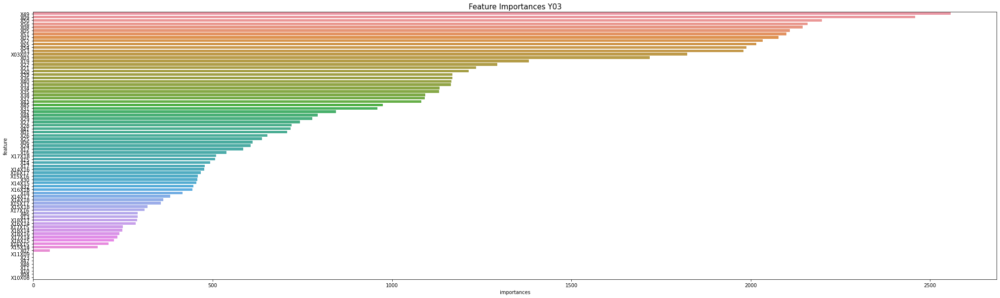

['X11X09', 'X23', 'X47', 'X48', 'X11', 'X10', 'X04', 'X10X08']
predict Y03
fit Y04


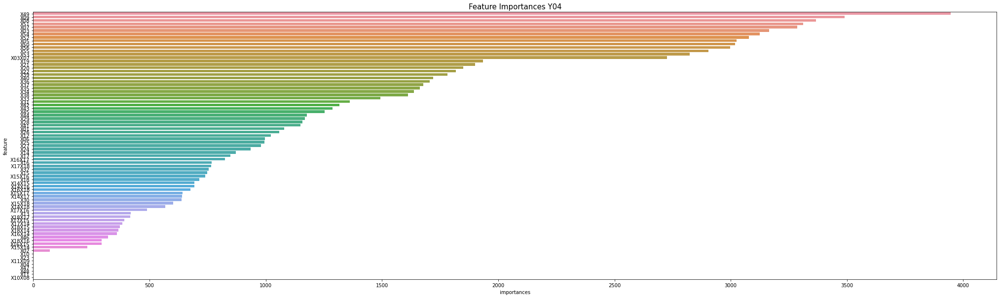

['X23', 'X11X09', 'X04', 'X47', 'X48', 'X11', 'X10X08']
predict Y04
fit Y05


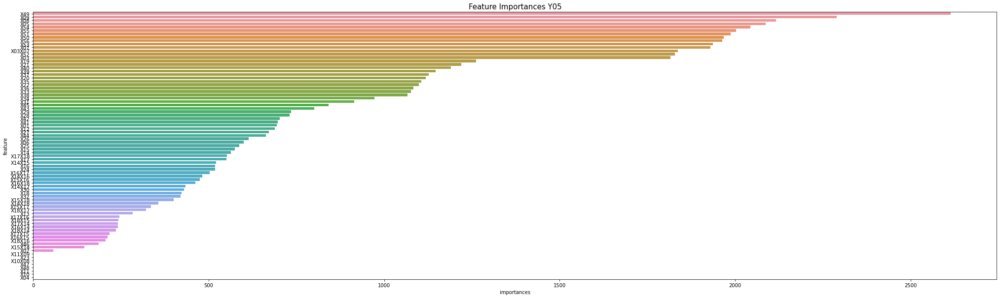

['X11X09', 'X23', 'X10X08', 'X47', 'X48', 'X11', 'X10', 'X04']
predict Y05
fit Y06


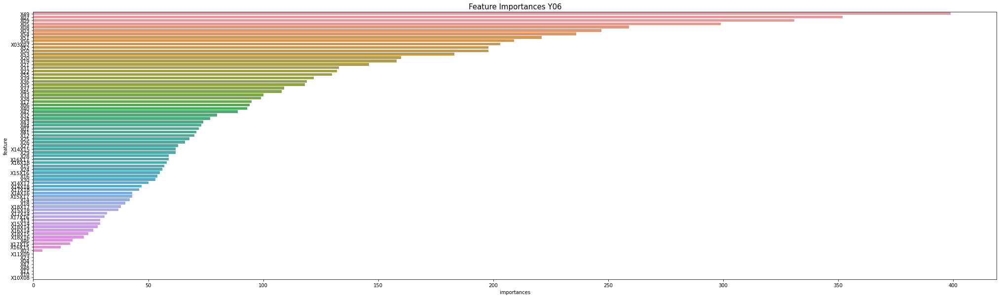

['X11X09', 'X23', 'X04', 'X47', 'X48', 'X11', 'X10', 'X10X08']
predict Y06
fit Y07


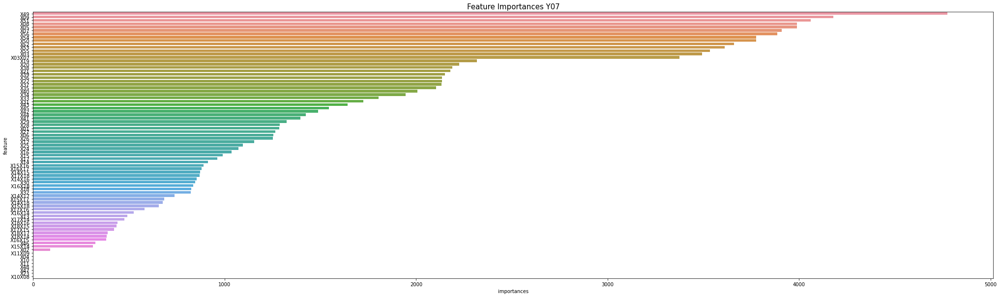

['X11X09', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y07
fit Y08


KeyboardInterrupt: 

In [17]:
n_splits = 10
lgb_train_predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

def feval_rmspe(y_pred, lgb_train):
    y_true = lgb_train.get_label()
    return 'RMSPE', rmspe(y_true, y_pred), False

for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
    preds = []
    y_vals = []
    predictions_ = []
    for j in range(1, 15):
        if j < 10:
            train_y_ = train_y[f'Y0{j}']
        else:
            train_y_ = train_y[f'Y{j}']

        X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
        X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

        #train_weights = 1 / np.square(y_train)
        #val_weights = 1 / np.square(y_val)
            
        train_dataset = lgb.Dataset(X_train, y_train) # , weight = train_weights
        val_dataset = lgb.Dataset(X_val, y_val) #, weight = val_weights

        #Forward_best_model = forward_model(X = X_train, y = y_train)

        #Backward_best_model = backward_model(X = X_train, y = y_train)

        print(f'fit {train_y.columns[j-1]}')
        model = lgb.train(params = lgb_params_train,
                        num_boost_round = 5000,
                        train_set = train_dataset, 
                        valid_sets = [train_dataset, val_dataset], 
                        verbose_eval = 0,
                        early_stopping_rounds=100,
                        feval = feval_rmspe)
            
        importance = model.feature_importance()
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()
        
        #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
        # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함

        # feature importance
        '''perm_importance = permutation_importance(lgb, X_val, y_val)
        importance = perm_importance.importances_mean
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()'''
        
        featurelist = importances['feature'][importances['importances'] == 0].tolist()
        print(featurelist)
        
        train_drop = train.drop(featurelist, axis=1)
        test_drop = test.drop(featurelist, axis=1)
        
        train_x_drop = train_drop.filter(regex = 'X')
        test_x_drop = test_drop.filter(regex = 'X')
        
        X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
        X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]

        train_dataset_drop = lgb.Dataset(X_train_drop, y_train) # , weight = train_weights
        val_dataset_drop = lgb.Dataset(X_val_drop, y_val) #, weight = val_weights
            
        model_drop = lgb.train(params = lgb_params_train,
                        num_boost_round = 5000,
                        train_set = train_dataset_drop, 
                        valid_sets = [train_dataset_drop, val_dataset_drop], 
                        verbose_eval = 0,
                        early_stopping_rounds=100,
                        feval = feval_rmspe)

        print(f'predict {train_y.columns[j-1]}')
        pred = model_drop.predict(X_val_drop)
        prediction = model_drop.predict(test_x_drop)
        predictions_.append(prediction)
        preds.append(pred)
        y_vals.append(y_val)
        
    lgb_train_predictions.append(predictions_)
    lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
    lgnrmses.append(lgnrmse)
    print(f'Fold {i} / lg_nrmse : {lgnrmse}')

In [ ]:
np.mean(lgnrmse)

In [ ]:
lgb_train_final_prediction = np.mean(np.array(lgb_train_predictions), axis=0).T

In [ ]:
lgb_train_final_prediction

In [ ]:
for idx, col in enumerate(sample_submission.columns):
    if col=='ID':
        continue
    sample_submission[col] = lgb_train_final_prediction[:,idx-1]
print('Done.')

In [ ]:
sample_submission.to_csv('lgb_train_submission.csv', index = False)

- XGBRegressor

fit Y01
[11:41:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




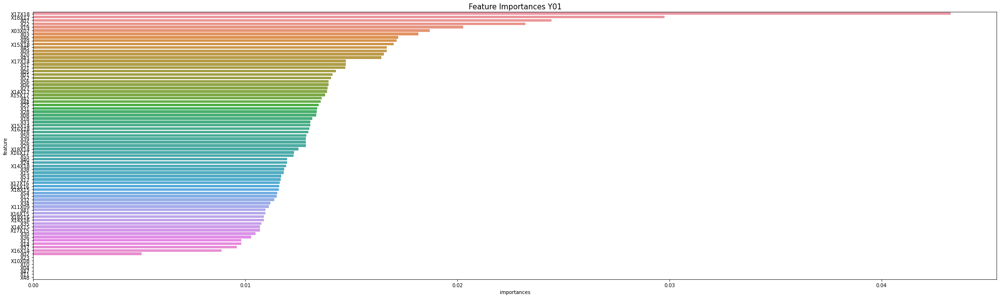

['X23', 'X10X08', 'X10', 'X04', 'X47', 'X11', 'X48']
[11:41:20] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:41:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




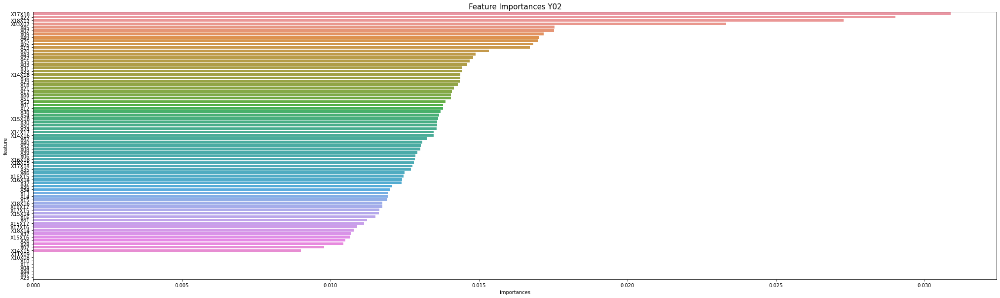

['X11X09', 'X10X08', 'X10', 'X11', 'X04', 'X48', 'X47', 'X23']
[11:41:28] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:41:31] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




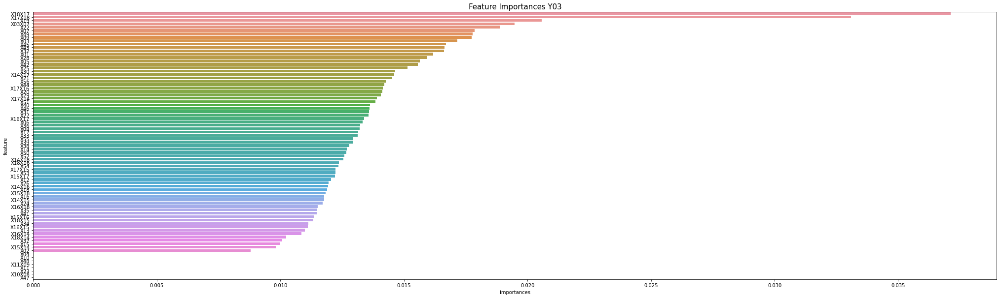

['X04', 'X10', 'X48', 'X11X09', 'X11', 'X23', 'X10X08', 'X47']
[11:41:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:41:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




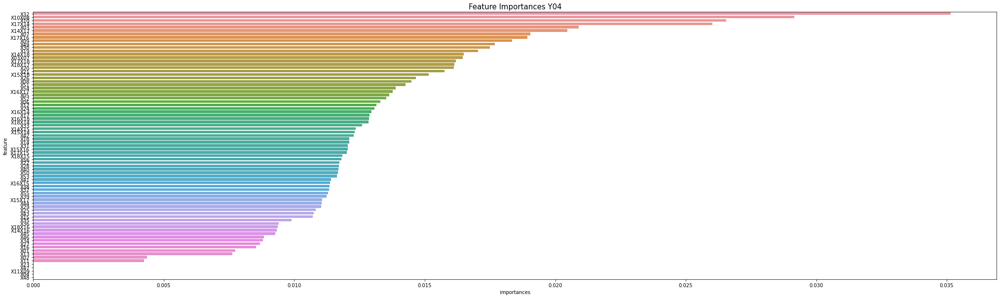

['X23', 'X47', 'X11X09', 'X04', 'X48']
[11:41:45] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:41:50] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




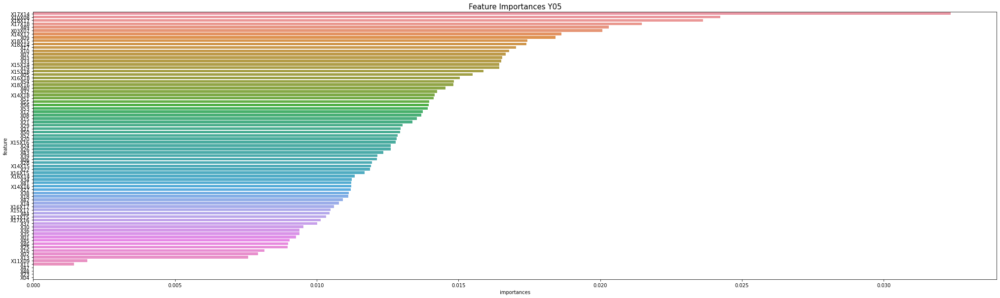

['X47', 'X48', 'X23', 'X04']
[11:41:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:42:00] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




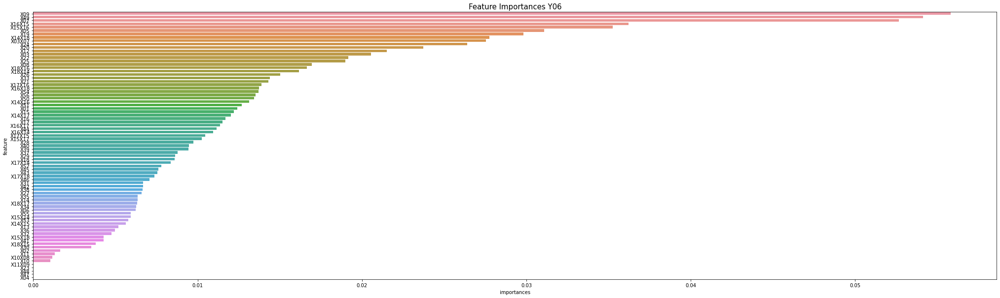

['X11X09', 'X23', 'X48', 'X47', 'X04']
[11:42:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:42:05] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




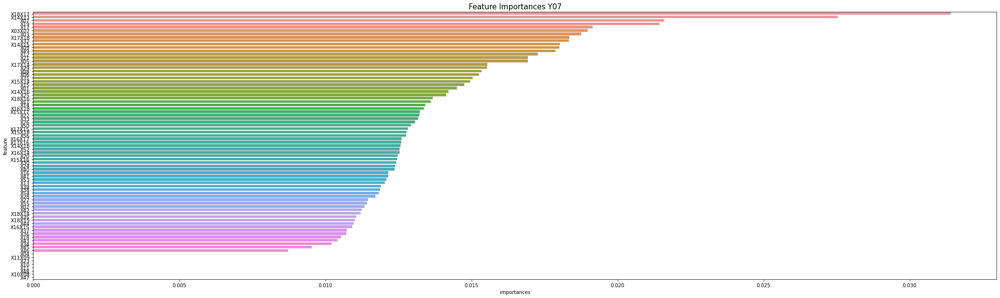

['X04', 'X11X09', 'X23', 'X10', 'X11', 'X48', 'X10X08', 'X47']
[11:42:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:42:13] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




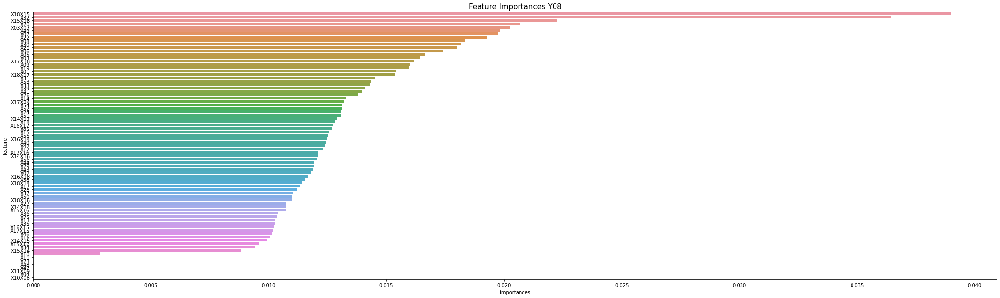

['X11', 'X23', 'X48', 'X47', 'X11X09', 'X04', 'X10X08']
[11:42:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:42:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




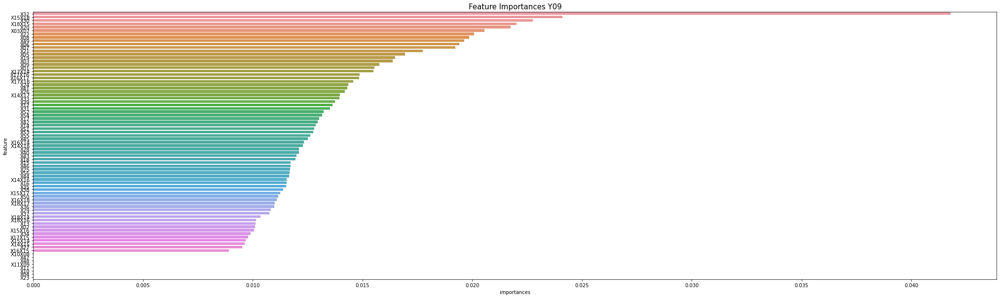

['X10X08', 'X47', 'X48', 'X11X09', 'X11', 'X10', 'X04', 'X23']
[11:42:30] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:42:36] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




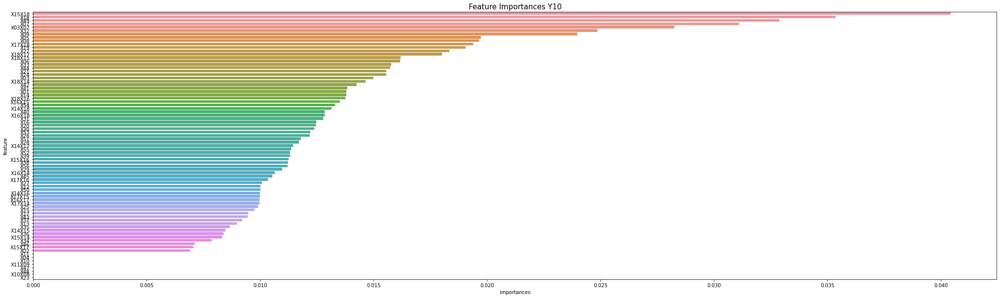

['X11', 'X04', 'X10', 'X11X09', 'X47', 'X48', 'X10X08', 'X23']
[11:42:41] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:42:46] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




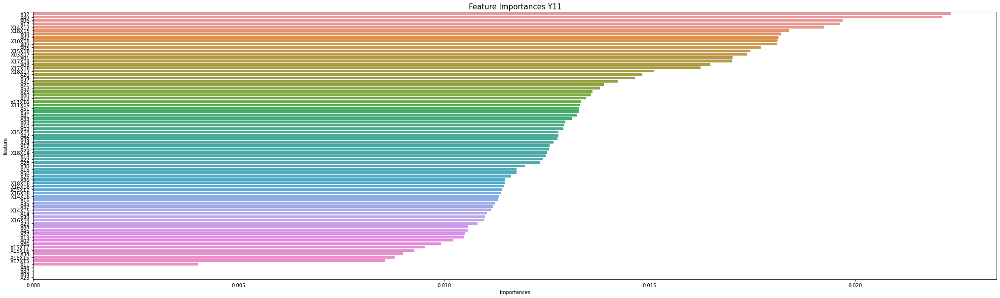

['X48', 'X47', 'X04', 'X23']
[11:42:52] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:42:58] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




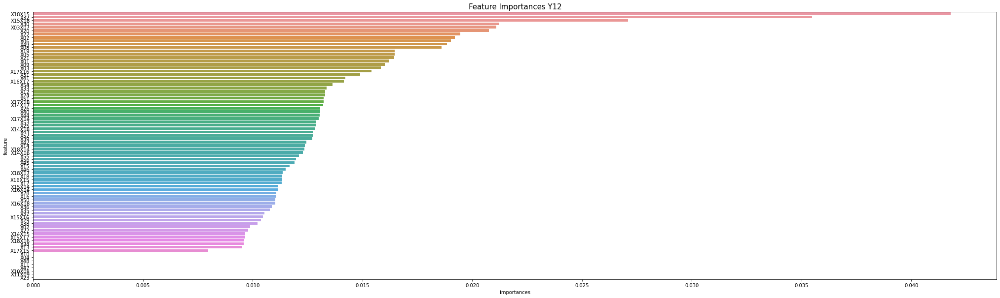

['X10', 'X04', 'X48', 'X11', 'X47', 'X10X08', 'X11X09', 'X23']
[11:43:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:43:10] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




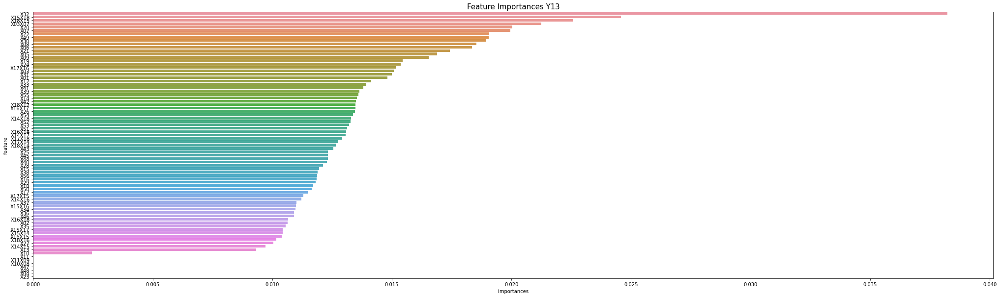

['X11', 'X11X09', 'X10X08', 'X47', 'X48', 'X04', 'X23']
[11:43:17] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:43:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




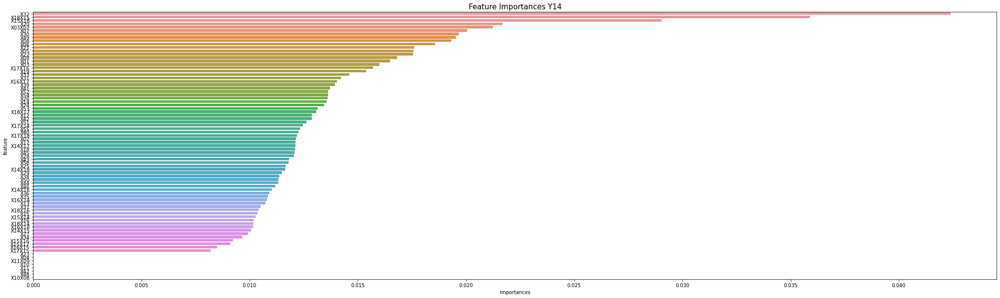

['X23', 'X04', 'X11X09', 'X10', 'X11', 'X47', 'X48', 'X10X08']
[11:43:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 0 / lg_nrmse : 1.9249157455305266
fit Y01
[11:43:31] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




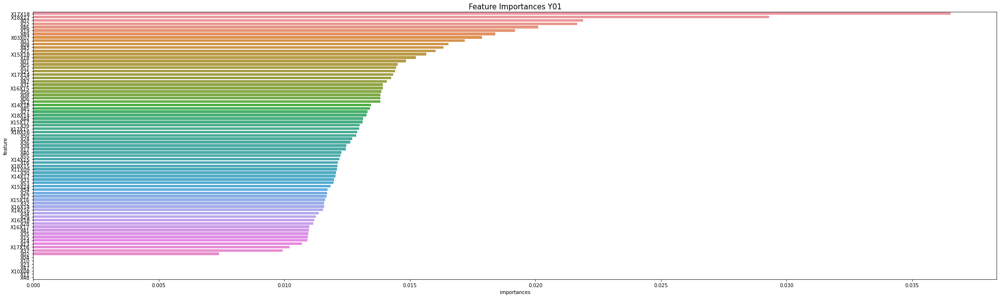

['X04', 'X10', 'X23', 'X47', 'X10X08', 'X11', 'X48']
[11:43:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:43:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




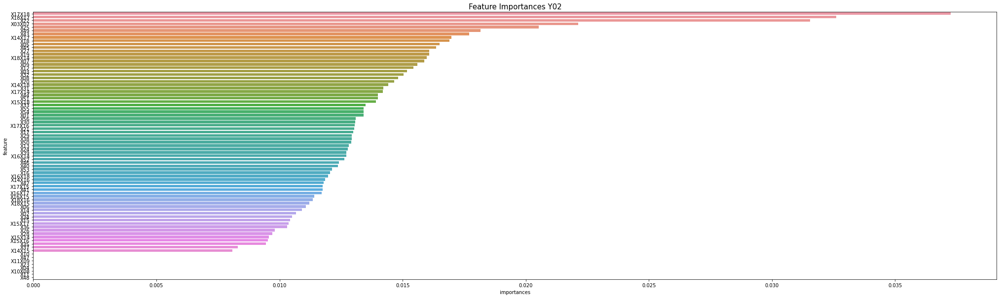

['X10', 'X47', 'X11X09', 'X23', 'X04', 'X10X08', 'X11', 'X48']
[11:43:41] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:43:44] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




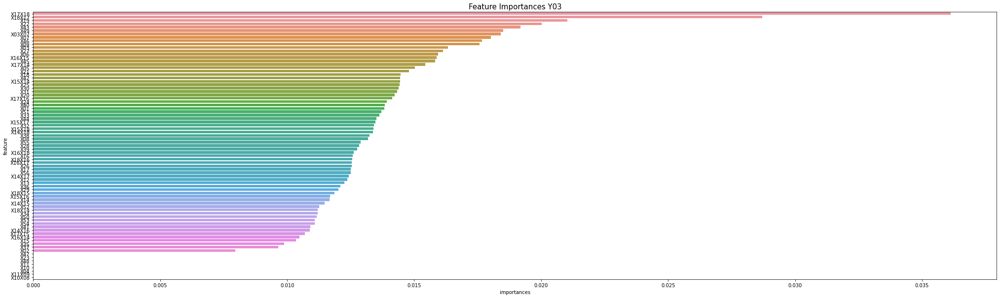

['X47', 'X23', 'X48', 'X11', 'X10', 'X04', 'X11X09', 'X10X08']
[11:43:47] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:43:49] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




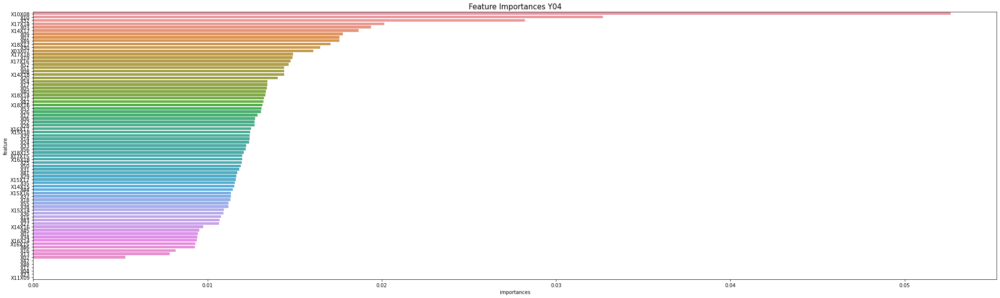

['X47', 'X48', 'X11', 'X04', 'X23', 'X11X09']
[11:43:58] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:44:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




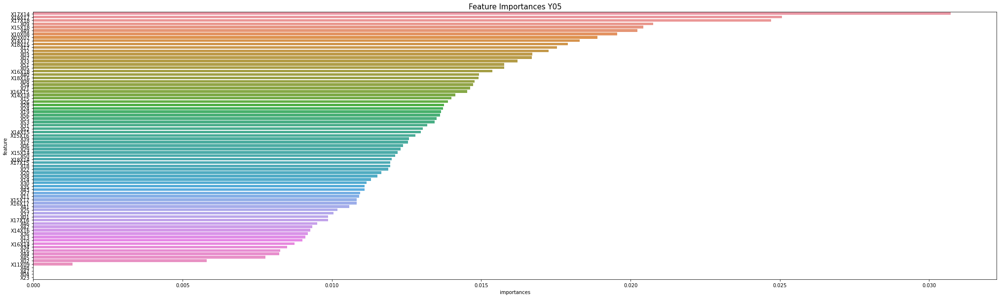

['X48', 'X47', 'X04', 'X23']
[11:44:08] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:44:12] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




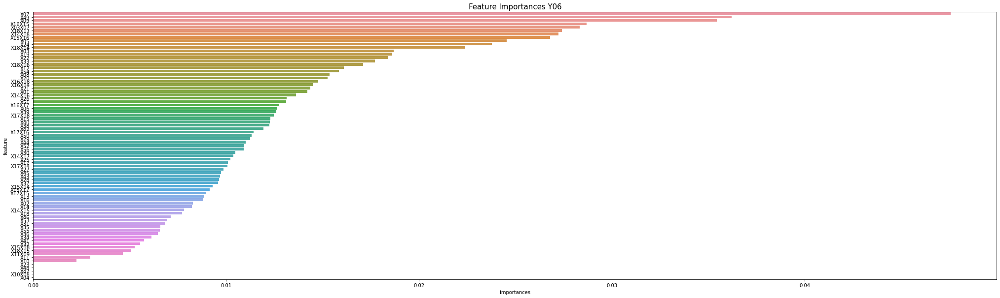

['X23', 'X48', 'X47', 'X10X08', 'X04']
[11:44:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:44:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




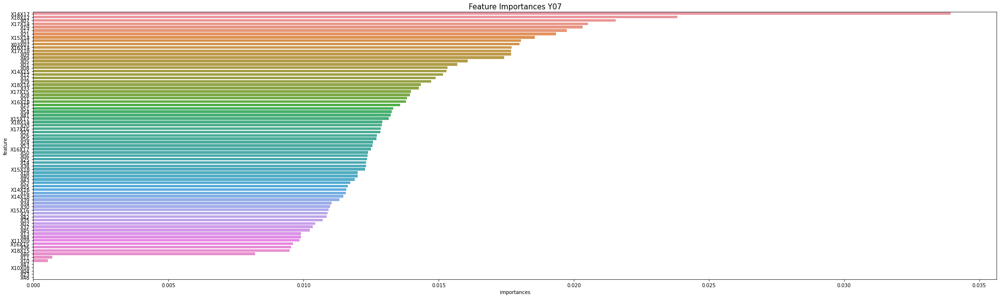

['X47', 'X10X08', 'X04', 'X23', 'X48']
[11:44:30] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:44:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




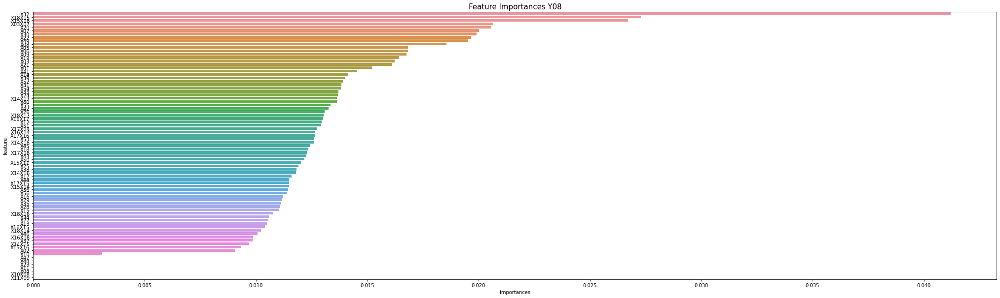

['X47', 'X48', 'X23', 'X11', 'X04', 'X10X08', 'X11X09']
[11:44:40] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:44:45] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




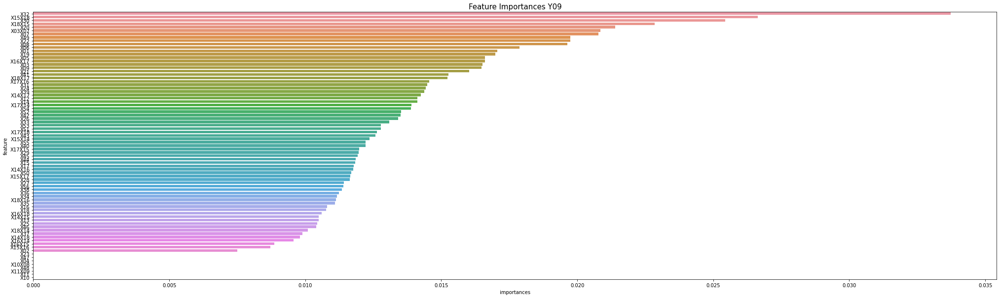

['X23', 'X47', 'X04', 'X10X08', 'X48', 'X11X09', 'X11', 'X10']
[11:44:51] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:44:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




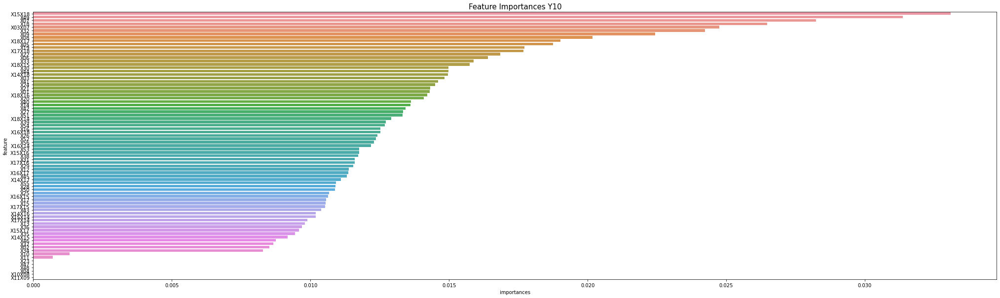

['X23', 'X47', 'X48', 'X04', 'X10X08', 'X11X09']
[11:45:02] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:45:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




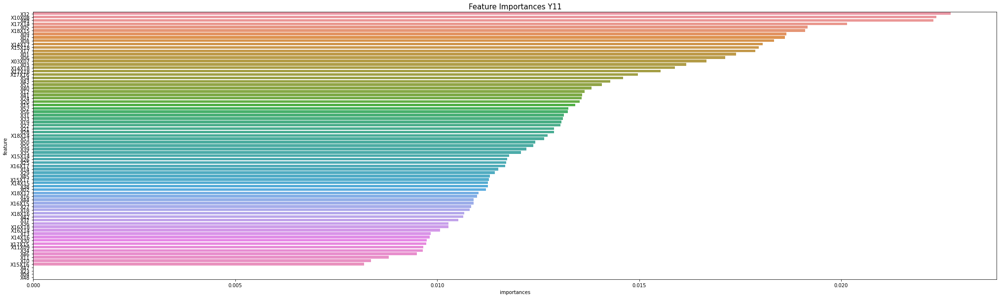

['X47', 'X23', 'X04', 'X48']
[11:45:13] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:45:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




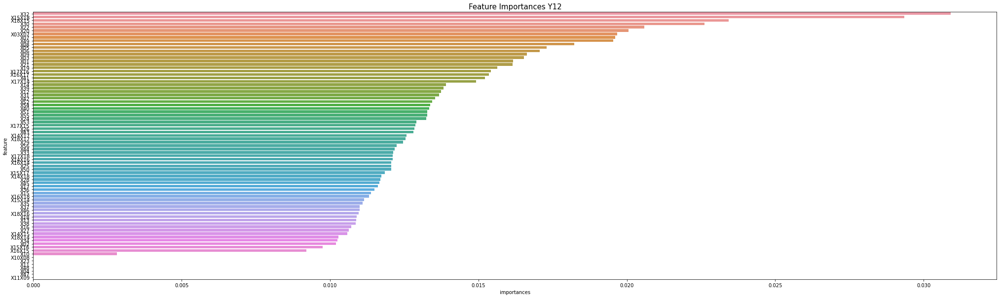

['X10X08', 'X23', 'X11', 'X48', 'X04', 'X47', 'X11X09']
[11:45:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:45:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




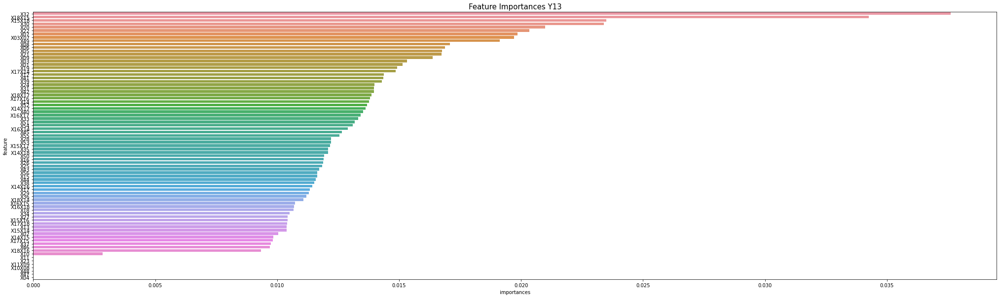

['X11', 'X23', 'X11X09', 'X10X08', 'X48', 'X47', 'X04']
[11:45:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:45:46] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




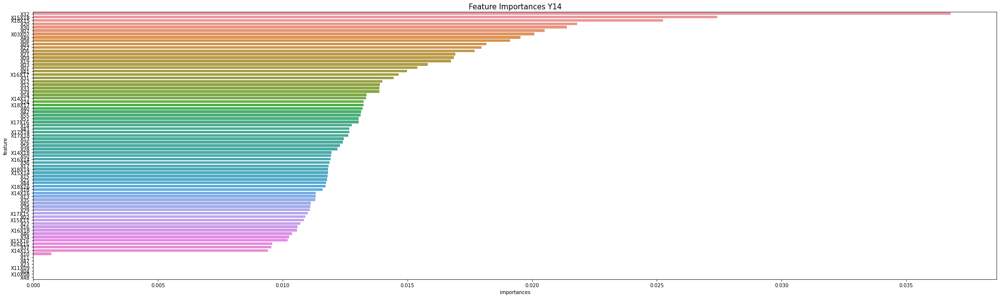

['X11', 'X47', 'X23', 'X11X09', 'X04', 'X10X08', 'X48']
[11:45:52] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 1 / lg_nrmse : 1.9307706428537315
fit Y01
[11:45:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




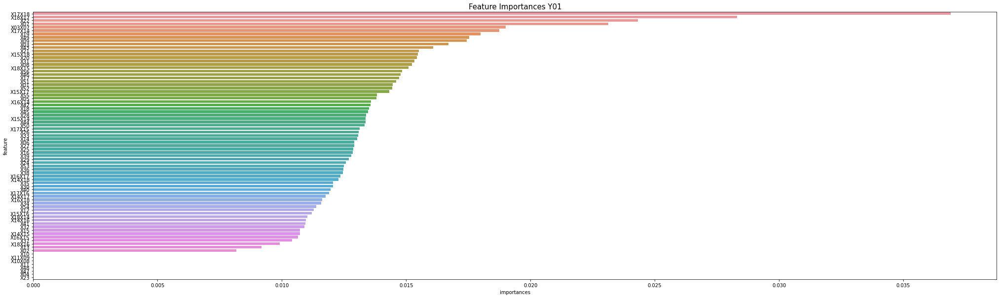

['X10', 'X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X04', 'X23']
[11:46:01] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:46:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




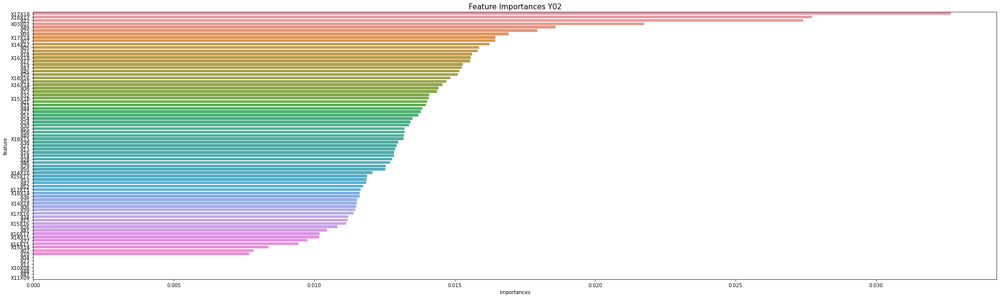

['X04', 'X23', 'X11', 'X10X08', 'X48', 'X47', 'X11X09']
[11:46:08] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:46:11] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




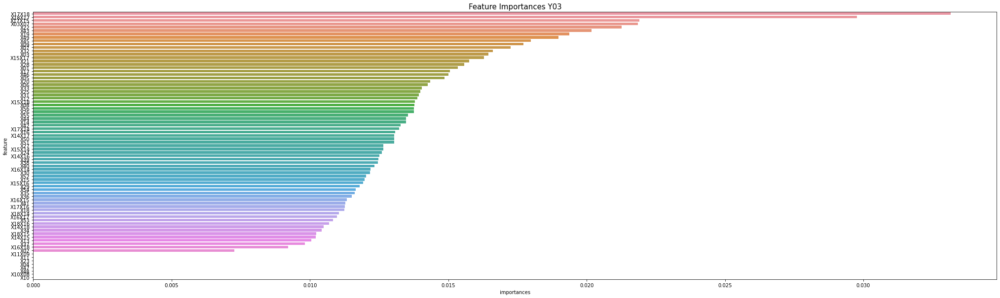

['X11X09', 'X11', 'X23', 'X04', 'X47', 'X48', 'X10X08', 'X10']
[11:46:14] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:46:17] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




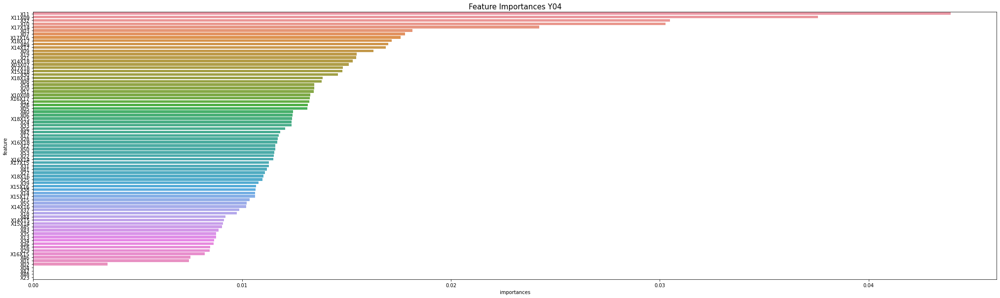

['X04', 'X47', 'X48', 'X23']
[11:46:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:46:31] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




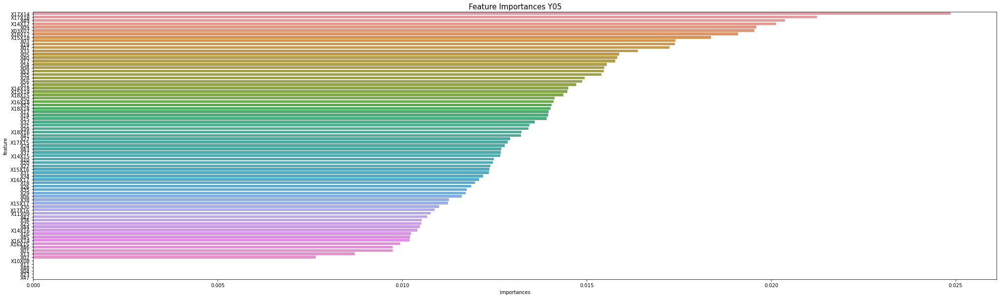

['X10X08', 'X11', 'X48', 'X04', 'X23', 'X47']
[11:46:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:46:44] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




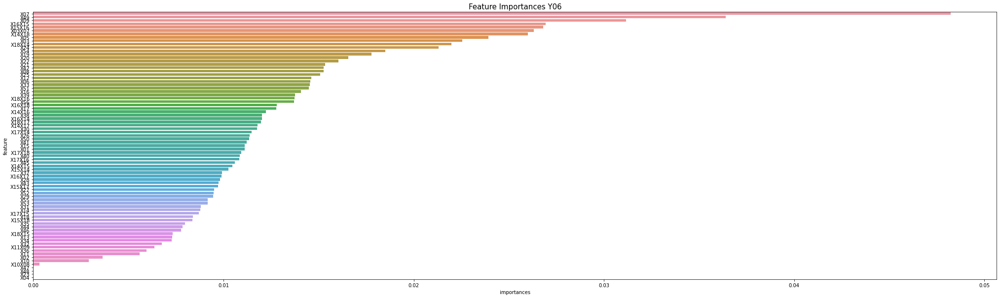

['X47', 'X48', 'X23', 'X04']
[11:46:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:47:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




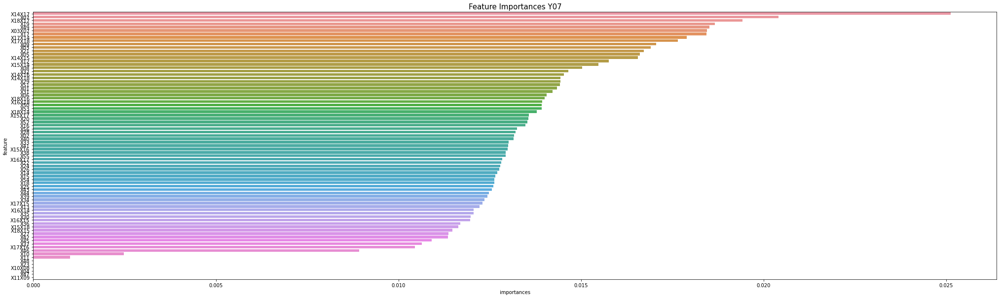

['X48', 'X23', 'X10X08', 'X04', 'X47', 'X11X09']
[11:47:11] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:47:15] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




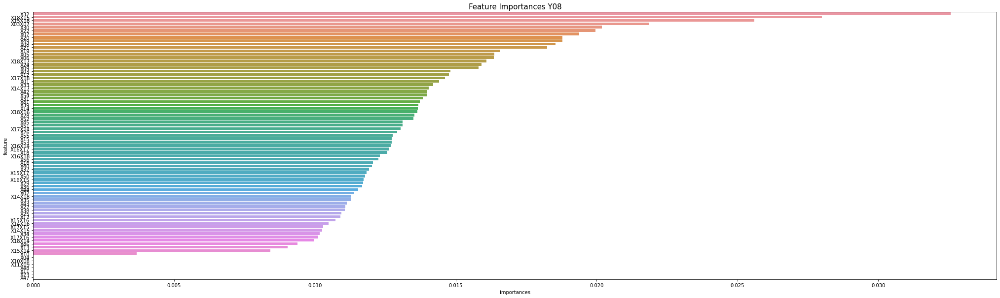

['X04', 'X10X08', 'X11X09', 'X48', 'X11', 'X23', 'X47']
[11:47:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:47:31] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




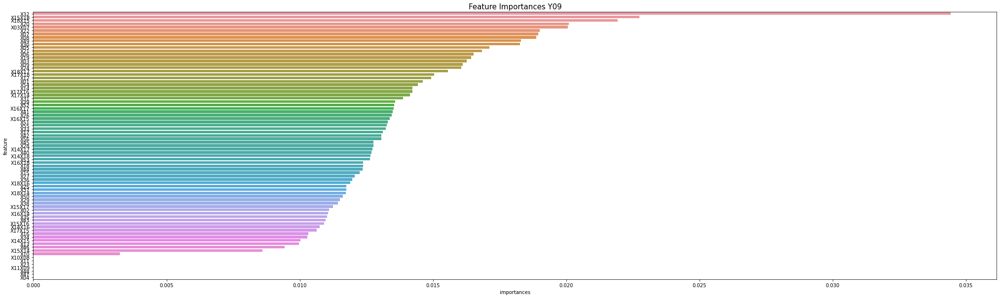

['X10X08', 'X11', 'X23', 'X11X09', 'X48', 'X47', 'X04']
[11:47:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:47:47] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




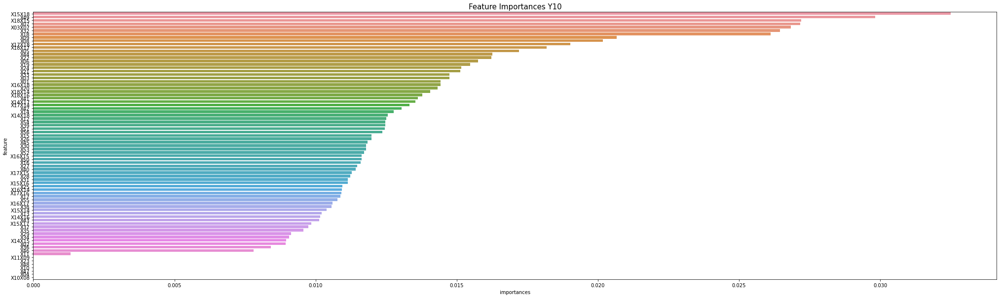

['X11X09', 'X23', 'X48', 'X10', 'X47', 'X04', 'X10X08']
[11:47:54] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:48:02] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




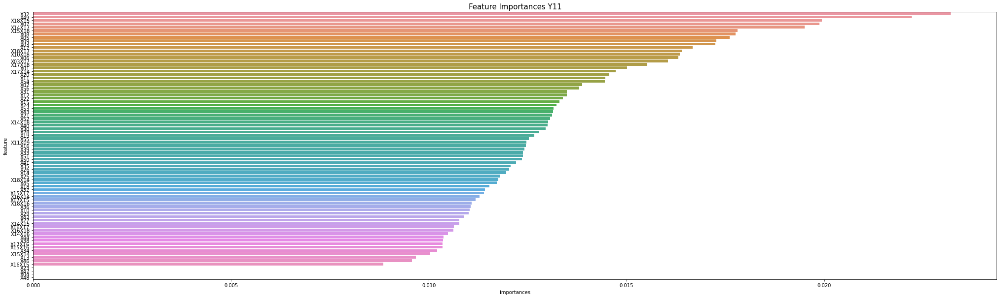

['X23', 'X47', 'X04', 'X48']
[11:48:08] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:48:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




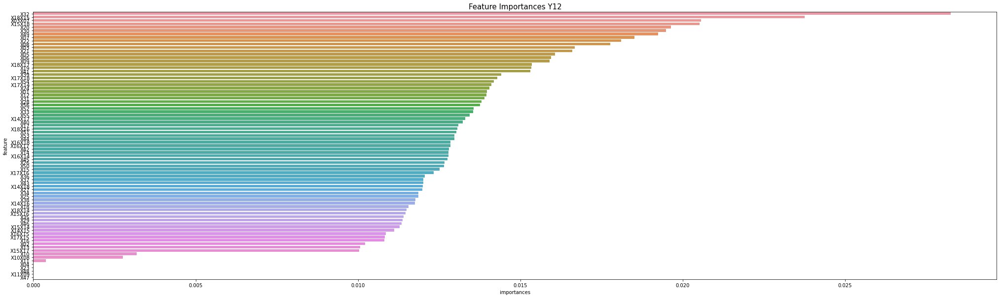

['X04', 'X23', 'X48', 'X11X09', 'X47']
[11:48:26] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:48:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




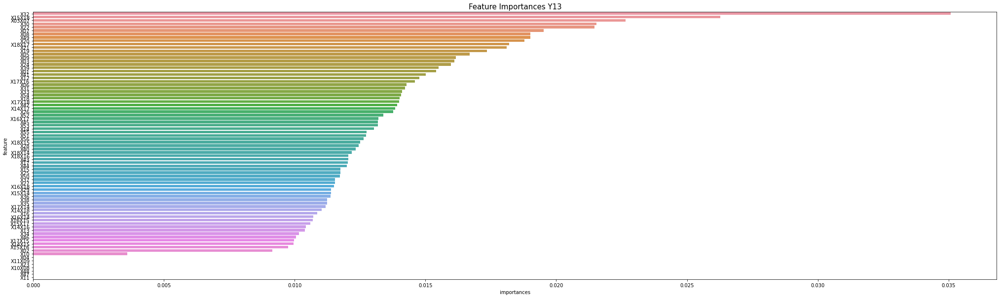

['X04', 'X11X09', 'X23', 'X10X08', 'X48', 'X47', 'X11']
[11:48:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:48:45] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




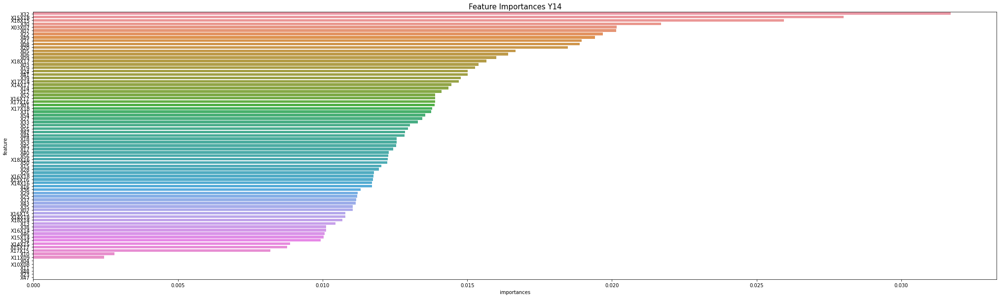

['X04', 'X10X08', 'X11', 'X48', 'X23', 'X47']
[11:48:51] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 2 / lg_nrmse : 1.9752737214076634
fit Y01
[11:49:00] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




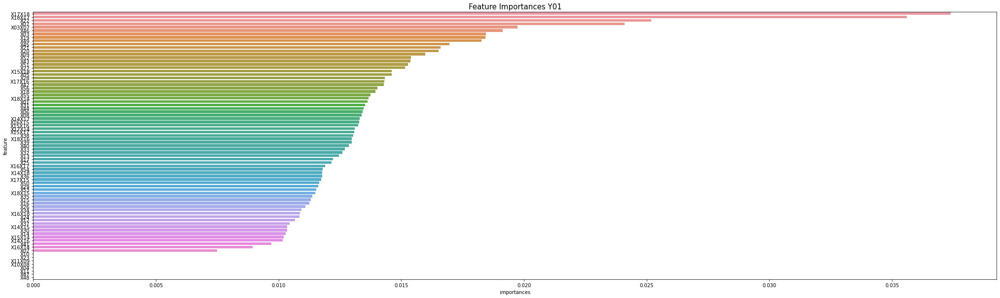

['X10', 'X23', 'X11X09', 'X10X08', 'X04', 'X11', 'X47', 'X48']
[11:49:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:49:06] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




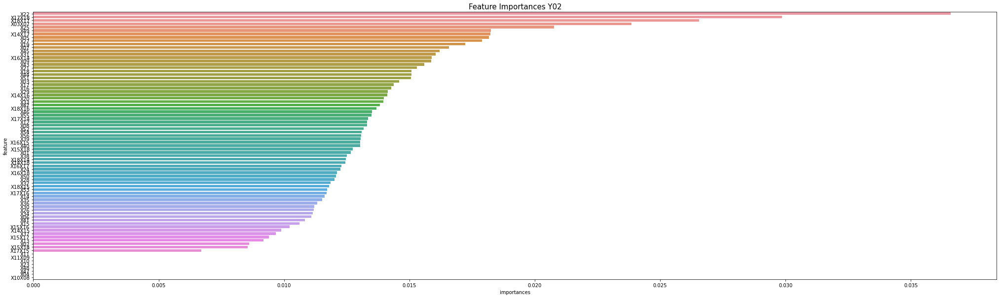

['X11', 'X11X09', 'X10', 'X23', 'X48', 'X47', 'X04', 'X10X08']
[11:49:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:49:11] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




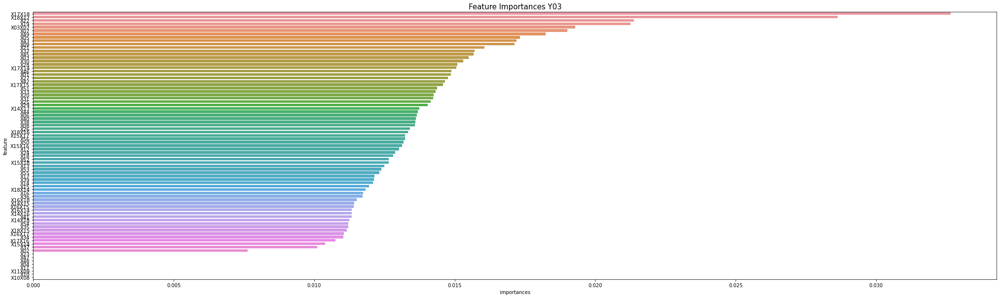

['X23', 'X47', 'X48', 'X04', 'X11', 'X11X09', 'X10', 'X10X08']
[11:49:15] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:49:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




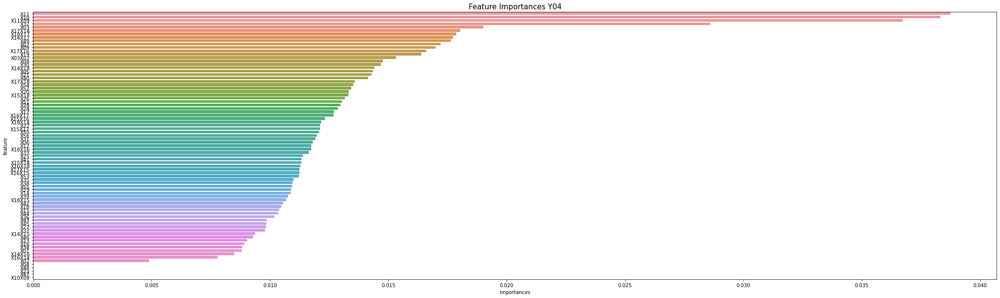

['X04', 'X48', 'X23', 'X47', 'X10X08']
[11:49:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:49:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




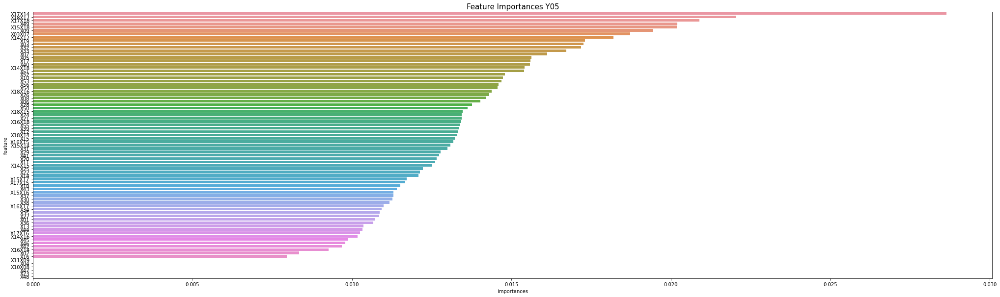

['X11X09', 'X04', 'X10X08', 'X47', 'X23', 'X48']
[11:49:40] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:49:45] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




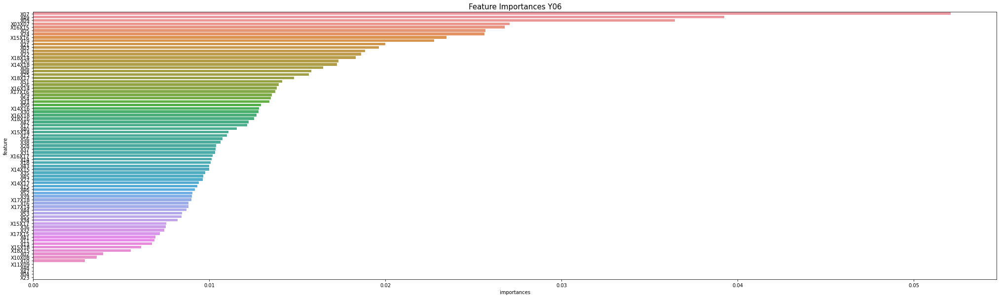

['X11X09', 'X48', 'X47', 'X04', 'X23']
[11:49:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:50:08] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




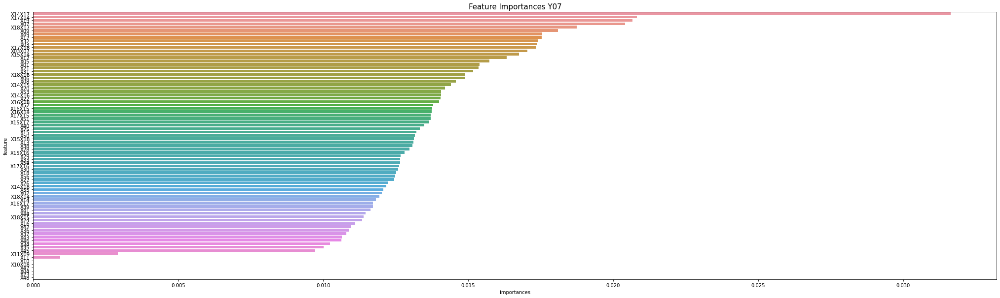

['X10', 'X10X08', 'X47', 'X04', 'X23', 'X48']
[11:50:14] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:50:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




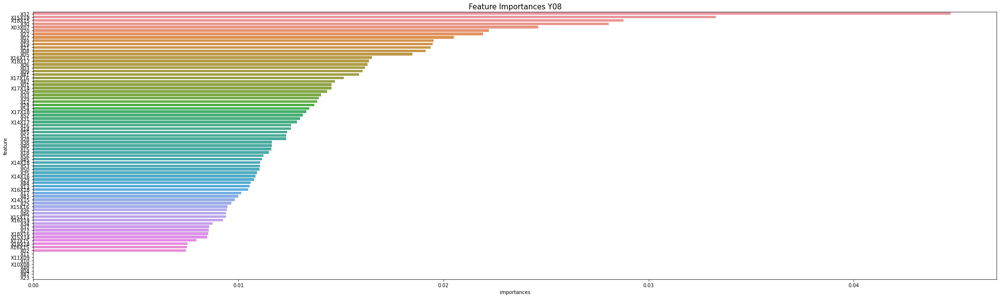

['X11', 'X11X09', 'X10', 'X10X08', 'X48', 'X04', 'X47', 'X23']
[11:50:25] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:50:28] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




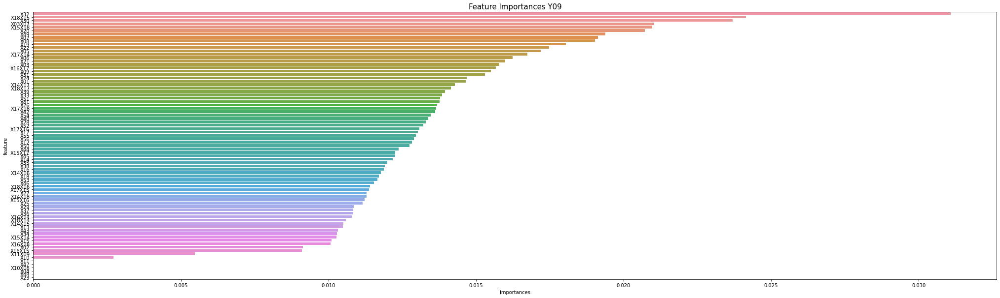

['X11', 'X47', 'X10X08', 'X04', 'X48', 'X23']
[11:50:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:50:40] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




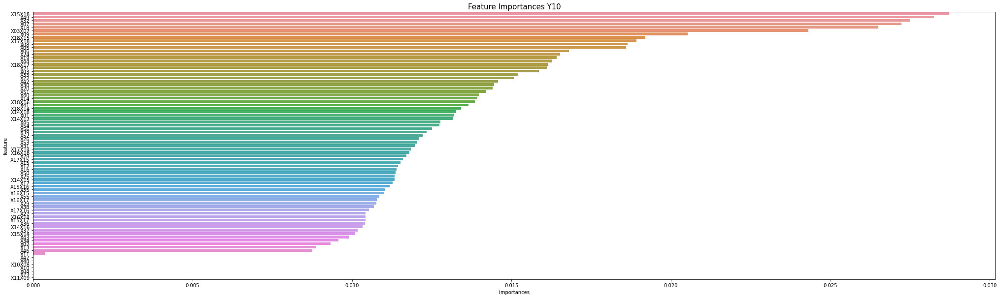

['X47', 'X48', 'X10X08', 'X10', 'X04', 'X23', 'X11X09']
[11:50:49] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:50:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




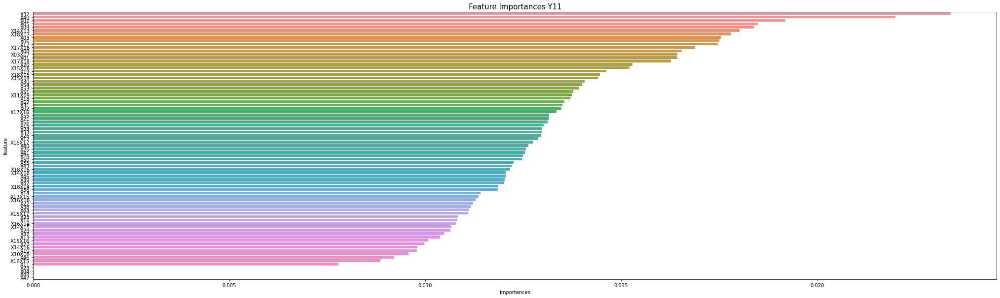

['X23', 'X04', 'X48', 'X47']
[11:51:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:51:11] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




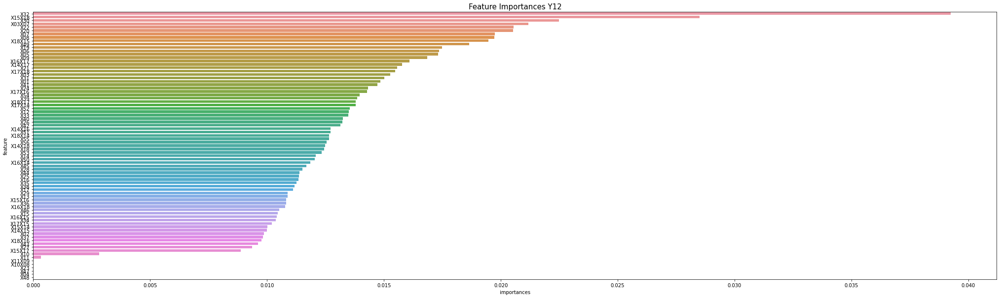

['X11X09', 'X10X08', 'X23', 'X47', 'X04', 'X48']
[11:51:17] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:51:22] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




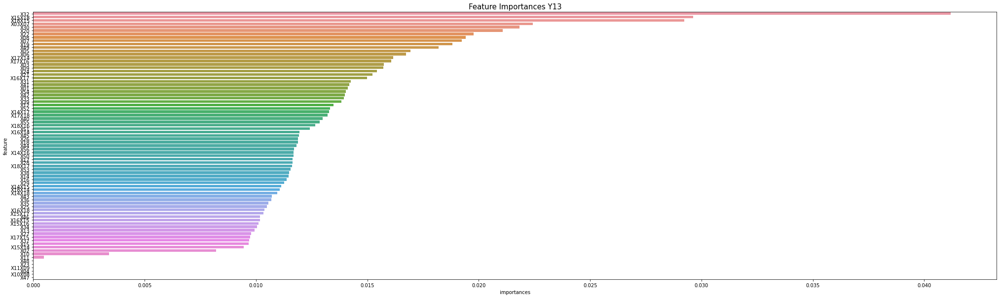

['X48', 'X23', 'X11X09', 'X04', 'X10X08', 'X47']
[11:51:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:51:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




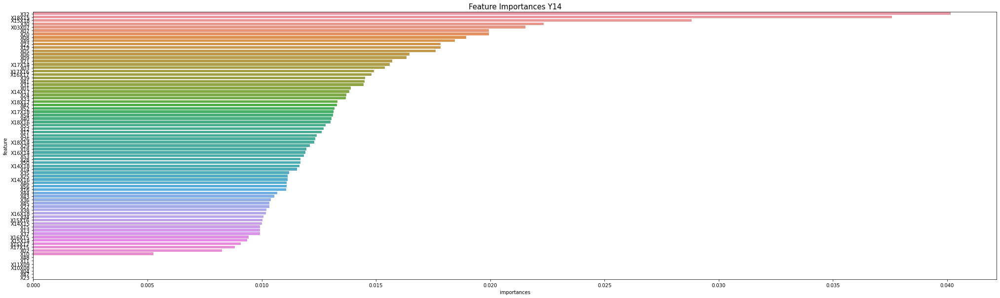

['X48', 'X11', 'X11X09', 'X10X08', 'X04', 'X47', 'X23']
[11:51:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 3 / lg_nrmse : 1.9381698028524341
fit Y01
[11:51:43] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




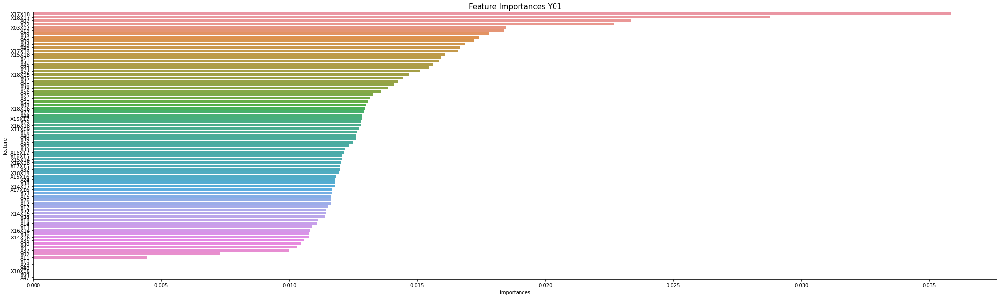

['X10', 'X23', 'X48', 'X10X08', 'X04', 'X47']
[11:51:47] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:51:50] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




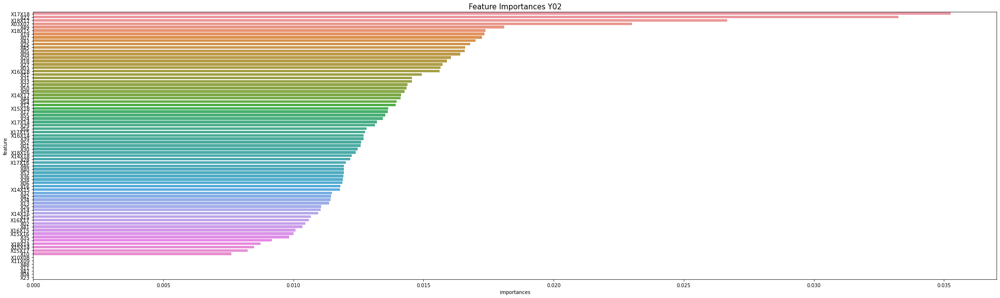

['X10X08', 'X11X09', 'X48', 'X11', 'X47', 'X04', 'X23']
[11:51:53] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:51:55] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




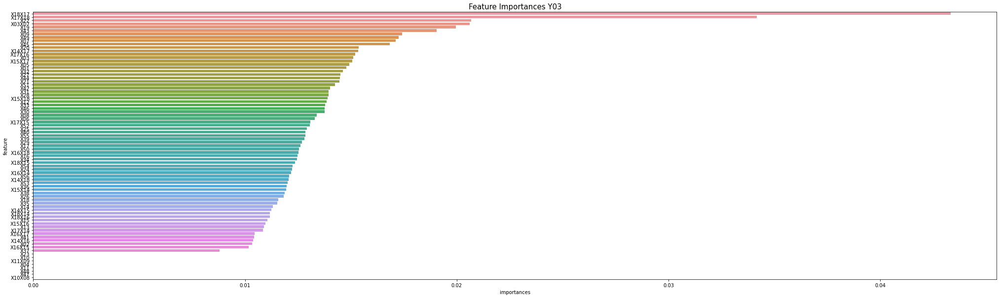

['X23', 'X10', 'X11X09', 'X04', 'X11', 'X48', 'X47', 'X10X08']
[11:51:59] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:52:01] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




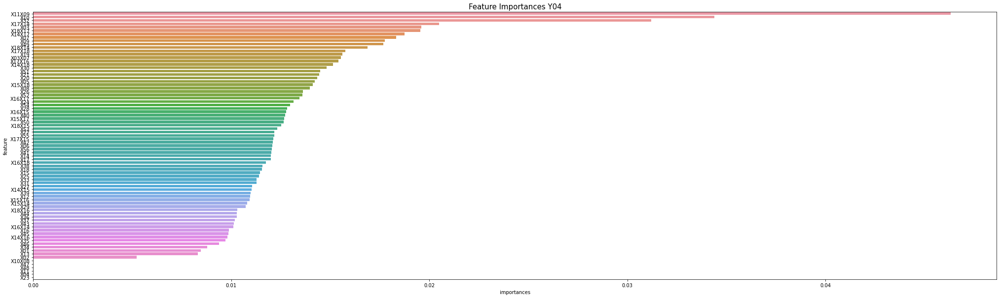

['X10X08', 'X47', 'X48', 'X11', 'X04', 'X23']
[11:52:10] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:52:15] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




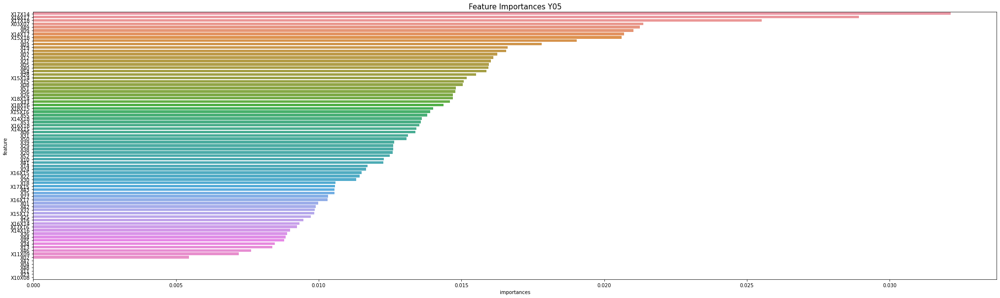

['X47', 'X04', 'X48', 'X11', 'X23', 'X10X08']
[11:52:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:52:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




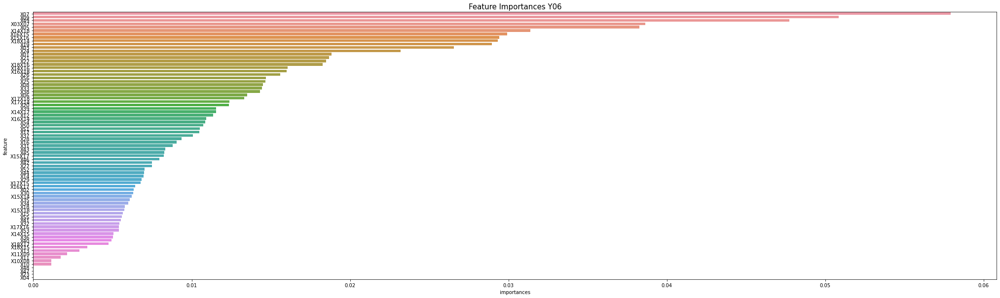

['X48', 'X47', 'X23', 'X04']
[11:52:26] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:52:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




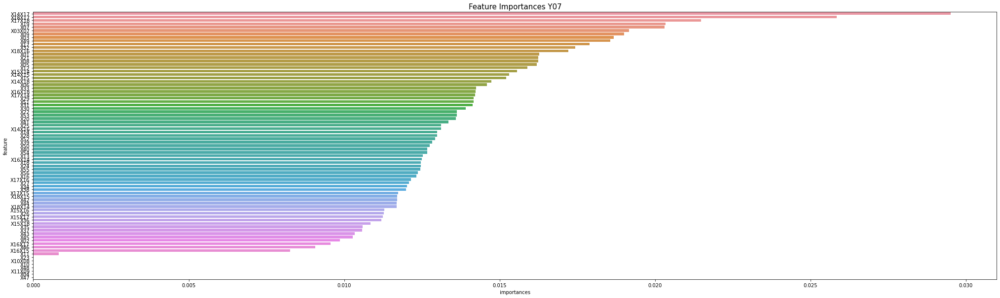

['X23', 'X10X08', 'X10', 'X48', 'X11X09', 'X04', 'X47']
[11:52:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:52:36] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




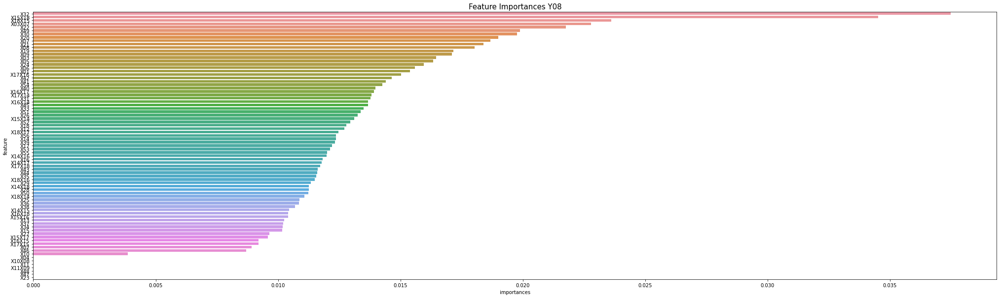

['X04', 'X10X08', 'X11', 'X11X09', 'X48', 'X47', 'X23']
[11:52:41] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:52:46] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




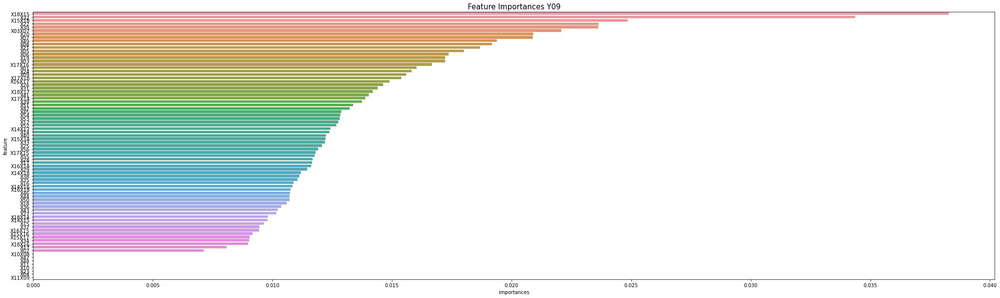

['X10X08', 'X47', 'X48', 'X11', 'X10', 'X23', 'X04', 'X11X09']
[11:52:50] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:52:54] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




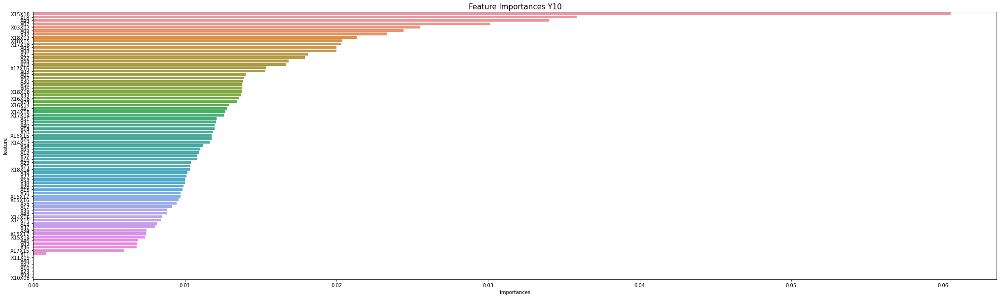

['X11X09', 'X48', 'X47', 'X10', 'X23', 'X04', 'X10X08']
[11:52:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:53:00] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




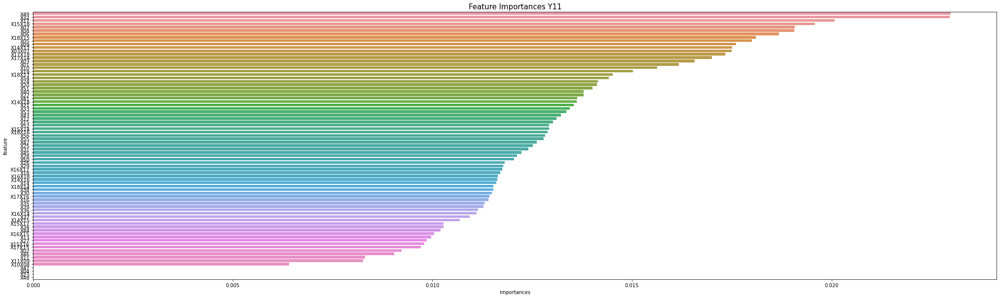

['X47', 'X04', 'X23', 'X48']
[11:53:06] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:53:11] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




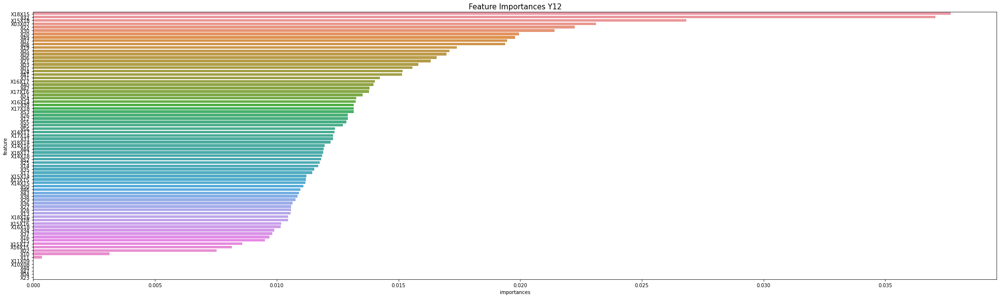

['X11X09', 'X10X08', 'X48', 'X47', 'X04', 'X23']
[11:53:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:53:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




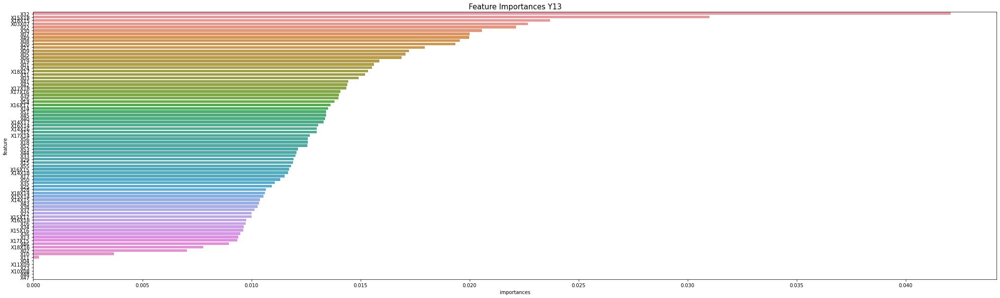

['X04', 'X11X09', 'X23', 'X10X08', 'X48', 'X47']
[11:53:26] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:53:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




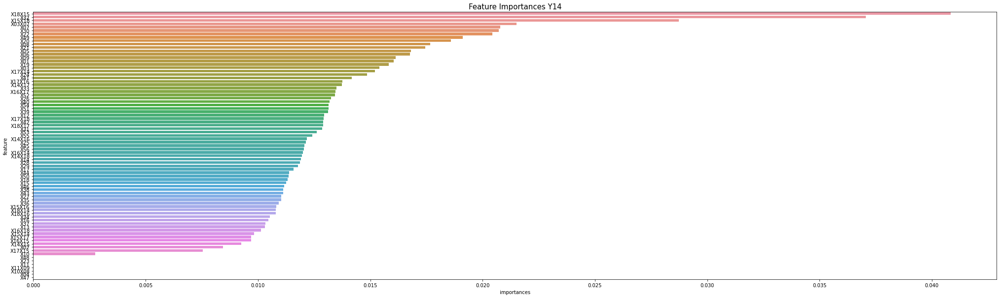

['X48', 'X23', 'X11', 'X11X09', 'X10X08', 'X04', 'X47']
[11:53:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 4 / lg_nrmse : 1.9424458901313746
fit Y01
[11:53:43] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




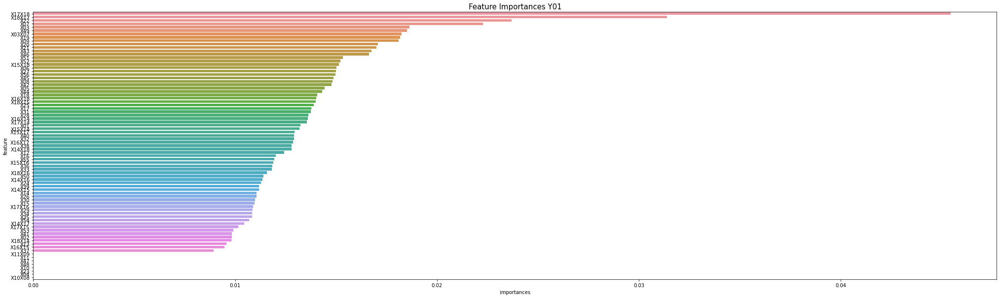

['X11X09', 'X11', 'X47', 'X48', 'X10', 'X23', 'X04', 'X10X08']
[11:53:46] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:53:49] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




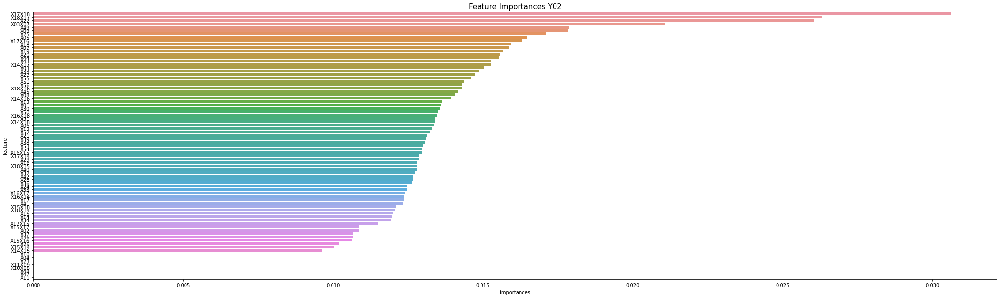

['X10', 'X04', 'X23', 'X11X09', 'X10X08', 'X48', 'X47', 'X11']
[11:53:54] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:53:58] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




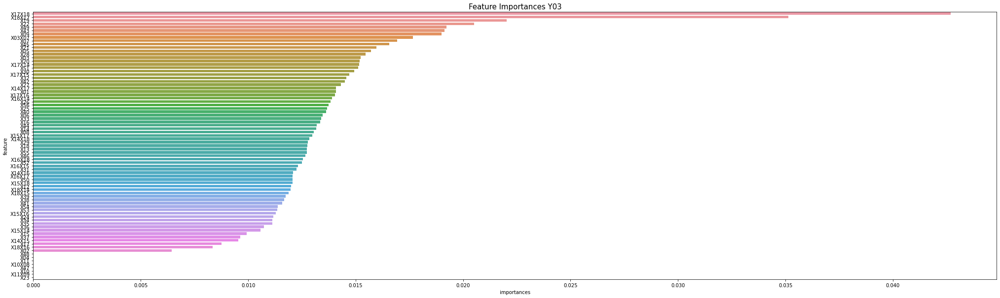

['X48', 'X04', 'X11', 'X10X08', 'X47', 'X10', 'X11X09', 'X23']
[11:54:01] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:54:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




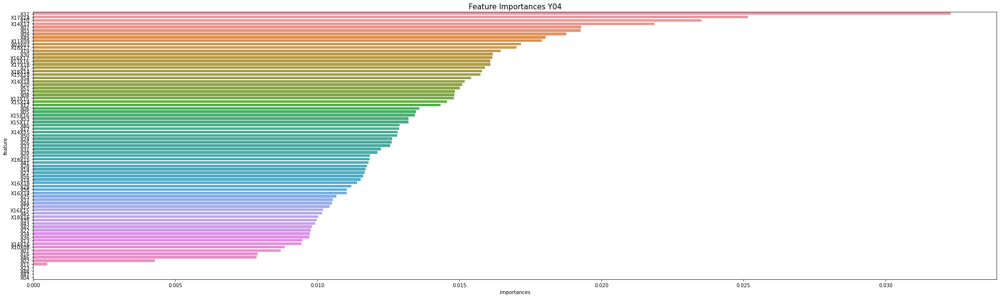

['X23', 'X48', 'X47', 'X04']
[11:54:10] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:54:15] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




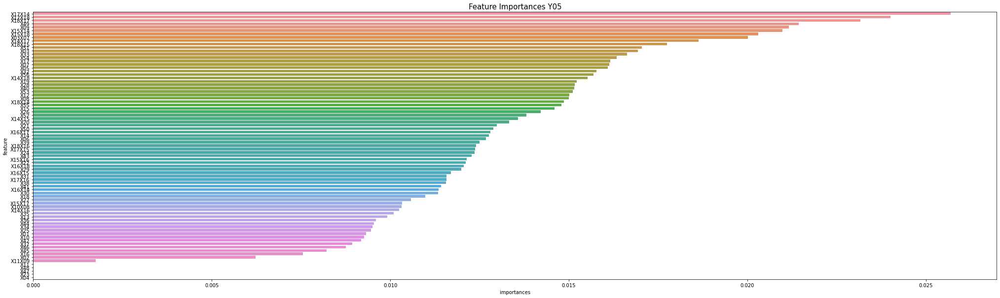

['X11', 'X48', 'X47', 'X23', 'X04']
[11:54:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:54:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




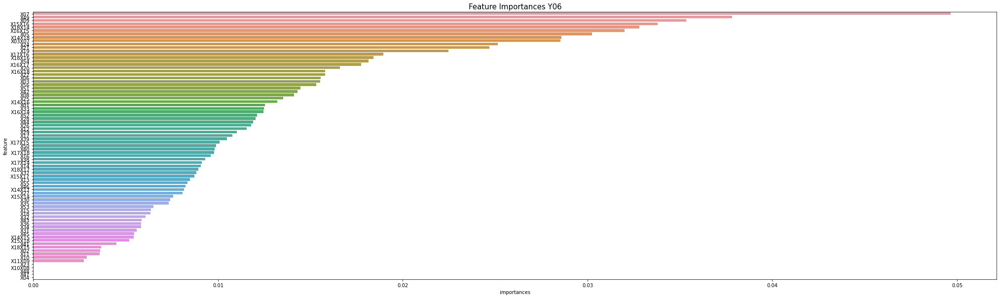

['X23', 'X10X08', 'X48', 'X47', 'X04']
[11:54:28] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:54:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




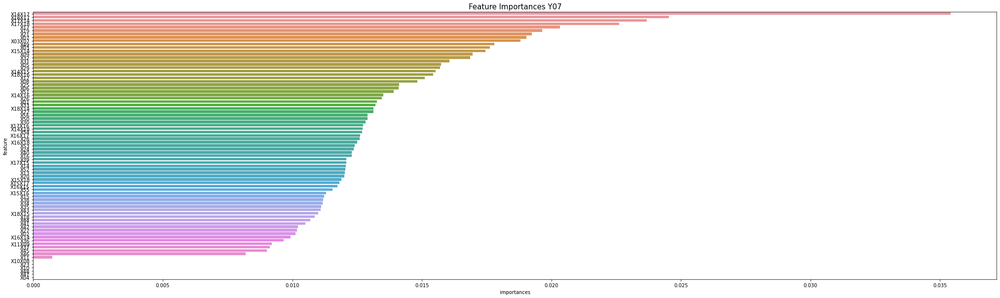

['X10X08', 'X23', 'X10', 'X48', 'X47', 'X04']
[11:54:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:54:43] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




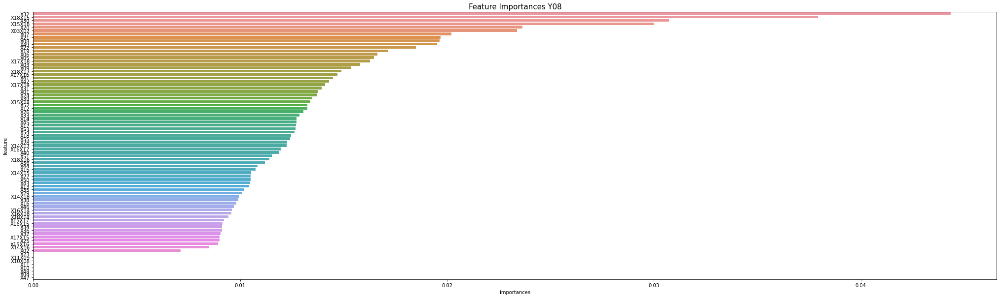

['X23', 'X11X09', 'X10X08', 'X11', 'X10', 'X48', 'X04', 'X47']
[11:54:47] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:54:53] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




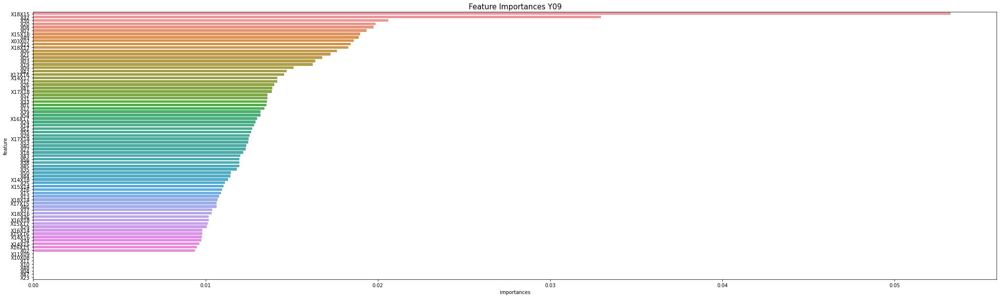

['X11X09', 'X10X08', 'X11', 'X10', 'X48', 'X04', 'X47', 'X23']
[11:54:59] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:55:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




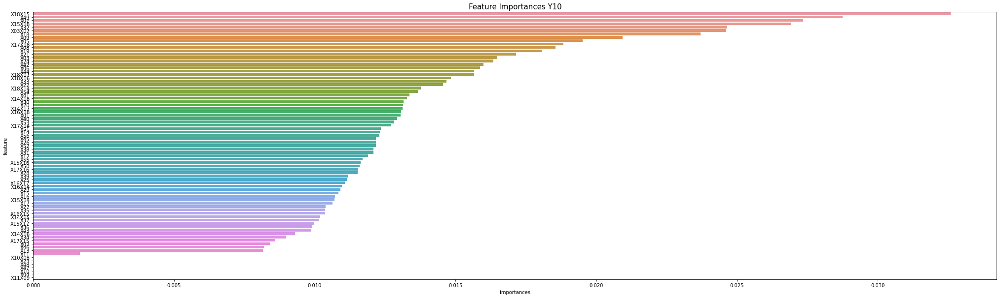

['X10X08', 'X23', 'X48', 'X47', 'X10', 'X04', 'X11X09']
[11:55:12] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:55:22] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




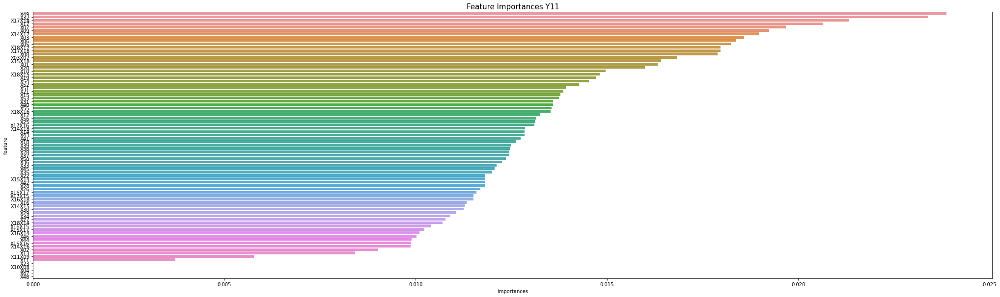

['X23', 'X10X08', 'X04', 'X47', 'X48']
[11:55:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:55:34] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




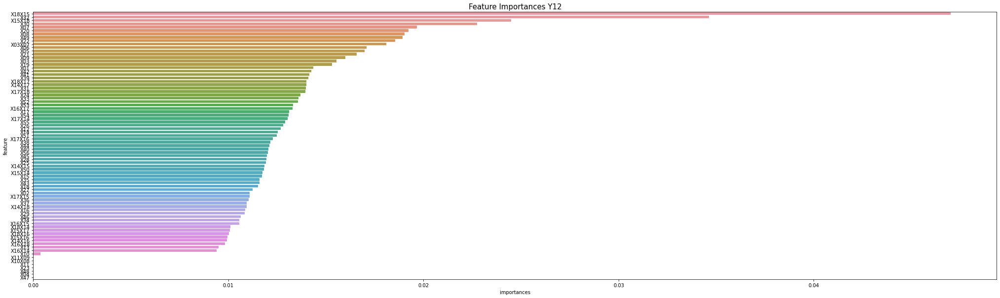

['X11X09', 'X10X08', 'X11', 'X23', 'X48', 'X04', 'X47']
[11:55:41] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:55:45] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




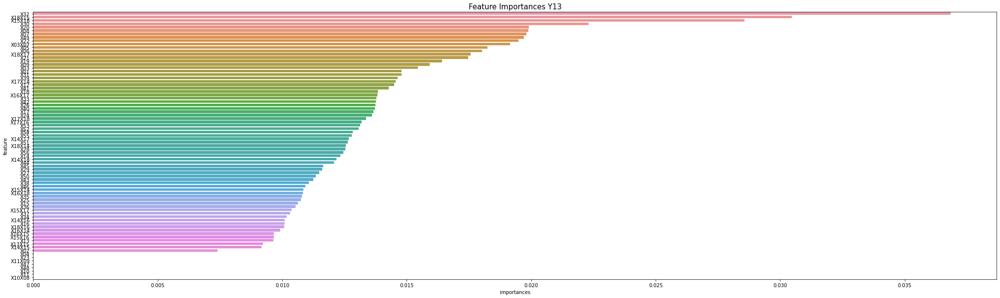

['X04', 'X23', 'X11X09', 'X47', 'X48', 'X10', 'X11', 'X10X08']
[11:55:51] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:55:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




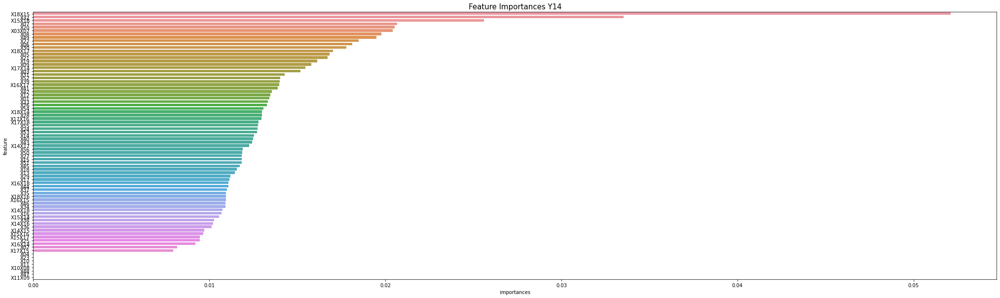

['X04', 'X23', 'X10', 'X11', 'X10X08', 'X48', 'X47', 'X11X09']
[11:56:02] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 5 / lg_nrmse : 1.941287058115473
fit Y01
[11:56:06] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




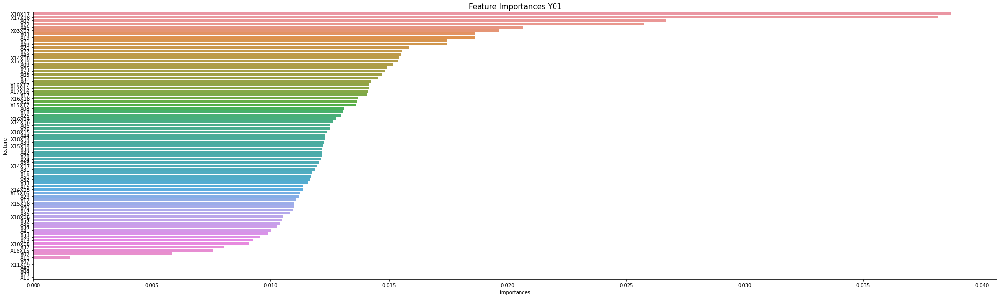

['X47', 'X11X09', 'X48', 'X04', 'X23', 'X11']
[11:56:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:56:12] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




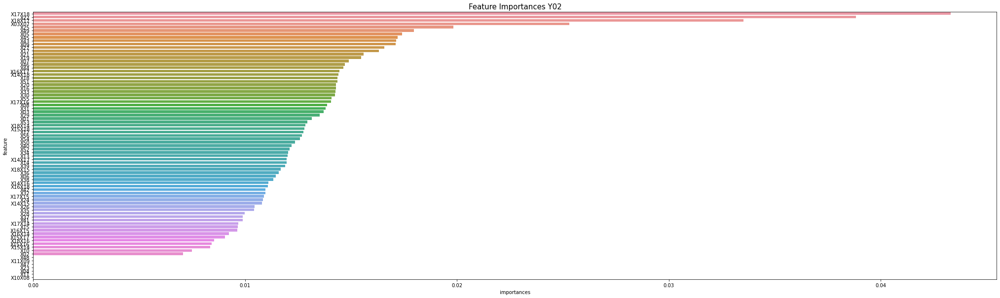

['X48', 'X11X09', 'X47', 'X23', 'X04', 'X11', 'X10X08']
[11:56:14] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:56:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




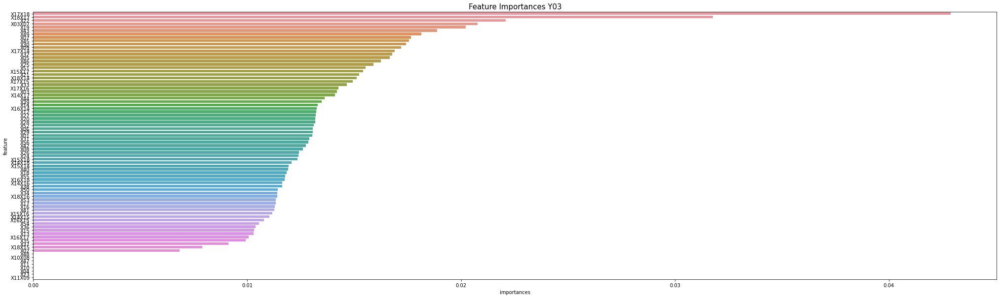

['X48', 'X10X08', 'X47', 'X11', 'X10', 'X04', 'X23', 'X11X09']
[11:56:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:56:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




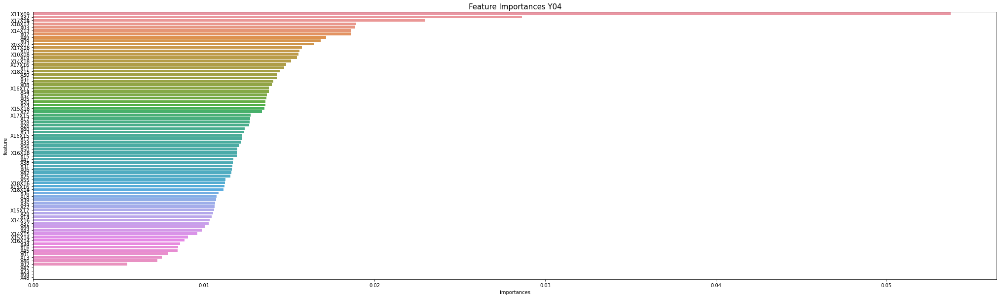

['X47', 'X23', 'X04', 'X48']
[11:56:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:56:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




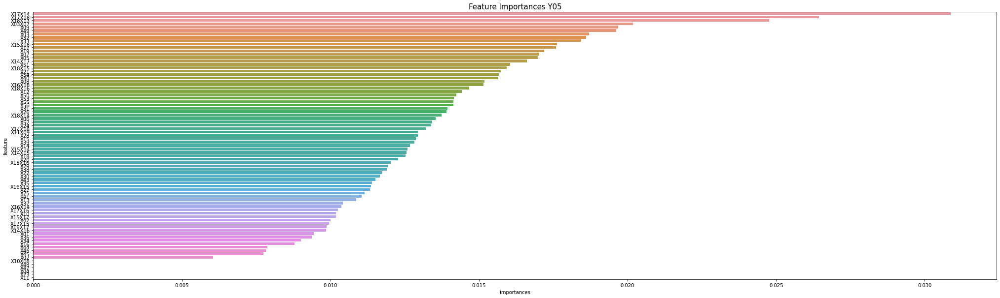

['X10X08', 'X48', 'X47', 'X04', 'X23', 'X11']
[11:56:44] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:56:49] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




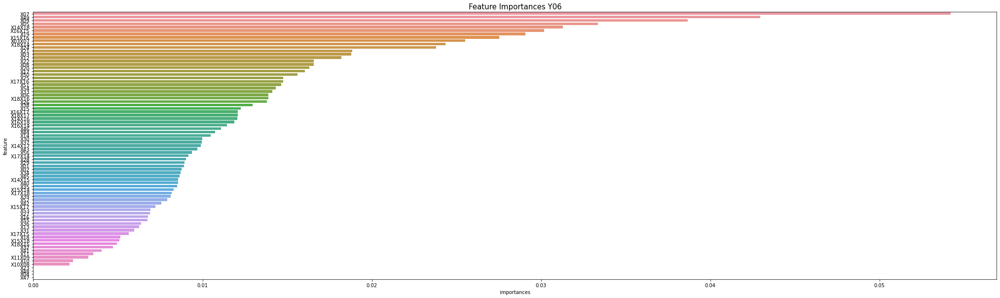

['X23', 'X48', 'X04', 'X47']
[11:56:55] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:56:59] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




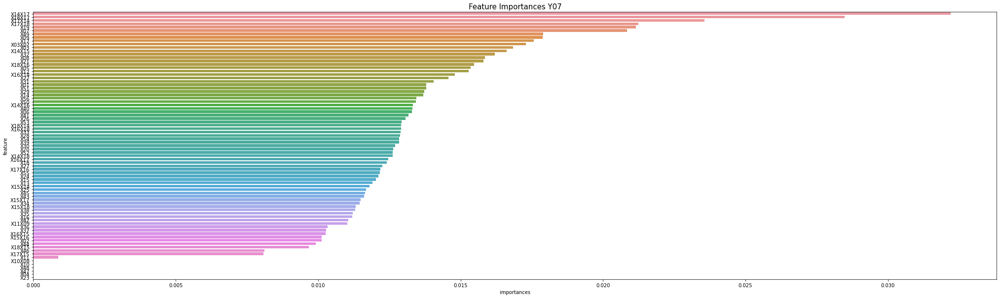

['X10X08', 'X10', 'X48', 'X47', 'X04', 'X23']
[11:57:04] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:57:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




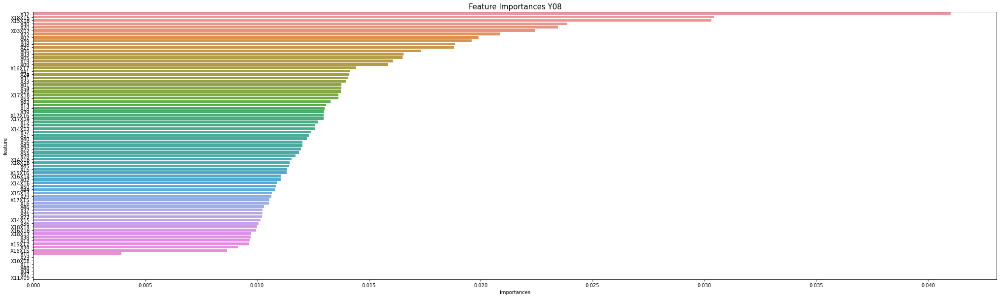

['X23', 'X10X08', 'X11', 'X48', 'X04', 'X47', 'X11X09']
[11:57:14] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:57:18] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




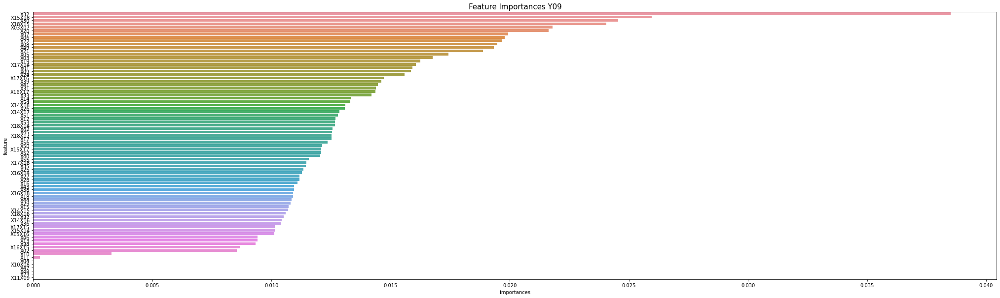

['X04', 'X10X08', 'X47', 'X48', 'X23', 'X11X09']
[11:57:23] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:57:27] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




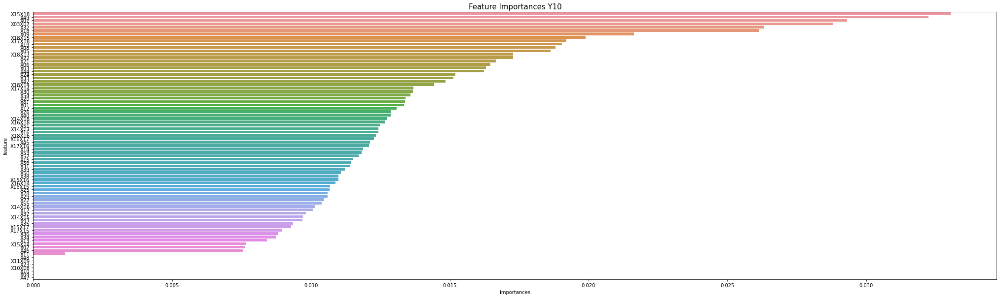

['X48', 'X11X09', 'X23', 'X10X08', 'X10', 'X04', 'X47']
[11:57:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:57:40] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




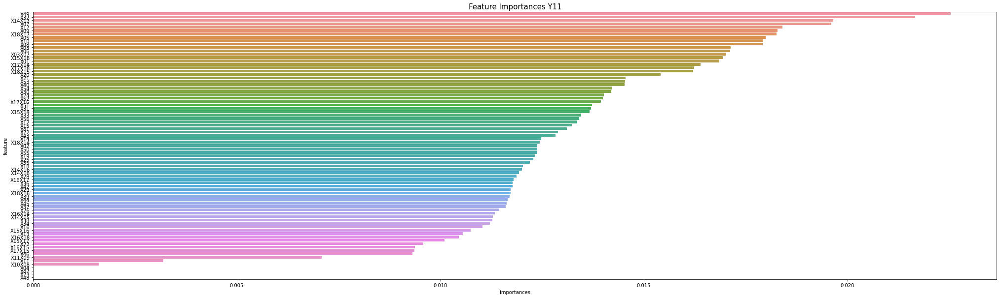

['X04', 'X47', 'X23', 'X48']
[11:57:46] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:57:53] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




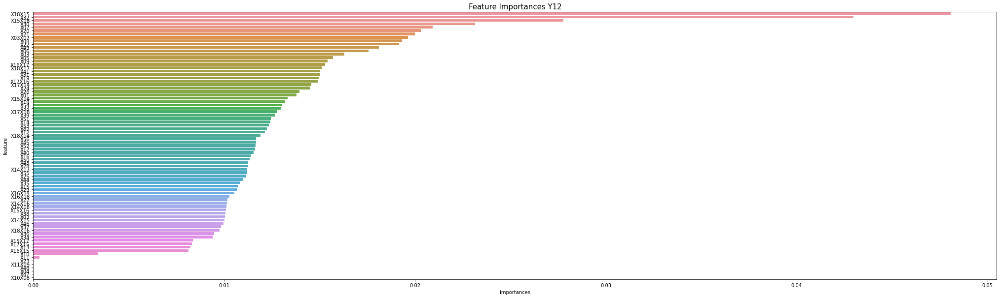

['X23', 'X11X09', 'X48', 'X04', 'X47', 'X10X08']
[11:57:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[11:58:01] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




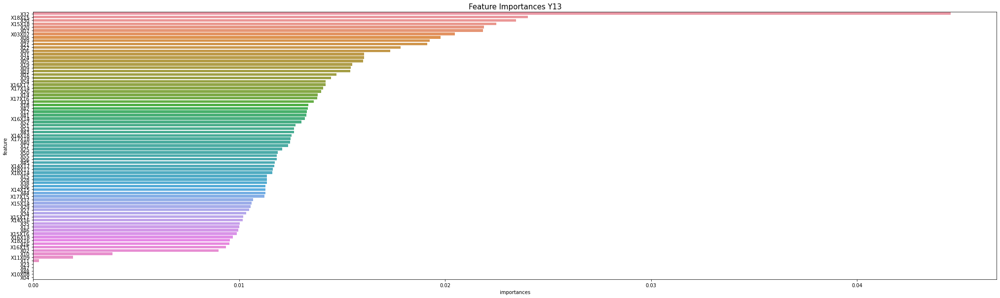

['X23', 'X47', 'X48', 'X10X08', 'X04']
[11:58:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[11:58:12] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




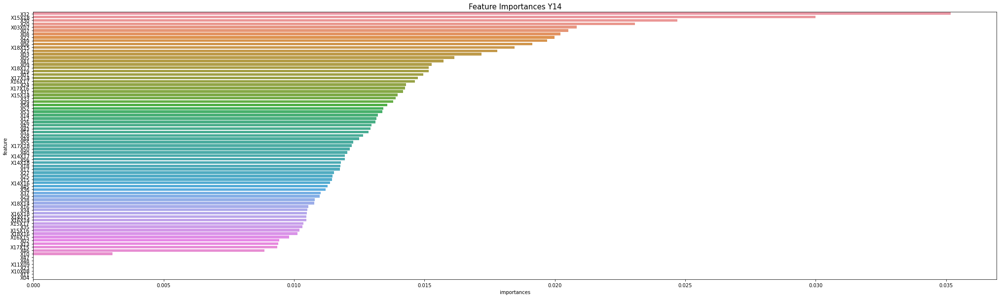

['X47', 'X48', 'X11X09', 'X23', 'X10X08', 'X11', 'X04']
[11:58:17] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 6 / lg_nrmse : 1.977214210757896
fit Y01
[11:58:22] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




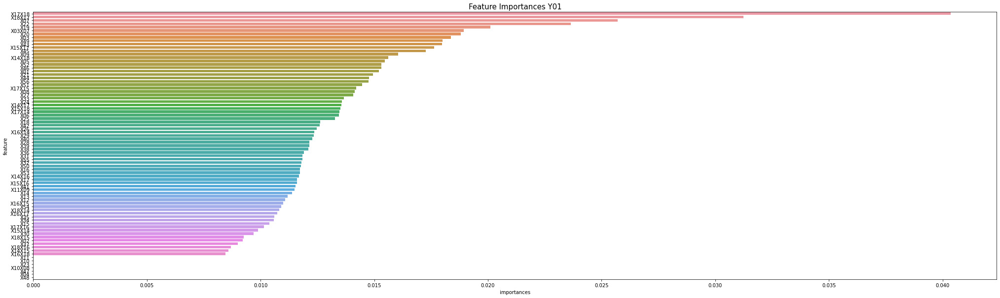

['X11', 'X10', 'X23', 'X10X08', 'X47', 'X04', 'X48']
[11:58:25] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[11:58:28] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




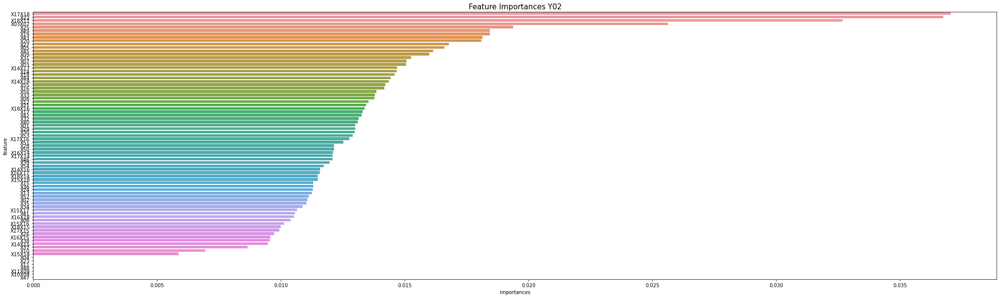

['X04', 'X23', 'X11', 'X48', 'X11X09', 'X10X08', 'X47']
[11:58:31] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[11:58:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




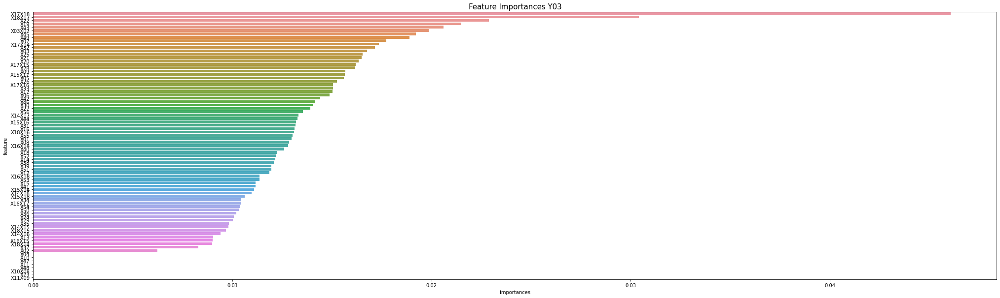

['X04', 'X10', 'X47', 'X11', 'X48', 'X10X08', 'X23', 'X11X09']
[11:58:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[11:58:37] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




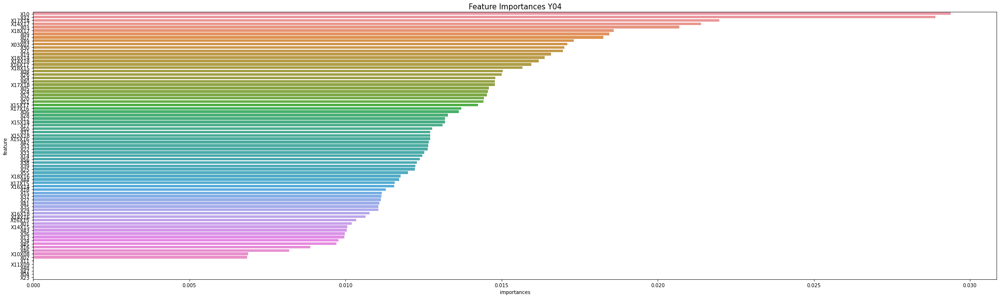

['X11X09', 'X48', 'X47', 'X04', 'X23']
[11:58:44] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[11:58:50] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




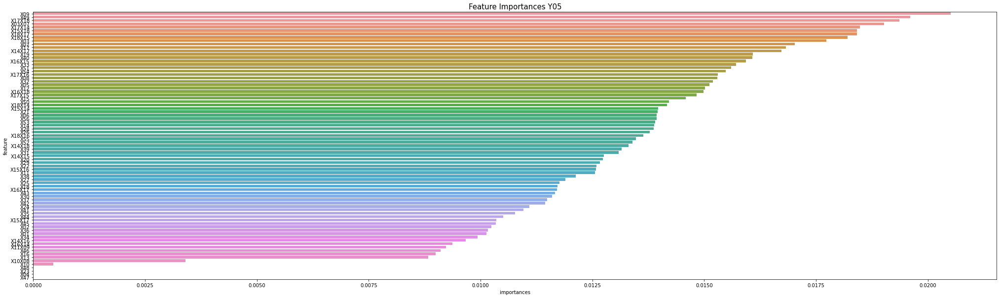

['X48', 'X23', 'X04', 'X47']
[11:58:57] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[11:59:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




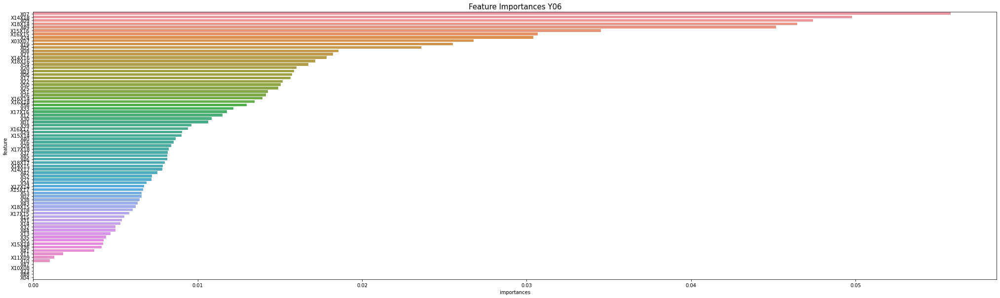

['X47', 'X10X08', 'X23', 'X48', 'X04']
[11:59:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[11:59:12] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




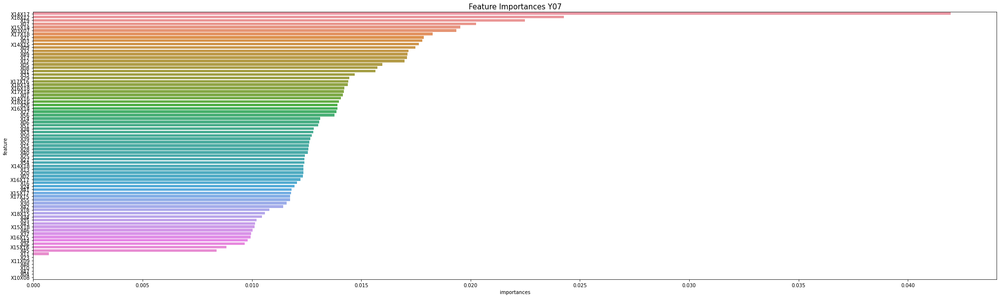

['X23', 'X11X09', 'X48', 'X10', 'X47', 'X04', 'X10X08']
[11:59:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[11:59:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




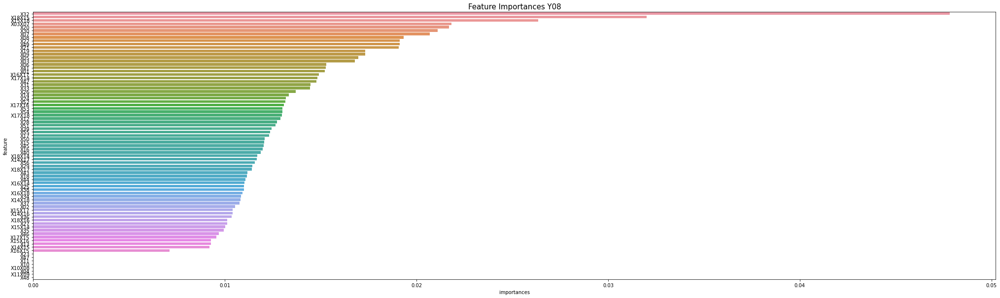

['X23', 'X47', 'X11', 'X10', 'X10X08', 'X04', 'X11X09', 'X48']
[11:59:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[11:59:29] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




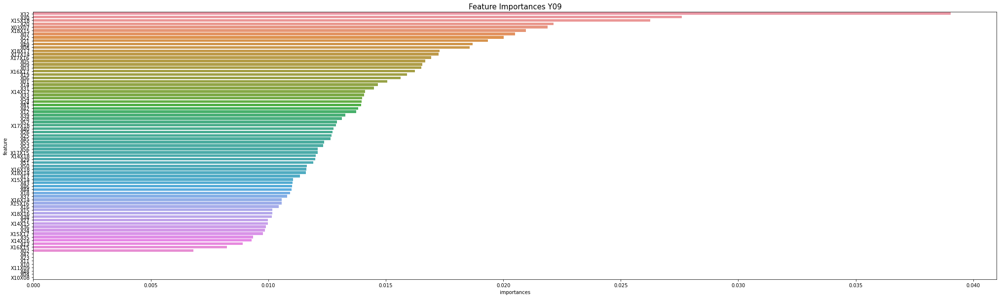

['X47', 'X23', 'X11', 'X10', 'X11X09', 'X48', 'X04', 'X10X08']
[11:59:34] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[11:59:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




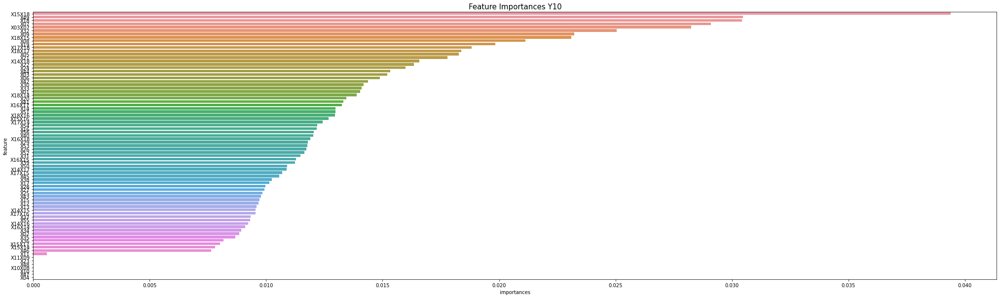

['X11X09', 'X23', 'X48', 'X10X08', 'X10', 'X47', 'X04']
[11:59:43] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[11:59:48] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




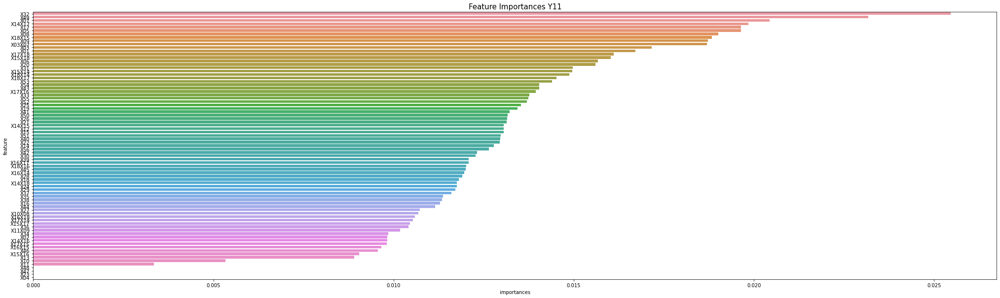

['X48', 'X47', 'X23', 'X04']
[11:59:53] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[11:59:59] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




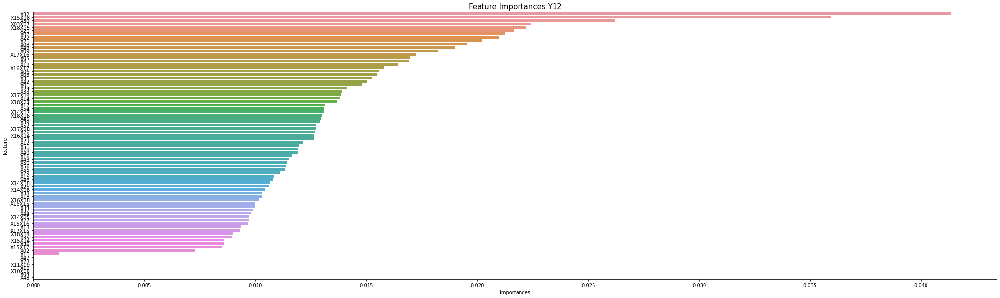

['X47', 'X23', 'X11X09', 'X10', 'X10X08', 'X04', 'X48']
[12:00:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[12:00:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




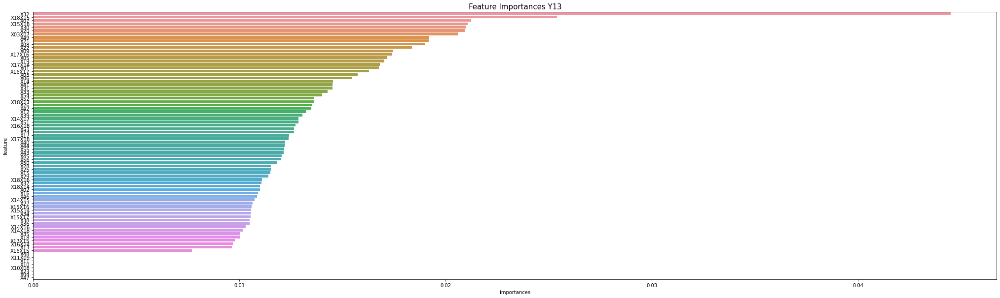

['X48', 'X11X09', 'X11', 'X10', 'X10X08', 'X23', 'X04', 'X47']
[12:00:13] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[12:00:17] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




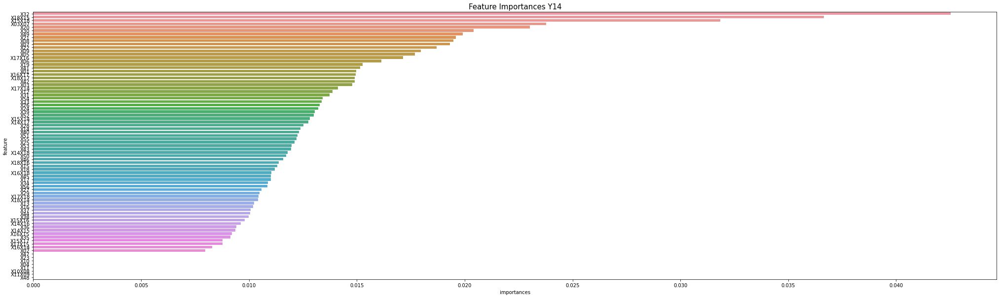

['X47', 'X23', 'X10', 'X04', 'X11', 'X10X08', 'X11X09', 'X48']
[12:00:21] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 7 / lg_nrmse : 1.9109330463232954
fit Y01
[12:00:26] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




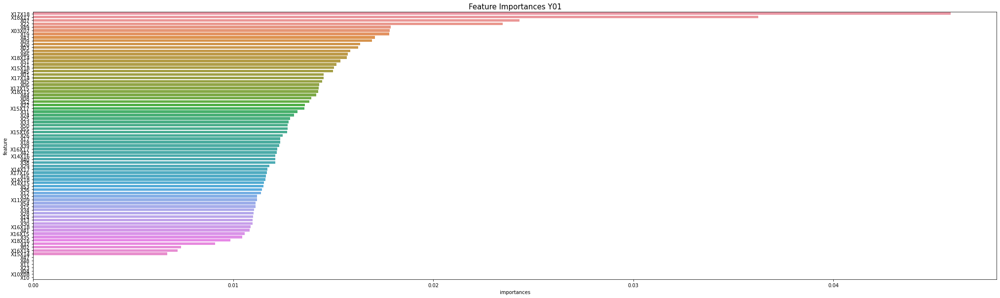

['X47', 'X48', 'X11', 'X23', 'X04', 'X10X08', 'X10']
[12:00:30] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[12:00:32] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




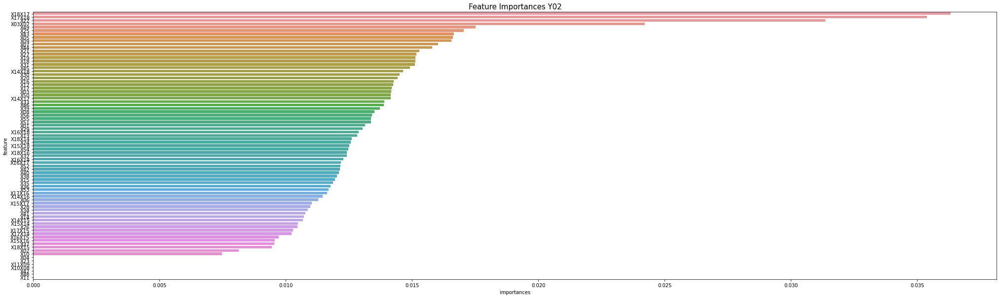

['X04', 'X23', 'X11X09', 'X10X08', 'X47', 'X48', 'X11']
[12:00:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[12:00:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




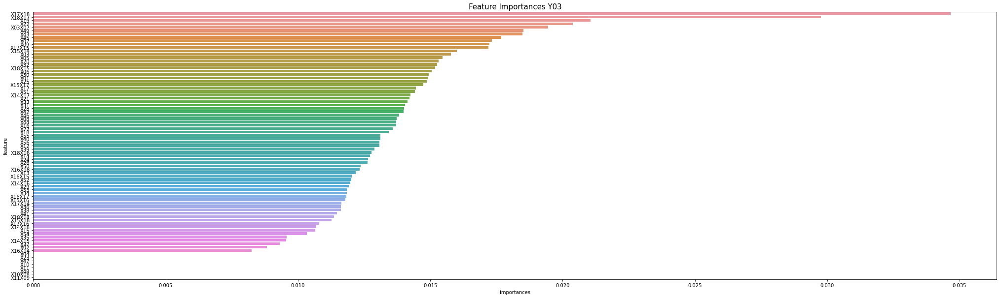

['X04', 'X23', 'X47', 'X10', 'X11', 'X48', 'X10X08', 'X11X09']
[12:00:42] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[12:00:44] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




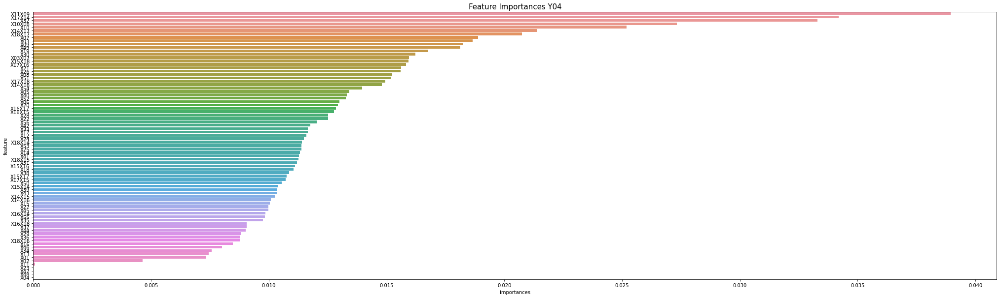

['X23', 'X47', 'X48', 'X04']
[12:00:49] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[12:00:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




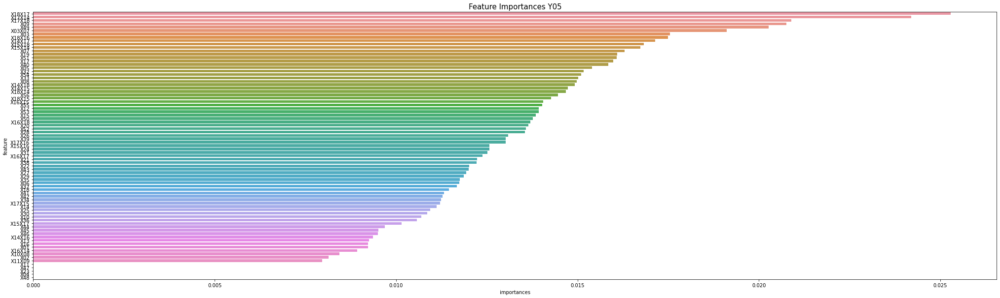

['X11', 'X47', 'X23', 'X04', 'X48']
[12:01:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[12:01:07] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




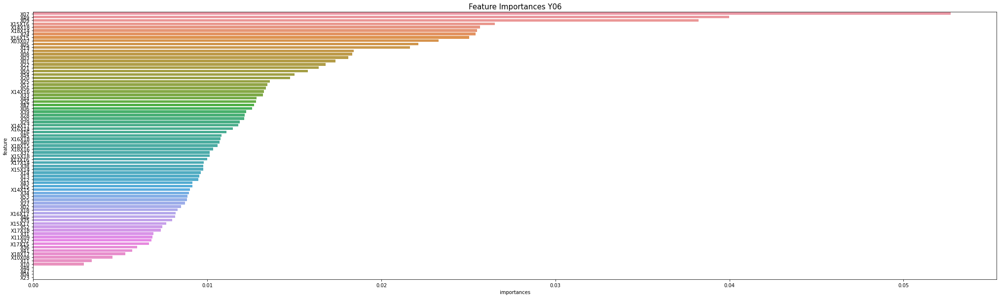

['X48', 'X47', 'X04', 'X23']
[12:01:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[12:01:20] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




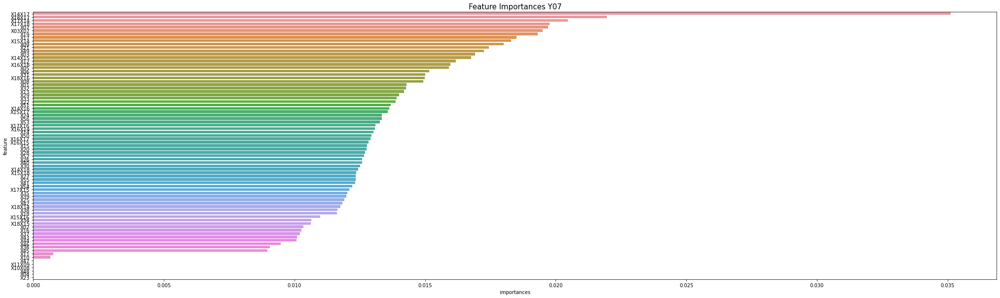

['X47', 'X11X09', 'X10X08', 'X48', 'X04', 'X23']
[12:01:25] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[12:01:28] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




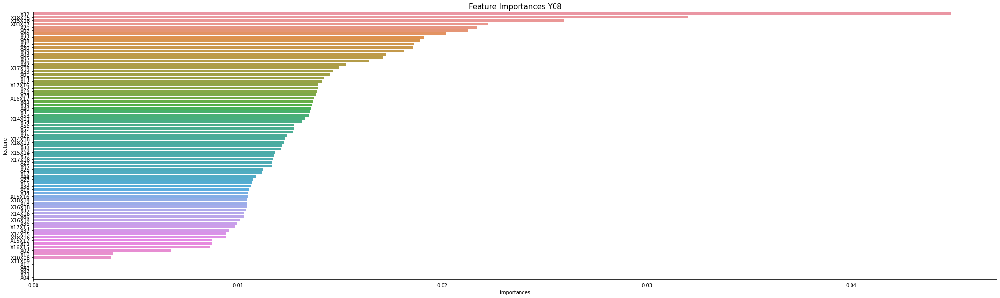

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
[12:01:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[12:01:36] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




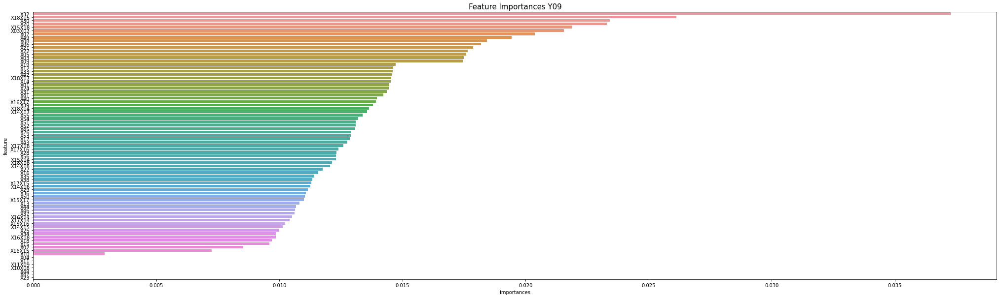

['X04', 'X11', 'X11X09', 'X10X08', 'X48', 'X47', 'X23']
[12:01:42] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[12:01:46] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




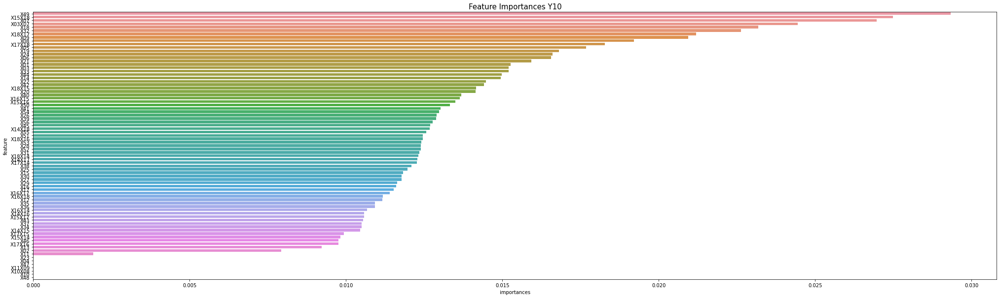

['X23', 'X04', 'X47', 'X11X09', 'X10X08', 'X10', 'X48']
[12:01:58] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[12:02:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




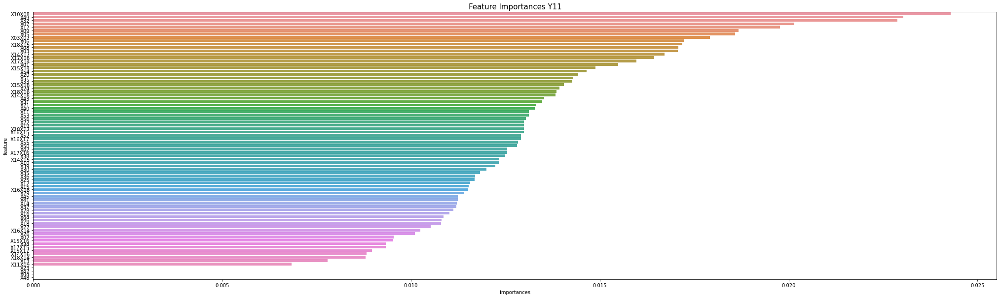

['X23', 'X47', 'X04', 'X48']
[12:02:14] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[12:02:20] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




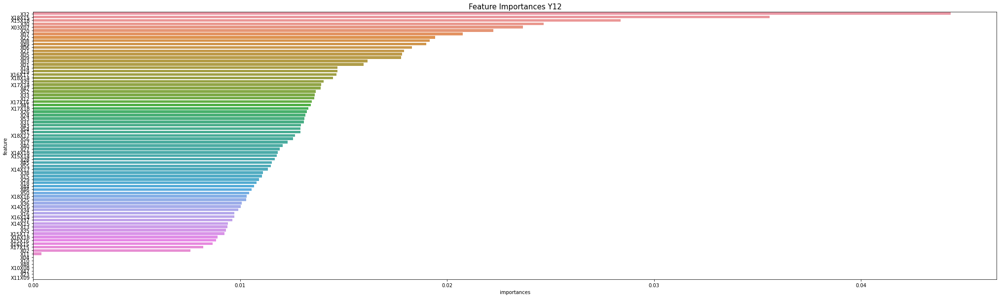

['X04', 'X10', 'X48', 'X10X08', 'X47', 'X23', 'X11X09']
[12:02:25] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[12:02:30] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




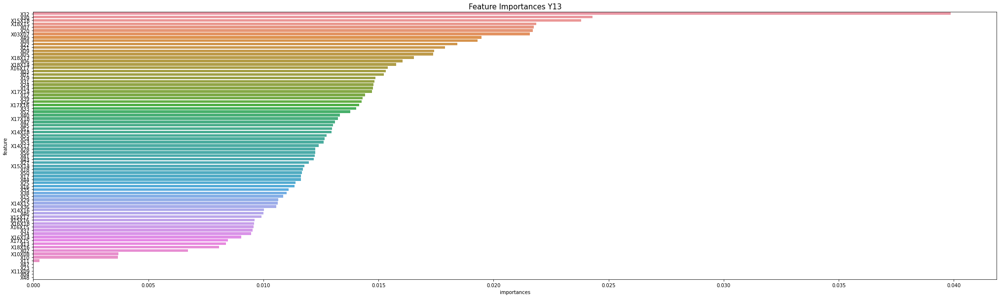

['X47', 'X23', 'X11X09', 'X04', 'X48']
[12:02:35] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[12:02:39] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




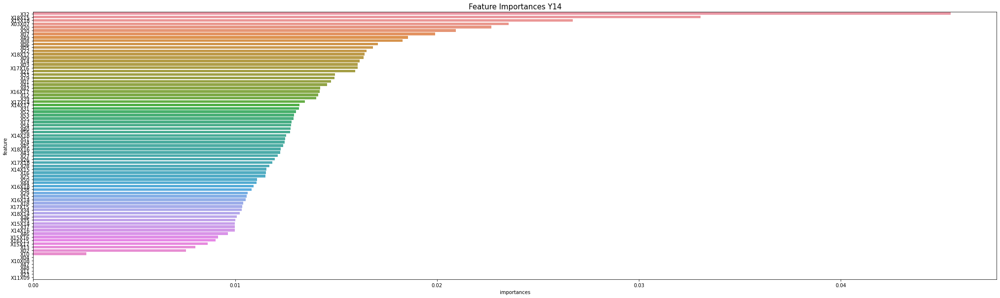

['X04', 'X10X08', 'X47', 'X48', 'X11', 'X23', 'X11X09']
[12:02:44] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 8 / lg_nrmse : 1.976095565505173
fit Y01
[12:02:48] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




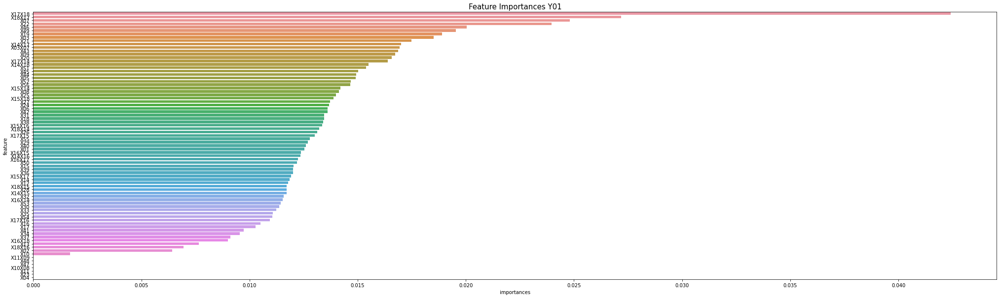

['X11X09', 'X48', 'X47', 'X10X08', 'X11', 'X23', 'X04']
[12:02:52] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y01
fit Y02
[12:02:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




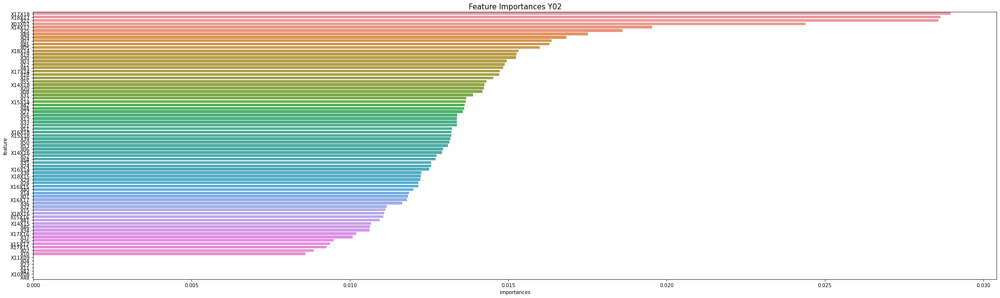

['X11X09', 'X04', 'X23', 'X11', 'X47', 'X10X08', 'X48']
[12:03:01] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y02
fit Y03
[12:03:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




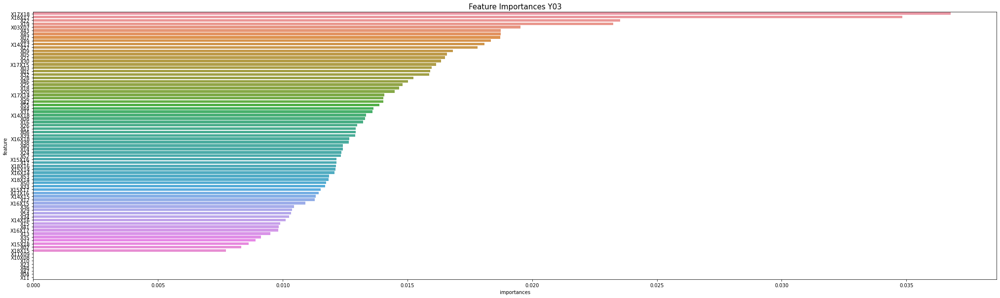

['X11X09', 'X10X08', 'X10', 'X23', 'X48', 'X47', 'X04', 'X11']
[12:03:06] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y03
fit Y04
[12:03:09] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




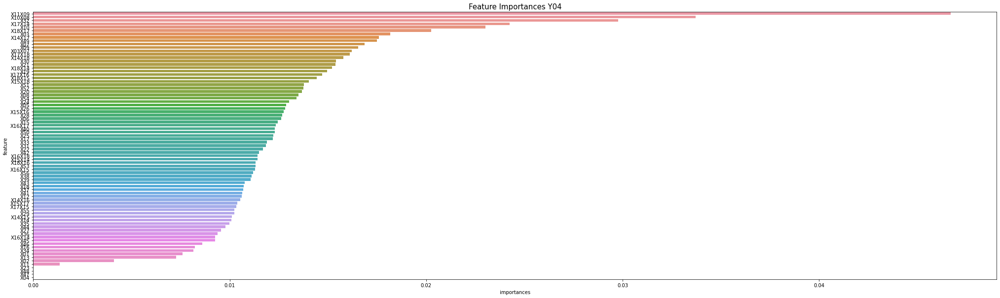

['X23', 'X48', 'X47', 'X04']
[12:03:16] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y04
fit Y05
[12:03:24] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




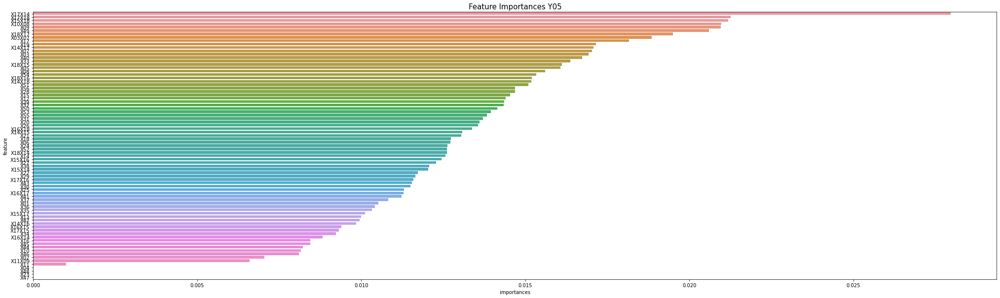

['X04', 'X48', 'X23', 'X47']
[12:03:29] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y05
fit Y06
[12:03:34] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




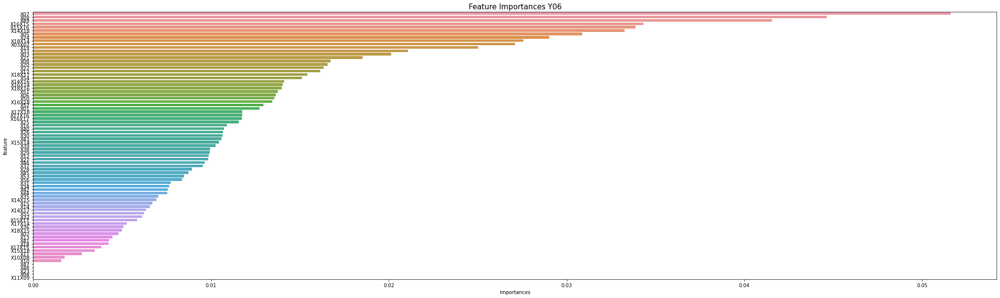

['X47', 'X48', 'X23', 'X04', 'X11X09']
[12:03:38] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y06
fit Y07
[12:03:42] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




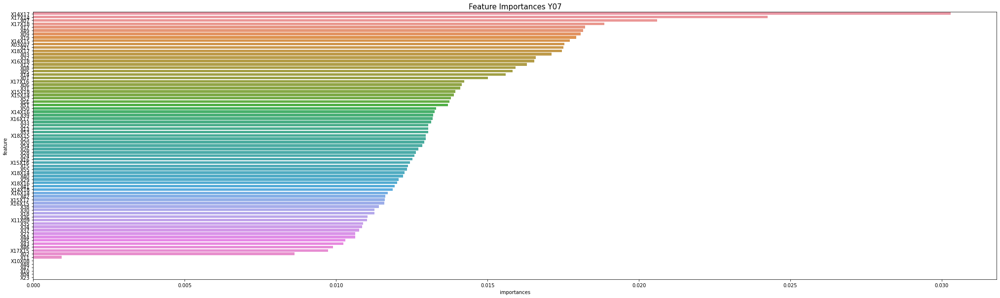

['X10X08', 'X48', 'X47', 'X10', 'X04', 'X23']
[12:03:47] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y07
fit Y08
[12:03:52] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




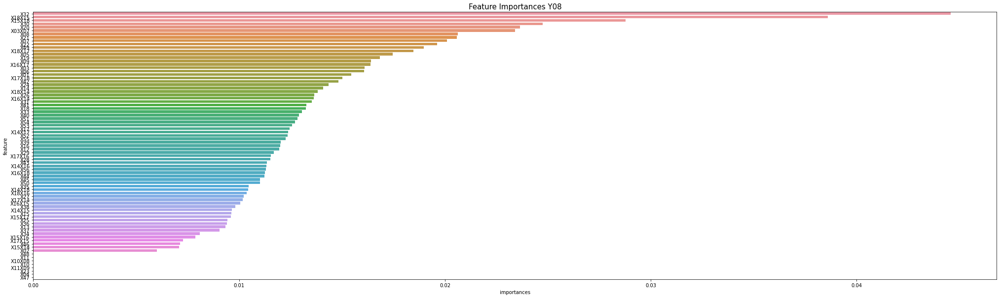

['X48', 'X11', 'X10X08', 'X10', 'X11X09', 'X23', 'X04', 'X47']
[12:03:56] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y08
fit Y09
[12:03:59] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




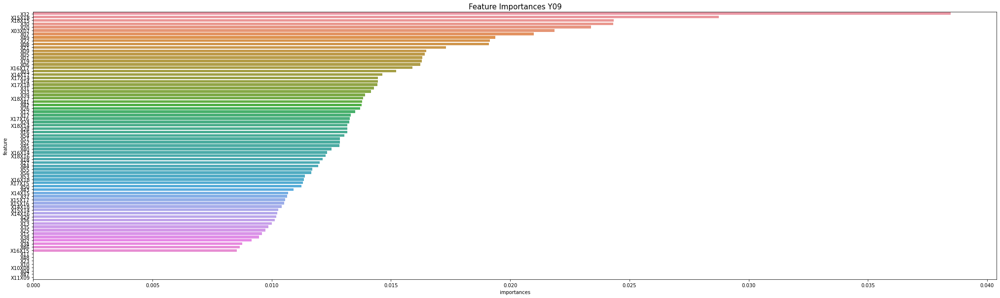

['X11', 'X48', 'X23', 'X10', 'X10X08', 'X04', 'X47', 'X11X09']
[12:04:03] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y09
fit Y10
[12:04:08] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




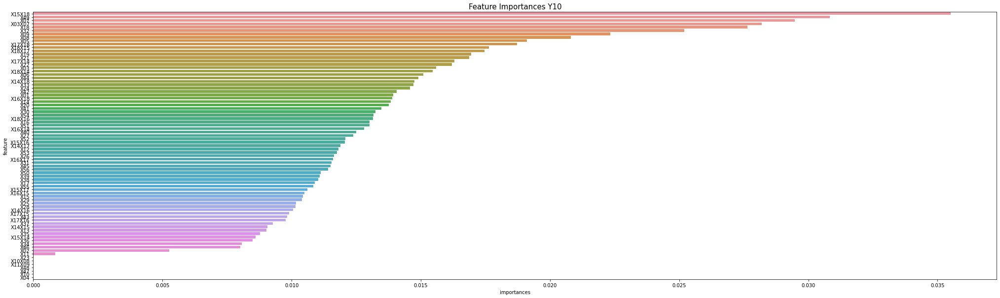

['X23', 'X10X08', 'X11X09', 'X48', 'X47', 'X10', 'X04']
[12:04:14] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y10
fit Y11
[12:04:19] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




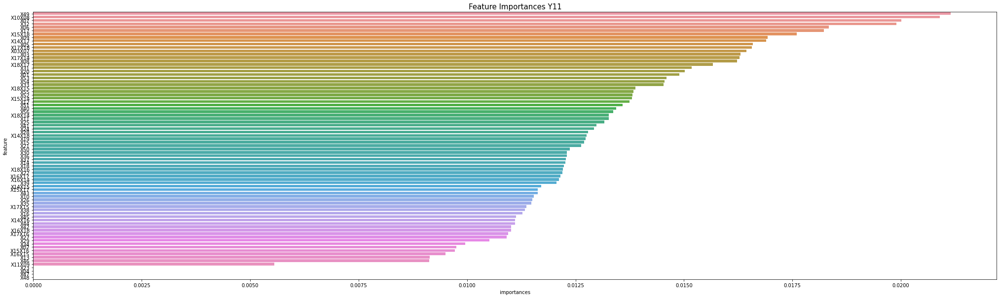

['X23', 'X04', 'X47', 'X48']
[12:04:26] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y11
fit Y12
[12:04:33] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




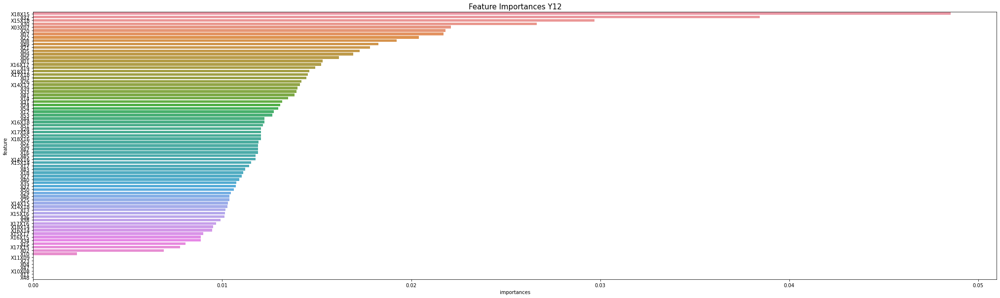

['X11X09', 'X23', 'X04', 'X47', 'X10X08', 'X11', 'X48']
[12:04:37] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y12
fit Y13
[12:04:40] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




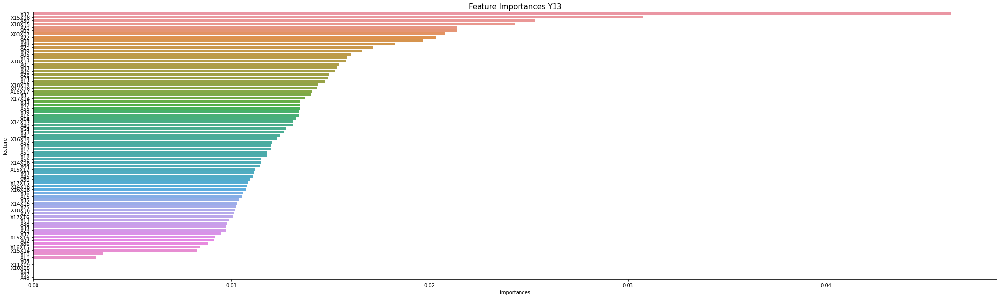

['X04', 'X11X09', 'X10X08', 'X23', 'X47', 'X48']
[12:04:45] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y13
fit Y14
[12:04:48] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




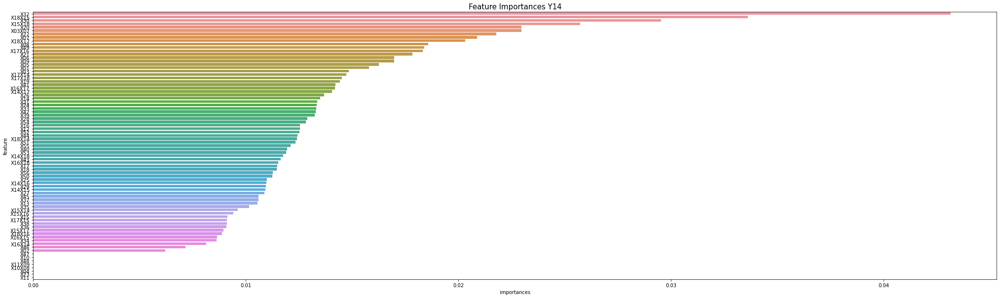

['X47', 'X10', 'X48', 'X11X09', 'X10X08', 'X04', 'X23', 'X11']
[12:04:52] WARNING: ../src/learner.cc:627: 
Parameters: { "tweedie_variance_power" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


predict Y14
Fold 9 / lg_nrmse : 1.9213782145099179


In [26]:
n_splits = 10
xgb_predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

def feval_rmspe(y_pred, lgb_train):
    y_true = lgb_train.get_label()
    return 'RMSPE', rmspe(y_true, y_pred), False

for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
    preds = []
    y_vals = []
    predictions_ = []
    for j in range(1, 15):
        if j < 10:
            train_y_ = train_y[f'Y0{j}']
        else:
            train_y_ = train_y[f'Y{j}']

        X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
        X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

        #Forward_best_model = forward_model(X = X_train, y = y_train)

        #Backward_best_model = backward_model(X = X_train, y = y_train)

        print(f'fit {train_y.columns[j-1]}')
        model = XGBRegressor(**xgb_params)
        model.fit(X_train, y_train, eval_set = [(X_val, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0
            
        #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
        # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함

        # feature importance
        importance = model.feature_importances_
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()
            
        featurelist = importances['feature'][importances['importances'] == 0].tolist()
        print(featurelist)
        
        train_drop = train.drop(featurelist, axis=1)
        test_drop = test.drop(featurelist, axis=1)
        
        train_x_drop = train_drop.filter(regex = 'X')
        test_x_drop = test_drop.filter(regex = 'X')
        
        X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
        X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]

        model_drop = XGBRegressor(**xgb_params)
        model_drop.fit(X_train_drop, y_train, eval_set = [(X_val_drop, y_val)], verbose = 0, early_stopping_rounds = 100) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0'''
            
        print(f'predict {train_y.columns[j-1]}')
        pred = model_drop.predict(X_val_drop)
        prediction = model_drop.predict(test_x_drop)
        predictions_.append(prediction)
        preds.append(pred)
        y_vals.append(y_val)
        
    xgb_predictions.append(predictions_)
    lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
    lgnrmses.append(lgnrmse)
    print(f'Fold {i} / lg_nrmse : {lgnrmse}')

In [27]:
np.mean(lgnrmse)

1.9213782145099179

In [28]:
xgb_final_prediction = np.mean(np.array(xgb_predictions), axis=0).T

In [29]:
xgb_final_prediction

array([[  1.4253492,   1.2058551,   1.0885316, ..., -25.966015 ,
        -25.941177 , -26.00418  ],
       [  1.4855995,   1.2064165,   1.1208351, ..., -26.086481 ,
        -26.083612 , -26.093622 ],
       [  1.4575186,   1.1395077,   1.1012118, ..., -25.621395 ,
        -25.60255  , -25.65177  ],
       ...,
       [  1.2139819,   0.9243363,   0.9603092, ..., -26.507559 ,
        -26.48403  , -26.514578 ],
       [  1.205485 ,   0.8746403,   0.9300963, ..., -26.437805 ,
        -26.434362 , -26.445124 ],
       [  1.3088251,   0.9617653,   0.9952362, ..., -26.605    ,
        -26.573227 , -26.58874  ]], dtype=float32)

In [30]:
for idx, col in enumerate(sample_submission.columns):
    if col=='ID':
        continue
    sample_submission[col] = xgb_final_prediction[:,idx-1]
print('Done.')

Done.


In [31]:
sample_submission.to_csv('xgb_submission.csv', index = False)

## LGBMRegressor2

fit Y01


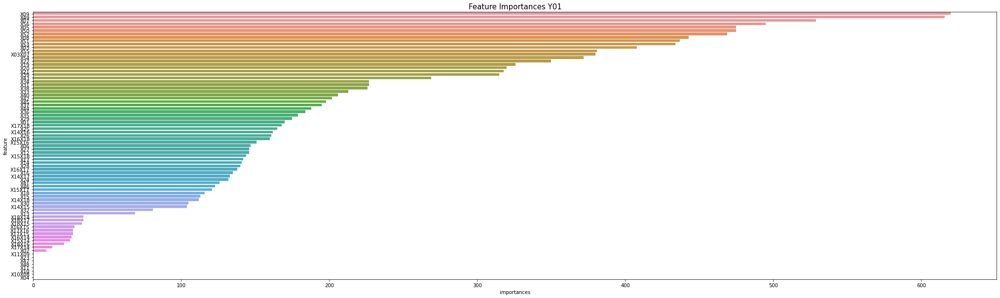

['X11X09', 'X23', 'X47', 'X48', 'X11', 'X10', 'X10X08', 'X04']
predict Y01
fit Y02


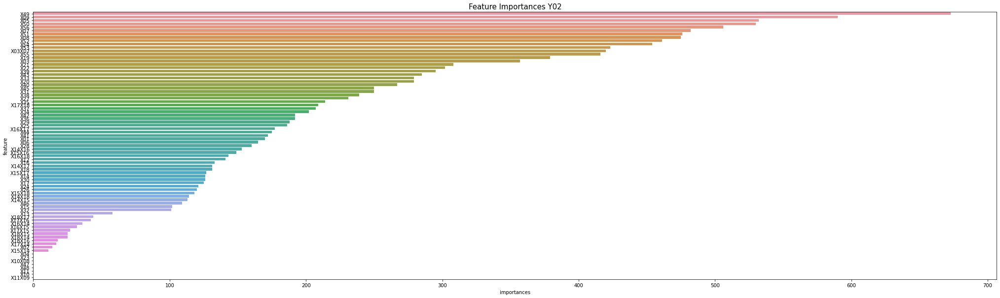

['X04', 'X23', 'X10X08', 'X47', 'X48', 'X11', 'X10', 'X11X09']
predict Y02
fit Y03


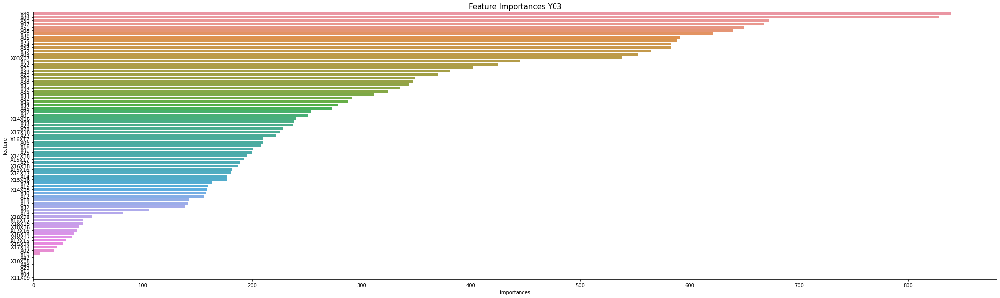

['X47', 'X10X08', 'X48', 'X23', 'X11', 'X04', 'X11X09']
predict Y03
fit Y04


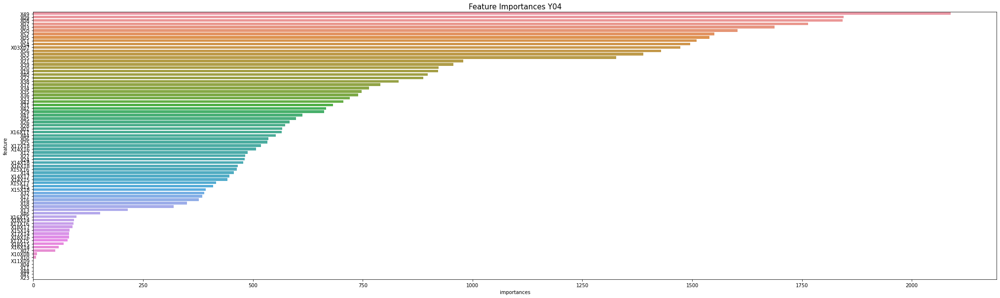

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y04
fit Y05


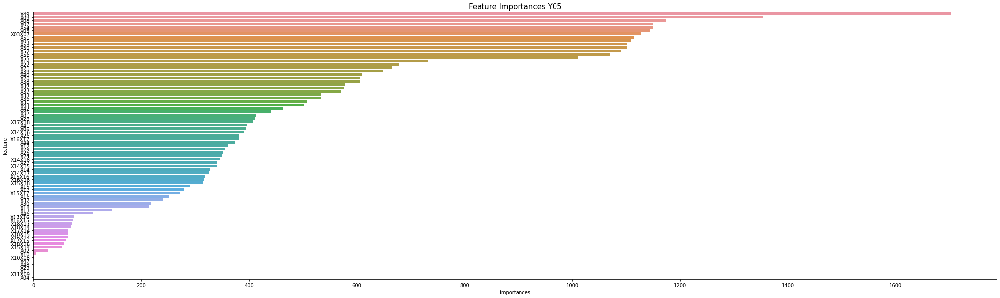

['X47', 'X48', 'X23', 'X11', 'X11X09', 'X04']
predict Y05
fit Y06


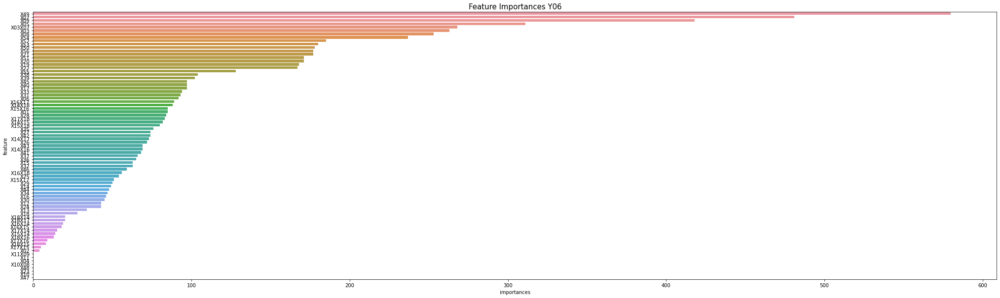

['X11X09', 'X11', 'X04', 'X10X08', 'X48', 'X23', 'X10', 'X47']
predict Y06
fit Y07


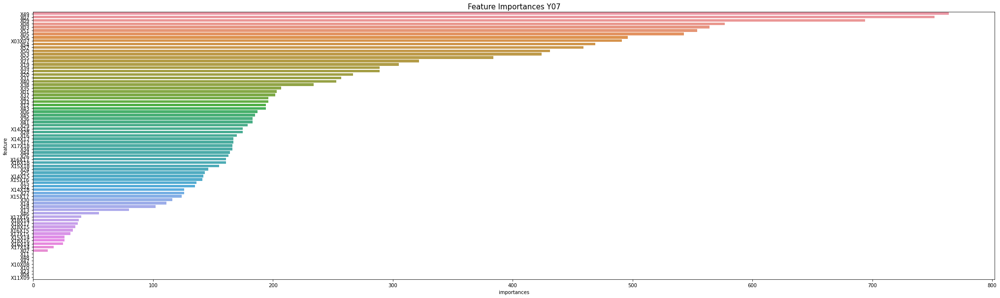

['X11', 'X48', 'X47', 'X10X08', 'X10', 'X23', 'X04', 'X11X09']
predict Y07
fit Y08


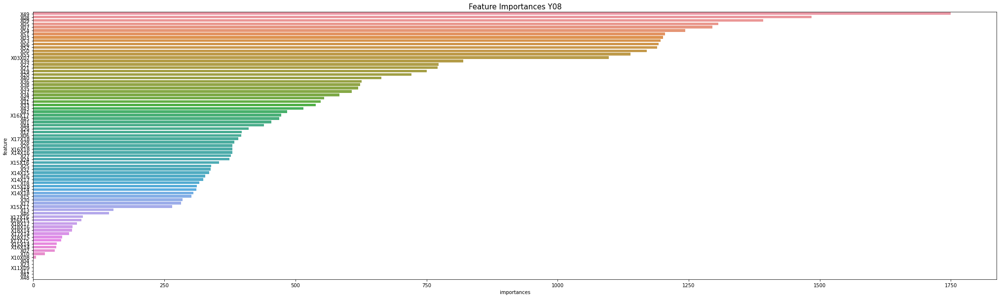

['X04', 'X23', 'X11X09', 'X11', 'X47', 'X48']
predict Y08
fit Y09


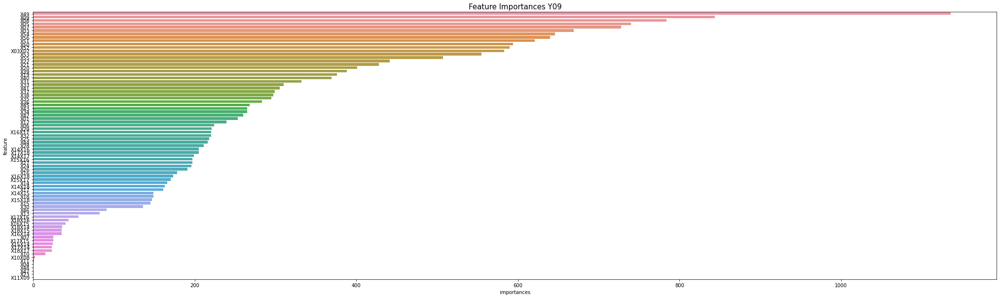

['X04', 'X48', 'X47', 'X23', 'X11X09']
predict Y09
fit Y10


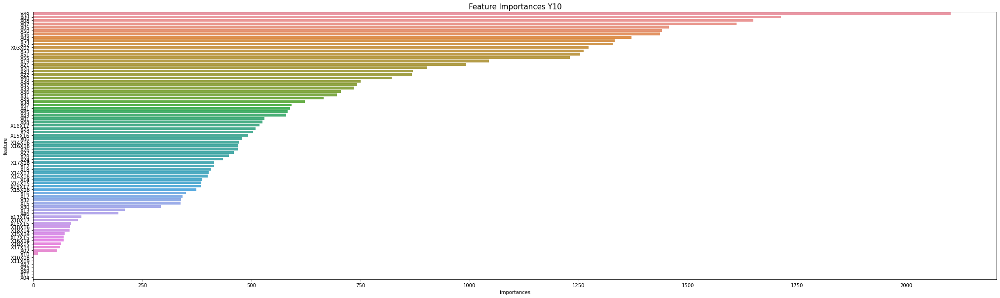

['X47', 'X23', 'X48', 'X11', 'X04']
predict Y10
fit Y11


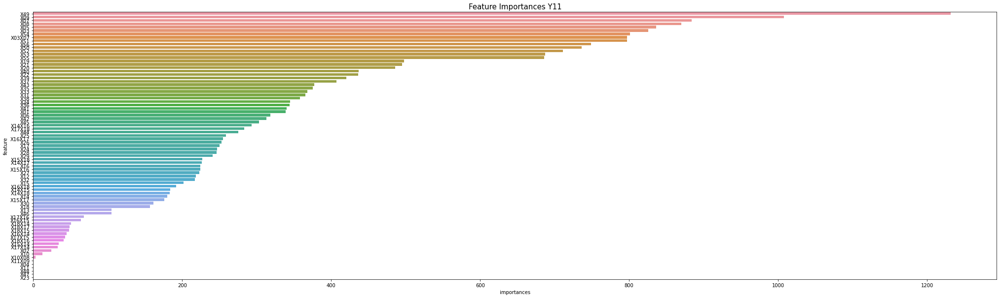

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y11
fit Y12


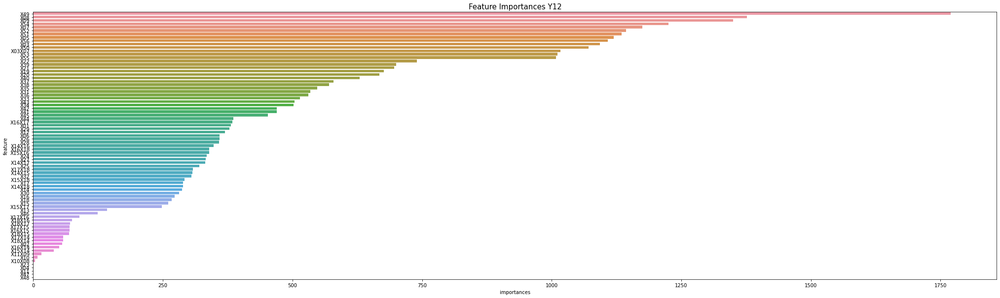

['X23', 'X04', 'X11', 'X47', 'X48']
predict Y12
fit Y13


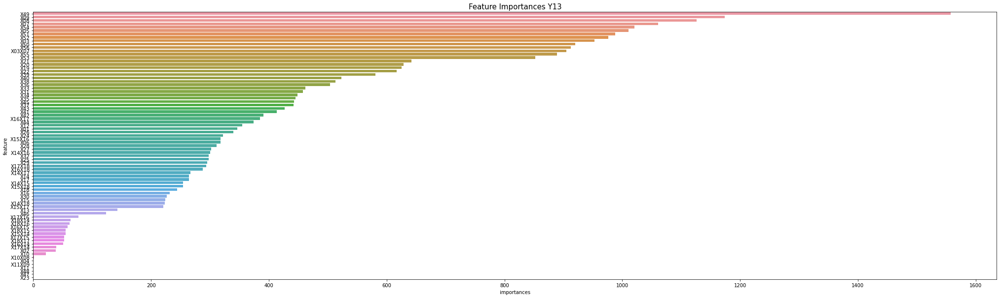

['X04', 'X11X09', 'X11', 'X48', 'X47', 'X23']
predict Y13
fit Y14


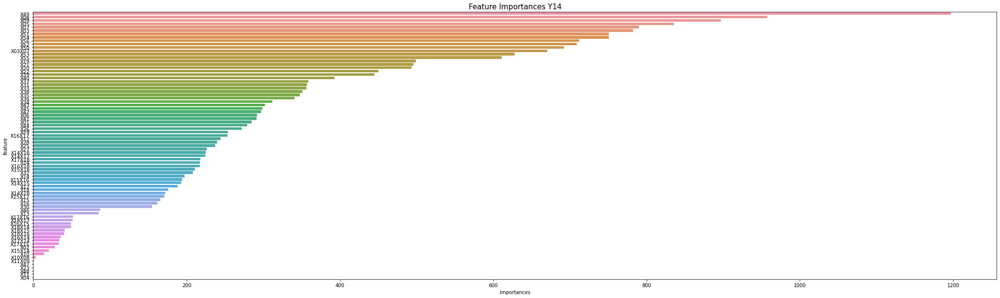

['X11X09', 'X47', 'X23', 'X48', 'X11', 'X04']
predict Y14
Fold 0 / lg_nrmse : 1.9253814244384333
fit Y01


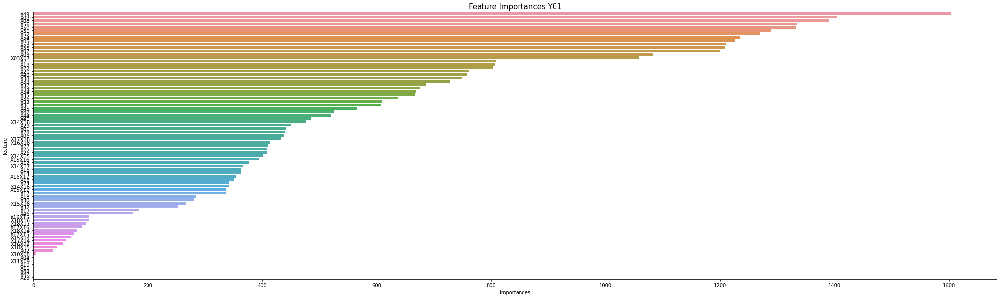

['X04', 'X11X09', 'X10', 'X11', 'X48', 'X47', 'X23']
predict Y01
fit Y02


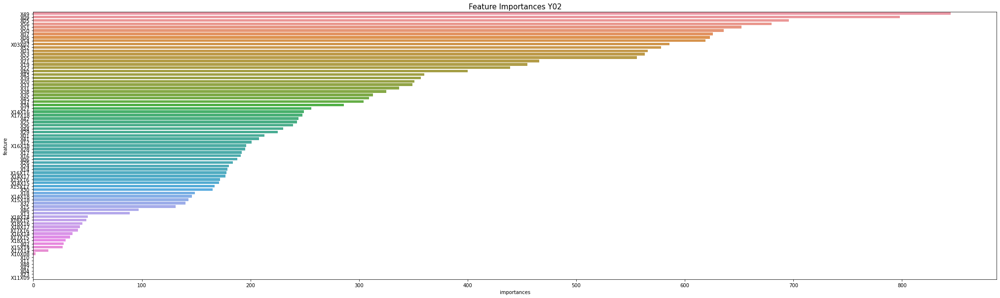

['X10', 'X11', 'X48', 'X47', 'X04', 'X23', 'X11X09']
predict Y02
fit Y03


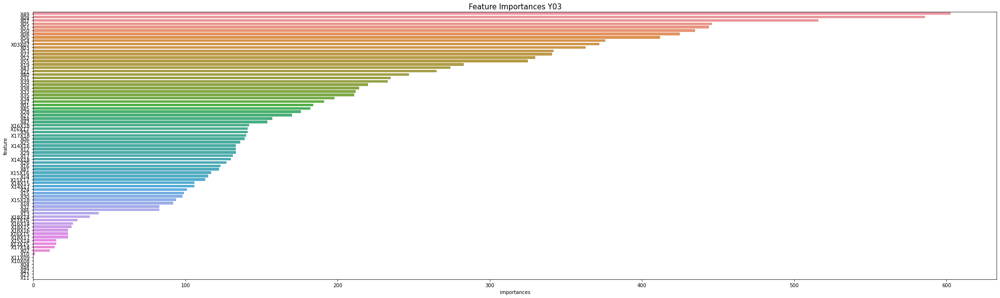

['X11X09', 'X10X08', 'X04', 'X48', 'X47', 'X23', 'X11']
predict Y03
fit Y04


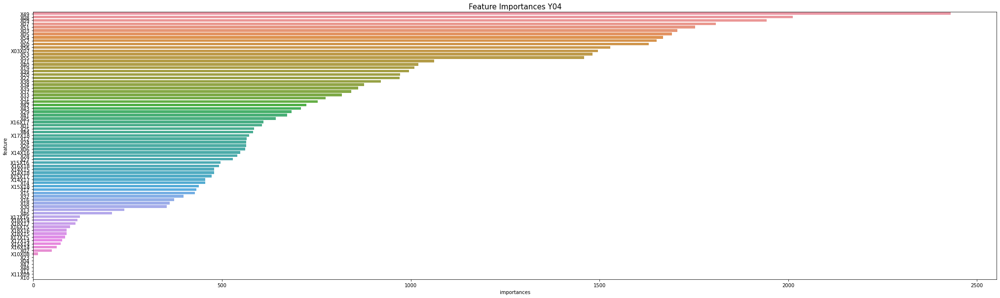

['X23', 'X04', 'X47', 'X48', 'X11', 'X11X09', 'X10']
predict Y04
fit Y05


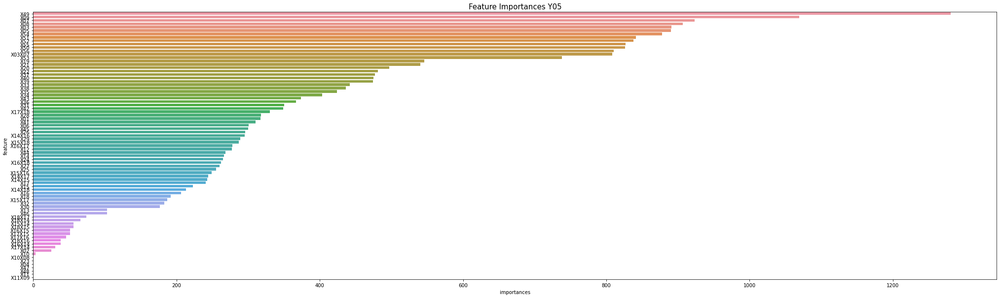

['X10X08', 'X23', 'X04', 'X47', 'X48', 'X11', 'X11X09']
predict Y05
fit Y06


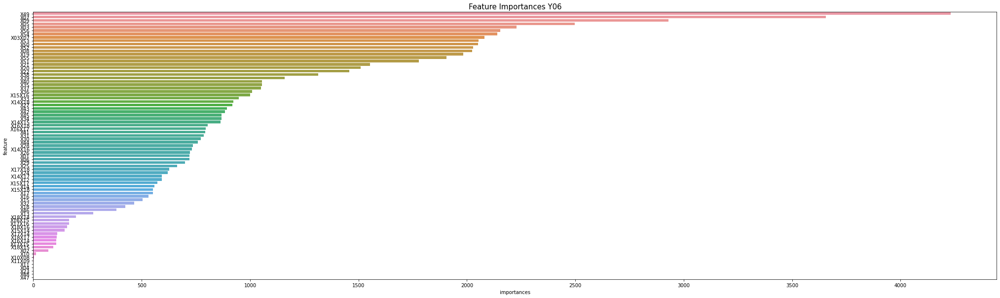

['X11', 'X04', 'X23', 'X48', 'X47']
predict Y06
fit Y07


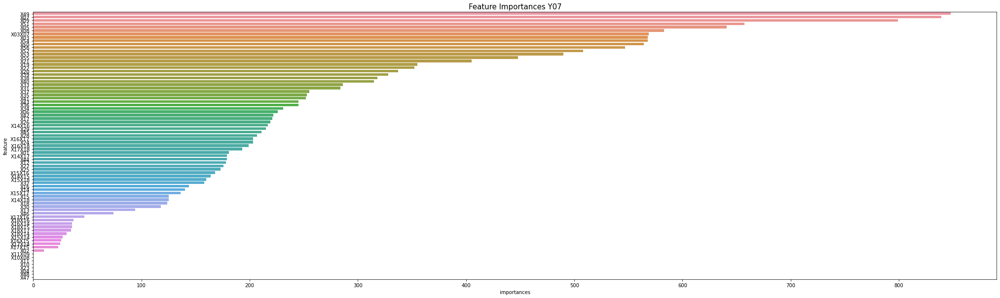

['X11X09', 'X10X08', 'X11', 'X10', 'X23', 'X04', 'X48', 'X47']
predict Y07
fit Y08


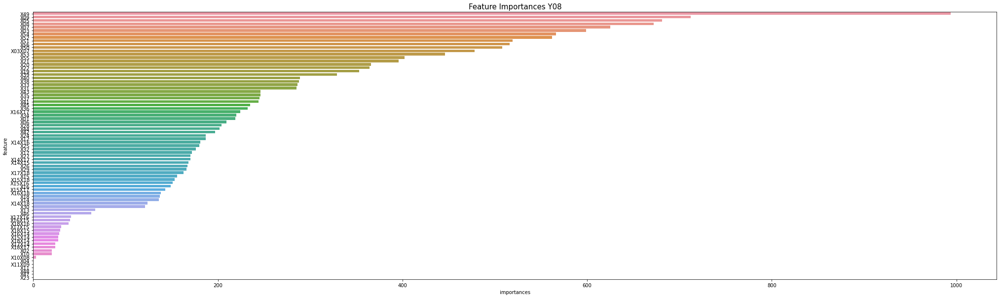

['X04', 'X11X09', 'X11', 'X48', 'X47', 'X23']
predict Y08
fit Y09


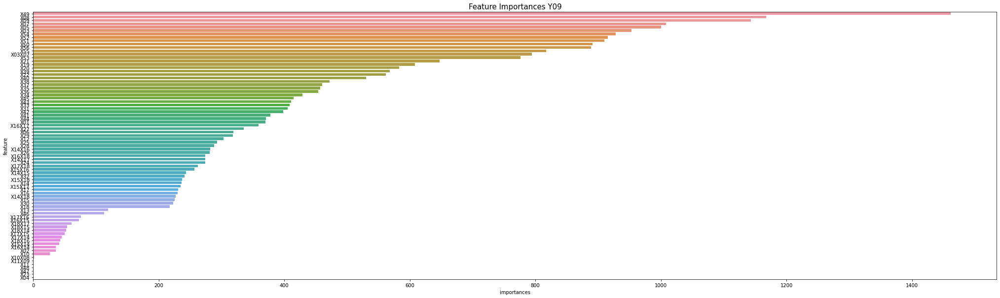

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y09
fit Y10


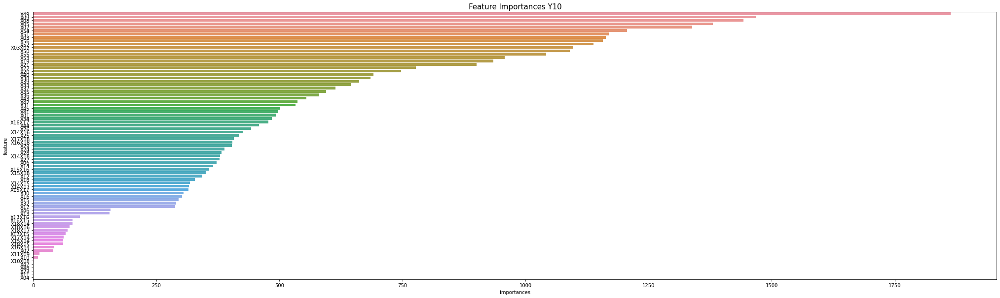

['X47', 'X48', 'X23', 'X11', 'X04']
predict Y10
fit Y11


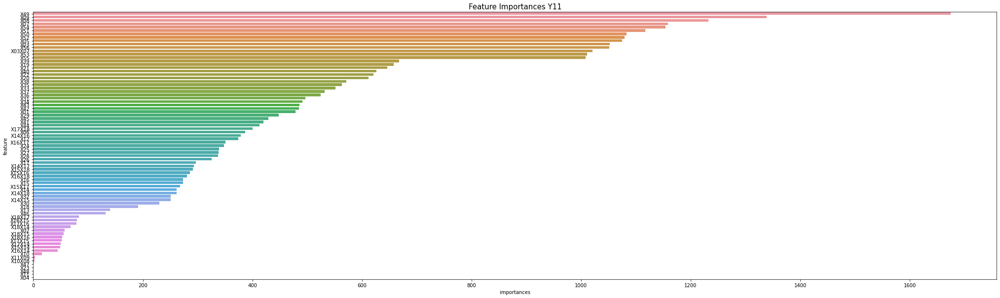

['X47', 'X23', 'X48', 'X11', 'X04']
predict Y11
fit Y12


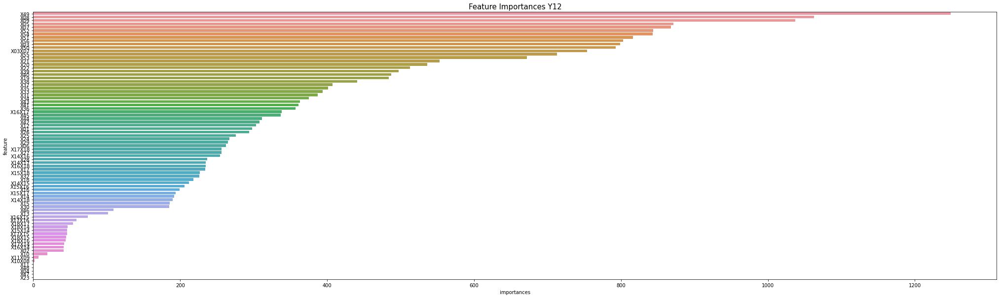

['X11', 'X48', 'X04', 'X47', 'X23']
predict Y12
fit Y13


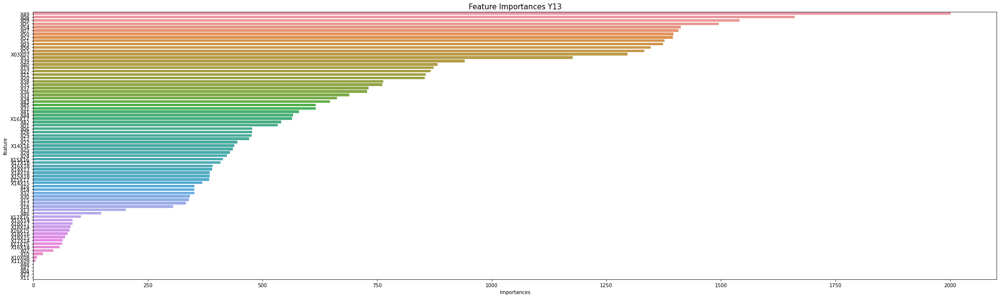

['X48', 'X47', 'X04', 'X23', 'X11']
predict Y13
fit Y14


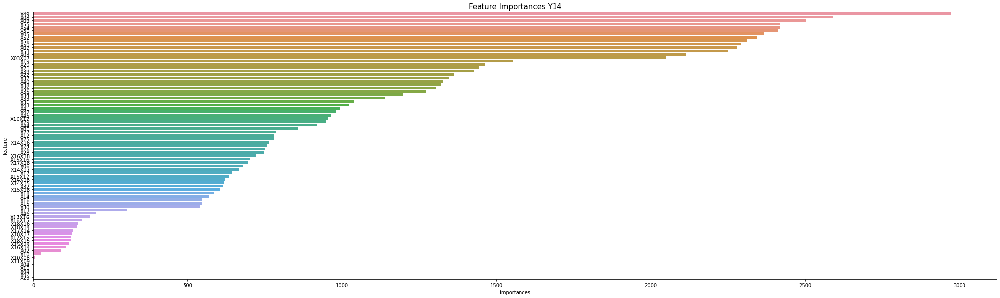

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y14
Fold 1 / lg_nrmse : 1.9323692905663665
fit Y01


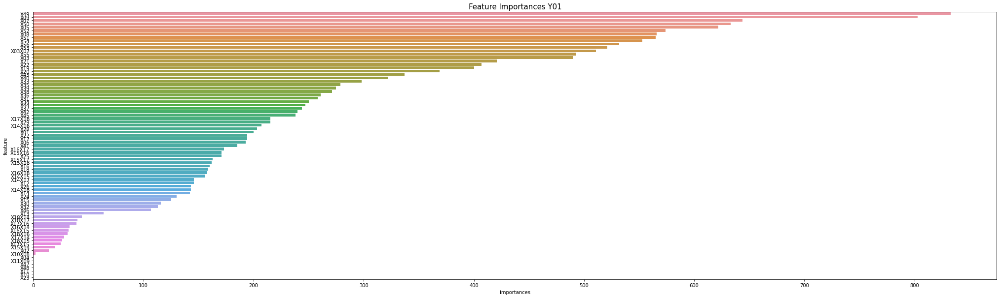

['X04', 'X11X09', 'X47', 'X48', 'X11', 'X10', 'X23']
predict Y01
fit Y02


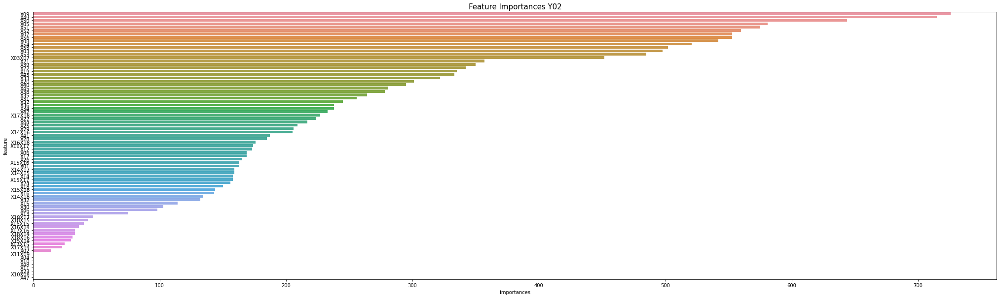

['X11X09', 'X04', 'X10', 'X48', 'X11', 'X23', 'X10X08', 'X47']
predict Y02
fit Y03


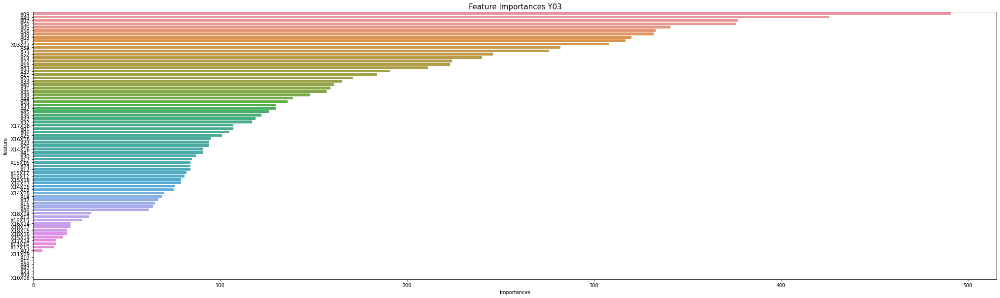

['X11X09', 'X10', 'X11', 'X48', 'X47', 'X23', 'X04', 'X10X08']
predict Y03
fit Y04


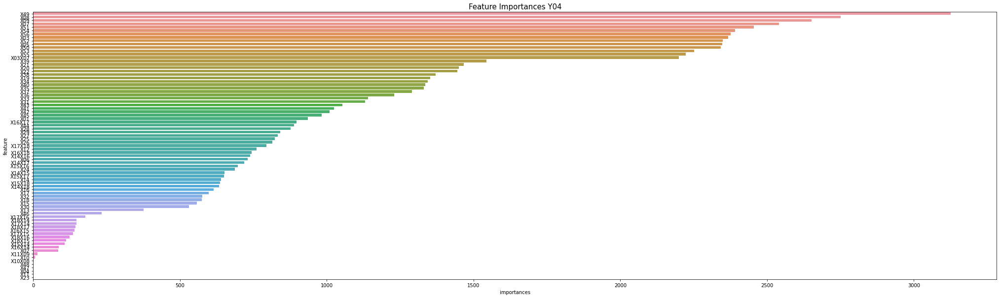

['X48', 'X47', 'X04', 'X11', 'X23']
predict Y04
fit Y05


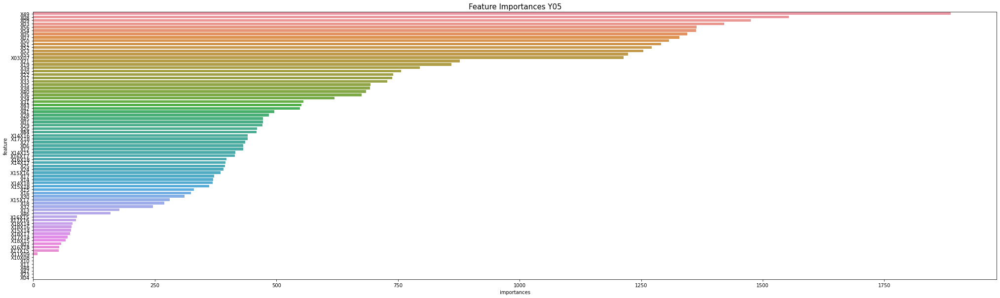

['X10X08', 'X10', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y05
fit Y06


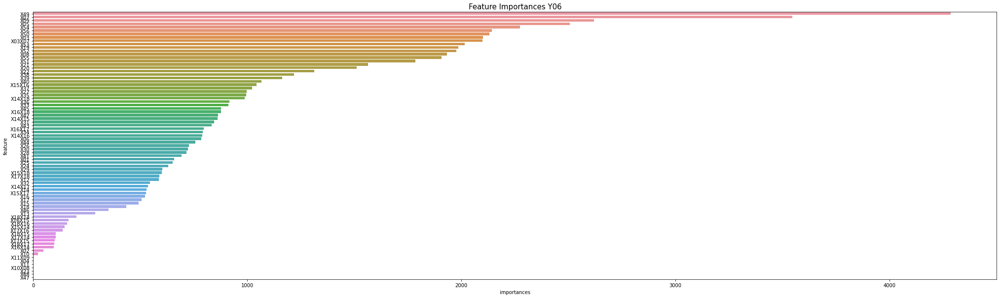

['X04', 'X11', 'X10X08', 'X23', 'X48', 'X47']
predict Y06
fit Y07


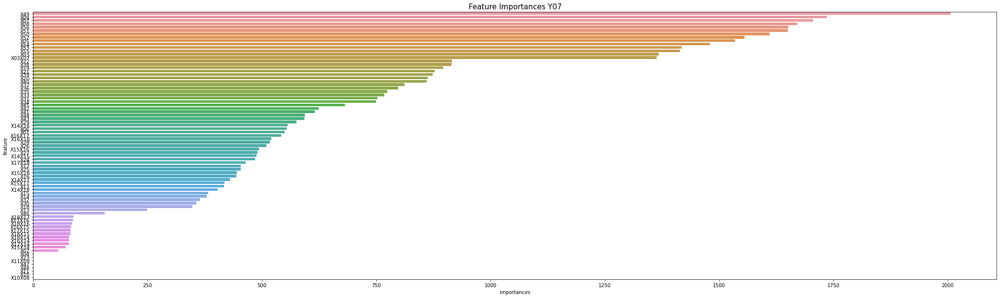

['X04', 'X23', 'X11X09', 'X47', 'X48', 'X11', 'X10', 'X10X08']
predict Y07
fit Y08


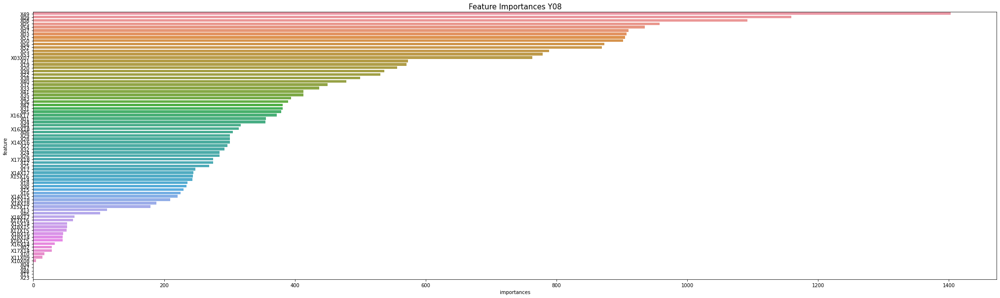

['X04', 'X47', 'X48', 'X11', 'X23']
predict Y08
fit Y09


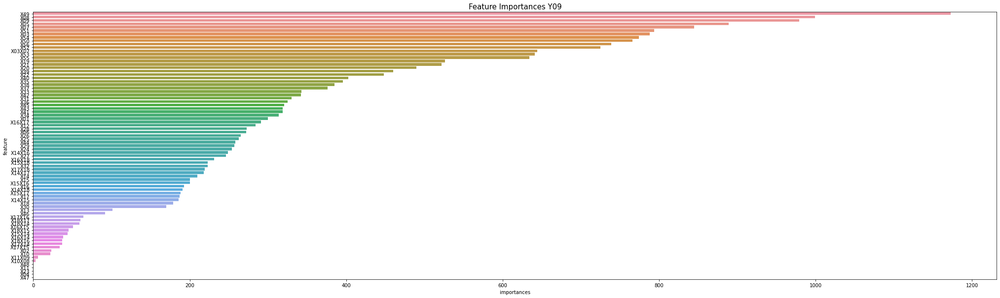

['X48', 'X11', 'X23', 'X04', 'X47']
predict Y09
fit Y10


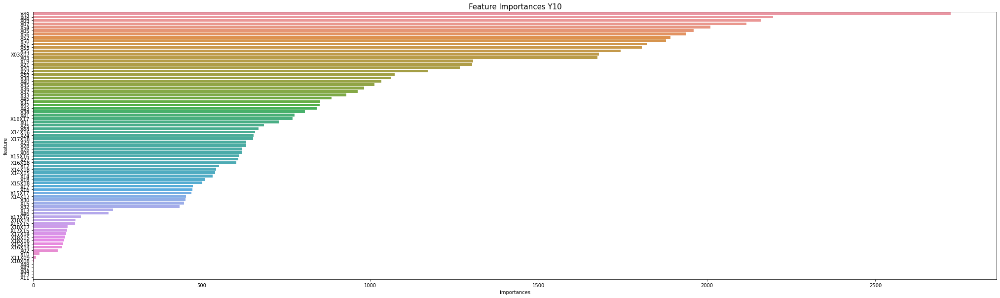

['X48', 'X47', 'X04', 'X23', 'X11']
predict Y10
fit Y11


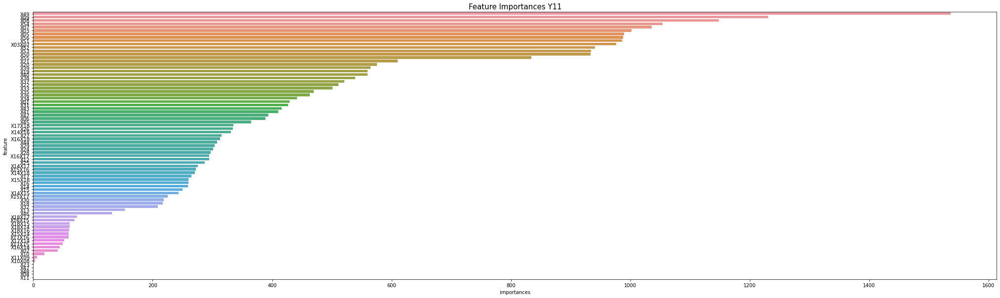

['X23', 'X47', 'X48', 'X04', 'X11']
predict Y11
fit Y12


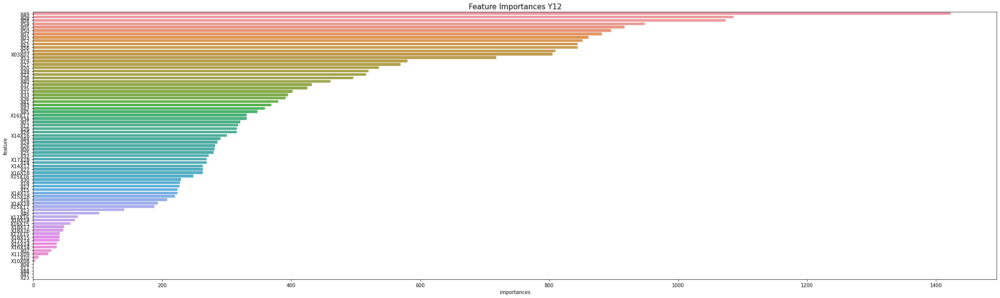

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y12
fit Y13


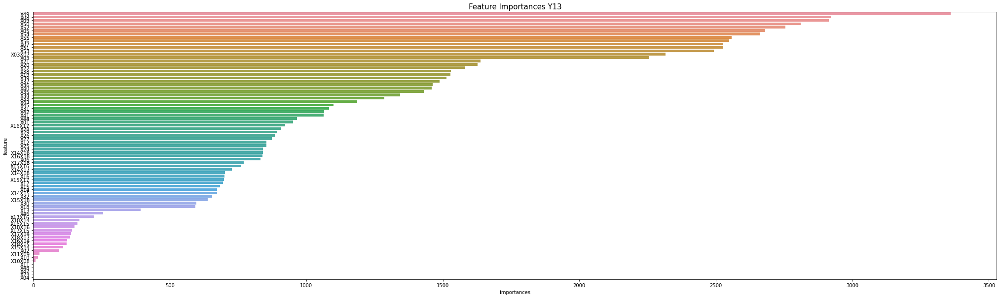

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y13
fit Y14


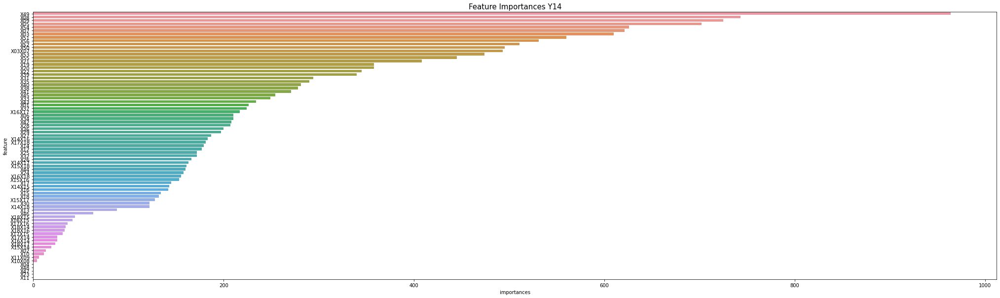

['X04', 'X48', 'X47', 'X23', 'X11']
predict Y14
Fold 2 / lg_nrmse : 1.9767338395879765
fit Y01


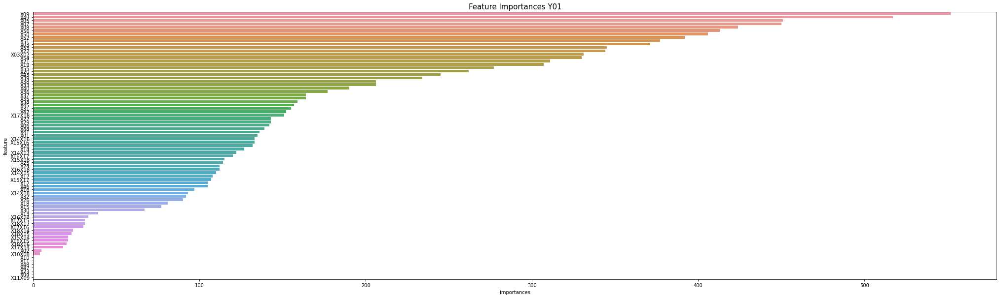

['X10', 'X11', 'X48', 'X47', 'X23', 'X04', 'X11X09']
predict Y01
fit Y02


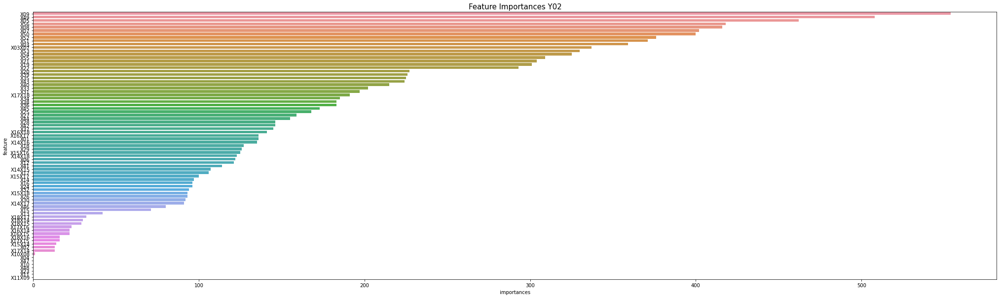

['X04', 'X47', 'X10', 'X48', 'X23', 'X11', 'X11X09']
predict Y02
fit Y03


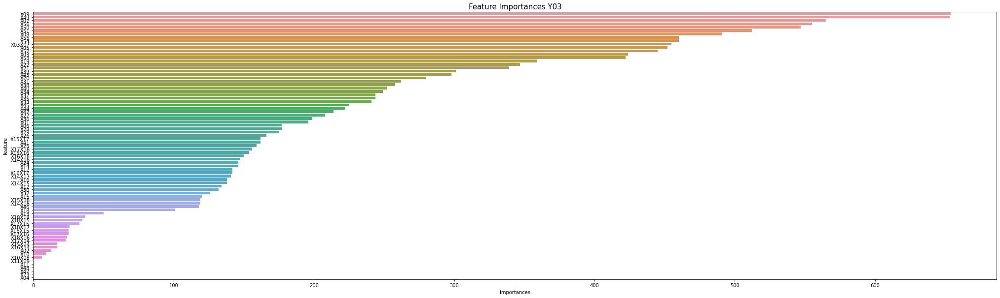

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y03
fit Y04


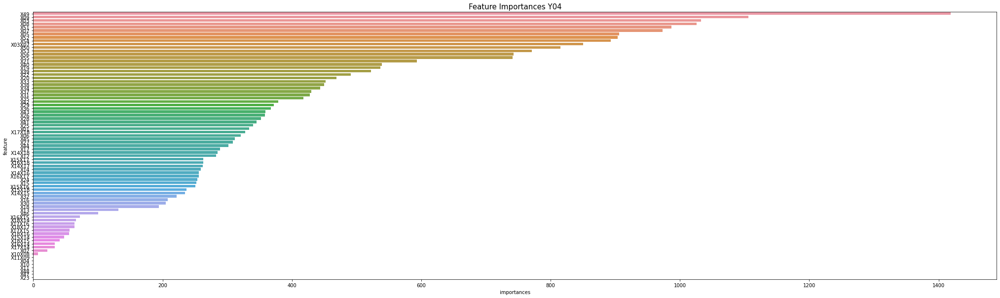

['X11X09', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23']
predict Y04
fit Y05


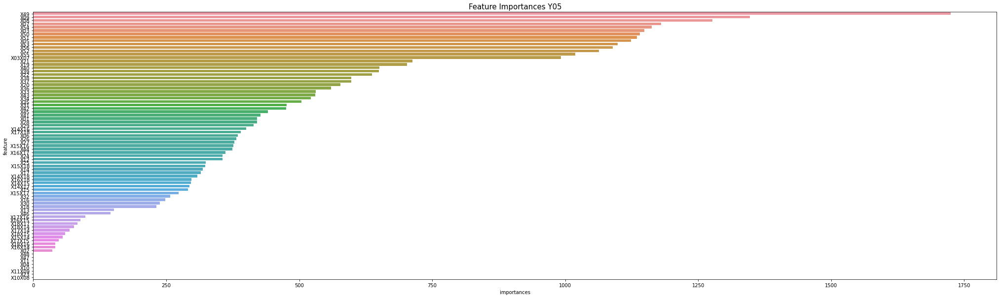

['X48', 'X47', 'X11', 'X04', 'X10', 'X11X09', 'X23', 'X10X08']
predict Y05
fit Y06


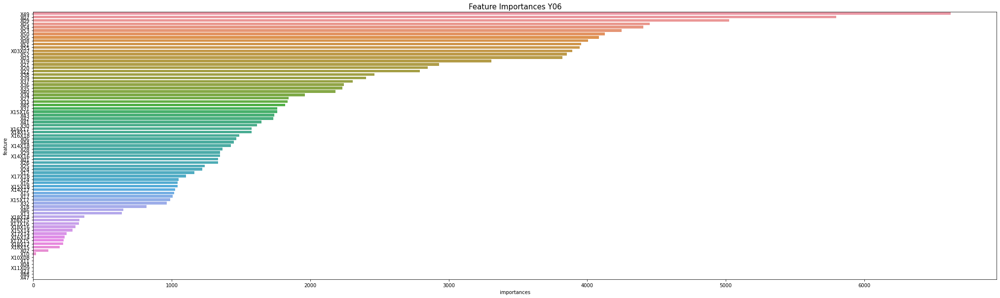

['X04', 'X11X09', 'X23', 'X48', 'X47']
predict Y06
fit Y07


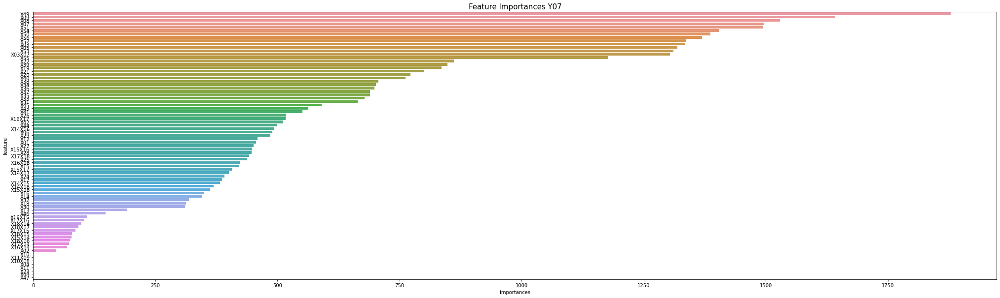

['X10', 'X11X09', 'X10X08', 'X04', 'X11', 'X23', 'X48', 'X47']
predict Y07
fit Y08


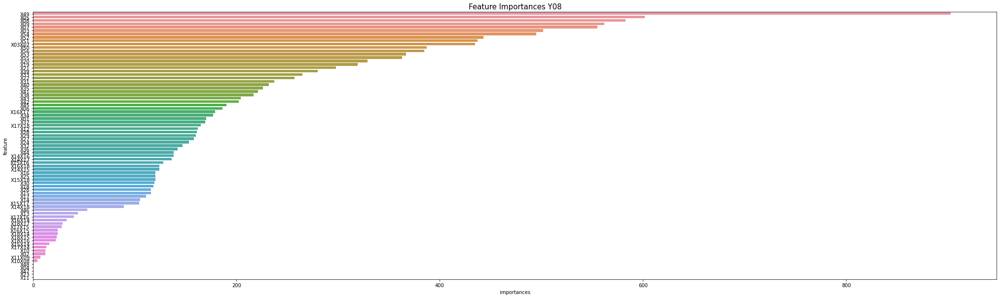

['X48', 'X04', 'X47', 'X23', 'X11']
predict Y08
fit Y09


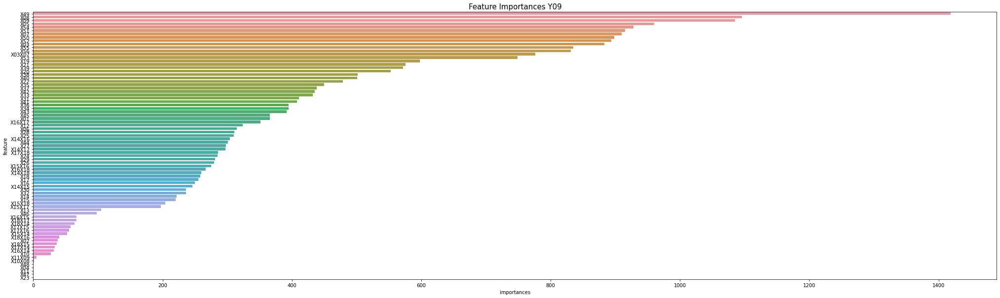

['X48', 'X04', 'X11', 'X47', 'X23']
predict Y09
fit Y10


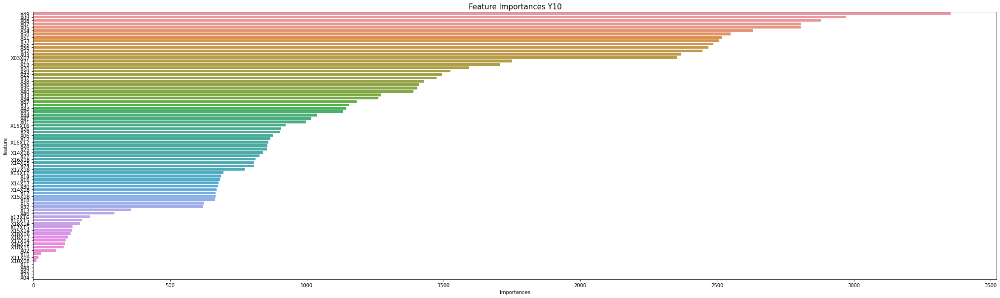

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


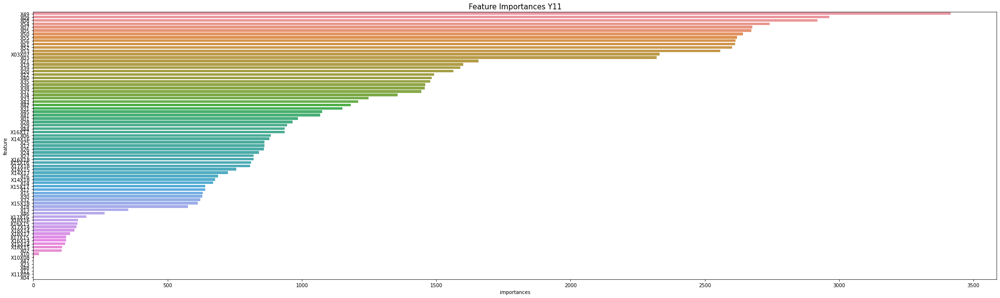

['X47', 'X23', 'X48', 'X11', 'X11X09', 'X04']
predict Y11
fit Y12


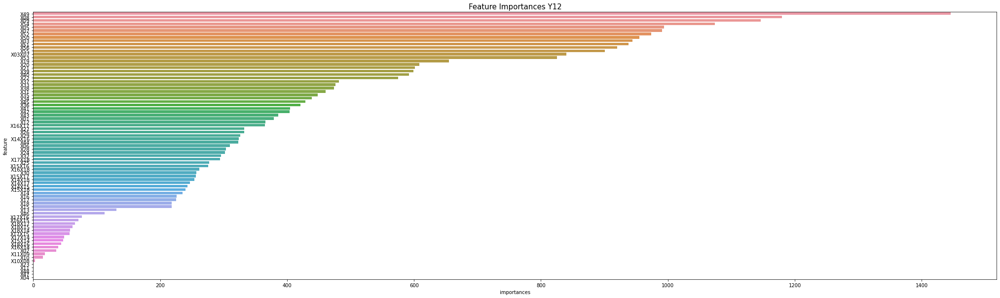

['X23', 'X11', 'X48', 'X47', 'X04']
predict Y12
fit Y13


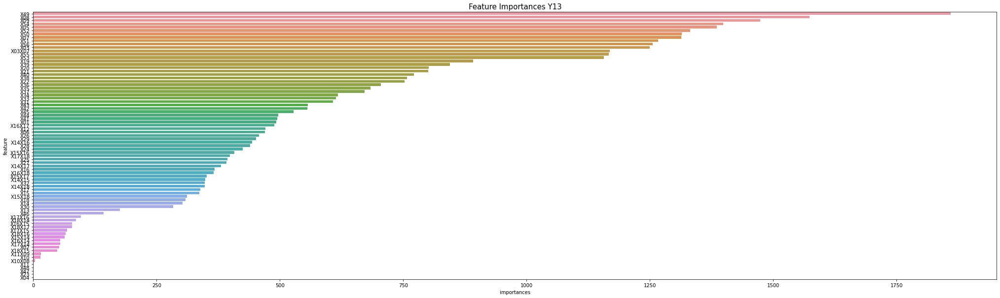

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y13
fit Y14


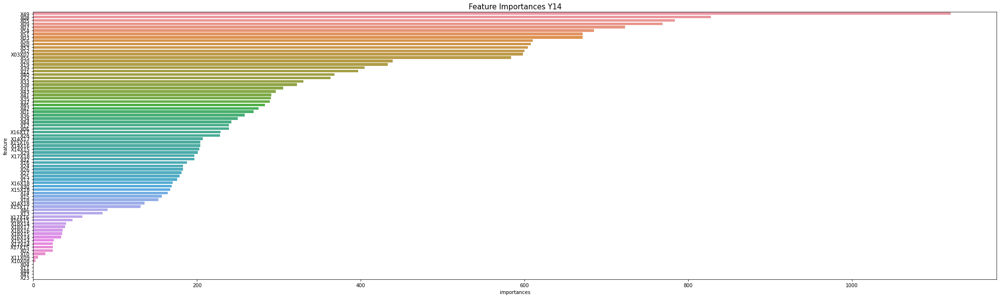

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y14
Fold 3 / lg_nrmse : 1.935223484249137
fit Y01


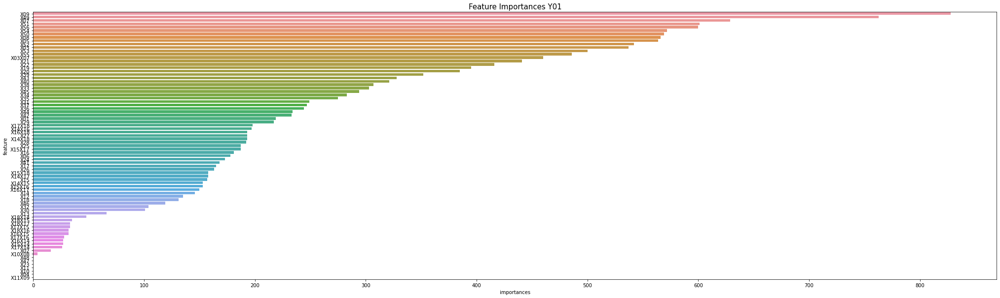

['X48', 'X47', 'X23', 'X11', 'X10', 'X04', 'X11X09']
predict Y01
fit Y02


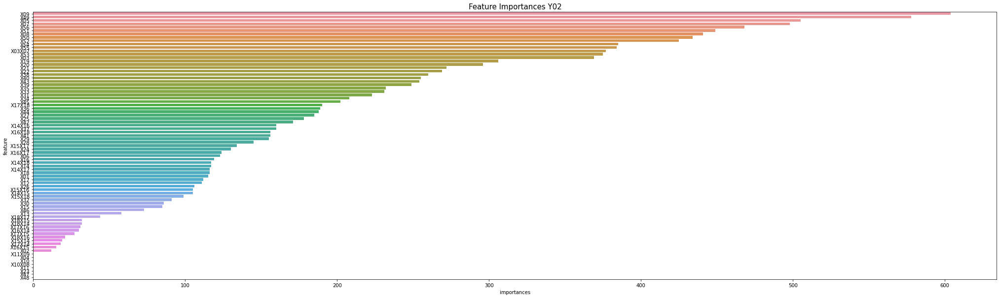

['X11X09', 'X04', 'X10', 'X10X08', 'X11', 'X23', 'X47', 'X48']
predict Y02
fit Y03


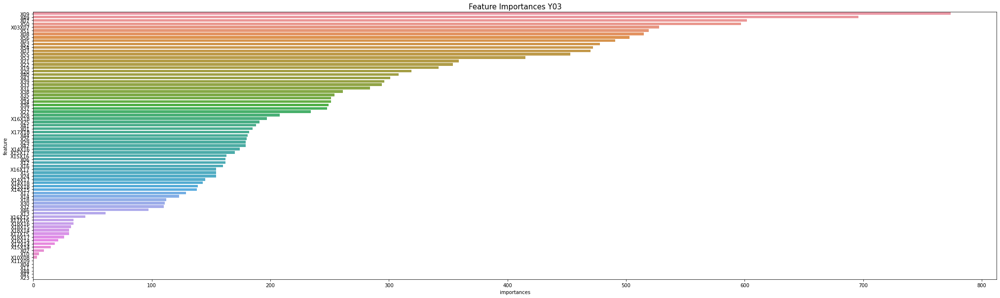

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y03
fit Y04


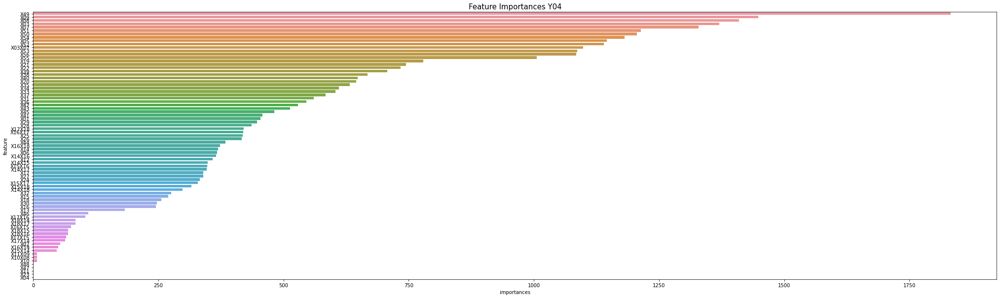

['X48', 'X47', 'X11', 'X23', 'X04']
predict Y04
fit Y05


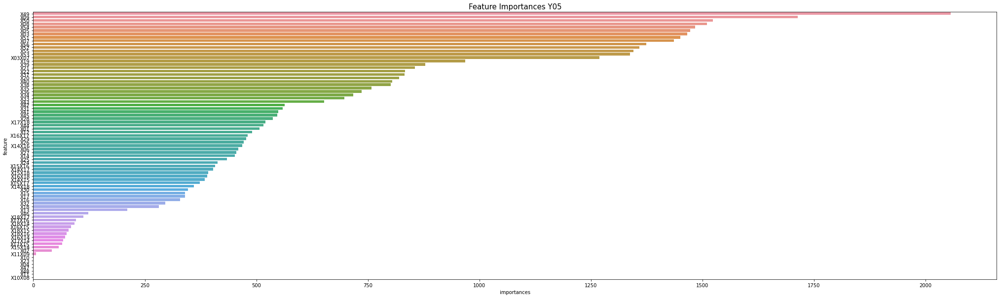

['X23', 'X04', 'X47', 'X48', 'X11', 'X10X08']
predict Y05
fit Y06


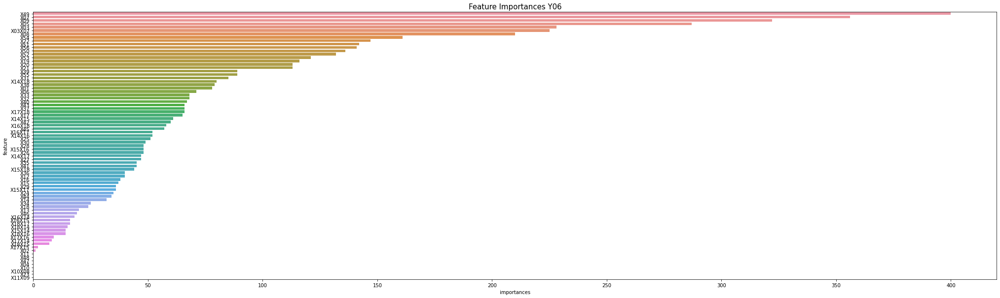

['X11', 'X48', 'X47', 'X04', 'X10', 'X10X08', 'X23', 'X11X09']
predict Y06
fit Y07


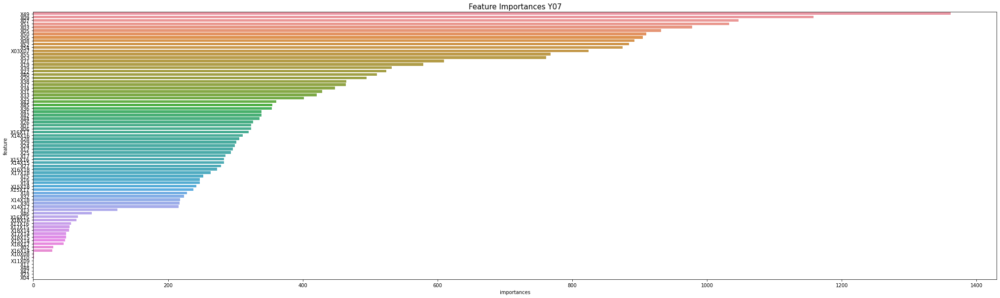

['X11X09', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y07
fit Y08


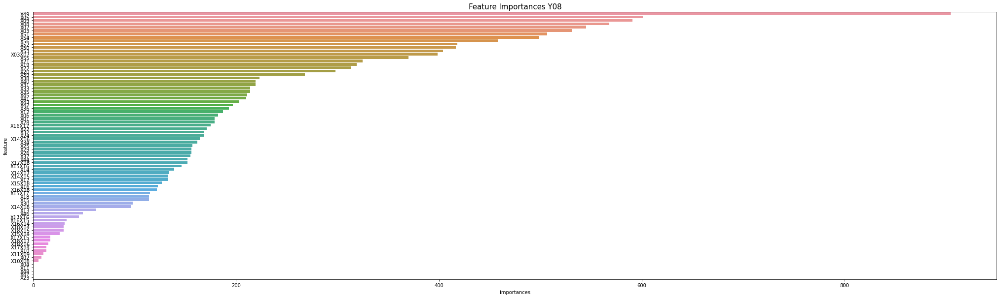

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y08
fit Y09


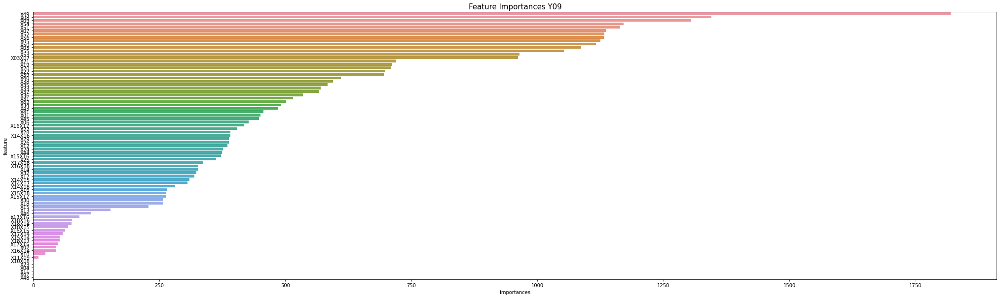

['X23', 'X04', 'X11', 'X47', 'X48']
predict Y09
fit Y10


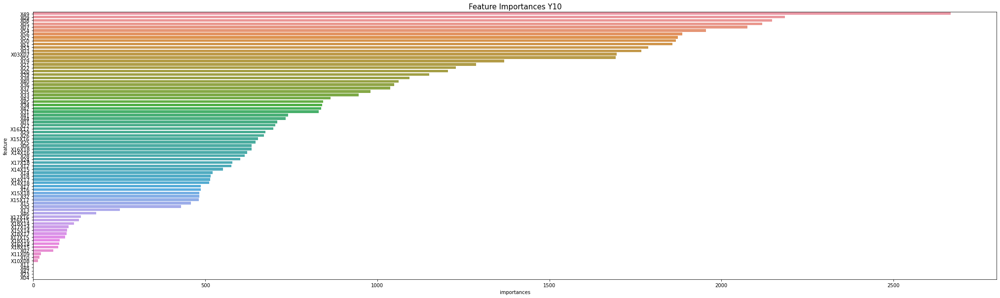

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


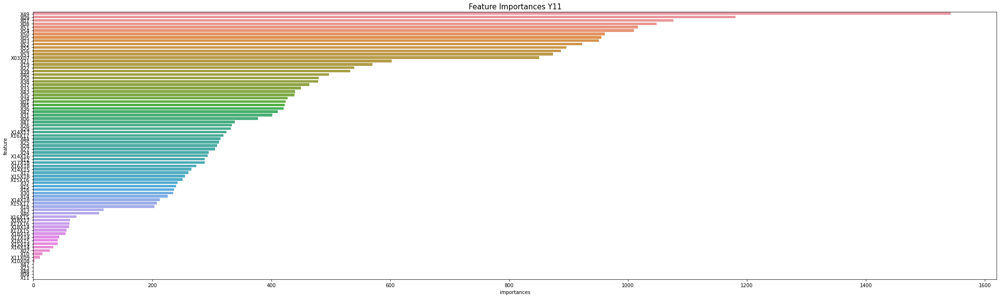

['X47', 'X23', 'X48', 'X04', 'X11']
predict Y11
fit Y12


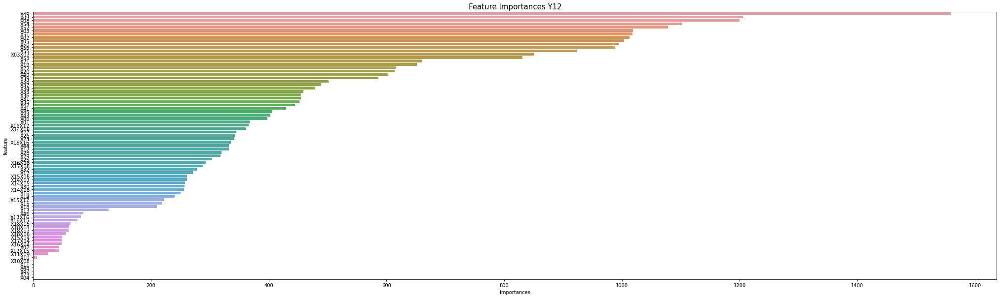

['X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y12
fit Y13


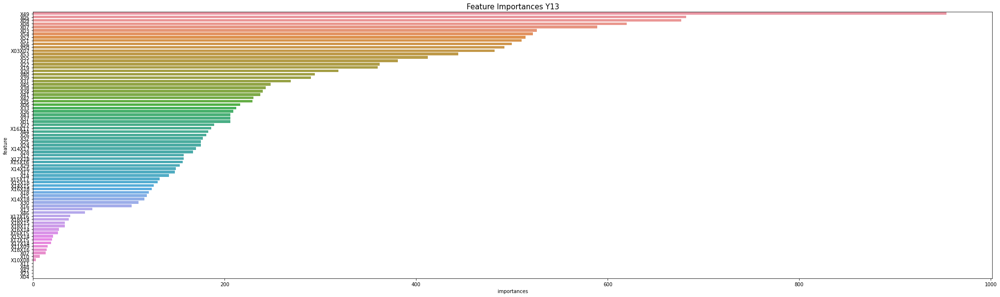

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y13
fit Y14


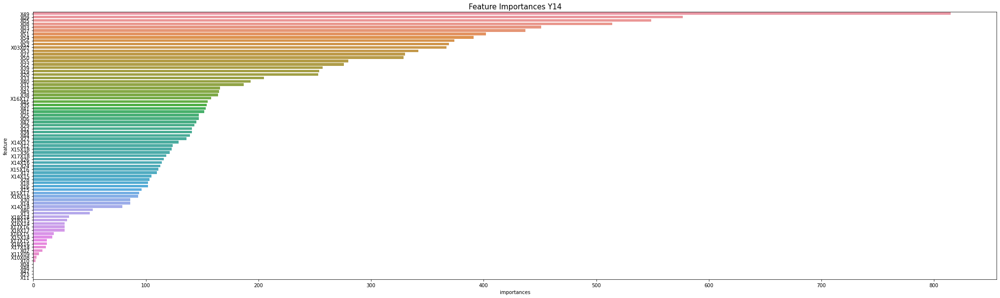

['X04', 'X48', 'X47', 'X23', 'X11']
predict Y14
Fold 4 / lg_nrmse : 1.943520276811416
fit Y01


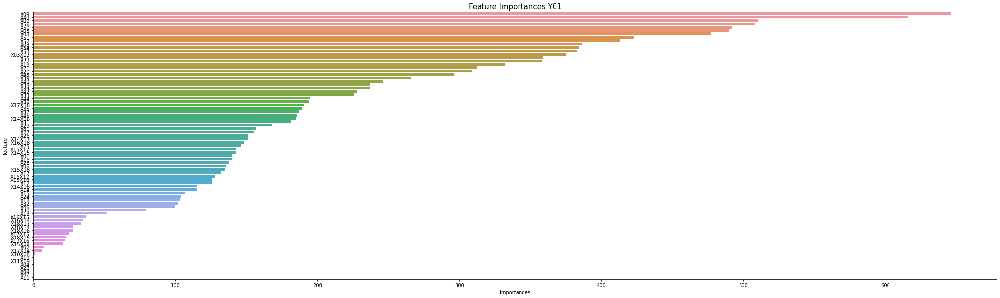

['X10', 'X11X09', 'X04', 'X23', 'X48', 'X47', 'X11']
predict Y01
fit Y02


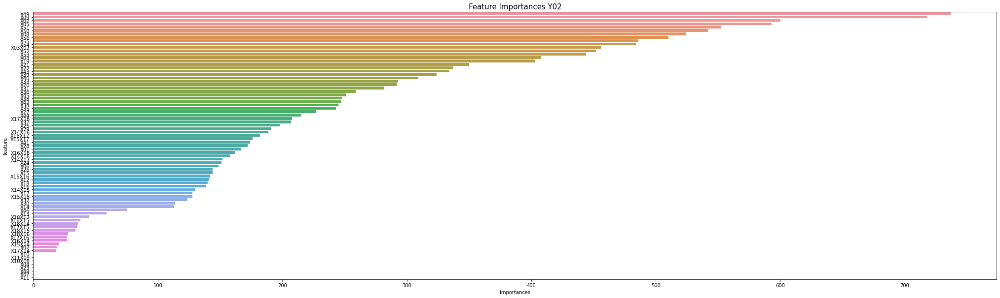

['X10', 'X11X09', 'X10X08', 'X04', 'X23', 'X48', 'X47', 'X11']
predict Y02
fit Y03


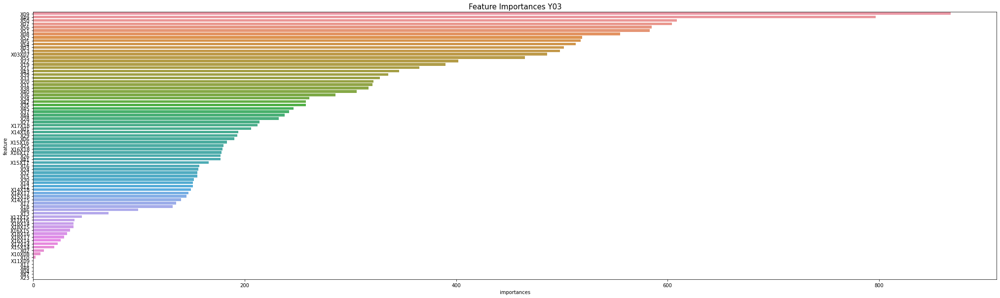

['X11X09', 'X11', 'X48', 'X04', 'X47', 'X23']
predict Y03
fit Y04


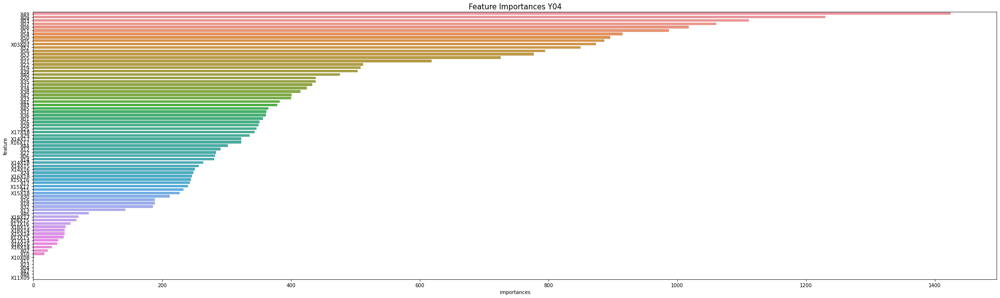

['X11', 'X23', 'X04', 'X47', 'X48', 'X11X09']
predict Y04
fit Y05


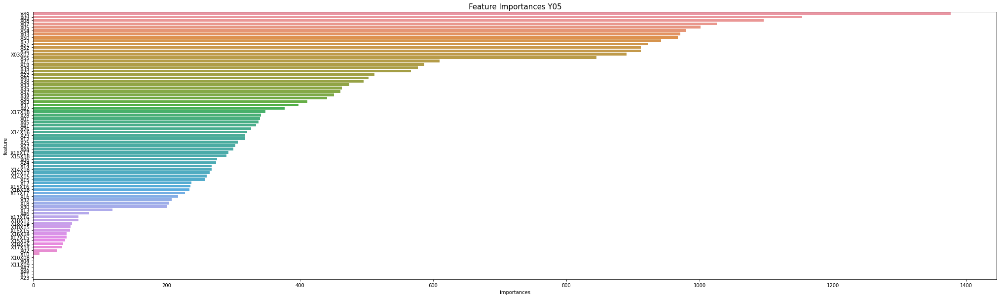

['X04', 'X11X09', 'X47', 'X48', 'X11', 'X23']
predict Y05
fit Y06


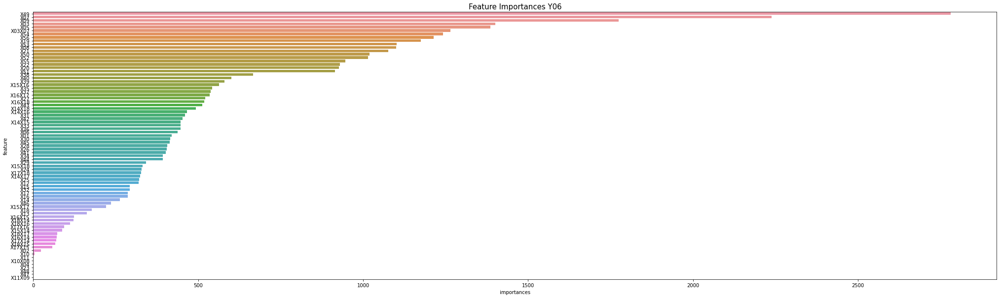

['X11', 'X10X08', 'X04', 'X23', 'X48', 'X47', 'X11X09']
predict Y06
fit Y07


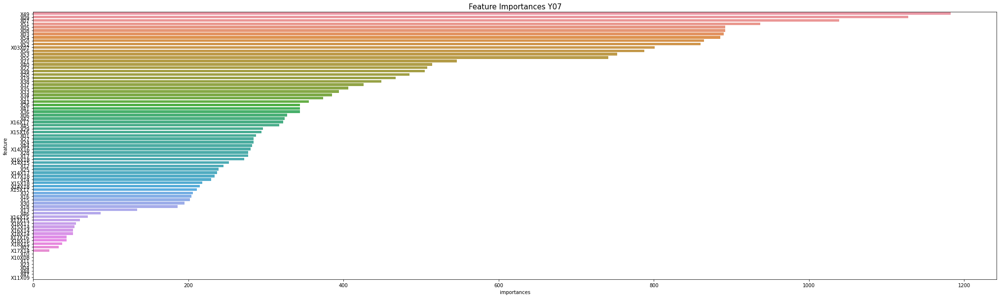

['X10', 'X10X08', 'X11', 'X23', 'X04', 'X48', 'X47', 'X11X09']
predict Y07
fit Y08


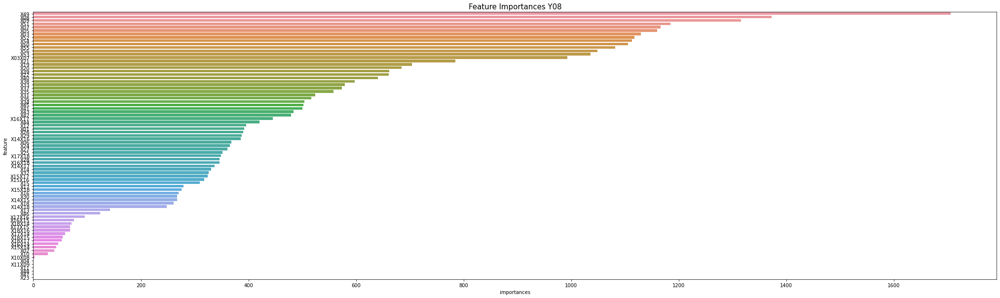

['X04', 'X11X09', 'X11', 'X48', 'X47', 'X23']
predict Y08
fit Y09


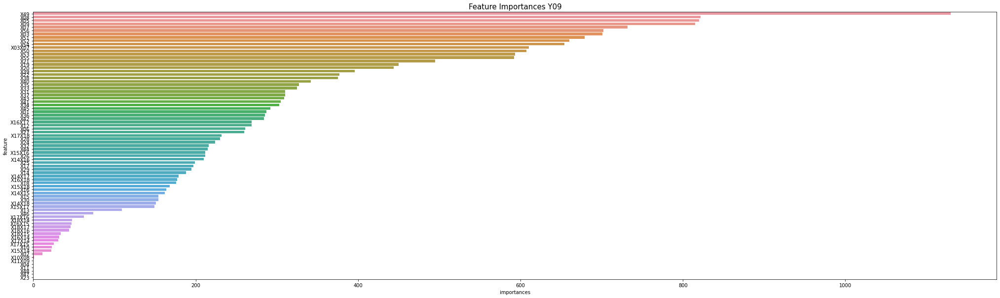

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y09
fit Y10


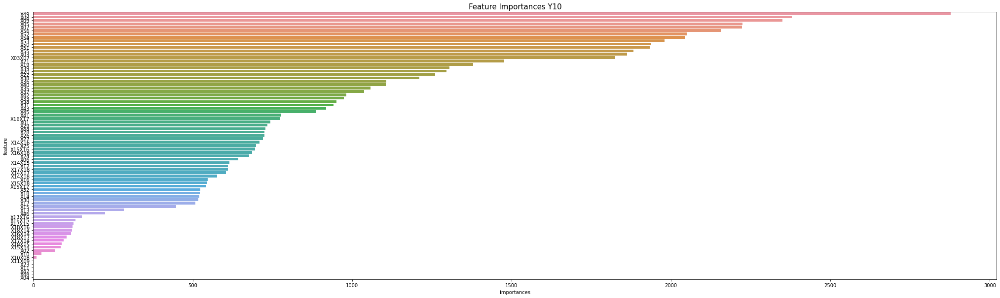

['X11X09', 'X23', 'X11', 'X47', 'X48', 'X04']
predict Y10
fit Y11


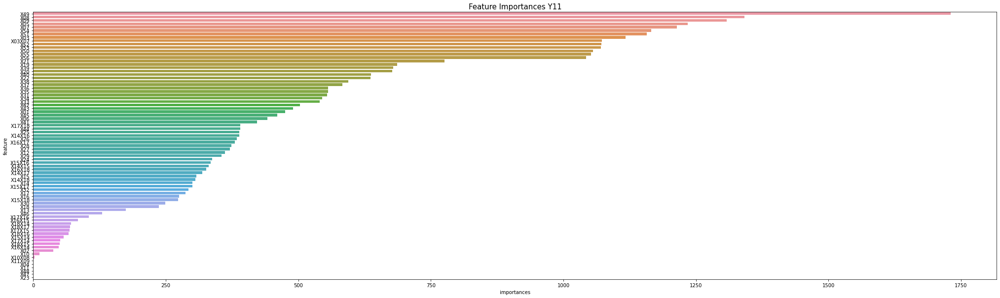

['X11X09', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y11
fit Y12


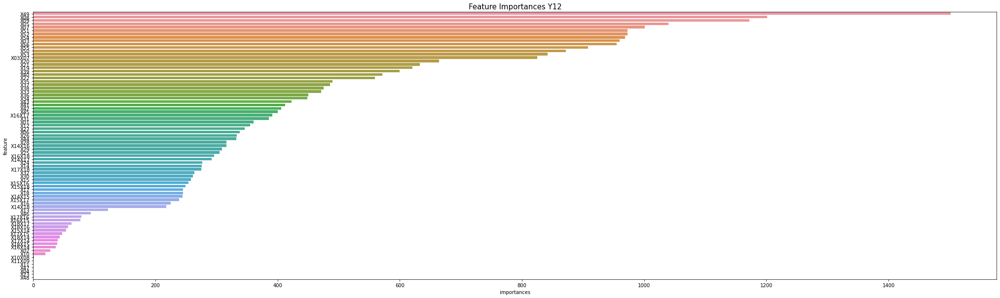

['X11X09', 'X11', 'X47', 'X04', 'X23', 'X48']
predict Y12
fit Y13


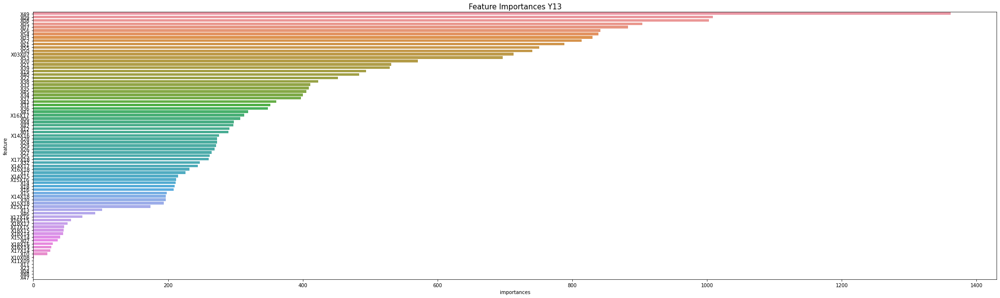

['X11X09', 'X11', 'X23', 'X04', 'X48', 'X47']
predict Y13
fit Y14


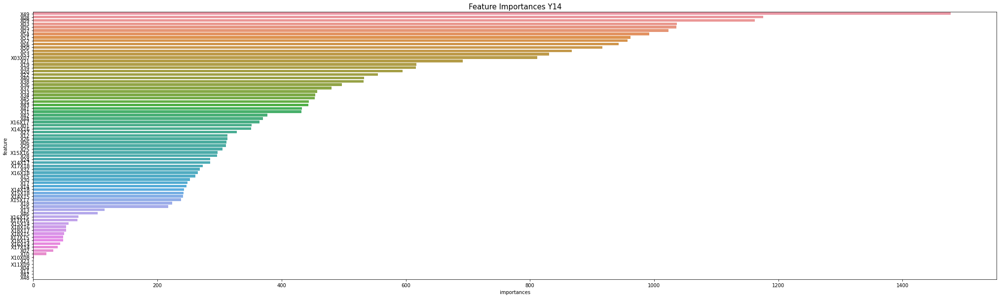

['X23', 'X11X09', 'X04', 'X11', 'X47', 'X48']
predict Y14
Fold 5 / lg_nrmse : 1.938116277524916
fit Y01


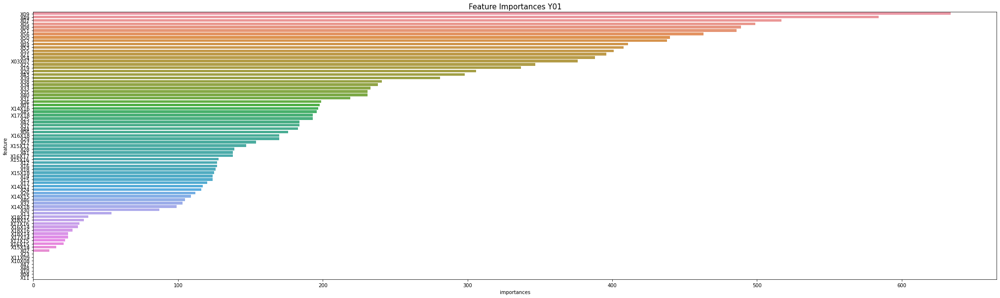

['X23', 'X11X09', 'X10X08', 'X47', 'X48', 'X10', 'X04', 'X11']
predict Y01
fit Y02


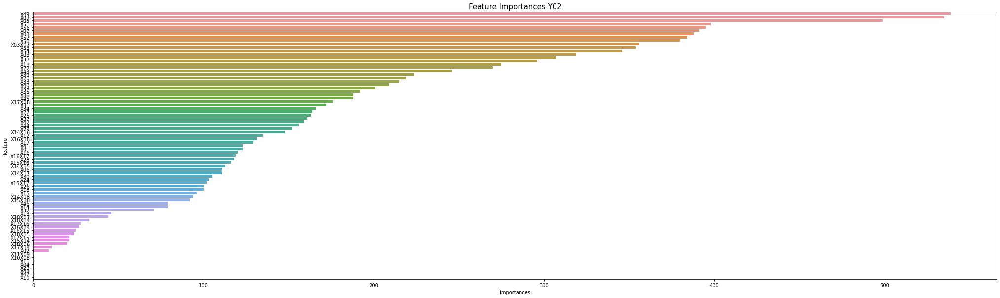

['X11X09', 'X10X08', 'X11', 'X04', 'X23', 'X48', 'X47', 'X10']
predict Y02
fit Y03


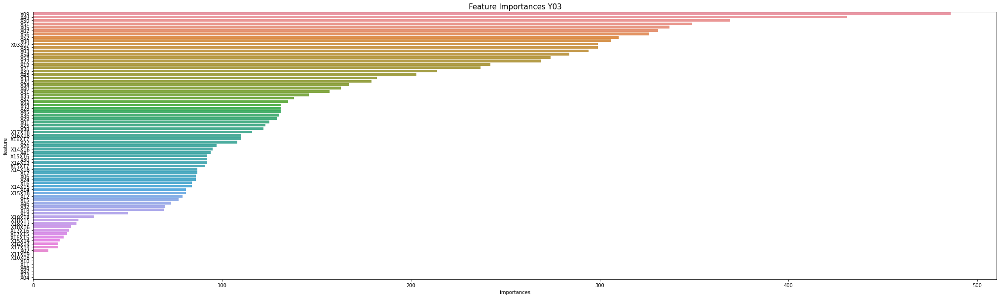

['X11X09', 'X10X08', 'X10', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y03
fit Y04


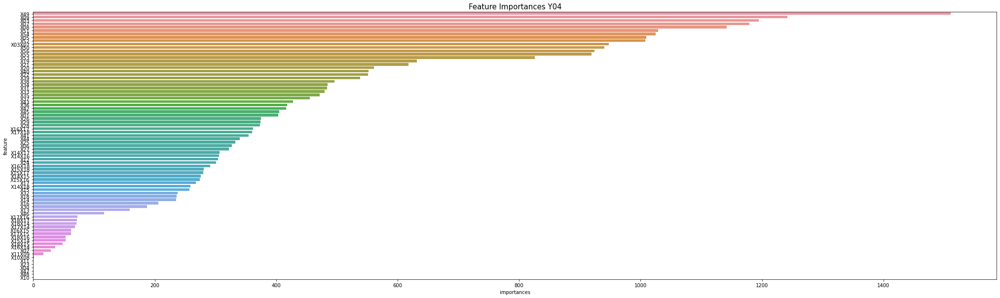

['X11', 'X23', 'X04', 'X47', 'X48', 'X10']
predict Y04
fit Y05


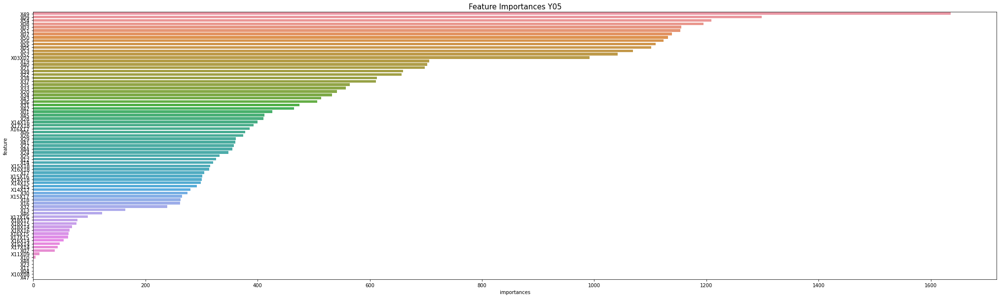

['X48', 'X23', 'X11', 'X04', 'X10X08', 'X47']
predict Y05
fit Y06


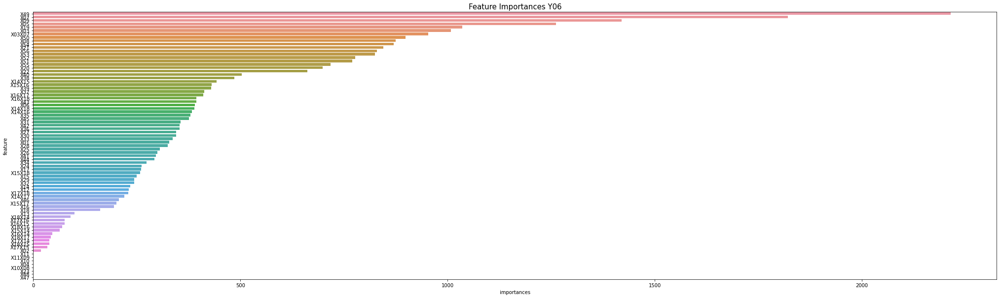

['X11', 'X11X09', 'X10', 'X04', 'X10X08', 'X23', 'X48', 'X47']
predict Y06
fit Y07


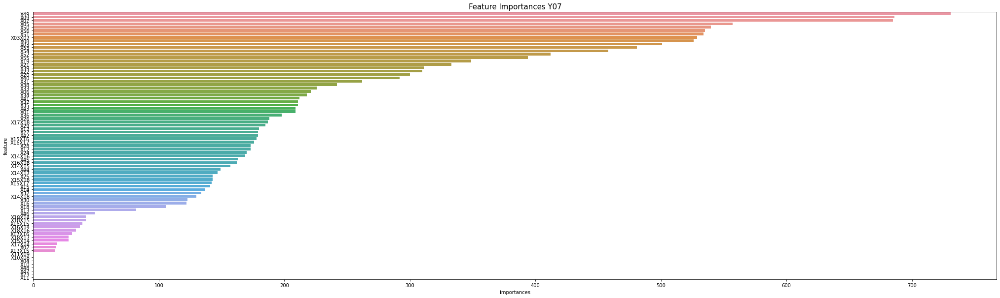

['X11X09', 'X10X08', 'X04', 'X10', 'X48', 'X47', 'X23', 'X11']
predict Y07
fit Y08


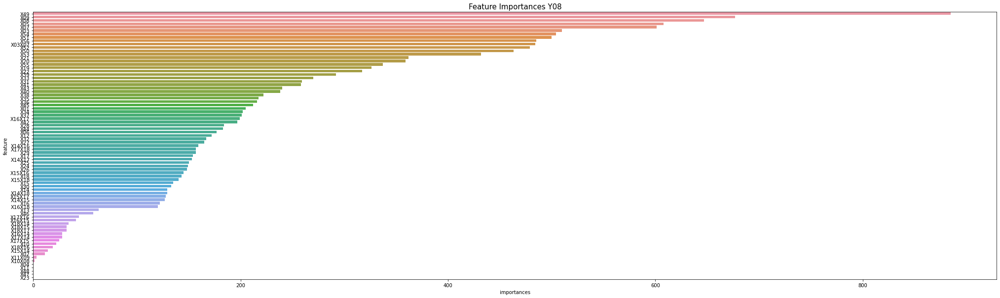

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y08
fit Y09


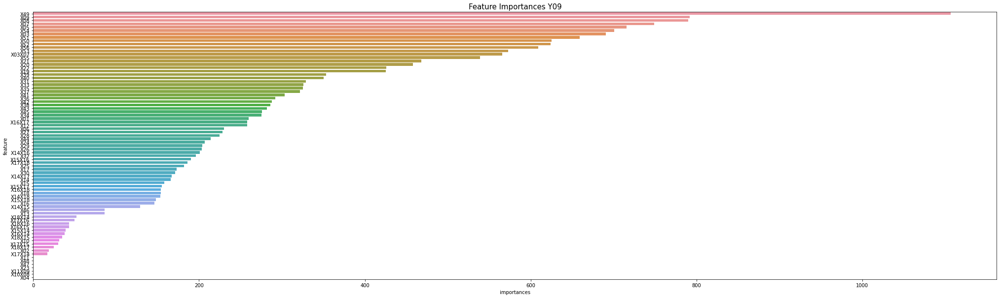

['X11', 'X48', 'X47', 'X23', 'X11X09', 'X10X08', 'X04']
predict Y09
fit Y10


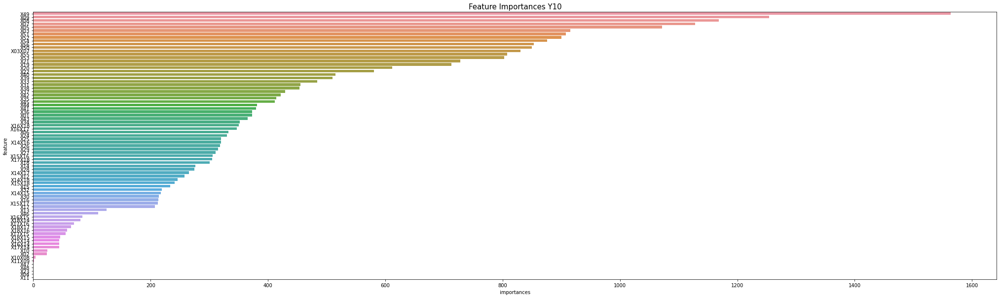

['X47', 'X48', 'X23', 'X04', 'X11']
predict Y10
fit Y11


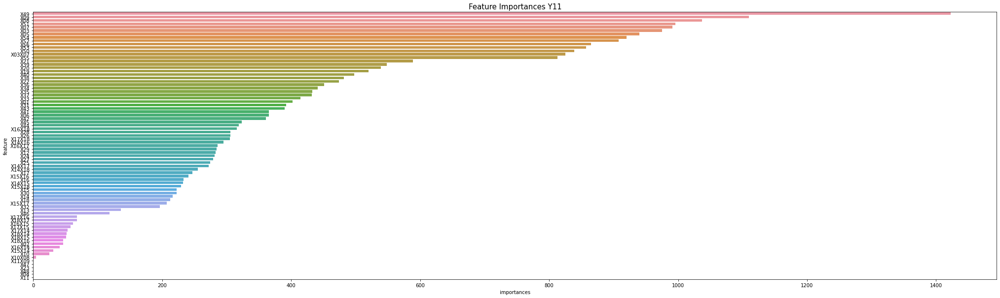

['X11X09', 'X47', 'X23', 'X48', 'X04', 'X11']
predict Y11
fit Y12


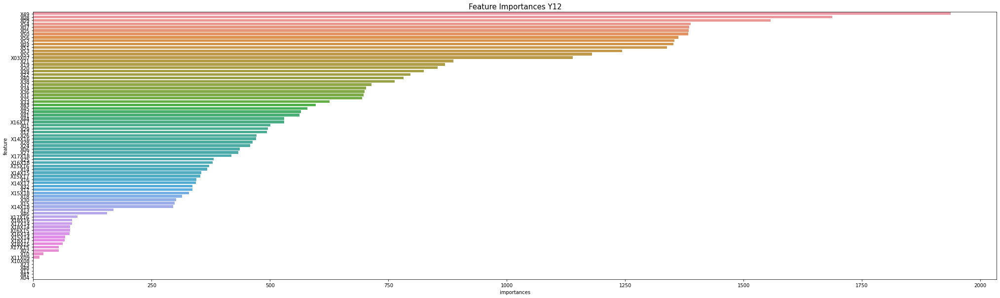

['X23', 'X48', 'X11', 'X47', 'X04']
predict Y12
fit Y13


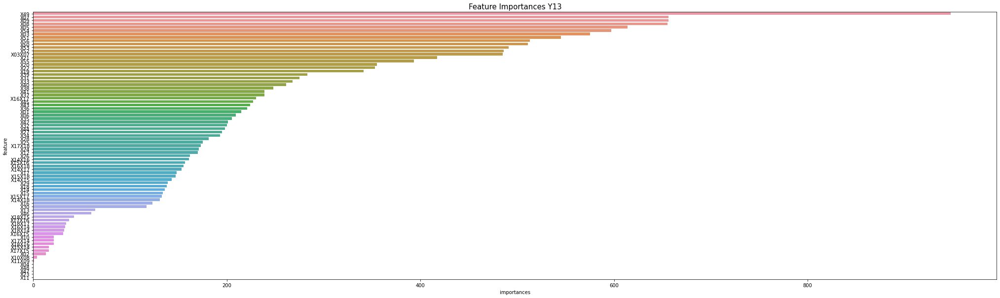

['X04', 'X48', 'X47', 'X23', 'X11']
predict Y13
fit Y14


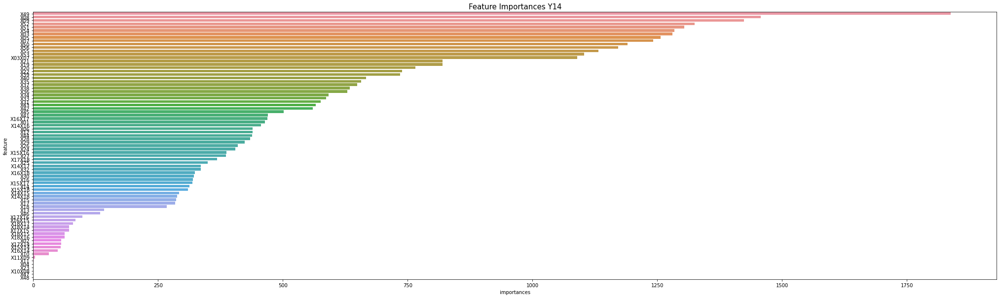

['X04', 'X23', 'X10X08', 'X47', 'X48']
predict Y14
Fold 6 / lg_nrmse : 1.9724037199191913
fit Y01


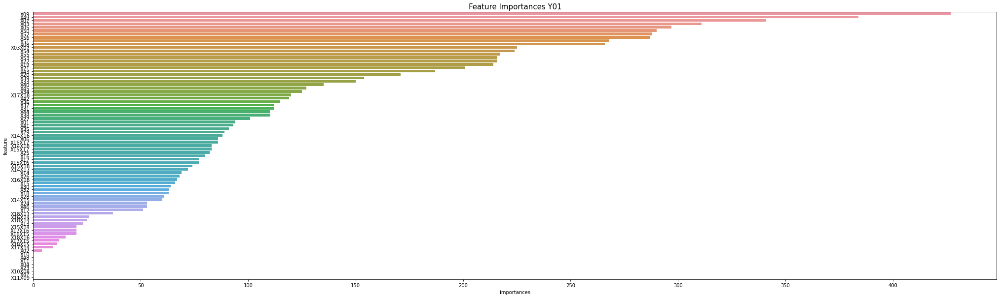

['X10', 'X48', 'X11', 'X04', 'X23', 'X10X08', 'X47', 'X11X09']
predict Y01
fit Y02


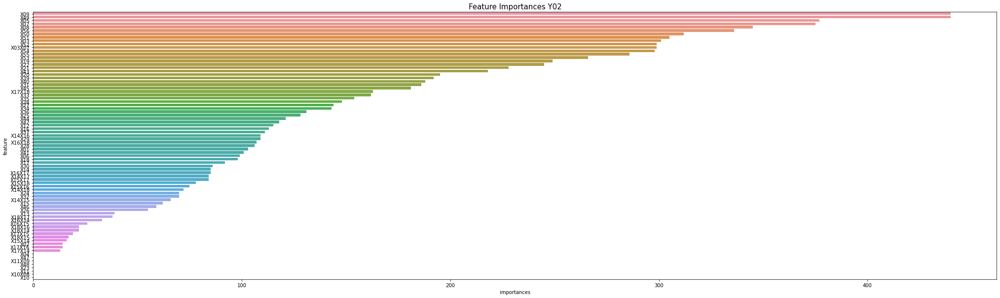

['X04', 'X47', 'X11X09', 'X48', 'X23', 'X11', 'X10X08', 'X10']
predict Y02
fit Y03


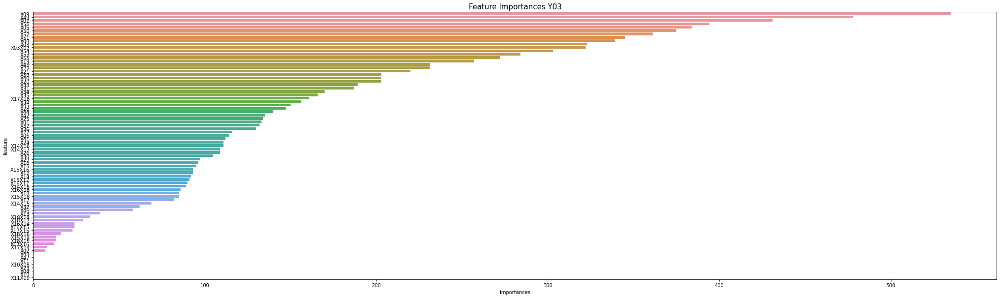

['X48', 'X47', 'X11', 'X10X08', 'X23', 'X04', 'X10', 'X11X09']
predict Y03
fit Y04


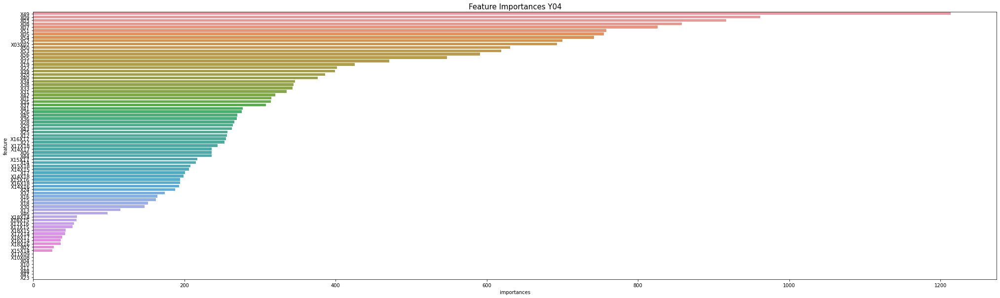

['X11X09', 'X10X08', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23']
predict Y04
fit Y05


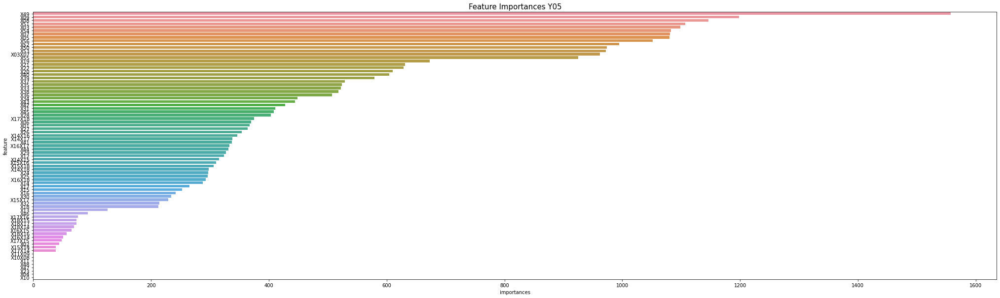

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04', 'X10']
predict Y05
fit Y06


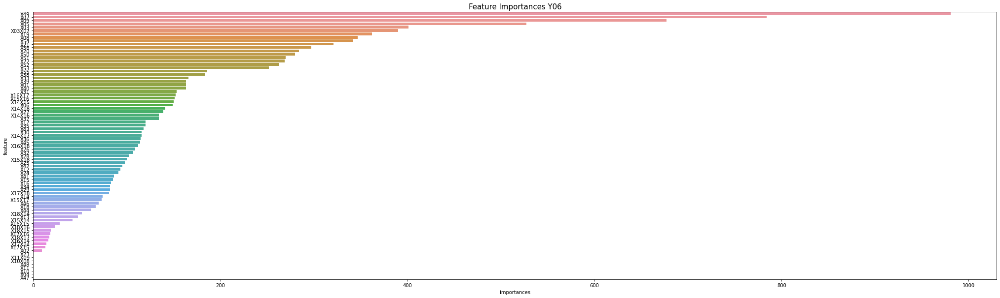

['X23', 'X11X09', 'X10X08', 'X48', 'X11', 'X10', 'X04', 'X47']
predict Y06
fit Y07


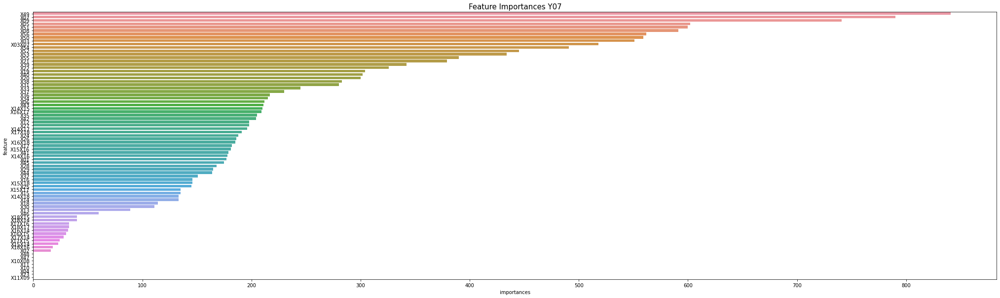

['X48', 'X47', 'X10X08', 'X11', 'X10', 'X04', 'X23', 'X11X09']
predict Y07
fit Y08


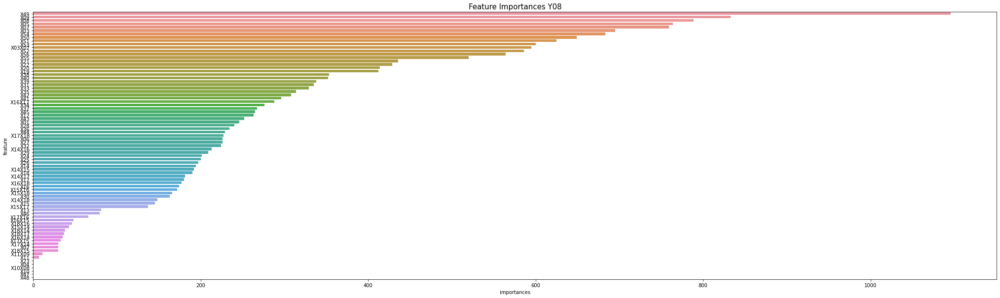

['X23', 'X04', 'X10X08', 'X10', 'X47', 'X48']
predict Y08
fit Y09


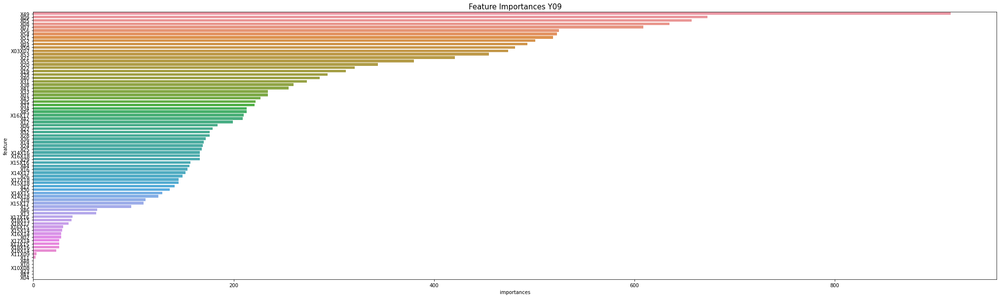

['X48', 'X10', 'X10X08', 'X23', 'X47', 'X04']
predict Y09
fit Y10


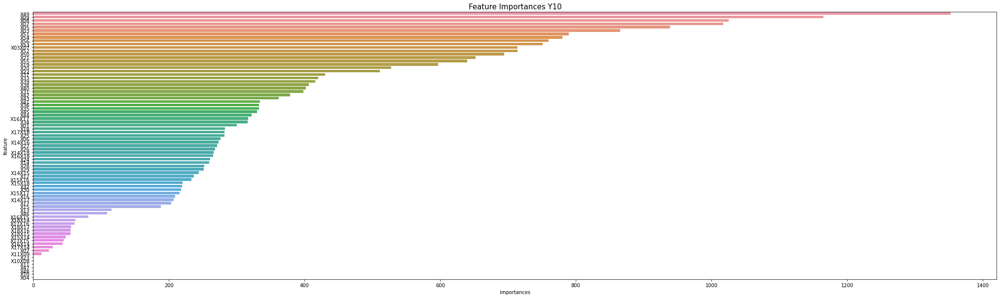

['X23', 'X10X08', 'X11', 'X47', 'X48', 'X10', 'X04']
predict Y10
fit Y11


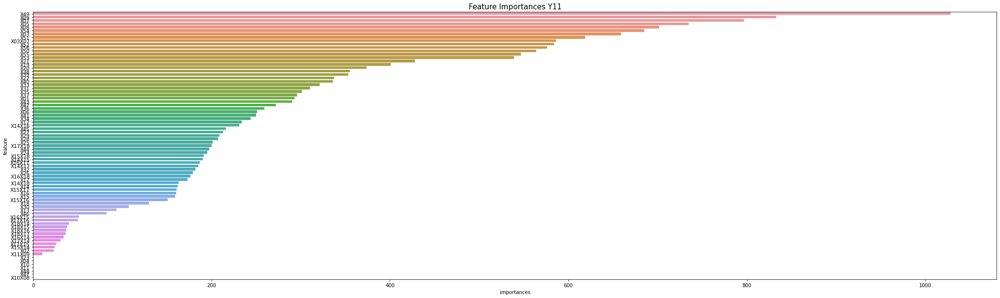

['X23', 'X04', 'X10', 'X11', 'X48', 'X47', 'X10X08']
predict Y11
fit Y12


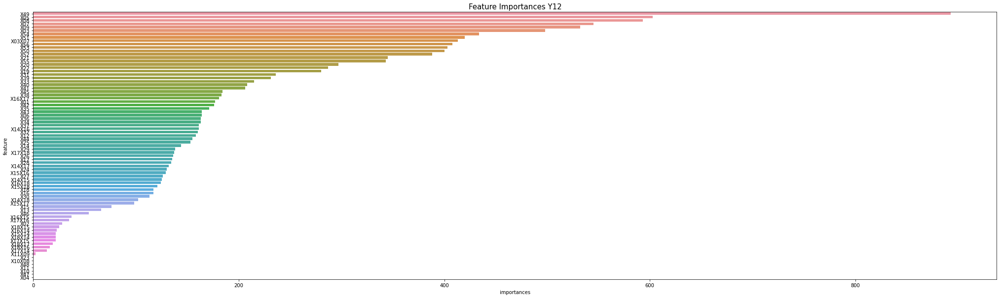

['X23', 'X10X08', 'X48', 'X11', 'X10', 'X47', 'X04']
predict Y12
fit Y13


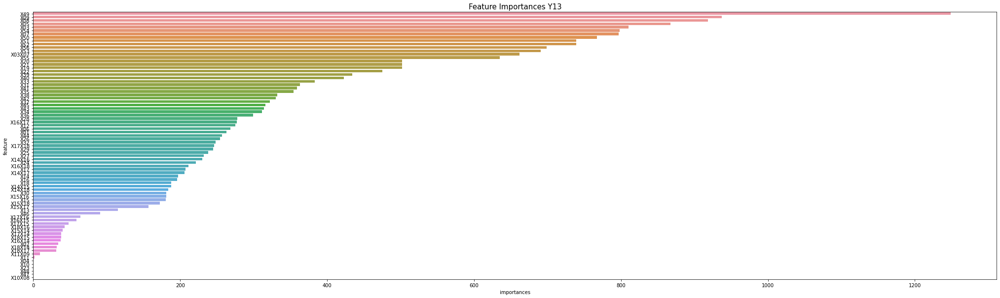

['X04', 'X10', 'X23', 'X48', 'X47', 'X10X08']
predict Y13
fit Y14


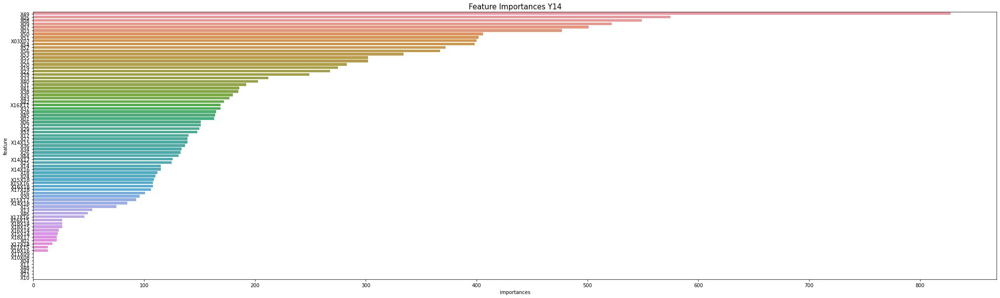

['X11X09', 'X10X08', 'X04', 'X11', 'X48', 'X47', 'X23', 'X10']
predict Y14
Fold 7 / lg_nrmse : 1.9061114601976978
fit Y01


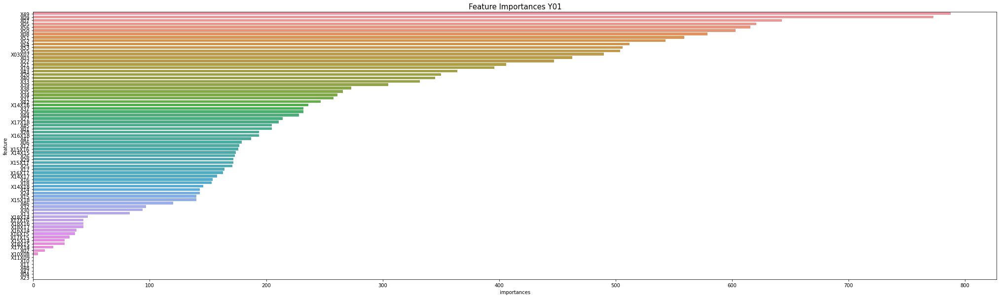

['X11X09', 'X10', 'X11', 'X48', 'X47', 'X04', 'X23']
predict Y01
fit Y02


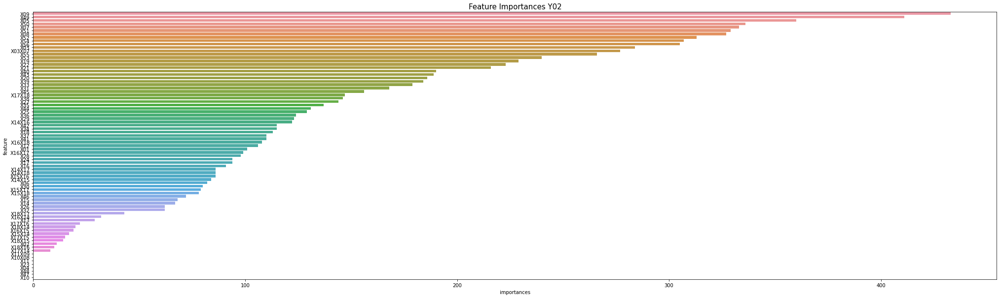

['X11X09', 'X10X08', 'X11', 'X23', 'X04', 'X48', 'X47', 'X10']
predict Y02
fit Y03


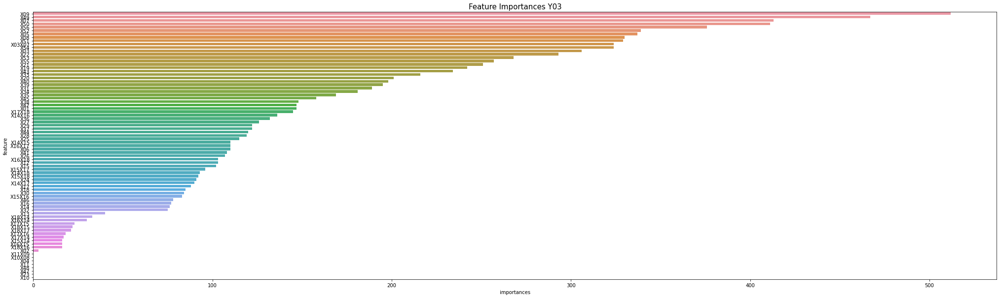

['X11X09', 'X10X08', 'X04', 'X11', 'X48', 'X47', 'X23', 'X10']
predict Y03
fit Y04


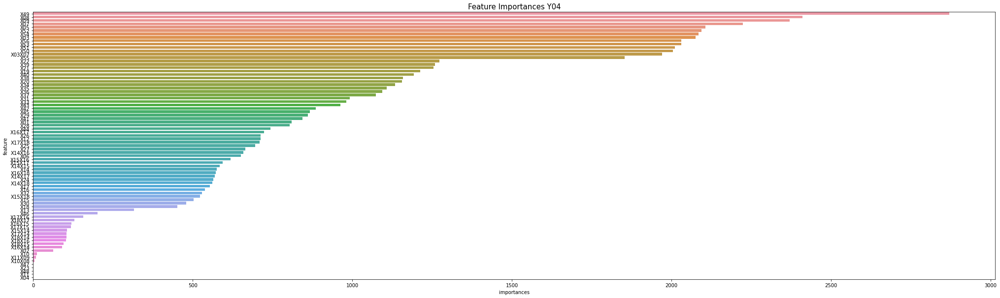

['X47', 'X23', 'X48', 'X11', 'X04']
predict Y04
fit Y05


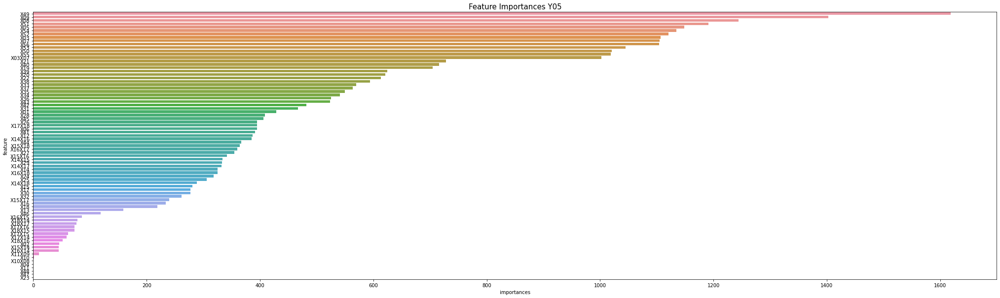

['X10X08', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y05
fit Y06


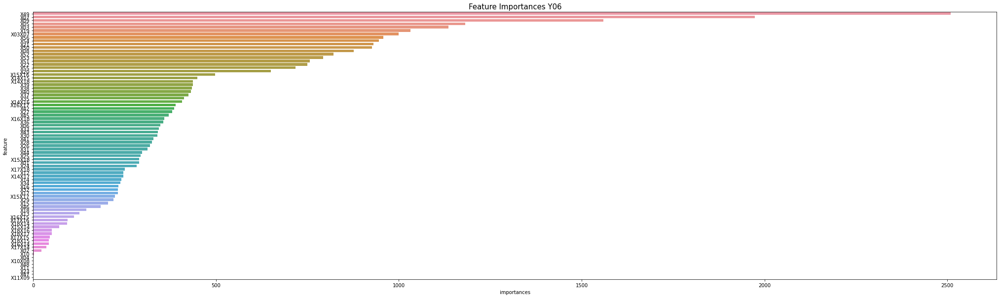

['X04', 'X10X08', 'X48', 'X11', 'X23', 'X47', 'X11X09']
predict Y06
fit Y07


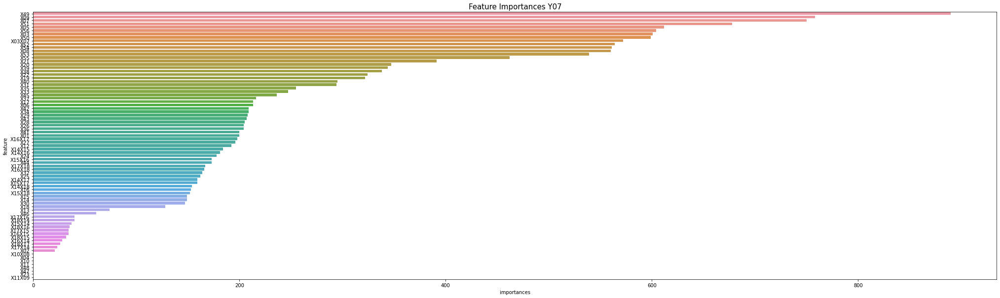

['X10X08', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23', 'X11X09']
predict Y07
fit Y08


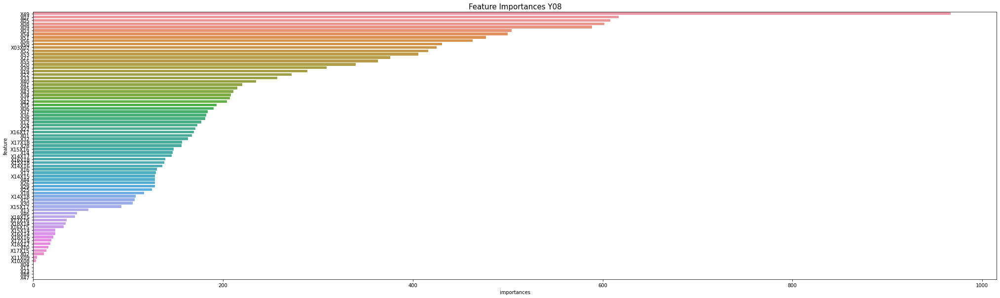

['X04', 'X11', 'X23', 'X48', 'X47']
predict Y08
fit Y09


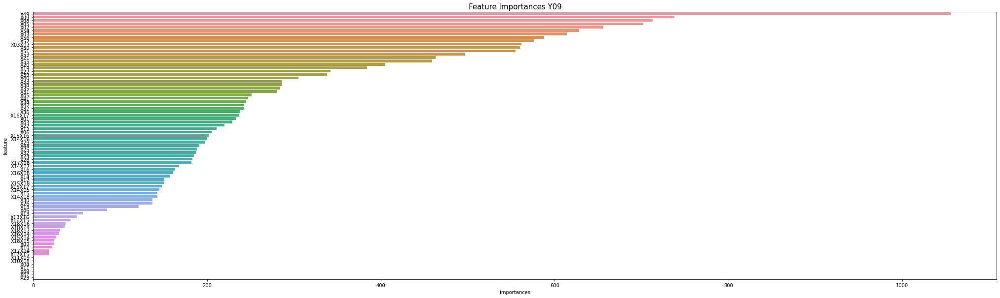

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y09
fit Y10


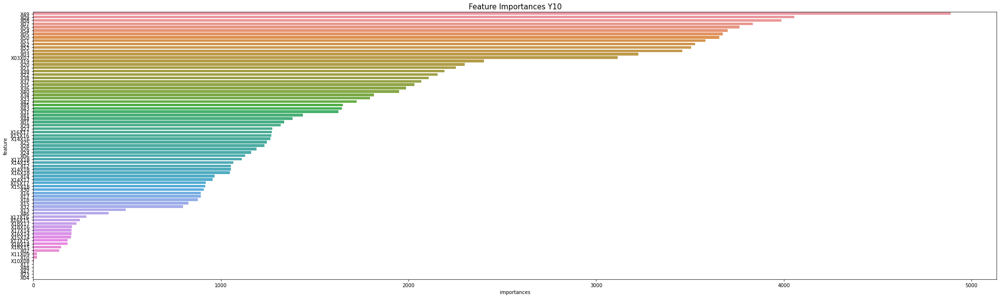

['X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


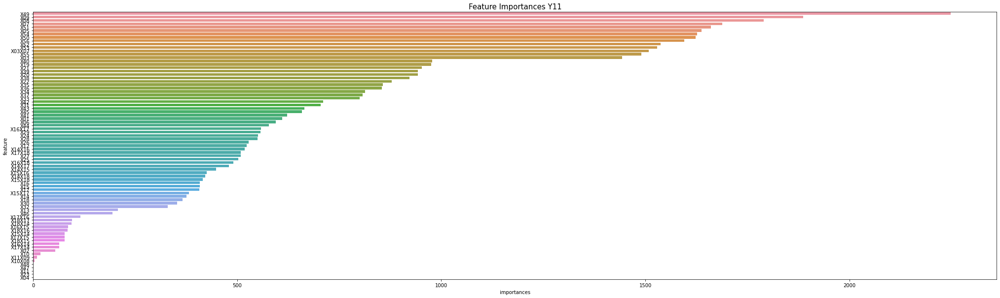

['X48', 'X47', 'X11', 'X23', 'X04']
predict Y11
fit Y12


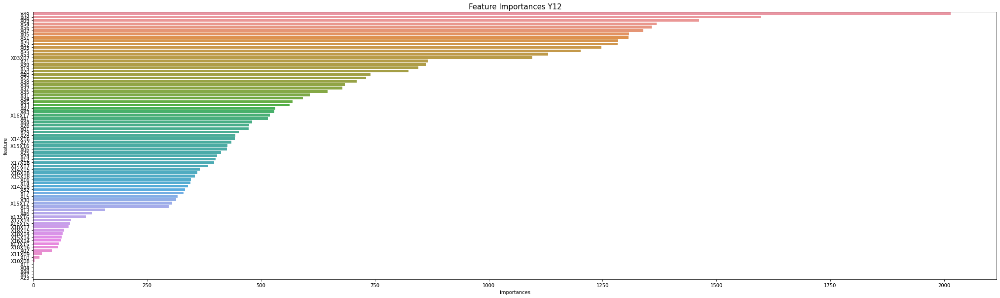

['X11', 'X04', 'X48', 'X47', 'X23']
predict Y12
fit Y13


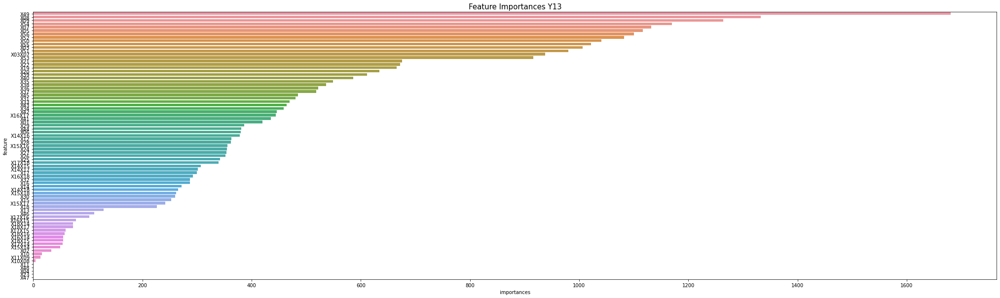

['X11', 'X48', 'X04', 'X23', 'X47']
predict Y13
fit Y14


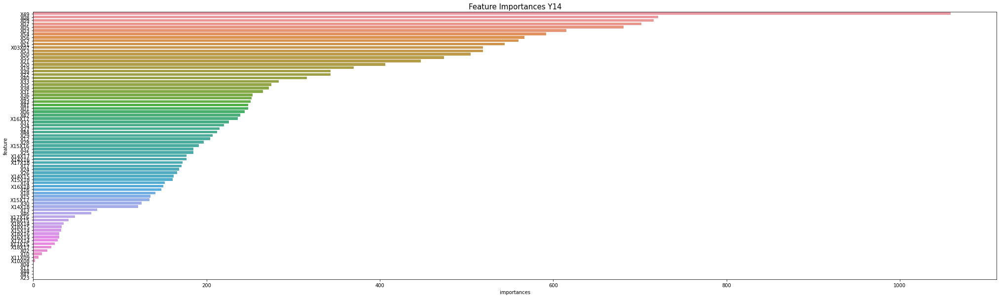

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y14
Fold 8 / lg_nrmse : 1.9705758433153364
fit Y01


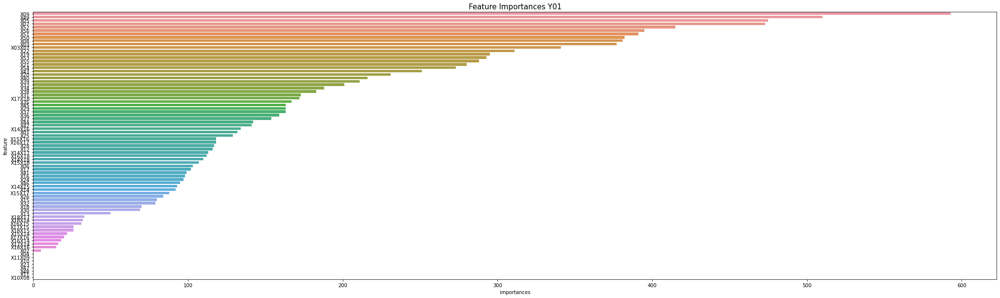

['X04', 'X11X09', 'X10', 'X23', 'X47', 'X48', 'X11', 'X10X08']
predict Y01
fit Y02


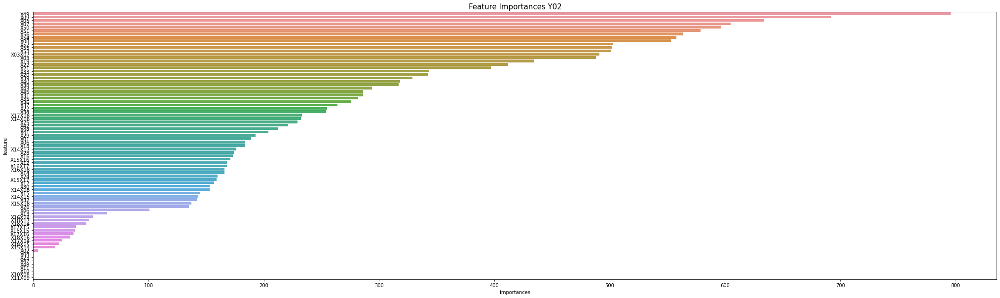

['X04', 'X23', 'X47', 'X48', 'X11', 'X10', 'X10X08', 'X11X09']
predict Y02
fit Y03


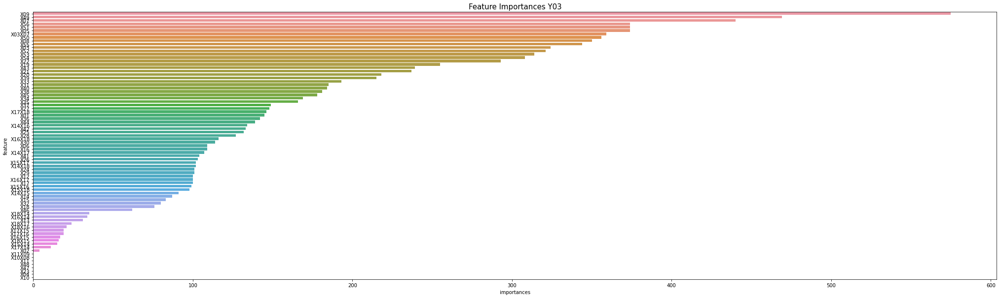

['X11X09', 'X10X08', 'X11', 'X48', 'X47', 'X23', 'X04', 'X10']
predict Y03
fit Y04


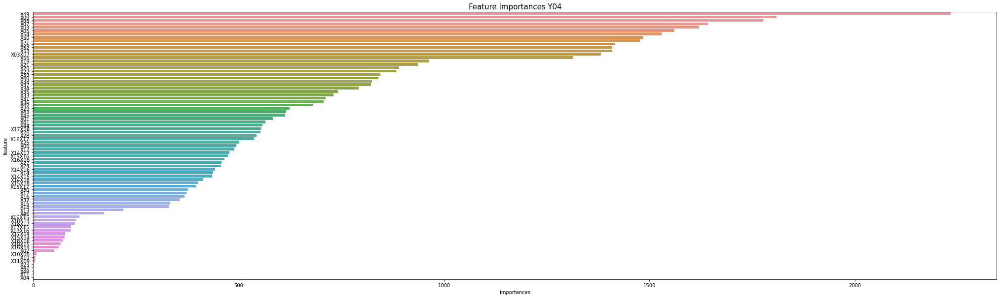

['X23', 'X47', 'X48', 'X11', 'X04']
predict Y04
fit Y05


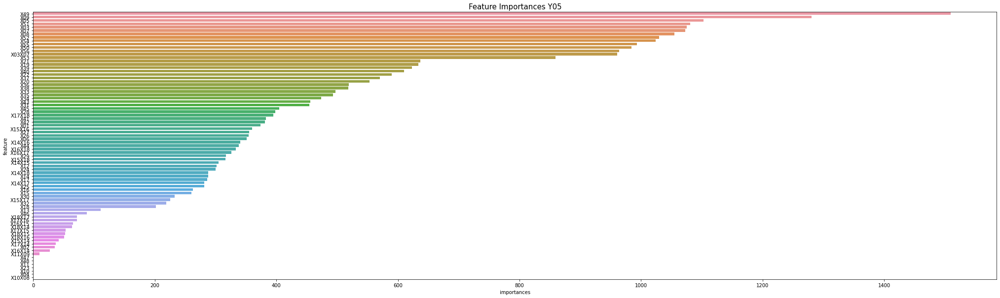

['X47', 'X48', 'X11', 'X23', 'X10', 'X04', 'X10X08']
predict Y05
fit Y06


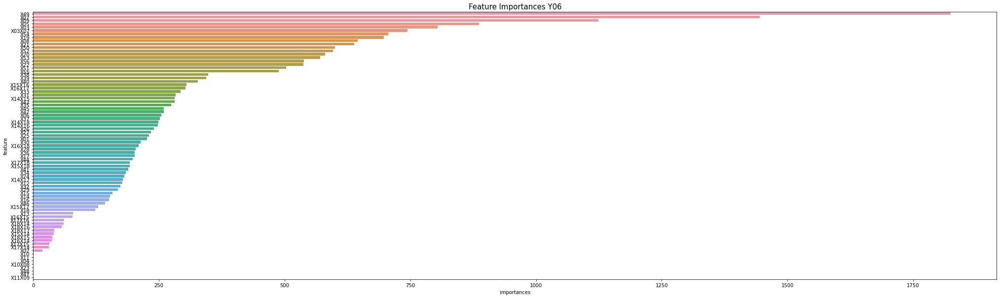

['X11', 'X04', 'X10X08', 'X23', 'X48', 'X47', 'X11X09']
predict Y06
fit Y07


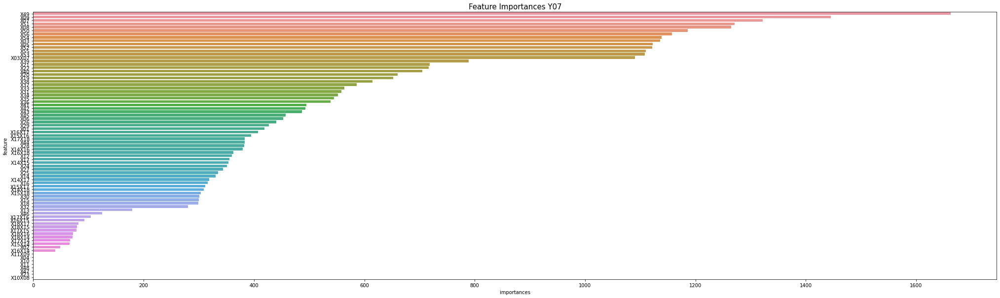

['X11X09', 'X04', 'X10', 'X11', 'X48', 'X47', 'X23', 'X10X08']
predict Y07
fit Y08


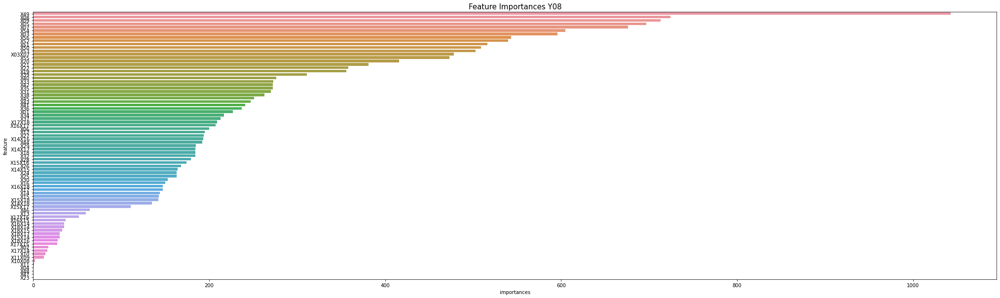

['X04', 'X48', 'X47', 'X23']
predict Y08
fit Y09


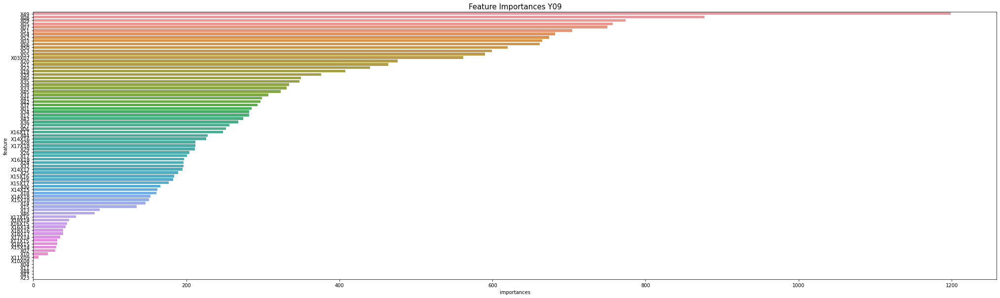

['X10X08', 'X04', 'X11', 'X48', 'X47', 'X23']
predict Y09
fit Y10


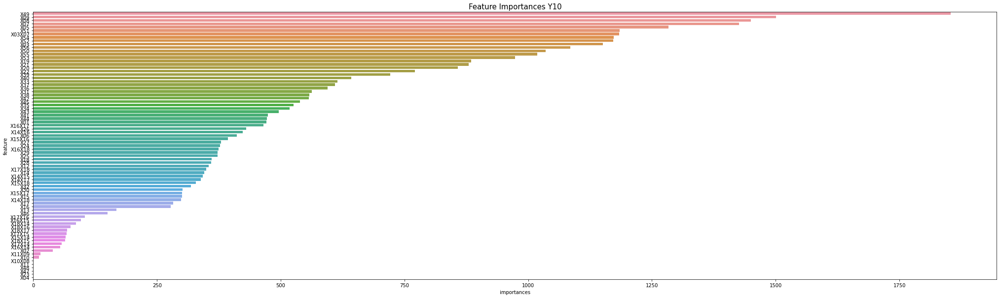

['X10X08', 'X11', 'X48', 'X47', 'X23', 'X04']
predict Y10
fit Y11


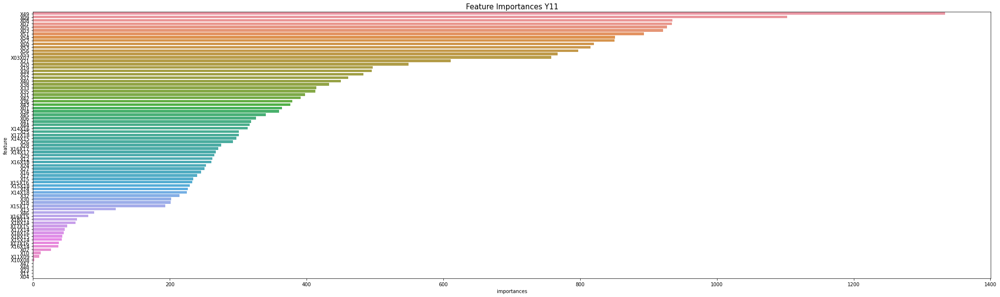

['X47', 'X48', 'X23', 'X11', 'X04']
predict Y11
fit Y12


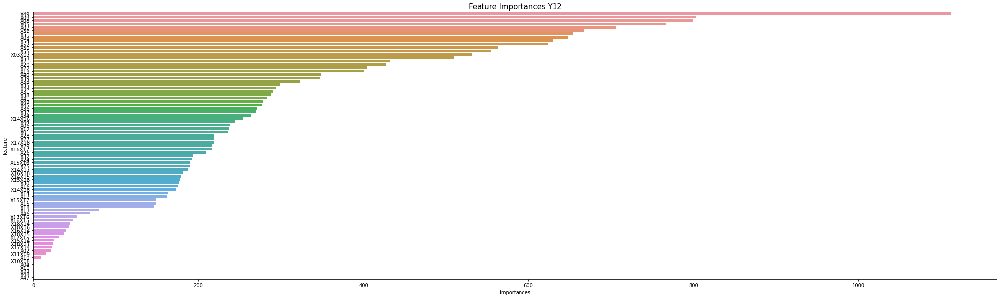

['X04', 'X11', 'X23', 'X48', 'X47']
predict Y12
fit Y13


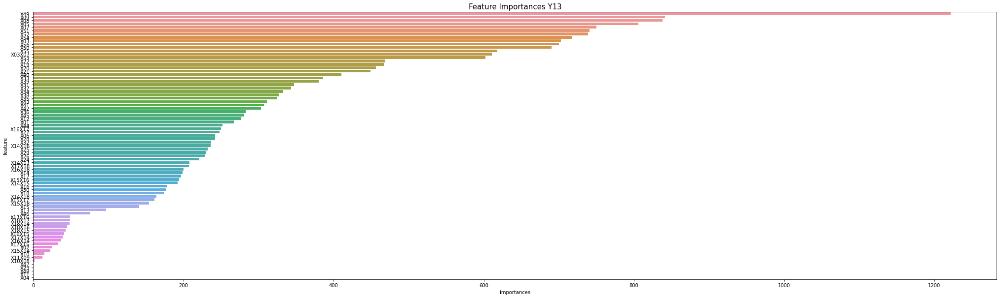

['X47', 'X23', 'X48', 'X11', 'X04']
predict Y13
fit Y14


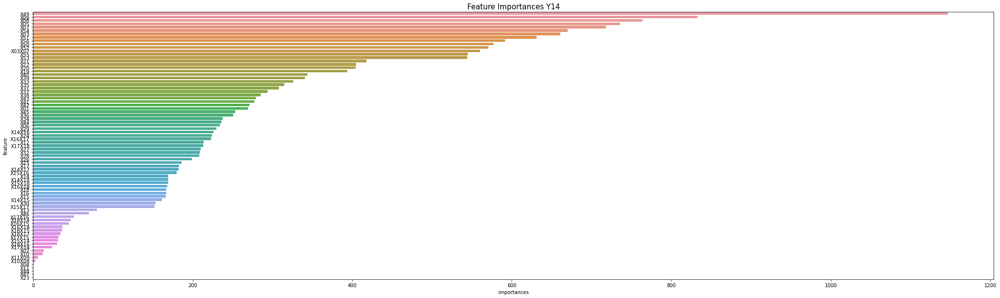

['X04', 'X11', 'X48', 'X47', 'X23']
predict Y14
Fold 9 / lg_nrmse : 1.9171559477435243


In [34]:
n_splits = 10
lgb_predictions = []
lgnrmses = []
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

def feval_rmspe(y_pred, lgb_train):
    y_true = lgb_train.get_label()
    return 'RMSPE', rmspe(y_true, y_pred), False

for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
    preds = []
    y_vals = []
    predictions_ = []
    for j in range(1, 15):
        if j < 10:
            train_y_ = train_y[f'Y0{j}']
        else:
            train_y_ = train_y[f'Y{j}']

        X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
        X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

        #train_weights = 1 / np.square(y_train)
        #val_weights = 1 / np.square(y_val)
            
        train_dataset = lgb.Dataset(X_train, y_train) # , weight = train_weights
        val_dataset = lgb.Dataset(X_val, y_val) #, weight = val_weights

        #Forward_best_model = forward_model(X = X_train, y = y_train)

        #Backward_best_model = backward_model(X = X_train, y = y_train)

        print(f'fit {train_y.columns[j-1]}')
            
        model = LGBMRegressor(**lgb_params)
        model.fit(X_train, y_train, eval_set = [(X_val, y_val)], early_stopping_rounds = 100, verbose = False)
            
        #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
        # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함
            
        # feature importance
        importance = model.feature_importances_
        #perm_importance = permutation_importance(model, X_val, y_val)
        #importance = perm_importance.importances_mean
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()
            
        featurelist = importances['feature'][importances['importances'] == 0].tolist()
        print(featurelist)
        
        train_drop = train.drop(featurelist, axis=1)
        test_drop = test.drop(featurelist, axis=1)
        
        train_x_drop = train_drop.filter(regex = 'X')
        test_x_drop = test_drop.filter(regex = 'X')
        
        X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
        X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]

        train_dataset_drop = lgb.Dataset(X_train_drop, y_train) # , weight = train_weights
        val_dataset_drop = lgb.Dataset(X_val_drop, y_val) #, weight = val_weights
            
        model_drop = LGBMRegressor(**lgb_params)
        model_drop.fit(X_train_drop, y_train, eval_set = [(X_val_drop, y_val)], early_stopping_rounds = 100, verbose = False)   
            
        print(f'predict {train_y.columns[j-1]}')
        pred = model_drop.predict(X_val_drop)
        prediction = model_drop.predict(test_x_drop)
        predictions_.append(prediction)
        preds.append(pred)
        y_vals.append(y_val)
        
    lgb_predictions.append(predictions_)
    lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
    lgnrmses.append(lgnrmse)
    print(f'Fold {i} / lg_nrmse : {lgnrmse}')

In [41]:
np.mean(lgnrmses)

1.9417591564353995

In [35]:
lgb_final_prediction = np.mean(np.array(lgb_predictions), axis=0).T

In [36]:
lgb_final_prediction

array([[  1.43697939,   1.21904696,   1.11817697, ..., -25.9659058 ,
        -25.98254818, -26.0082775 ],
       [  1.4939287 ,   1.23720901,   1.14381115, ..., -26.09295822,
        -26.09662638, -26.08307625],
       [  1.45578827,   1.12988861,   1.09558971, ..., -25.79171978,
        -25.79327003, -25.78902633],
       ...,
       [  1.20532453,   0.91798109,   0.95525574, ..., -26.47831101,
        -26.45514547, -26.50902333],
       [  1.21240782,   0.86586984,   0.93448114, ..., -26.4070409 ,
        -26.40225399, -26.41501852],
       [  1.29236089,   0.95164686,   0.99909921, ..., -26.49846375,
        -26.48092684, -26.49149506]])

In [37]:
for idx, col in enumerate(sample_submission.columns):
    if col=='ID':
        continue
    sample_submission[col] = lgb_final_prediction[:,idx-1]
print('Done.')

Done.


In [38]:
sample_submission.to_csv('lgb_submission.csv', index = False)

## Ensemble

In [63]:
ensemble_prediction = (lgb_final_prediction * 0.65) + (xgb_final_prediction * 0.35)

In [64]:
for idx, col in enumerate(sample_submission.columns):
    if col=='ID':
        continue
    sample_submission[col] = ensemble_prediction[:,idx-1]
print('Done.')

Done.


In [65]:
sample_submission.to_csv('ensemble_submission.csv', index = False)

# Voting

In [22]:
n_splits = 10
voting_predictions = []
lgnrmses = []
cb_model = CatBoostRegressor(**cat_params20)
lgb_model = LGBMRegressor(**lgb_params)
xgb_model = XGBRegressor(**xgb_params)
kfold = KFold(n_splits = n_splits, random_state = SEED, shuffle = True)

def rmspe(y_true, y_pred):
    return (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true))))

def feval_rmspe(y_pred, lgb_train):
    y_true = lgb_train.get_label()
    return 'RMSPE', rmspe(y_true, y_pred), False

for i, (train_idx, val_idx) in enumerate(kfold.split(train_x)):
    preds = []
    y_vals = []
    predictions_ = []
    for j in range(1, 15):
        if j < 10:
            train_y_ = train_y[f'Y0{j}']
        else:
            train_y_ = train_y[f'Y{j}']

        X_train, y_train = train_x.iloc[train_idx], train_y_.iloc[train_idx]
        X_val, y_val = train_x.iloc[val_idx], train_y_.iloc[val_idx]      

        #Forward_best_model = forward_model(X = X_train, y = y_train)

        #Backward_best_model = backward_model(X = X_train, y = y_train)

        print(f'fit {train_y.columns[j-1]}')
        model = VotingRegressor(
            estimators = [
                ('cb', cb_model),
                ('lgbm', lgb_model),
                ('xgb', xgb_model)
            ],
            weights = [0.1, 0.7, 0.2],
            n_jobs = -1
        )
        model.fit(X_train, y_train) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0
            
        #전진 선택법 실행 시 X_train[Forward_best_model.model.exog_names] X_val[Forward_best_model.model.exog_names] x_test[Forward_best_model.model.exog_names] 해줘야함
        # 후진 선택법 실행 시 X_train[Backward_best_model.model.exog_names] X_val[Backward_best_model.model.exog_names] x_test[Backward_best_model.model.exog_names] 해줘야함

        # feature importance
        #importance = model.feature_importances_
        perm_importance = permutation_importance(model, X_val, y_val)
        importance = perm_importance.importances_mean
        features = train_x.columns
        importances = pd.DataFrame()
        importances['feature'] = features
        importances['importances'] = importance
        importances.sort_values('importances', ascending = False, inplace = True)
        importances.reset_index(drop = True, inplace = True)
        plt.figure(figsize = (35, 10))
        sns.barplot(x = 'importances', y = 'feature', data = importances)
        plt.title(f'Feature Importances {train_y.columns[j-1]}', fontsize = 15)
        plt.show()
            
        featurelist = importances['feature'][importances['importances'] == 0].tolist()
        print(featurelist)
        
        train_drop = train.drop(featurelist, axis=1)
        test_drop = test.drop(featurelist, axis=1)
        
        train_x_drop = train_drop.filter(regex = 'X')
        test_x_drop = test_drop.filter(regex = 'X')
        
        X_train_drop, y_train = train_x_drop.iloc[train_idx], train_y_.iloc[train_idx]
        X_val_drop, y_val = train_x_drop.iloc[val_idx], train_y_.iloc[val_idx]

        model_drop = VotingRegressor(
            estimators = [
                ('cb', cb_model),
                ('lgbm', lgb_model),
                ('xgb', xgb_model)
            ],
            weights = [0.15, 0.15, 0.7],
            n_jobs = -1
        )
        model_drop.fit(X_train_drop, y_train) # eval_set = [(X_val, y_val)], eval_metric = 'rmse', verbose = 0'''
            
        print(f'predict {train_y.columns[j-1]}')
        pred = model_drop.predict(X_val_drop)
        prediction = model_drop.predict(test_x_drop)
        predictions_.append(prediction)
        preds.append(pred)
        y_vals.append(y_val)
        
    voting_predictions.append(predictions_)
    lgnrmse = lg_nrmse(np.array(y_vals).T, np.array(preds).T)
    lgnrmses.append(lgnrmse)
    print(f'Fold {i} / lg_nrmse : {lgnrmse}')

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 93)

In [ ]:
np.mean(lgnrmse)

In [ ]:
voting_final_prediction = np.mean(np.array(voting_predictions), axis=0).T

In [ ]:
for idx, col in enumerate(sample_submission.columns):
    if col=='ID':
        continue
    sample_submission[col] = voting_final_prediction[:,idx-1]
print('Done.')

In [ ]:
sample_submission.to_csv('xgb_submission.csv', index = False)

In [24]:
xgb_submission = pd.read_csv('../input/submissions/xgb_submission.csv')
lgb_submission = pd.read_csv('../input/submissions/lgb_submission.csv')
lgb_train_submission = pd.read_csv('../input/submissions/lgb_train_submission.csv')
cat_submission = pd.read_csv('../input/submissions/cat_submission.csv')

In [25]:
xgb_submission.iloc[:,1:].mean()

Y_01     1.352584
Y_02     1.055560
Y_03     1.013146
Y_04    13.609999
Y_05    31.284282
Y_06    16.536072
Y_07     3.156168
Y_08   -26.298038
Y_09   -26.311899
Y_10   -22.404289
Y_11    24.321763
Y_12   -26.240832
Y_13   -26.237038
Y_14   -26.248993
dtype: float64

In [26]:
cat_submission.iloc[:,1:].mean()

Y_01     1.353521
Y_02     1.056750
Y_03     1.014095
Y_04    13.611029
Y_05    31.279484
Y_06    16.525181
Y_07     3.156494
Y_08   -26.298701
Y_09   -26.312611
Y_10   -22.408659
Y_11    24.321163
Y_12   -26.241668
Y_13   -26.237900
Y_14   -26.249832
dtype: float64

In [49]:
lgb_submission.iloc[:,1:].mean()

Y_01     1.353129
Y_02     1.055816
Y_03     1.013508
Y_04    13.612160
Y_05    31.284587
Y_06    16.529838
Y_07     3.156453
Y_08   -26.298225
Y_09   -26.311882
Y_10   -22.406197
Y_11    24.322737
Y_12   -26.240846
Y_13   -26.237147
Y_14   -26.249022
dtype: float64

In [50]:
ensembled = xgb_submission.iloc[:,1:] * 0.35 + lgb_submission.iloc[:,1:] * 0.65
ensembled.mean()

Y_01     1.352938
Y_02     1.055726
Y_03     1.013381
Y_04    13.611404
Y_05    31.284480
Y_06    16.532020
Y_07     3.156353
Y_08   -26.298159
Y_09   -26.311888
Y_10   -22.405529
Y_11    24.322396
Y_12   -26.240841
Y_13   -26.237109
Y_14   -26.249012
dtype: float64

In [ ]:
ensembled = xgb_submission.iloc[:,1:] * 0.23 + lgb_submission.iloc[:,1:] * 0.62 + lgb_submission.iloc[:,1:] * 0.13 + lgb_submission.iloc[:,1:] * 0.12
ensembled.mean()

In [57]:
sample_submission.iloc[:,1:] = ensembled
sample_submission

,ID,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TEST_00001,1.434848,1.207765,1.112245,14.110966,31.517251,16.642117,3.120349,-26.018605,-26.053113,-22.075756,24.630432,-25.965294,-25.966701,-26.003894
1,TEST_00002,1.491448,1.220557,1.139314,13.172499,31.037994,16.473971,3.166880,-26.138849,-26.141011,-22.397622,24.293707,-26.087882,-26.091400,-26.083197
2,TEST_00003,1.456136,1.130012,1.100035,15.012279,32.282073,16.824983,3.063134,-25.769328,-25.827661,-22.078594,24.659389,-25.758278,-25.753705,-25.759360
3,TEST_00004,1.422296,1.124310,1.031104,14.827752,32.411014,17.150978,3.066029,-25.640768,-25.657455,-21.727605,24.896448,-25.635002,-25.604908,-25.630033
4,TEST_00005,1.301047,0.977036,0.934916,14.835302,31.392799,16.957847,3.104414,-25.766687,-25.762457,-21.921508,24.743335,-25.642329,-25.671356,-25.678196
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,1.259636,0.981097,0.987642,12.571006,30.864086,16.626457,3.164045,-26.487219,-26.459566,-22.993085,24.380505,-26.372611,-26.376643,-26.412600
39604,TEST_39605,1.233248,0.889824,0.940968,14.265565,31.378864,16.763656,3.174630,-26.353421,-26.377763,-22.879815,24.470018,-26.271157,-26.293016,-26.322120
39605,TEST_39606,1.210786,0.926842,0.956220,13.207061,31.080266,16.572668,3.161495,-26.540938,-26.552642,-23.011055,24.279119,-26.485877,-26.464612,-26.509921
39606,TEST_39607,1.210157,0.877201,0.931270,13.440622,31.099276,16.777263,3.180579,-26.469726,-26.454886,-22.865092,24.446711,-26.408653,-26.409183,-26.421437


In [58]:
sample_submission.to_csv('ensemble(lx)_submission.csv', index = False)